In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import cobra
import numpy as np
import seaborn as sns
import itertools
from matplotlib.colors import LogNorm, Normalize


In [2]:
import subprocess
import time


In [3]:
from cobra.flux_analysis import flux_variability_analysis
from cobra.flux_analysis import production_envelope


In [4]:
def get_elements(rid):
    r = model.reactions.get_by_id(rid)
    m = r.reactants[0]    
    elements = m.elements.copy()
    
    res = {
        'reaction' : rid,
        'metabolite' : m.name,
        'mid' : m.id,
        'N' : 'N' in elements,
        'C' : 'C' in elements,
        
    }
    return pd.Series(res)

In [5]:
import os
model_dpath = os.path.join('..', 'Models',  'kbase_models','model_objects')
os.listdir(model_dpath)


['HOT1A3_2OrMore_gapfill.model.sbml',
 'HOT1A3_2OrMore_nogap.model.sbml',
 'HOT1A3_annotate_genome_gapfill.model.sbml',
 'HOT1A3_annotate_genome_nogap.model.sbml',
 'HOT1A3_BlastKOALA_KEGG_gapfill.model.sbml',
 'HOT1A3_BlastKOALA_KEGG_nogap.model.sbml',
 'HOT1A3_carveme_annotations_gapfill.model.sbml',
 'HOT1A3_carveme_annotations_nogap.model.sbml',
 'HOT1A3_DRAM_genome_annotated_EC_2023_05_03_10_00_30_gapfill.model.sbml',
 'HOT1A3_DRAM_genome_annotated_EC_2023_05_03_10_00_30_nogap.model.sbml',
 'HOT1A3_DRAM_genome_annotated_KO_2023_05_03_10_00_30_gapfill.model.sbml',
 'HOT1A3_DRAM_genome_annotated_KO_2023_05_03_10_00_30_nogap.model.sbml',
 'HOT1A3_Genbank_annotations_parsed_by_Pathway_Tools_gapfill.model.sbml',
 'HOT1A3_Genbank_annotations_parsed_by_Pathway_Tools_nogap.model.sbml',
 'HOT1A3_Majority_gapfill.model.sbml',
 'HOT1A3_Majority_nogap.model.sbml',
 'HOT1A3_NCBI_EC_numbers_gapfill.model.sbml',
 'HOT1A3_NCBI_EC_numbers_nogap.model.sbml',
 'HOT1A3_ProkkaAnnotation_gapfill.model.

In [35]:
models_dict = {fname : cobra.io.read_sbml_model(os.path.join(model_dpath, fname)) for fname in os.listdir(model_dpath)}


Model does not contain SBML fbc package information.
SBML package 'layout' not supported by cobrapy, information is not parsed
SBML package 'render' not supported by cobrapy, information is not parsed
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00443_c0 "ABEE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02920_c0 "2_Amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridinediphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00012_c0 "PPi_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00067_c0 "H_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00683_c0 "Dihydropteroate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00002_c0 "ATP_c0">
Use of the species charge attribute is discouraged, use fbc:charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00836_c0 "S_Acetyldihydrolipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00083_c0 "GDP_mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00900_c0 "GDP_4_dehydro_D_rhamnose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00179_c0 "Maltose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00027_c0 "D_Glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00635_c0 "Cbl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00166_c0 "Calomide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11436_c0 "fa3_c0">
Use of the species charge attribute is discouraged, use fbc:cha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15173_c0 "3_Hydroxy_5_methylhex_4_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02375_c0 "Adenylosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_c0 "Fumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00367_c0 "Cytidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00052_c0 "CTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02201_c0 "4_phosphopantothenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02666_c0 "R_4_Phosphopantothenoyl_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00026_c0 "UDP_glucose_c0">
Use of the species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00552_c0 "F__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01498_c0 "Maleylacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11483_c0 "R_3_Hydroxyoctanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11471_c0 "2E_Octenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02026_c0 "TSST_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02602_c0 "2_Deoxyribonucleoside_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01418_c0 "TSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12378_c0 "Ribonucleoside_diphosphate_c0">
Use of the speci

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04134_c0 "2_Chloroethanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15308_c0 "1_2_Diacyl_sn_glycerol_ditetradec_7_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15523_c0 "1_2_ditetradec_7_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03396_c0 "Selenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03388_c0 "Adenylylselenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_c0 "XAN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00530_c0 "XTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00497_c0 "XMP_c0">
Use of the specie

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01465_c0 "Leukotriene_C4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11612_c0 "Amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03540_c0 "LTD4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12298_c0 "5_L_Glutamyl_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14890_c0 "4Z_7Z_10Z_13Z_16Z_19Z_Docosahexaenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15092_c0 "6Z_9Z_12Z_15Z_18Z_21Z_3_Oxotetracosahexa_6_9_12_15_18_21_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15418_c0 "CDP_1_2_dihexadec_9_enoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12228_c0 "L_Histidyl_tRNAHis_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15529_c0 "phosphatidylethanolamine_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15336_c0 "2_Acyl_sn_glycero_3_phosphoethanolamine_dodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14901_c0 "beta_2_3_4_5_6_Pentachlorocyclohexanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14902_c0 "beta_2_3_5_6_Tetrachloro_1_4_cyclohexanediol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15995_c0 "Menaquinone6_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15994_c0 "Menaquinol6_c0">
Use of the species charge attribute is discou

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01896_c0 "6_Aminopenicillanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02060_c0 "2E_Dodecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00126_c0 "GMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00311_c0 "Guanosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_c0 "L_Tryptophan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11923_c0 "tRNATrp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12336_c0 "L_Tryptophanyl_tRNATrp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00626_c0 "dTDPglucose_c0">
Use of the species charge attribute is discouraged,

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15510_c0 "two_linked_disacharide_pentapeptide_and_tetrapeptide_murein_units_uncrosslinked__middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15521_c0 "1_2_didodecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15679_c0 "1_2_diisotetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15720_c0 "Dianteisopentadecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01651_c0 "L_3_Cyanoalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03407_c0 "gamma_Glutamyl_beta_cyanoalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00875_c0 "KDO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00346_c0 "L_Aspartate4_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02120_c0 "Dihydrodipicolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15309_c0 "1_2_Diacyl_sn_glycerol_dihexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15524_c0 "1_2_dihexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03116_c0 "S_3_Hydroxydodecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00843_c0 "Tartronate_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03488_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine_L_alanyl_D_glutaminyl_L_lysyl_D_alanyl_D_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00338_c0 "5_Aminolevulinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00070_c0 "Malonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03115_c0 "S_3_Hydroxytetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12689_c0 "3_Oxotetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00885_c0 "Phytate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02780_c0 "Inositol_1_2_4_5_6_pentakisphosphate_c0">
Use of the species charge att

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01217_c0 "Xanthosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03656_c0 "GA2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02041_c0 "S_2_Hydroxyglutarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01982_c0 "5_Phosphoribosylamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02132_c0 "3_Phospho_D_erythronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02645_c0 "Phosphoenol_4_deoxy_3_tetrulosonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08288_c0 "2_phospho_4__cytidine5_diphospho_2_C_methyl_D_erythritol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02419_c0 "Nonaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00906_c0 "all_trans_Hexaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09429_c0 "3_Hexaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15417_c0 "CDP_1_2_didodecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15354_c0 "2_hexadec_9_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11623_c0 "L_Amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17401_c0 "2_Oxo_5_methylthiopentanoic_acid_c0">
Use of the species charge attribute is discouraged, use

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08287_c0 "4__cytidine5_diphospho_2_C_methyl_D_erythritol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15552_c0 "phosphatidylserine_didodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15528_c0 "phosphatidylethanolamine_didodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00139_c0 "Glycolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15097_c0 "Trinitrotoluene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15098_c0 "4_Hydroxylamino_2_6_dinitrotoluene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00428_c0 "2_Oxopropanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instea

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00706_c0 "Mercaptopyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11751_c0 "tRNATyr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12194_c0 "L_Tyrosyl_tRNATyr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15320_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_tetradec_7_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01092_e0 "Allantoin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01092_c0 "Allantoin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11482_c0 "R_3_Hydroxydecanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11487_c0 "3_oxodec

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00802_c0 "D_fructose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00448_c0 "D_Glyceraldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01859_c0 "2_Naphthylmethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09802_c0 "2_Naphthaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01356_c0 "R_Amygdalin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00045_c0 "Adenosine_3_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00157_c0 "Glycerone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00890_c0 "UDP_N_acetylmuramoyl_L_alanine_c0">
Use 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00160_c0 "Cholesterol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02125_c0 "Tiglyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11825_c0 "Octadecenoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15726_c0 "Dianteisopentadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02642_c0 "N_5_phosphoribosyl_anthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00956_c0 "1_2_carboxyphenylamino_1_deoxyribulose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00363_c0 "Ethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00697_c0 "cGMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17007_c0 "Iso_C17_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17420_c0 "2_7_Methylthioheptylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17421_c0 "3_7_Methylthioheptylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14720_c0 "L_Methionine_R_S_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00079_c0 "D_glucose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02546_c0 "CMP_KDO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00381_c0 "L_Cystine_c0">
Use of the species charg

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02822_c0 "1_Alkenylglycerophosphoethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08626_c0 "2_Aminomalonate_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_c0 "Methanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00055_c0 "Formaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00210_c0 "Taurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03474_c0 "5_Glutamyl_taurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03530_c0 "L_4_Hydroxyglutamatesemialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00604_c0 "4_Coumarate_c0">
U

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01401_c0 "Vitamin_K1_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15051_c0 "OPC4_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15050_c0 "3_Oxo_OPC6_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03444_c0 "2_Octaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17015_c0 "Iso_C6_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17013_c0 "Iso_C16_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00404_c0 "D_Ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00815_c0 "2_Oxo_5_aminovalerate_c0">
Use of the species charge attribute is discou

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02607_c0 "5_Fluorodeoxyuridine_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14957_c0 "Apoprotein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14953_c0 "Protein_N6_octanoyllysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17029_c0 "pentadecanoyl_ACP_n_C15_0ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03197_c0 "Galactosylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00794_c0 "TRHL_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15319_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_tetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00388_c0 "Allantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01419_c0 "Ureidoglycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15805_c0 "Anteiso_C15_0_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00976_c0 "dIDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03176_c0 "5S_HPETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02918_c0 "5_HETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00092_e0 "Uracil_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01504_c0 "3_Aminopropanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instea

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00709_c0 "beta_D_Galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06227_c0 "THF_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15494_c0 "Maltoheptaose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15597_c0 "Fatty_acid_Anteiso_C17_1_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15598_c0 "Anteiso_C17_1_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00011_e0 "CO2_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03446_c0 "2_Octaprenyl_6_methoxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03456_c0 "S_sulfocysteine_c0">
Use of the species ch

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14718_c0 "7_Cyano_7_deazaguanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28379_c0 "a_3_oxo_cis_delta5_dodecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28378_c0 "a_3_hydroxy_cis_delta5_dodecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26726_c0 "Cis_Delta5_dodecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22075_c0 "3_oxo_cis_D7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22061_c0 "3_hydroxy_cis_D7_tetraecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28276_c0 "Trans_D3_cis_D7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22421_c0 "BCCP_dimers_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26673_c0 "Carboxybiotin_BCCP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16768_c0 "2_nonaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27735_c0 "Ox_Thioredoxin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28060_c0 "Red_Thioredoxin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15208_c0 "3_Octaprenyl_4_hydroxybenzoate_5_repeating_units_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02590_c0 "all_trans_Heptaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25872_c0 "3

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00220_e0 "Riboflavin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00060_e0 "L_Methionine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_e0 "L_Arginine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_e0 "Pyridoxal_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00028_e0 "Heme_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00023_e0 "L_Glutamate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00069_e0 "L_Tyrosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_e0 "L_Valine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <S

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00092_b "Uracil_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_b "Methanol_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00011_b "CO2_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03453_b "Enterobactin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03726_b "Fe_enterochlin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00041_b "L_Aspartate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_b "Thiamin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_b "PAN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Spe

Adding exchange reaction EX_cpd00305_b with default bounds for boundary metabolite: cpd00305_b.
Adding exchange reaction EX_cpd00644_b with default bounds for boundary metabolite: cpd00644_b.
Adding exchange reaction EX_cpd00218_b with default bounds for boundary metabolite: cpd00218_b.
Adding exchange reaction EX_cpd00322_b with default bounds for boundary metabolite: cpd00322_b.
Adding exchange reaction EX_cpd00084_b with default bounds for boundary metabolite: cpd00084_b.
Adding exchange reaction EX_cpd00054_b with default bounds for boundary metabolite: cpd00054_b.
Adding exchange reaction EX_cpd00264_b with default bounds for boundary metabolite: cpd00264_b.
Adding exchange reaction EX_cpd00053_b with default bounds for boundary metabolite: cpd00053_b.
Adding exchange reaction EX_cpd00393_b with default bounds for boundary metabolite: cpd00393_b.
Adding exchange reaction EX_cpd00065_b with default bounds for boundary metabolite: cpd00065_b.
Adding exchange reaction EX_cpd00119_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0017

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00162_c0 "oxaloacetate_carboxy_lyase_pyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00162_c0 "oxaloacetate_carboxy_lyase_pyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00285_c0 "Succinate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00285_c0 "Succinate_CoA_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01871_c0 "acetyl_CoA_enzyme_N6_dihydrolipoyllysine_S_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01871_c0 "acetyl_CoA_enzyme_N

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01476_c0 "6_Phospho_D_glucono_1_5_lactone_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00785_c0 "D_Fructose_6_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00558_c0 "D_glucose_6_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00558_c0 "D_glucose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn000

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00604_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00604_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05467_c0 "CO2_transporter_via_diffusion_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05467_c0 "CO2_transporter_via_diffusion_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00330_c0 "acetyl_CoA_glyoxylate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10091_c0 "cobIalamin_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_CoA_NAD_plus__oxido

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01705_c0 "dCTP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00211_c0 "UDP_glucose_NAD_plus__6_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00211_c0 "UDP_glucose_NAD_plus__6_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06441_c0 "L_Leucine_tRNALeu_ligase_AMP_forming_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03039_c0 "1_5_Phosphoribosyl_5_amino_4_imidazolecarboxamide_pyrophosphate_phosphoribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10262_c0 "isopentadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10262_c0 "isopentadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10209_c0 "anteisopentadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10209_c0 "anteisopentadecanoyl_glycerol_3_phospha

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10228_c0 "isotetradecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10228_c0 "isotetradecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04810_c0 "1R_glutathionyl_2R_hydroxy_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04810_c0 "1R_glutathionyl_2R_hydroxy_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase_c0">
Use of GE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03181_c0 "ATP_2_3_2_3_tetrakis3_hydroxytetradecanoyl_D_glucosaminyl_beta_D_1_6_glucosaminyl_alpha_phosphate_4_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03181_c0 "ATP_2_3_2_3_tetrakis3_hydroxytetradecanoyl_D_glucosaminyl_beta_D_1_6_glucosaminyl_alpha_phosphate_4_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09360_c0 "UDP_N_acetylmuramate_L_alanyl_gamma_D_glutamyl_meso_diaminopimelate_D_alanine_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09360_c0 "UDP_N_acetylmuramate_L_alanyl_gamma_D_glutamyl_meso_diaminopimelate_D_alanine_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09206_c0 "Phosphatidylserine_syntase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01729_c0 "glutarate_semialdehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01729_c0 "glutarate_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05778_c0 "alpha_amino_acid_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05778_c0 "alpha_amino_acid_NAD_plus__oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07577

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01974_c0 "LL_2_6_Diaminoheptanedioate_2_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01974_c0 "LL_2_6_Diaminoheptanedioate_2_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01731_c0 "Itaconate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01731_c0 "Itaconate_CoA_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00242_c0 "guanosine_3_5_bisdiphosphate_3_diphosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00242_c0 "guanosine_3_5_bisdiphosphate_3_diphosp

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14123_c0 "gamma_Glutamyl_beta_aminopropiononitrile_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14123_c0 "gamma_Glutamyl_beta_aminopropiononitrile_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05874_c0 "phosphate_monoester_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05874

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08440_c0 "lauroyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08440_c0 "lauroyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02160_c0 "L_Histidinol_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02160_c0 "L_Histidinol_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08802_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08802_c0 "Lysophospholipase_L1_2_acylglycerophosphoti

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01362_c0 "Orotidine_5_phosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01362_c0 "Orotidine_5_phosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05329_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05329_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03174_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_hydrolase_c0">
Use of GENE ASSOCIATIO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00612_c0 "sn_Glycerol_3_phosphate_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08766_c0 "FabH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08766_c0 "FabH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06403_c0 "D_Glucoside_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06403_c0 "D_Glucoside_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08841_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00999_c0 "Phenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00391_c0 "riboflavin_5_phosphate_phosphohydrolase_acid_optimum_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00391_c0 "riboflavin_5_phosphate_phosphohydrolase_acid_optimum_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01016_c0 "ATP_carbamate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01016_c0 "ATP_carbamate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08799

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00907_c0 "5_10_methylenetetrahydrofolate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00907_c0 "5_10_methylenetetrahydrofolate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10213_c0 "stearoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10213_c0 "stearoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08300_c0 "diacylglycerol_kinase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reacti

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01301_c0 "L_Homoserine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01301_c0 "L_Homoserine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01643_c0 "L_Aspartate_4_semialdehyde_NADP_plus__oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01643_c0 "L_Aspartate_4_semialdehyde_NADP_plus__oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04457_c0 "R06605_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04457_c0 "R06605_c0">
E

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06673_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06673_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03869_c0 "Acylamide_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03869_c0 "Acylamide_aminohydrol

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03080_c0 "5_amino_6_D_ribitylaminouracil_butanedionetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03080_c0 "5_amino_6_D_ribitylaminouracil_butanedionetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10237_c0 "isohexadecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10237_c0 "isohexadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00143_c0 "S_Adenosyl_L_homocysteine_homocysteinylribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08801_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08801_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02275_c0 "4_Guanidinobutanamide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02275_c0 "4_Guanidinobutanamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00503_c0 "S_1_pyrroline_5_carboxylate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07292_c0 "L_cysteine_ThiI_sulfurtransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10264_c0 "isohexadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10264_c0 "isohexadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03071_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03071_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and U

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06864_c0 "Biotinyl_5_AMP_apo_carboxylase_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14063_c0 "2_dehydro_L_idonate_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14063_c0 "2_dehydro_L_idonate_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00916_c0 "Xanthosine_5_phosphate_ammonia_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00916_c0 "Xanthosine_5_phosphate_ammonia_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00273_c0 "Acetyl_CoA_glycine_C_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00273_c0 "Acetyl_CoA_glycine_C_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00405_c0 "L_arginine_carboxy_lyase_agmatine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00405_c0 "L_arginine_carboxy_lyase_agmatine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04704_c0 "coproporphyrinogen_III_S_adenosyl_L_methionine_oxidoreductasedecarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04704

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08128_c0 "Amylomaltase_maltopentaose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08128_c0 "Amylomaltase_maltopentaose_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04678_c0 "D_Sedoheptulose_7_phosphate_thiamin_diphosphate_glycolaldehydetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04678_c0 "D_Sedoheptulose_7_phosphate_thiamin_diphosphate_glycolaldehydetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03975_c0 "FMNH2_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03975_c0 "

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06936_c0 "L_Aspartate_tRNAAsp_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06936_c0 "L_Aspartate_tRNAAsp_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01352_c0 "dGTP_triphosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01352_c0 "dGTP_triphosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00883_c0 "1D_myo_Inositol_3_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00883_c0 "1D_myo_Inositol_3_phosphate_phosphohydrolase_c0">
Encoding LO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08442_c0 "fatty_acid_CoA_thioesterase_tetradecenoate_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08442_c0 "fatty_acid_CoA_thioesterase_tetradecenoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00554_c0 "CTP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00554_c0 "CTP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05050_c0 "5_ribonucleotide_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05050_c0 "5_ribonucleotide_p

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08352_c0 "R08210_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08352_c0 "R08210_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05086_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4__c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05086_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4__c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09106_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09106_c0 "phosphatidylglycerol_phosphate_phosp

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08310_c0 "CDP_diacylglycerol_synthetase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06109_c0 "Succinate_ubiquinone_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06109_c0 "Succinate_ubiquinone_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06595_c0 "peptide_L_methioni

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08847_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00863_c0 "L_histidinal_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00863_c0 "L_histidinal_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09113_c0 "Phosphatidy

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06077_c0 "L_methionine_oxidized_thioredoxin_S_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06077_c0 "L_methionine_oxidized_thioredoxin_S_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04865_c0 "R07059_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04865_c0 "R07059_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07994_c0 "3_oxoacyl_acyl_carrier_protei

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01539_c0 "thiamin_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01539_c0 "thiamin_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_NAD_plu

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_f

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07181_c0 "2_S_glutathionylacetyl_chloride_glutathione_2_S_glutathionylacetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03422_c0 "N_succinyl_L_glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03422_c0 "N_succinyl_L_glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02895_c0 "5_Phospho_D_ribosylamine_glycine_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02895_c0 "5_Phospho_D_ribosylamine_glycine_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kineti

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12191_c0 "R08558_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12191_c0 "R08558_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09200_c0 "Phosphatidylserine_decarboxylase_n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09200_c0 "Phosphatidylserine_decarboxylase_n_C16_0_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00675_c0 "Propionyladenylate_CoA_propionyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01018_c0 "carbamoyl_phosphate_L_aspartate_carbamoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01018_c0 "carbamoyl_phosphate_L_aspartate_carbamoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04132_c0 "R06063_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04132_c0 "R06063_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08813_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C16_0_periplasm_c

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05035_c0 "O_phospho_L_serine_hydrogen_sulfide_2_amino_2_carboxyethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05035_c0 "O_phospho_L_serine_hydrogen_sulfide_2_amino_2_carboxyethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10257_c0 "anteisopentadecanoyl_Diacylglycerol_kinase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rx

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09010_c0 "5_nucleotidase_dIMP_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09010_c0 "5_nucleotidase_dIMP_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02200_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02200_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14059_c0 "2_3_methylthiobutylmalate_hydroxymutase_c0">
Use of 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01122_c0 "D_altronate_hydro_lyase_2_dehydro_3_deoxy_D_gluconate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01122_c0 "D_altronate_hydro_lyase_2_dehydro_3_deoxy_D_gluc

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05622_c0 "Na_plus__transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00290_c0 "succinyl_CoA_acetoacetate_CoA_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00290_c0 "succinyl_CoA_acetoacetate_CoA_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03907_c0 "CTP__2_C_Methyl_D_erythritol_4_phosphate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03907_c0 "CTP__2_C_Methyl_D_erythritol_4_phosphate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01987_c

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03424_c0 "L_erythro_4_Hydroxyglutamate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03424_c0 "L_erythro_4_Hydroxyglutamate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01366_c0 "Uridine_phosphate_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01366_c0 "Uridine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01208_c0 "R01652_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01208_c0 "R01652_c0">
Encoding LOWER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09101_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09101_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08088_c0 "1_octadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09211_c0 "Phosphatidylserine_syntase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09211_c0 "Phosphatidylserine_syntase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03141_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_L_lysine_alanyl_D_alanine_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03141_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_L_lysine_alanyl_D_alanine_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05006_c0 "S_adenosyl_L_methionine_precorrin_1_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead:

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00943_c0 "Palmitoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00943_c0 "Palmitoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00903_c0 "L_Valine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00903_c0 "L_Valine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00980_c0 "2_Phosphoglycolate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00980_c0 "2_Phosphoglycolate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00291_c0 "N_succinyl_L_glutamate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07438_c0 "peptide_methionine_thioredoxin_disulfide_S_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07438_c0 "peptide_methionine_thioredoxin_disulfide_S_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00743_c0 "Glycerone_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00743_c0 "Glycerone_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10202_c0 "glycer

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00693_c0 "5_Methyltetrahydrofolate_L_homocysteine_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01351_c0 "2_Deoxyguanosine_5_triphosphate_diphosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01351_c0 "2_Deoxyguanosine_5_triphosphate_diphosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03909_c0 "1_Deoxy_D_xylulose_5_phosphate_pyruvate_lyase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03909_c0 "1_Deoxy_D_xylulose_5_phosphate_pyruvate_lyase_carboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use f

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09449_c0 "acyl_coenzyme_A_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05323_c0 "Tetradecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05323_c0 "Tetradecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11007_c0 "TMDSf_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11007_c0 "TMDSf_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <React

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00268_c0 "glycine_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00268_c0 "glycine_NAD_plus__oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02596_c0 "R03634_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02596_c0 "R03634_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00991_c0 "S_3_hydroxy_3_methylglutaryl_CoA_acetoacetate_lyase_acetyl_CoA_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00991_c0 "S_3_hydroxy_3_methylglutaryl_CoA_acetoacetate_lyase_acetyl_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13669_c0 "b_ketoacyl_synthetase_C15_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13669_c0 "b_ketoacyl_synthetase_C15_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Encod

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10259_c0 "isoheptadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01602_c0 "dihydrofolate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01602_c0 "dihydrofolate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03068_c0 "R_2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03068_c0 "R_2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kinet

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07432_c0 "R07601_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07432_c0 "R07601_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11749_c0 "5_deoxy_5_fluorocytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gp

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02287_c0 "S_adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02287_c0 "S_adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00409_c0 "ATP_CDP_phospho

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02517_c0 "ATP_dIDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05326_c0 "Hexanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05326_c0 "Hexanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kineti

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01347_c0 "UTP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01347_c0 "UTP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08857_c0 "Lysyl_tRNA_synthetase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08857_c0 "Lysyl_tRNA_synthetase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05054_c0 "adenosylcobyric_acid_R_1_aminopropan_2_ol_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05054_c0 "adenosylcobyric_acid_R_1_am

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03130_c0 "UDP_2_3_bis3R_3_hydroxymyristoyl_alpha_D_glucosamine_2_3_bis3R_3_hydroxymyristoyl_beta_D_glucosaminyl_1_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01791_c0 "R_Pantoate_beta_alanine_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01791_c0 "R_Pantoate_beta_alanine_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00183_c0 "L_Glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00183_c0 "L_Glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06591_c0 "L_glutamate_semialdehyde__NADP_plus__oxidoreductaseL_glutamyl_tRNAGlu_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02474_c0 "5_amino_6_5_phosphoribitylaminouracil_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02474_c0 "5_amino_6_5_phosphoribitylaminouracil_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03246_c0 "S_hydroxyoctanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03246_c0 "S_hydroxyoctanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00905_c0 "2_dehydropantoate_formaldehyde_lyase_3_methyl_2_oxobutanoate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02409_c0 "R06099_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02409_c0 "R06099_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09112_c0 "Phosphatidylglycerol_synthase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09112_c0 "Phosphatidylglycerol_synthase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03194_c0 "S_2_Aceto_2_hydroxybutanoate_pyruvate_lyase_carboxylating_c0">
Use of GENE 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00701_c0 "UDP_glucose_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00701_c0 "UDP_glucose_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00367_c0 "CTP_diphosphohydrolase_diphosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn26037_c0 "IscS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn26037_c0 "IscS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20631_c0 "3PHP_transaminase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20631_c0 "3PHP_transaminase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07455_c0 "decenoyl_acyl_carrier_protein_delta2_trans_delta3_cis_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reacti

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25718_c0 "3_oxo_stearoyl_acyl_carrier_protein_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15007_c0 "cellobiose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15007_c0 "cellobiose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15334_c0 "S_plus__Allantoin_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15334_c0 "S_plus__Allantoin_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00154_c0 "pyruvate_NAD_plus__2_oxidoreductase_CoA_acetylating_c0">
Use of GENE A

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16846_c0 "1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16846_c0 "1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20526_c0 "phosphatidylglycerol_phosphatase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20526_c0 "phosphatidylglycerol_phosphatase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn23669_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn23669_c0 "acyl_CoA_sn_glycerol_3_ph

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25279_c0 "2_methylcitrate_dehydratase_2_methyl_trans_aconitate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn17392_c0 "2_methylcitrate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn17392_c0 "2_methylcitrate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15081_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15081_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14070_c0 "E_4_hydroxy_3_methylbut_2_en_1_yl_diphosphate_oxidi

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn40674_c0 "5_demethylubiquinone_8_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21733_c0 "RXN_9222c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21733_c0 "RXN_9222c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn22481_c0 "RXN_9225c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22481_c0 "RXN_9225c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn22483_c0 "RXN_9240c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22483_c0 "RXN_9240c_c

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05255_c0 "folate_transport_via_proton_simport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05255_c0 "folate_transport_via_proton_simport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05663_c0 "TRANS_RXNBWI_115637cemaizeexpTRP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05663_c0 "TRANS_RXNBWI_115637cemaizeexpTRP_c0">
Encoding LOWER_BOUND and 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03919_c0 "D_glycero_beta_D_manno_heptose_1_7_bisphosphate_7_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03919_c0 "D_glycero_beta_D_manno_heptose_1_7_bisphosphate_7_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08233_c0 "Chlorideproton_antiport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08233_c0 "Chlorideproton_antiport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10868_c0 "ammonium_transport_out_via_K_plus__antiport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10868_c0 "ammonium

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08491_c0 "FeIII_reduction_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08491_c0 "FeIII_reduction_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08711_c0 "RXN0_5061c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08711_c0 "RXN0_5061c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05893_c0 "Ammonia_ferredoxin_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05893_c0 "Ammonia_ferredoxin_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00142_e0 "EX_Acetoacetate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00211_e0 "EX_Butyrate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00159_e0 "EX_L_Lactate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00047_e0 "EX_Formate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd10516_e0 "EX_fe3_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00030_e0 "EX_Mn2_plus__e0">
Enco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05040_c0 "D_ribulose_5_phosphate_formate_lyase_L_3_4_dihydroxybutan_2_one_4_phosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06493_c0 "dihydrolipoylprotein_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01870_c0 "D_Fructose_1_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00616_c0 "sn_Glycerol_3_phosphate_acceptor_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00505_c0 "Isocitrate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08173_c0 "F1_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00543_c0 "ethanol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00441_c0 "R00621_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03250_c0 "S_Hydroxyhexanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00623_c0 "hydrogen_sulfide_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06526_c0 "protein_dithiol_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01343_c0 "ATP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00224_c0 "protoheme_ferro_lyase_protoporphyrin_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09240_c0 "Sulfate_adenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01219_c0 "ATP_dCMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07882_c0 "3_hydroxy_5_methylhex_4_enoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00800_c0 "N6_1_2_dicarboxyethylAMP_AMP_lyase_fumarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01705_c0 "dCTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in Kinet

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01021_c0 "Methylthioadenosine_methylthioribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00165_c0 "L_serine_ammonia_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10228_c0 "isotetradecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04810_c0 "1R_glutathionyl_2R_hydroxy_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11548_c0 "S_Aden

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01729_c0 "glutarate_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05778_c0 "alpha_amino_acid_NAD_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07577_c0 "R07763_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11577_c0 "5_Glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07727_c0 "R07937_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09209_c0 "Phosphatidylserine_syntase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05874_c0 "phosphate_monoester_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11772_c0 "6_thioxanthine_5_monophosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03043_c0 "5_Dehydro_4_deoxy_D_glucuronate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00212_c0 "UDP_glucose_glucophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09202_c0 "Phosphatidylserine_decarboxylase_n_C18_0_c0">

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03072_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02938_c0 "1_5_phospho_D_ribosyl_5_amino_4_imidazolecarboxylate_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02192_c0 "7E_9E_11Z_14Z_5S_6S_5_6_Epoxyicosa_7_9_11_14_tetraenoate_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05335_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02570_c0 "Hydrogen_selenide_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08133_c0 "aminopeptidase_pro_gly_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02922_c0 "Trihexosylceramide_N_acetylhexosaminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03419_c0 "formamidopyrimidine_nucleoside_triphosphate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08551_c0 "glycerol_3_phosphate_acyltransferase_C18_0_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08844_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02875_c0 "N_Acetylmuramoyl_Ala_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00707_c0 "ITP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00369_c0 "GTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06937_c0 "L_glutamate_tRNAGlu_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14017_c0 "sn_glycerol_3_phosphate_ubiquinone_oxidoreductase_c0">
Encoding OBJ

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08843_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01256_c0 "Chorismate_pyruvatemutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00213_c0 "UTP_alpha_D_glucose_1_phosphate_uridylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01629_c0 "S_4_Amino_5_oxopentanoate_4_5_aminomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04809_c0 "1R_hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11732_c0 "R08198

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06022_c0 "Acyl_carrier_protein_4_pantetheine_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00182_c0 "L_glutamate_NAD_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02629_c0 "S_Adenosyl_L_methionine_thiopurine_S_methyl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02484_c0 "ATP_4_amino_5_hydroxymethyl_2_methylpyrimidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08861_c0 "malonyl_acyl_carrier_protein_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03617_c0 "3_hydroxypimeloyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05671_c0 "D_xylose_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02916_c0 "R04175_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14248_c0 "2_3_methylthiopropylmalate_hydroxymutase_c0">
Encoding OBJECTIVE_CO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10056_c0 "NAD_kinase_GTP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05496_c0 "TRANS_RXNBWI_115637cemaizeexpL_ALPHA_ALANINE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00527_c0 "L_tyrosine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00095_c0 "P1_P4_bis5_adenosyl_tetraphosphate_nucleotidebisphosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00792_c0 "bi

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05682_c0 "allantoin_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05338_c0 "3R_3_Hydroxydecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14173_c0 "nitrite_acceptor_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03135_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12845_c0 "Gly_Leu_aminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00797_c0 "Uridine_ribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08820_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02747_c0 "4_Carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07993_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01424_c0 "2_Oxoadipate_lipoamde_2_oxidoreductasedecarboxylating_and_c0">
Encodin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14120_c0 "5_6_7_8_tetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10235_c0 "isopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00882_c0 "1D_myo_Inositol_4_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03244_c0 "S_hydroxydecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04139_c0 "2_Octaprenyl_3_methyl_6_methoxy_1_4_benzoquinone__NADPH2_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06538_c0 "10

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10203_c0 "myristoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00048_c0 "6_7_Dimethyl_8_1_D_ribityllumazine_6_7_dimethyl_8_1_D_ribityllumazine_2_3_butanediyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00853_c0 "N_Carbamoylputrescine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12191_c0 "R08558_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_ox

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14384_c0 "dihomomethionine_2_oxo_acid_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02571_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05035_c0 "O_phospho_L_serine_hydrogen_sulfide_2_amino_2_carboxyethyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10257_c0 "anteisopentadecanoyl_Diacylglycerol_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06586_c0 "3_methylbutanoyl_CoA_enzyme

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01122_c0 "D_altronate_hydro_lyase_2_dehydro_3_deoxy_D_gluconate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12778_c0 "adenine_phosphoribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05029_c0 "ATP_cobinamide_Cobeta_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00368_c0 "UTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01208_c0 "R01652_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02118_c0 "phenylacrylic_acid_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01143_c0 "ATP_thymidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11680_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4_dicarboxylate_oxygen_oxidoreductase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04653_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05618_c0 "manganese_transport_in_via_proton_sympor

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04443_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehydetransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01299_c0 "Inosine_ribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01153_c0 "D_Glutamine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding O

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07437_c0 "L_methionine_thioredoxin_disulfide_S_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03236_c0 "4a_hydroxytetrahydrobiopterin_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00834_c0 "IMP_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00362_c0 "Cytidine_5_monophosphate_phosphoribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00704_c0 "alpha_D_Glucose_1_phosphate_1_6_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01459_c0 "4_Aminobutyraldehyde_NAD_plus__oxidoreductase_c0">
Encodin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05651_c0 "sulfate_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08605_c0 "1_4_alpha_glucan_branching_enzyme_glycogen___bglycogen_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03638_c0 "Acetyl_CoA_D_glucosamine_1_phosphate_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08767_c0 "3_ketoacyl_CoA_thiolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01541_c0 "Cytidine_ribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10217_c0 "isopentadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encodin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09069_c0 "phosphoadenylyl_sulfate_reductase_glutaredoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02928_c0 "2_3_4_5_Tetrahydrodipicolinate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08819_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02345_c0 "S_3_Hydroxybutanoyl_CoA_3_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09979_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03409_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08213_c0 "TRANS_RXN_99cp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01674_c0 "dCTP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01869_c0 "CHLREDRAFT_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02008_c0 "UDP_N_acetylmuramoyl_L_alanine_D_glutamate_ligaseADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09203_c0 "Phosphatidylserine_decarboxylase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02166_c0 "4_Nitrophenyl_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00070_c0 "glutathione_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08335_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03004_c0 "10_Formyltetrahydrofolate_5_phosphoribosylglycinamide_formyl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08894_c0 "murein_D_D_carboxypeptidase_murein5p3p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08458_c0 "FADH2_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10261_c0 "isotetradecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14333_c0 "ditrans_dicis_pentaprenyl_diphosphate_isopentenyl_diphosphate_pentaprenylcistransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01964_c0 "L_serine_hydro_lyase_adding_1_C_indol_3_ylglycerol_3_phosphate_L_tryptophan_and_glyceraldehyde_3_phosphate_forming_c0">
Encoding OBJECTIVE_COE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06584_c0 "S_2_Hydroxyacylglutathione_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08295_c0 "diacylglycerol_kinase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_glutamate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00686_c0 "5_6_7_8_tetrahydrofolate_NADP_plus__oxidoreductase_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn42230_c0 "rxn42230_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn44539_c0 "rxn44539_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16609_c0 "ATP_KDO_lipid_IVA_3_deoxy_alpha_D_manno_oct_2_ulopyranose_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15949_c0 "carboxyspermidine_carboxy_lyase_spermidine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19270_c0 "cytidine_diphosphoglyceride_pyrophosphorylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19848_c0 "glycerol_phosphate_dehydrogenase_nicotinamide_adenine_dinucleotide_phosphate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20547_c0 "3_phosphatidyl_1_glycerol_3_phosphate_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16846_c0 "1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20526_c0 "phosphatidylglycerol_phosphatase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23669_c0 "acyl_CoA_sn_glycerol_3_ph

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09574_c0 "RXN_9003m_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn40674_c0 "5_demethylubiquinone_8_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21733_c0 "RXN_9222c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22481_c0 "RXN_9225c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22483_c0 "RXN_9240c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22482_c0 "RXN_9233c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Encoding OBJECT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08233_c0 "Chlorideproton_antiport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10868_c0 "ammonium_transport_out_via_K_plus__antiport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07917_c0 "1_2_diacylglycerol_transport_via_flipping_periplasm_to_cytoplasm__n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13783_c0 "DNA_replication_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04413_c0 "R06558_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00035_e0 "EX_L_Alanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00309_e0 "EX_XAN_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01092_e0 "EX_Allantoin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00117_e0 "EX_D_Alanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00033_e0 "EX_Glycine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00254_e0 "EX_Mg_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding OBJECTIVE_COEFFICIENT in 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00443_c0 "ABEE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02920_c0 "2_Amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridinediphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00012_c0 "PPi_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00067_c0 "H_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00683_c0 "Dihydropteroate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00002_c0 "ATP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00033_c0 "Glycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00506_c0 "gamma_Glutamylcysteine_c0">
Use of the species charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00900_c0 "GDP_4_dehydro_D_rhamnose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00179_c0 "Maltose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00027_c0 "D_Glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00635_c0 "Cbl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00166_c0 "Calomide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11436_c0 "fa3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15804_c0 "Iso_C15_0_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00137_c0 "Citrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <S

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_c0 "Fumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00367_c0 "Cytidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00052_c0 "CTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02201_c0 "4_phosphopantothenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02666_c0 "R_4_Phosphopantothenoyl_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00026_c0 "UDP_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00144_c0 "UDPglucuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00107_c0 "L_Leucine_c0">
Use of the species charge attribute is disco

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11483_c0 "R_3_Hydroxyoctanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11471_c0 "2E_Octenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02026_c0 "TSST_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02602_c0 "2_Deoxyribonucleoside_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01418_c0 "TSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12378_c0 "Ribonucleoside_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11432_c0 "fa11coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15671_c0 "1_isoheptadecanoyl_sn_glycerol

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15523_c0 "1_2_ditetradec_7_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03396_c0 "Selenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03388_c0 "Adenylylselenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_c0 "XAN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00530_c0 "XTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00497_c0 "XMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15702_c0 "1_2_Dianteisoheptadecanoyl_sn_glycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15678_c0 "1_2_dianteisoheptadecanoyl_sn_glycerol_3_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03540_c0 "LTD4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12298_c0 "5_L_Glutamyl_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14890_c0 "4Z_7Z_10Z_13Z_16Z_19Z_Docosahexaenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15092_c0 "6Z_9Z_12Z_15Z_18Z_21Z_3_Oxotetracosahexa_6_9_12_15_18_21_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15418_c0 "CDP_1_2_dihexadec_9_enoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15556_c0 "phosphatidylserine_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02090_c0 "Glycerophosphoglycerol_c0">
Use of the species charge attribu

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15336_c0 "2_Acyl_sn_glycero_3_phosphoethanolamine_dodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14901_c0 "beta_2_3_4_5_6_Pentachlorocyclohexanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14902_c0 "beta_2_3_5_6_Tetrachloro_1_4_cyclohexanediol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15995_c0 "Menaquinone6_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15994_c0 "Menaquinol6_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00223_c0 "Glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00169_c0 "3_Phosphoglycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00311_c0 "Guanosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_c0 "L_Tryptophan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11923_c0 "tRNATrp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12336_c0 "L_Tryptophanyl_tRNATrp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00626_c0 "dTDPglucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00220_c0 "Riboflavin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00739_c0 "Reduced_riboflavin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12547_c0 "L_2_Lysophosphatidylethanolamine_c0">
Use of the species charge attri

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15679_c0 "1_2_diisotetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15720_c0 "Dianteisopentadecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01651_c0 "L_3_Cyanoalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03407_c0 "gamma_Glutamyl_beta_cyanoalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00013_e0 "NH3_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15322_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_hexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02570_c0 "Parapyruvate_c0">
Use of the species charge attribute is discourag

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15309_c0 "1_2_Diacyl_sn_glycerol_dihexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15524_c0 "1_2_dihexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03116_c0 "S_3_Hydroxydodecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00843_c0 "Tartronate_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00100_e0 "Glycerol_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02720_c0 "5_Amino_6__5_phosphoribitylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02882_c0 "4__1_D_Ribitylamino_5_aminouracil_c0">
Use of the species charge attribute is discouraged, 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00070_c0 "Malonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03115_c0 "S_3_Hydroxytetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12689_c0 "3_Oxotetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00885_c0 "Phytate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02780_c0 "Inositol_1_2_4_5_6_pentakisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06707_c0 "Benzamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00153_c0 "Benzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10501_c0 "1_Nitro_7_glutathionyl_8_hydroxy_7_8_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01982_c0 "5_Phosphoribosylamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02132_c0 "3_Phospho_D_erythronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02645_c0 "Phosphoenol_4_deoxy_3_tetrulosonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08288_c0 "2_phospho_4__cytidine5_diphospho_2_C_methyl_D_erythritol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08301_c0 "2_C_methyl_D_erythritol2_4_cyclodiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00364_c0 "Chinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00415_c0 "Quinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09429_c0 "3_Hexaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15417_c0 "CDP_1_2_didodecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15354_c0 "2_hexadec_9_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11623_c0 "L_Amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17401_c0 "2_Oxo_5_methylthiopentanoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17403_c0 "Homomethionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11480_c0 "D_3_Hydroxydodecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15528_c0 "phosphatidylethanolamine_didodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00139_c0 "Glycolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15097_c0 "Trinitrotoluene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15098_c0 "4_Hydroxylamino_2_6_dinitrotoluene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00428_c0 "2_Oxopropanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11909_c0 "tRNAAsp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12226_c0 "L_Aspartyl_tRNAAsp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02484_c0 "Inositol_3_phosphate_c0">

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12194_c0 "L_Tyrosyl_tRNATyr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15320_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_tetradec_7_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01092_e0 "Allantoin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01092_c0 "Allantoin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11482_c0 "R_3_Hydroxydecanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11487_c0 "3_oxodecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00209_c0 "Nitrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02843_c0 "D_eryth

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01859_c0 "2_Naphthylmethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09802_c0 "2_Naphthaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01356_c0 "R_Amygdalin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00045_c0 "Adenosine_3_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00157_c0 "Glycerone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00890_c0 "UDP_N_acetylmuramoyl_L_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02864_c0 "cis_2_Chlorodienelactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03770_c0 "2_Chloromaleylacetate_c0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11825_c0 "Octadecenoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15726_c0 "Dianteisopentadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02642_c0 "N_5_phosphoribosyl_anthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00956_c0 "1_2_carboxyphenylamino_1_deoxyribulose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00363_c0 "Ethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00738_c0 "phosphoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15701_c0 "1_2_Diisoheptadecanoyl_sn_glycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charg

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17420_c0 "2_7_Methylthioheptylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17421_c0 "3_7_Methylthioheptylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14720_c0 "L_Methionine_R_S_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00079_c0 "D_glucose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02546_c0 "CMP_KDO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00381_c0 "L_Cystine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01347_c0 "Thiocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03704_c0 "dIMP_c0">
Use of the species charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08626_c0 "2_Aminomalonate_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_c0 "Methanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00055_c0 "Formaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00210_c0 "Taurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03474_c0 "5_Glutamyl_taurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03530_c0 "L_4_Hydroxyglutamatesemialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00604_c0 "4_Coumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03342_c0 "4_Vinylphenol_c0">
Use of the species char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15050_c0 "3_Oxo_OPC6_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03444_c0 "2_Octaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17015_c0 "Iso_C6_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17013_c0 "Iso_C16_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00404_c0 "D_Ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00815_c0 "2_Oxo_5_aminovalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14507_c0 "Peptide_L_methionine_R_S_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00403_c0 "D_Mannonate_c0">
Use of the species cha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14953_c0 "Protein_N6_octanoyllysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17029_c0 "pentadecanoyl_ACP_n_C15_0ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03197_c0 "Galactosylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00794_c0 "TRHL_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15319_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_tetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14894_c0 "4Z_7Z_10Z_13Z_16Z_Docosapentaenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15095_c0 "6Z_9Z_12Z_15Z_18Z_3_Oxotetracosapenta_6_9_12_15_18_enoyl_CoA_c0">
Use of the species charge attribute 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15805_c0 "Anteiso_C15_0_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00976_c0 "dIDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03176_c0 "5S_HPETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02918_c0 "5_HETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00092_e0 "Uracil_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01504_c0 "3_Aminopropanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12486_c0 "tRNA_containing_N7_methylguanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10548_c0 "Benzoapyrene_4_5_oxide_c0">
Use of the species charge attribute is dis

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06227_c0 "THF_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15494_c0 "Maltoheptaose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15597_c0 "Fatty_acid_Anteiso_C17_1_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15598_c0 "Anteiso_C17_1_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00011_e0 "CO2_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03446_c0 "2_Octaprenyl_6_methoxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03456_c0 "S_sulfocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15310_c0 "1_2_Diacyl_sn_glycerol_dihexadec_9_enoyl_c0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28379_c0 "a_3_oxo_cis_delta5_dodecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28378_c0 "a_3_hydroxy_cis_delta5_dodecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26726_c0 "Cis_Delta5_dodecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22075_c0 "3_oxo_cis_D7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22061_c0 "3_hydroxy_cis_D7_tetraecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28276_c0 "Trans_D3_cis_D7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26727_c0 "Cis_Delta7_tetradecenoyl_ACPs_c0">
Use of the species charge attribut

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26673_c0 "Carboxybiotin_BCCP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16768_c0 "2_nonaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27735_c0 "Ox_Thioredoxin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28060_c0 "Red_Thioredoxin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15208_c0 "3_Octaprenyl_4_hydroxybenzoate_5_repeating_units_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02590_c0 "all_trans_Heptaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25872_c0 "3_heptaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Spec

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00060_e0 "L_Methionine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00322_e0 "L_Isoleucine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00220_e0 "Riboflavin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00053_e0 "L_Glutamine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_e0 "L_Valine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00635_e0 "Cbl_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_e0 "Pyridoxal_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00041_e0 "L_Aspartate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Adding exchange reaction EX_cpd02701_b with default bounds for boundary metabolite: cpd02701_b.
Adding exchange reaction EX_cpd11416_b with default bounds for boundary metabolite: cpd11416_b.
Adding exchange reaction EX_cpd00067_b with default bounds for boundary metabolite: cpd00067_b.
Adding exchange reaction EX_cpd00075_b with default bounds for boundary metabolite: cpd00075_b.
Adding exchange reaction EX_cpd00129_b with default bounds for boundary metabolite: cpd00129_b.
Adding exchange reaction EX_cpd00971_b with default bounds for boundary metabolite: cpd00971_b.
Adding exchange reaction EX_cpd00001_b with default bounds for boundary metabolite: cpd00001_b.
Adding exchange reaction EX_cpd00222_b with default bounds for boundary metabolite: cpd00222_b.
Adding exchange reaction EX_cpd00013_b with default bounds for boundary metabolite: cpd00013_b.
Adding exchange reaction EX_cpd00100_b with default bounds for boundary metabolite: cpd00100_b.
Adding exchange reaction EX_cpd00009_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05040_c0 "D_ribulose_5_phosphate_formate_lyase_L_3_4_dihydroxybutan_2_one_4_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05040_c0 "D_ribulose_5_phosphate_formate_lyase_L_3_4_dihydroxybutan_2_one_4_phosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOU

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06777_c0 "S_3_Hydroxytetradecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06777_c0 "S_3_Hydroxytetradecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03884_c0 "2_dehydro_3_deoxy_D_gluconate_6_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03884_c0 "2_dehydro_3_deoxy_D_gluconate_6_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03240_c0 "S_3_Hydroxyhexadecanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes el

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01870_c0 "D_Fructose_1_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01870_c0 "D_Fructose_1_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00616_c0 "sn_Glycerol_3_phosphate_acceptor_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00371_c0 "Formate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09272_c0 "fumarate_reductase_complex_ie_FRD__involved_in_anaerobic_respiration__repressed_in_aerobic_respiration_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09272_c0 "fumarate_reductase_complex_ie_FRD__involved_in_anaerobic_respiration__repressed_in_aerobic_respiration_c0">
Encoding LOWER_BOUND 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00256_c0 "acetyl_CoA_oxaloacetate_C_acetyltransferase_thioester_hydrolysing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00441_c0 "R00621_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00441_c0 "R00621_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03250_c0 "S_Hydroxyhexanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03408_c0 "UDP_N_acetyl_D_glucosamine_undecaprenyl_diphospho_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_4_beta_N_acetylglucosaminlytransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05250_c0 "FACOAL160ISO_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05250_c0 "FACOAL160ISO_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02415_c0 "R03367_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02415_c0 "R03367_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00646_c0 "L_glutamate_L_cyst

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08002_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10270_c0 "isohexadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10270_c0 "isohexadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06449_c0 "L_Valine_tRNAVal_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06449_c0 "L_Valine_tRNAVal_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03384_c0 "Uroporphyrinogen_I_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03384_c0 "Uroporphyrinogen_I_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10409_c0 "fatty_acid__CoA_ligase_Iso_C17_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10409_c0 "fatty_acid__CoA_ligase_Iso_C17_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02504_c0 "2_amino_4_hydroxy_6_D_erythro_1_2_3_trihydroxy

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11808_c0 "4_glutathionyl_cyclophosphamide_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02988_c0 "glycerone_phosphate_iminosuccinate_alkyltransferase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02988_c0 "glycerone_phosphate_iminosuccinate_alkyltransferase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11767_c0 "S_adenosyl_L_methionine_6_thioinosine_5_monophosphate_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11767_c0 "S_adenosyl_L_methionine_6_thioinosine_5_monophosphate_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08296_c0 "diacylglycerol_kinase_n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08296_c0 "diacylglycerol_kinase_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00275_c0 "Glycine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00452_c0 "S_Adenosyl_L_methionine_L_homocysteine_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00452_c0 "S_Adenosyl_L_methionine_L_homocysteine_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03248_c0 "Hexanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03248_c0 "Hexanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00873_c0 "Butanoate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00873_c0 "Butanoate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00361_c0 "ATP_adenylylsulfate_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00361_c0 "ATP_adenylylsulfate_3_p

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01102_c0 "ATP_R_glycerate_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00789_c0 "1_5_phospho_D_ribosyl_ATP_dipho

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05324_c0 "Dodecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03535_c0 "ATP_cobIyrinic_acid_a_c_diamide_Cobeta_adenosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03535_c0 "ATP_cobIyrinic_acid_a_c_diamide_Cobeta_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06447_c0 "L_Threonine_tRNAThr_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06447_c0 "L_Threonine_tRNAThr_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02169_c0 "Glutaconyl_1_CoA_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02169_c0 "Glutaconyl_1_CoA_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03958_c0 "1_Deoxy_D_xylulose_5_phosphate_isomeroreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03958_c0 "1_Deoxy_D_xylulose_5_phosphate_isomeroreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00131_c0 "AMP_phosphoribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00131_c0 "AMP_phosphoribohydrolase_c0">
Encoding LOWER_BOUND 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06200_c0 "Phosphoenolpyruvate_protein_L_histidine_N_pros_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06614_c0 "S_Adenosyl_L_methionine_protein_L_isoaspartate_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06614_c0 "S_Adenosyl_L_methionine_protein_L_isoaspartate_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09105_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09105_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08078_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tetrapeptide_beta__1_4_N_acetylglucosaminidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08845_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08845_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00300_c0 "GTP_7_8_8_9_dihydrolase_diphosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00300_c0 "GTP_7_8_8_9_dihydrolase_diphosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06078_c0 "O_acetyl_L_homoserine_acetate_lyase_L_homocysteine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06078_c0 "O_acetyl_L_homoserine_acetate_lyase_L_homocysteine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00471_c0 "L_ornithine_ammonia_lyase_cyclizing_L_proline_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00471_c0 "L_ornithine_ammonia_lyase_cyclizing_L_proline_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds inst

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07689_c0 "R07899_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07689_c0 "R07899_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07681_c0 "R07891_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07681_c0 "R07891_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01465_c0 "S_dihydroorot

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07433_c0 "R07602_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07433_c0 "R07602_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08979_c0 "quinone_reductase_c0"

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01860_c0 "R_Prunasin_beta_D_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01860_c0 "R_Prunasin_beta_D_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01501_c0 "R_Mevalonate_NADP_plus__oxidoreductase_CoA_acylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01501_c0 "R_Mevalonate_NADP_plus__oxidore

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04841_c0 "Glutathione__15_HPETE_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05205_c0 "Transport_of_deoxycytidine__extracellular_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05205_c0 "Transport_of_deoxycytidine__extracellular_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01013_c0 "D_Glycerate_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01013_c0 "D_Glycerate_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02727_c0 "leukotriene_C4_hydrolase_c0">
Use

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00106_c0 "Triphosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00106_c0 "Triphosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08086_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08086_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08413_c0 "3_hydroxyacyl_CoA_dehydratase_3_hydroxyoctadecanoyl_CoA_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03669_c0 "cis_1_3_Dichloropropene_chlorohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03669_c0 "cis_1_3_Dichloropropene_chlorohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00003_c0 "pyruvate_pyruvate_acetaldehydetransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00003_c0 "pyruvate_p

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03894_c0 "R05616_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03894_c0 "R05616_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08306_c0 "CDP_diacylglycerol_synthetase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08306_c0 "CDP_diacylglycerol_synthetase_n_C12_0_c0">
Encoding LOWER_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01133_c0 "Acetyl_CoA_maltose_O_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetradecanoyl_alpha_D_glucosaminyl_1_phosphate_2_3_bis3_hydroxytetradecanoyl_glucosaminyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetradecanoyl_alpha_D_glucosaminyl_1_phosphate_2_3_bis3_hydroxytetradecanoyl_glucosaminyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01000_c0 "prephenate_hydro_lyase_decarboxylating_phenylpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes el

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03012_c0 "R04336_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08168_c

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11931_c0 "Choline_1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11931_c0 "Choline_1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03269_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03269_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05338_c0 "3R_3_Hydroxydecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05338_c0 "3R_3_Hydroxydecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14173_c0 "nitrite_acceptor_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14173_c0 "nitrite_acceptor_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03135_c0 "R04558_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03135_c0 "R04558_c0">
Encoding LOWER_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11809_c0 "alcophosphamide_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11809_c0 "alcophosphamide_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12204_c0 "alpha_D_glucose_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12204_c0 "alpha_D_glucose_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02811_c0 "3_Isopropylmalate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02811_c0 "3_Isopropylmalate_hydro_lyase_c0">
Encoding LOWER_BOUN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08820_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08820_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02747_c0 "4_Carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02747_c0 "4_Carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07993_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00872_c0 "Butanoyl_CoA_oxygen_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00872_c0 "Butanoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03801_c0 "R05511_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03801_c0 "R05511_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00832_c0 "IMP_1_2_hydrolase_decyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00832_c0 "IMP_1_2_hydrolase_decyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBo

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01353_c0 "ATP_dGDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14120_c0 "5_6_7_8_tetrahydrofolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14120_c0 "5_6_7_8_tetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10235_c0 "isopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10235_c0 "isopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00882_c0 "1D_myo

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08441_c0 "myristoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01667_c0 "NTP_pyruvate_O2_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01667_c0 "NTP_pyruvate_O2_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08803_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C12_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08803_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C12_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0787

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10266_c0 "anteisoheptadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02804_c0 "myristoyl_CoA_acetylCoA_C_myristoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02804_c0 "myristoyl_CoA_acetylCoA_C_myristoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05005_c0 "S_adenosyl_L_methionine_uroporphyrinogen_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05005_c0 "S_adenosyl_L_methionine_uroporphyrinogen_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discourag

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08552_c0 "glycerol_3_phosphate_acyltransferase_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08552_c0 "glycerol_3_phosphate_acyltransferase_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02475_c0 "2_5_Diamino_6_hydroxy_4_5_phosphoribosylamino_pyrimidine_2_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02475_c0 "2_5_Diamino_6_hydroxy_4_5_phosphoribosylamino_pyrimidine_2_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05339_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes el

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03893_c0 "all_trans_octaprenyl_diphosphate_4_hydroxybenzoate_3_octaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07099_c0 "Penicillin_hydrolase_c0">
Use o

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14156_c0 "2_3_methylthioheptylmalate_hydroxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07439_c0 "L_methionine_thioredoxin_disulfide_S_oxidoreductase_L_methionine_R_S_oxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07439_c0 "L_methionine_thioredoxin_disulfide_S_oxidoreductase_L_methionine_R_S_oxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00105_c0 "ATP_nicotinamide_nucleotide_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00105_c0 "ATP_nicotinamide_nucleotide_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03446

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01109_c0 "beta_D_Glucose_NADP_plus__1_oxoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01109_c0 "beta_D_Glucose_NADP_plus__1_oxoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08848_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08848_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07883_c0 "3_hydroxy_5_methylhex_4_enoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06377_c0 "glycine_lipoylprotein_oxidoreductase_decarboxylating_and_acceptor_aminomethylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10234_c0 "isotetradecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10234_c0 "isotetradecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08444_c0 "Stearoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08444_c0 "Stearoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07256_c0 "Plasm

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01043_c0 "xylitol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00502_c0 "3_Oxopropanoate_NADP_plus__oxidoreductase_decarboxylating__CoA_acetylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00502_c0 "3_Oxopropanoate_NADP_plus__oxidoreductase_decarboxylating__CoA_acetylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00222_c0 "cellobiose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00222_c0 "cellobiose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10229_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06031_c0 "4_methyl_2_oxopentanoate_dihydrolipoyllysine_residue_2_methylpropanoyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_2_methylpropanoylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01961_c0 "Xanthosine_5_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01961_c0 "Xanthosine_5_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01517_c0 "ATP_dUMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01517_c0 "ATP_dUMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is dis

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06865_c0 "R05146_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01084_c0 "ATP_cobIalamin_Co_beta_adenosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01084_c0 "ATP_cobIalamin_Co_beta_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04113_c0 "isopentenyl_diphosphate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04113_c0 "isopentenyl_diphosphate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00676_c0 "acetyl_CoA_propanoyl_CoA_2_C_acetyltransf

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07685_c0 "R07895_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07685_c0 "R07895_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydroxybenzoate_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydroxybenzoate_carboxy_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10404_c0 "fatty_acid__CoA_ligase_Iso_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10404_c0 "fatty_acid__CoA_ligase_Iso_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01332_c0 "Phosphoenolpyruvate_D_erythrose_4_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01332_c0 "Phosphoenolpyruvate_D_erythrose_4_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11245_c0 "RXN_13158c_c0">
Use of GENE ASSOCIATION or GENE_ASSO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00194_c0 "L_glutamate_1_carboxy_lyase_4_aminobutanoate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05328_c0 "Hexadecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05328_c0 "Hexadecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
E

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02056_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10043_c0 "cytochrome_c_oxidase_H_plus_e___2_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10043_c0 "cytochrome_c_oxidase_H_plus_e___2_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00426_c0 "L_Serine_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00426_c0 "L_Serine_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01068_c0 "L_threonine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATI

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00186_c0 "5_oxo_L_proline_amidohydrolase_ATP_hydrolysing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00377_c0 "S_Formylglutathione_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00377_c0 "S_Formylglutathione_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08558_c0 "anaerobic_glycerol_3_phosphate_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08558_c0 "anaerobic_glycerol_3_phosphate_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00859_c0 "L_Histidinol_NAD_plus__oxidoreductase

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06485_c0 "tRNA_guanine_queuine_tRNA_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10212_c0 "myristoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10212_c0 "myristoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01011_c0 "D_Glycerate_NAD_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01011_c0 "D_Glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03140_c0 "U

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01649_c0 "Xanthosine_orthophosphate_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Rea

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03901_c0 "undecaprenyl_diphosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03901_c0 "undecaprenyl_diphosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00808_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00808_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01747_c0 "allantoate_amidinohydrolase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01747_c0 "allantoate_amidinohydrolase_deca

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08335_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03004_c0 "10_Formyltetrahydrofolate_5_phosphoribosylglycinamide_formyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03004_c0 "10_Formyltetrahydrofolate_5_phosphoribosylglycinamide_formyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10232_c0 "isoheptadecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10232_c0 "isoheptadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00239_c0 "ATP_GMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00239_c0 "ATP_GMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00536_c0 "Ethanol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00536_c0 "Ethanol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00302_c0 "GTP_8_9_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00302_c0 "GTP_8_9_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10261_c0 "isotetradecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10261_c0 "isotetradecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14333_c0 "ditrans_dicis_pentaprenyl_diphosphate_isopentenyl_diphosphate_pentaprenylcistransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14333_c0 "ditrans_dicis_pentaprenyl_diphosphate_isopentenyl_diphosphate_pentaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01964_c0 "L_serine_hydro_lyase

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09523_c0 "Complex_I_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09523_c0 "Complex_I_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NA

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07627_c0 "R07836_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06584_c0 "S_2_Hydroxyacylglutathione_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06584_c0 "S_2_Hydroxyacylglutathione_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08295_c0 "diacylglycerol_kinase_n_C14_0_c0">
Use of G

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03445_c0 "O_Phospho_4_hydroxy_L_threonine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03445_c0 "O_Phospho_4_hydroxy_L_threonine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02246_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02246_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11663_c0 "4_phosphonooxythreonine_NAD_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discoura

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn39452_c0 "2_3_4_5_tetrahydrodipicolinate_NADP_plus__4_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn42230_c0 "rxn42

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn18936_c0 "3R_3_hydroxyoctanoyl_acyl_carrier_protein_hydro_lyase_oct_2_enoyl_acyl_carrier_protein_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn18936_c0 "3R_3_hydroxyoctanoyl_acyl_carrier_protein_hydro_lyase_oct_2_enoyl_acyl_carrier_protein_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25641_c0 "3_oxo_octanoyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25641_c0 "3_oxo_octanoyl_acyl_carrier_protein_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25637_c0 "acetoacetyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16828_c0 "R09982_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16828_c0 "R09982_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16829_c0 "R09983_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16829_c0 "R09983_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discour

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19764_c0 "glycine_H_protein_lipoyllysine_oxidoreductase_decarboxylating__acceptor_amino_methylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19764_c0 "glycine_H_protein_lipoyllysine_oxidoreductase_decarboxylating__acceptor_amino_methylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn39382_c0 "S_2_methylbutanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn39382_c0 "S_2_methylbutanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19820_c0 "D_glucuronate_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the note

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15694_c0 "enzyme_N6_dihydrolipoyllysine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13741_c0 "proline_oxidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13741_c0 "proline_oxidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20508_c0 "phosphate_oxaloacetate_carboxy_lyase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20508_c0 "phosphate_oxaloacetate_carboxy_lyase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19235_c0 "biotin_carboxyl_carrier_protein_carbon_di

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizee

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05669_c0 "TRANS_RXNBWI_115637cemaizeexpVAL_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08192_c0 "ABC_5_RXNcp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08192_c0 "ABC_5_RXNcp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05217_c0 "TRANS_RXNBWI_115637cemaizeexpL_ASPARTATE_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gp

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00107_e0 "EX_L_Leucine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00161_e0 "EX_L_Threonine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00065_e0 "EX_L_Tryptophan_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00132_e0 "EX_L_Asparagine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00054_e0 "EX_L_Serine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00066_e0 "EX_L_Phenylalanine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding LO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00251_c0 "phosphate_oxaloacetate_carboxy_lyase_adding_phosphatephosphoenolpyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00162_c0 "oxaloacetate_carboxy_lyase_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00285_c0 "Succinate_CoA_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01871_c0 "acetyl_CoA_enzyme_N6_dihydrolipoyllysine_S_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01169_c0 "ATP_beta_D_glucose_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00786_c0 "D_fructose_1_6

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00558_c0 "D_glucose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00077_c0 "ATP_NAD_plus__2_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01388_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01480_c0 "3_Hydroxy_2_methylpropanoate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01200_c0 "Sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_gly

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06434_c0 "L_Asparagine_tRNAAsn_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11962_c0 "R02670_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05063_c0 "carbamate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00889_c0 "1_sn_glycero_3_phospho_1D_myo_inositol_glycerophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00107_c0 "ATP_2_deoxy_5_hydroxymethylcytidine_5_diphosphate_phosphotransferase_c0">
Encoding OBJEC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11642_c0 "4_hydroxy_3_polyprenylbenzoate_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08084_c0 "1_tetradecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10225_c0 "isohexadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00898_c0 "2_3_Dihydroxy_3_methylbutanoate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07908_c0 "5_fluoromuconolactone_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05334_c0 "3R_3_Hydroxybutanoyl_acyl_ca

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12846_c0 "Gly_Phe_aminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00337_c0 "ATP_L_aspartate_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05221_c0 "Na_plus_Proline_L_symporter_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08308_c0 "CDP_diacylglycerol_synthetase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01930_c0 "3_Hydroxy_L_kynurenine_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is di

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00060_c0 "porphobilinogen_4_2_carboxyethyl_3_carboxymethylpyrrol_2_ylmethyltransferase_hydrolysing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05350_c0 "hexanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06439_c0 "L_Histidine_tRNAHis_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09198_c0 "Phosphatidylserine_decarboxylase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08838_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06448_c0 "L_Tryptophan__tRNATrp_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01997_c0 "dTDPglucose_4_6_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08521_c0 "reduced_riboflavin_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08809_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C18_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00460_c0 "UTP_pyruvate_2_O_phosphotransferase_c0">
Enc

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05466_c0 "TRANS_RXN_173ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08814_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00004_c0 "4_hydroxy_4_methyl_2_oxoglutarate_pyruvate_lyase_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02751_c0 "R03898_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00917_c0 "Xanthosine_5_phosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08078_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tetrapep

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05030_c0 "di_trans_poly_cis_decaprenyl_diphosphate_isopentenyl_diphosphate_undecaprenylcistransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10208_c0 "isopentadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05345_c0 "dodecanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07689_c0 "R07899_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rx

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01315_c0 "L_Phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase_4_hydroxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01860_c0 "R_Prunasin_beta_D_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01501_c0 "R_Mevalonate_NADP_plus__oxidoreductase_CoA_acylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00555_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00517_c0 "ITP_pyruvate_2

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00106_c0 "Triphosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08086_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08413_c0 "3_hydroxyacyl_CoA_dehydratase_3_hydroxyoctadecanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08311_c0 "CDP_diacylglycerol_synthetase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03175_c0 "N_5_Phospho_D_ribosylformimino_5_amino_1__5_phospho_D_ribosyl_4_imidazolecarboxamide_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reactio

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03894_c0 "R05616_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08306_c0 "CDP_diacylglycerol_synthetase_n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08821_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00206_c0 "superoxide_superoxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14118_c0 "homomethionine_2_oxo_acid_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05340_c0 "3R_3_Hydroxydodecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07807_c0 "R08017_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00831_c0 "Inosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06936_c0 "L_Aspartate_tRNAAsp_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01352_c0 "dGTP_triphosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, us

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05202_c0 "TRANS_RXN_206ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00508_c0 "Succinate_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08352_c0 "R08210_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05086_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09106_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00187_c0 "L_Glutamate_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in K

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00863_c0 "L_histidinal_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09113_c0 "Phosphatidylglycerol_synthase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00711_c0 "UMP_diphosphate_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00908_c0 "glycine_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14245_c0 "2_Aminoacrylate_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is d

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09450_c0 "fatty_acid__CoA_ligase_hexadecenoate__peroxisomal_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04938_c0 "S_hydroxymethylglutathione_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06438_c0 "glycine_tRNAGly_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05115_c0 "5_carboxyamino_1_5_phospho_D_ribosylimidazole_carboxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_liga

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02934_c0 "2S_3S_3_Hydroxy_2_methylbutanoyl_CoA_hydro_liase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08089_c0 "1_octadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10269_c0 "anteisopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00420_c0 "O_phosp

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14299_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10219_c0 "isohexadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01439_c0 "ATP_D_glucosamine_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08793_c0 "L_Lactate_dehydrogenase_menaquinone_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00947_c0 "Palmitate_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03247_c0 "S_Hydroxyoctanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00684_c0 "5_6_7_8_tetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04676_c0 "D_xylulose_5_phosphate_thiamin_diphosphate_glycolaldehydetransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08783_c0 "DLACTDEHYDROGFAD_RXNcmetaexpCPD_9956_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01827_c0 "4_Hydroxyphenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02321_c0 "L_ribulose_5_phosphate_3_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01672_c0 "dCTP_a

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03288_c0 "acetyl_CoA_C_acyltransferase__putative__3_ketoacyl_CoA_thiolase__putative_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06443_c0 "L_Methionine_tRNAMet_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08806_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C16_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02557_c0 "geraniol_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05195_c0 "ATP_phosphohydrolase_ferric_ion_transporting_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00076_c0 "NAD_pl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10267_c0 "isotetradecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01128_c0 "dATP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05239_c0 "adenosine_3_5_bisphosphate_sulfite_oxidized_thioredoxin_oxidoreductase_3_phosphoadenosine_5_phosphosulfate__forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08312_c0 "CDP_diacylglycerol_synthetase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00952_c0 "O_acetyl_L_homoserine_hydrogen_sulfide_S_3_amino_3_carboxypropyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, u

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04908_c0 "trichloroethanol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08548_c0 "glycerol_3_phosphate_acyltransferase_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07991_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02749_c0 "R_2_Methylmalate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04674_c0 "R06859_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00346_c0 "L_aspartate_1_carboxy_lyase_beta_alanine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04726_c0 "1_hydroxymethylnaphthalene_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00194_c0 "L_glutamate_1_carboxy_lyase_4_aminobutanoate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05328_c0 "Hexadecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective ins

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00186_c0 "5_oxo_L_proline_amidohydrolase_ATP_hydrolysing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00377_c0 "S_Formylglutathione_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08558_c0 "anaerobic_glycerol_3_phosphate_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00859_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11761_c0 "ATP_5_fluorodeoxyuridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07580_c0 "octanoyl_acp_protein_N6_octanoyltransferase_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01649_c0 "Xanthosine_orthophosphate_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03839_c0 "R05551_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00085_c0 "L_Glutamate_NADP_plus__oxidoreductase_transaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00119_c0 "ATP_UMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10405_c0 "fatty_acid__CoA_ligase_anteiso_C15_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04133_c0 "R06064_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00946_c0 "Palmitoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02517_c0 "ATP_dIDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05326_c0 "Hexanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02093_c0 "Melibiitol_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03130_c0 "UDP_2_3_bis3R_3_hydroxymyristoyl_alpha_D_glucosamine_2_3_bis3R_3_hydroxymyristoyl_beta_D_glucosaminyl_1_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01791_c0 "R_Pantoate_beta_alanine_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00183_c0 "L_Glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03670_c0 "1_3_4_6_tetrachloro_1_4_cyclohexadiene_chlorohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjectiv

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02474_c0 "5_amino_6_5_phosphoribitylaminouracil_NADP_plus__1_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03246_c0 "S_hydroxyoctanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13995_c0 "2_3_methylthiohexylmalate_hydroxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01346_c0 "CTP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00274_c0 "Acetyl_CoA_glycine_C_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03599_c0 "Chloroacetic_acid_halidohydrol

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00367_c0 "CTP_diphosphohydrolase_diphosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14011_c0 "ditrans_pentacis_octaprenyl_diphosphate_isopentenyl_diphosphate_octaprenylcistransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03838_c0 "R05549_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08700_c0 "3_hydroxyacyl_CoA_dehydrogenase_3_oxooctadecanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01222_c0 "dCTP_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23589_c0 "RXN_13329c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02485_c0 "R03472_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16149_c0 "3_hydroxypropionate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07436_c0 "7_aminomethyl_7_carbaguanine_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26006_c0 "RXN0_2142c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21008_c0 "RXN_10654c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21010_c0 "RXN_10656c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15108_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn29919_c0 "TRANSALDOL_RXNd_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15114_c0 "D_ribose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15293_c0 "D_Galacturonate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15213_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15064_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deaminating_c0">
Encoding OBJECTIVE_COEFFIC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05663_c0 "TRANS_RXNBWI_115637cemaizeexpTRP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05508_c0 "TRANS_RXNBWI_115637cemaizeexpASN_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05307_c0 "TRANS_RXNBWI_115637cemaizeexpSER_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05306_c0 "TRANS_RXNBWI_115637cemaizeexpPHE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09672_c0 "TRANS_RXNBWI_115637cemaizeexpMET_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:f

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00218_e0 "EX_Niacin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00017_e0 "EX_S_Adenosyl_L_methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00069_e0 "EX_L_Tyrosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00644_e0 "EX_PAN_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00084_e0 "EX_L_Cysteine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00107_e0 "EX_L_Leucine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00161_e0 "EX_L_Threonine_e0">
Encoding OBJECTIVE_COEFFICIENT in Kinet

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03049_c0 "2_Hydroxyethyl_ThPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00836_c0 "S_Acetyldihydrolipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00083_c0 "GDP_mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00900_c0 "GDP_4_dehydro_D_rhamnose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00179_c0 "Maltose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00027_c0 "D_Glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00137_c0 "Citrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00260_c0 "Isocitrate_c0">
Use of the species charge attribute is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00290_c0 "D_fructose_1_6_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00062_c0 "UTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00805_c0 "D_Tagatose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02371_c0 "D_Tagatose_1_6_biphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00191_c0 "3_Oxopropanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10554_c0 "2_2_Dichlorooxirane_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00099_c0 "Cl__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10562_c0 "2_S_Glutathionylacetyl_chloride_c0">
Use of

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00236_c0 "D_Erythrose4_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02147_c0 "4_Phosphoerythronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00287_c0 "3_Oxo_2_methylpropanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00086_c0 "Propionyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00810_c0 "Orotidylic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00091_c0 "UMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00035_c0 "L_Alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11906_c0 "tRNAAla_c0">
Use of the species charge attribute is 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14890_c0 "4Z_7Z_10Z_13Z_16Z_19Z_Docosahexaenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15092_c0 "6Z_9Z_12Z_15Z_18Z_21Z_3_Oxotetracosahexa_6_9_12_15_18_21_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01646_c0 "2_Isopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00242_c0 "H2CO3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12848_c0 "Holo_carboxylase_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12543_c0 "Carboxybiotin_carboxyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00239_c0 "H2S_c0">
Use of the species charge attribute is discouraged, use fbc:charge inste

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00867_c0 "Inositol_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16422_c0 "6_Thioxanthine_5_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16423_c0 "6_Thioguanosine_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01735_c0 "Glucurone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00609_c0 "D_Glucarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02508_c0 "5_Dehydro_4_deoxy_D_glucuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02663_c0 "2_5_Diketo_3_deoxy_D_gluconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00774_c0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01758_c0 "N_Acetylputrescine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02691_c0 "2_methyl_3_hydroxy_butyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02124_c0 "2_Methylacetoacetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00216_c0 "Chorismate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00093_c0 "Anthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00241_c0 "dGTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00295_c0 "dGDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00638_c0 "Deamido_NAD_c0">
Use of the species charge attribute is d

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15046_c0 "3_Oxo_OPC8_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00282_c0 "S_Dihydroorotate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00343_c0 "N_Carbamoyl_L_aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02738_c0 "5_Methyltetrahydropteroyltri_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00060_c0 "L_Methionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02555_c0 "Tetrahydropteroyltri_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00078_c0 "Succinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00227_c0 "L_Homoser

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00186_c0 "D_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02345_c0 "L_Glutamate1_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10483_c0 "1R_2S_Naphthalene_epoxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10488_c0 "1R_Hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01716_c0 "3_Dehydroshikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00419_c0 "PM_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_c0 "Pyridoxal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11475_c0 "2E_Decenoyl_acp_c0"

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14940_c0 "2E_Octadecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03652_c0 "Digalactosylceramide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01743_c0 "Cerebroside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00472_c0 "UDPgalacturonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00939_c0 "Toxopyrimidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02775_c0 "4_Amino_5_phosphomethyl_2_methylpyrimidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04103_c0 "3_Hydroxypimelyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04104_c0 "3_Ketopimelyl_Co

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02552_c0 "n_acetylglutamyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09313_c0 "2_5_Dichloro_carboxymethylenebut_2_en_4_olide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09314_c0 "2_5_Dichloro_4_oxohex_2_enedioate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03128_c0 "Decanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00525_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02964_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_gamma_glutamyl_meso_2_6_diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00207_c0 "Guanine_c0">
Use of the species char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00195_c0 "1_Alcohol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11616_c0 "RCHO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00482_c0 "2_Phospho_D_glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03196_c0 "Epimelibiose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00138_c0 "D_Mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10503_c0 "1_Nitro_5_glutathionyl_6_hydroxy_5_6_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_c0 "Thiamin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11913_c0 "tRNAGly_c0">
Use of the species charge at

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00549_c0 "D_Lysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00931_c0 "5_Amino_6__5_phosphoribosylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00076_c0 "Sucrose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08625_c0 "5_Hydroxyisourate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03398_c0 "Selenocystathionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03397_c0 "Selenohomocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00364_c0 "Chinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00415_c0 "Quinol_c0">
Use of the species charge attrib

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02724_c0 "N_Succinyl_L_2_amino_6_oxopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02524_c0 "N_Pantothenoylcysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03563_c0 "NA_1986_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00510_c0 "deoxyribose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01242_c0 "Thyminose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08742_c0 "trans_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00113_c0 "Isopentenyldiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00283

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00403_c0 "D_Mannonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00672_c0 "D_Fructuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00434_c0 "4_Aminobutanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00281_c0 "GABA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12381_c0 "5_L_Glutamyl_L_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10549_c0 "Benzoapyrene_7_8_diol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10553_c0 "7_8_Dihydro_7_hydroxy_8_S_glutathionyl_benzoapyrene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00851_c0 "trans_4_Hydroxy_L_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02597_c0 "cis_2_Methylaconitate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02160_c0 "N2_Succinyl_L_ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11611_c0 "Acyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00517_c0 "1_Acyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03445_c0 "2_Octaprenyl_6_hydroxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03105_c0 "Acetol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01294_c0 "2_Oxepanone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03641_c0 "6_Hydroxyhexanoate_c0">
Use of 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03200_c0 "Manninotriose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21088_c0 "Pimelyl_acyl_carrier_protein_methyl_ester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21087_c0 "Pimelyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21488_c0 "2S_4S_4_Hydroxy_2_3_4_5_tetrahydrodipicolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11574_c0 "Molybdate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21090_c0 "Adenylated_molybdopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19503_c0 "Molybdoenzyme_molybdenum_cofactor_c0">
Use of the species charge attribute is discouraged, use fbc:char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00034_c0 "Zn2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15432_c0 "core_oligosaccharide_lipid_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15352_c0 "2_Demethylmenaquinone_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15793_c0 "Stearoylcardiolipin_B_subtilis_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17041_c0 "Protein_biosynthesis_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15540_c0 "Phosphatidylglycerol_dioctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15533_c0 "phosphatidylethanolamine_dioctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15477_c0 "glucosyl_glucosyl_galactosyl_glucosyl_inner_core_oligosaccharide_lipid_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15557_c0 "phosphatidylserine_dioctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_e0 "Cu2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03423_c0 "alpha_Ribazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03920_c0 "Adenosylcobinamide_GDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02904_c0 "alpha_Ribazole_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15469_c0 "galactosyl_glucosyl_inner_core_oligosaccharide_lipid_A_c0">
Use of the species charge at

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00027_b "D_Glucose_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00029_b "Acetate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00099_b "Cl__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00357_b "TTP_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00205_b "K_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00126_b "GMP_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_b "Cu2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00367_b "Cytidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05040_c0 "D_ribulose_5_phosphate_formate_lyase_L_3_4_dihydroxybutan_2_one_4_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discourag

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00777_c0 "D_ribose_5_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00777_c0 "D_ribose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02314_c0 "ATP_D_tagatose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02314_c0 "ATP_D_tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00251_c0 "phosphate_oxaloacetate_carboxy_lyase_adding_phosphatephosphoenolpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr i

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00799_c0 "S_malate_hydro_lyase_fumarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00799_c0 "S_malate_hydro_lyase_fumarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reacti

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00122_c0 "ATP_FMN_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00122_c0 "ATP_FMN_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08094_c0 "2_Oxoglutarate_dehydrogenase_complex_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08094_c0 "2_Oxoglutarate_dehydrogenase_complex_c0">
Encoding LOWER_BOUND and UPPER_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07431_c0 "R07600_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07431_c0 "R07600_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00062_c0 "ATP_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00062_c0 "ATP_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11567_c0 "beta_D_Galactosyl_1_4_beta_D_glucosylceramide_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11567_c0 "beta_D_Galactosyl_1_4_beta_D_glucosylceramide_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kinetic

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01705_c0 "dCTP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01705_c0 "dCTP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00211_c0 "UDP_glucose_NAD_plus__6_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00211_c0 "UDP_glucose_NAD_plus__6_oxidoreductase_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00898_c0 "2_3_Dihydroxy_3_methylbutanoate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00898_c0 "2_3_Dihydroxy_3_methylbutanoate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07908_c0 "5_fluoromuconolactone_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07908_c0 "5_fluoromuconolactone_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05334_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05334_c0 "3R_3_Hydroxybu

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03597_c0 "2_chloroethanol_cytochrome_c_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03597_c0 "2_chloroethanol_cytochrome_c_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06672_c0 "biotin_carboxyl_carrier_protein_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06672_c0 "biotin_carboxyl_carrier_protein_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00649_c0 "O3_acetyl_L_serine_hydrogen_sulfid

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05064_c0 "carbamate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01102_c0 "ATP_R_glycerate_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01102_c0 "ATP_R_glycerate_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Use of GENE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06447_c0 "L_Threonine_tRNAThr_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00802_c0 "2_Nomega_L_argininosuccinate_arginine_lyase_fumarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00802_c0 "2_Nomega_L_argininosuccinate_arginine_lyase_fumarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03072_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03072_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04916_c0 "1_2_dibromoethane_glutathione_ethylenetransferase_episulfonium_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04916_c0 "1_2_dibromoethane_glutathione_ethylenetransferase_episulfonium_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00999_c0 "Phenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00999_c0 "Phenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00391_c0 "riboflavin_5_phosphate_phosphohydrolase_acid_optimum_c0">
Use of GENE ASSOCIATION or GENE_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07681_c0 "R07891_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07681_c0 "R07891_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01465_c0 "S_dihydroorotate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01465_c0 "S_dihydroorotate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBoun

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes el

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01629_c0 "S_4_Amino_5_oxopentanoate_4_5_aminomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04809_c0 "1R_hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04809_c0 "1R_hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, u

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01484_c0 "N_Acetyl_D_glucosamine_6_phosphate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01484_c0 "N_Acetyl_D_glucosamine_6_phosphate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06022_c0 "Acyl_carrier_protein_4_pantetheine_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06022_c0 "Acyl_carrier_protein_4_pantetheine_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14118_c0 "homomethionine_2_oxo_acid_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14118_c0 "homomethionine_2_oxo_acid_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05340_c0 "3R_3_Hydroxydodecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05340_c0 "3R_3_Hydroxydodecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00405_c0 "L_arginine_carboxy_lyase_agmatine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03372_c0 "ATP_adenylylsulfate_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06437_c0 "L_Glutamine_tRNAGln_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06437_c0 "L_Glutamine_tRNAGln_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02173_c0 "D_Galactonate_hydro_l

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02767_c

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00711_c0 "UMP_diphosphate_phospho_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00908_c0 "glycine_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00908_c0 "glycine_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03596_c0 "1_2_Dichloroethane_halidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03596_c0 "1_2_Dichloroethane_halidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00986_c0 "ATP_propanoate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIA

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03801_c0 "R05511_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00832_c0 "IMP_1_2_hydrolase_decyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00832_c0 "IMP_1_2_hydrolase_decyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00360_c0 "3_Phospho_5_adenylyl_sulfate_3_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00360_c0 "3_Phospho_5_adenylyl_sulfate_3_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05871_c0 "primary_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes e

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_f

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02934_c0 "2S_3S_3_Hydroxy_2_methylbutanoyl_CoA_hydro_liase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02934_c0 "2S_3S_3_Hydroxy_2_methylbutanoyl_CoA_hydro_liase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosyla

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03108_c0 "ATP_4_amino_2_methyl_5_phosphomethylpyrimidine_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00675_c0 "Propionyladenylate_CoA_propionyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00675_c0 "Propionyladenylate_CoA_propionyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01018_c0 "carbamoyl_phosphate_L_aspartate_carbamoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01018_c0 "carbamoyl_phosphate_L_aspartate_carbamoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead:

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03933_c0 "UDP_N_acetyl_D_glucosamine_N_acetyl_alpha_D_muramyloyl_L_Ala_gamma_D_Glu_L_Lys_D_Ala_D_Ala_diphosphoundecaprenol_4_beta_N_acetylglucosaminlytransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03933_c0 "UDP_N_acetyl_D_glucosamine_N_acetyl_alpha_D_muramyloyl_L_Ala_gamma_D_Glu_L_Lys_D_Ala_D_Ala_diphosphoundecaprenol_4_beta_N_acetylglucosaminlytransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05342_c0 "3R_3_Hydroxytetradecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05342_c0 "3R_3_Hydroxytetradecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02176_c0 "Dephospho_CoA_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14278_c0 "2_3_methylthiopentylmalate_hydroxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14278_c0 "2_3_methylthiopentylmalate_hydroxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03378_c0 "Se_Adenosylselenohomocysteine_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03378_c0 "Se_Adenosylselenohomocysteine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00105_c0 "ATP_nicotinamide_nucleotide_adenylyltr

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03047_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02889_c0 "3_Methylcrotonoyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02889_c0 "3_Methylcrotonoyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07883_c0 "3_hydroxy_5_methylhex_4_enoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07883_c0 "3_hydroxy_5_methylhex_4_enoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04653_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04653_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00260_c0 "L_Aspartate_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00260_c0 "L_Aspartate_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02803_c0 "Tetradecanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02803_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06031_c0 "4_methyl_2_oxopentanoate_dihydrolipoyllysine_residue_2_methylpropanoyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_2_methylpropanoylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01961_c0 "Xanthosine_5_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01961_c0 "Xanthosine_5_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01517_c0 "ATP_dUMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01517_c0 "ATP_dUMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is dis

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00980_c0 "2_Phosphoglycolate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00980_c0 "2_Phosphoglycolate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00056_c0 "FeII_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00056_c0 "FeII_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00016_c0 "chitobiose_N_acetylglucosaminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00016_c0 "chitobiose_N_acetylglucosaminohydrolase_c0">
Encoding LOWER_BOUND an

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00932_c0 "L_Proline_2_oxoglutarate_oxygen_oxidoreductase_4_hydroxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01332_c0 "Phosphoenolpyruvate_D_erythrose_4_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01332_c0 "Phosphoenolpyruvate_D_erythrose_4_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11245_c0 "RXN_13158c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11245_c0 "RXN_13158c_c0">
Encoding LOWER_BOUND 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01851_c0 "4_aminobutanal_NAD_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01851_c0 "4_aminobutanal_NAD_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11834_c0 "2_phenyl_1_3_propanediol_monocarbamate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11834_c0 "2_phenyl_1_3_propanediol_monocarbamate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00507_c0 "Acetaldehyde_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reactio

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05233_c0 "2_Deoxyguanosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05233_c0 "2_Deoxyguanosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00141_c0 "S_Adenosyl_L_homocysteine_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00141_c0 "S_Adenosyl_L_homocysteine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02003_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01602_c0 "dihydrofolate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01602_c0 "dihydrofolate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03068_c0 "R_2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03068_c0 "R_2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03061_c0 "2S_3R_3_Hydroxybutane_1_2_3_tricarboxylate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, u

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08277_c0 "Cyanate_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04934_c0 "R_2_hydroxyacid_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04934_c0 "R_2_hydroxyacid_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01304_c0 "Succinyl_CoA_L_homoserine_O_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01304_c0 "Succinyl_CoA_L_homoserine_O_succinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01674_c0 "dCTP_uridine_5_phosphotransferase

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04133_c0 "R06064_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00946_c0 "Palmitoyl_CoA_oxygen_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00946_c0 "Palmitoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02517_c0 "ATP_dIDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02517_c0 "ATP_dIDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05326_c0 "Hexanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00504_c0 "S_1_pyrroline_5_carboxylate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04751_c0 "3S_3_hydroxyacyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04751_c0 "3S_3_hydroxyacyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01485_c0 "D_Glucosamine_1_phosphate_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01485_c0 "D_Glucosamine_1_phosphate_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03031_c0 "Succinyl_CoA_2_3_4_5_tetra

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IV

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06335_c0 "S_2_methylbutanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylbutanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06335_c0 "S_2_methylbutanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylbutanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07627_c0 "R07836_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07627_c0 "R07836_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02914_c0 "3_Phos

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03838_c0 "R05549_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03838_c0 "R05549_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16573_c0 "pimelyl_acyl_carrier_protein_methyl_ester_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16573_c0 "pimelyl_acyl_carrier_protein_methyl_ester_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is d

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16826_c0 "Ureidoacrylate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16794_c0 "Z_3_ureidoacrylate_peracid_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16794_c0 "Z_3_ureidoacrylate_peracid_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16828_c0 "R09982_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16828_c0 "R09982_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Use of GENE ASSOCIATION or GENE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15121_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15121_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn35560_c0 "Lactose_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn35560_c0 "Lactose_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11960_c0 "Glutaryl_CoA_dihydrolipoamide_S_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11960_c0 "Glutaryl_CoA_dihydrolipoamide_S_succinyltransferase_c0">
E

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05638_c0 "TRANS_RXNBWI_115637cemaizeexpPRO_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05638_c0 "TRANS_RXNBWI_115637cemaizeexpPRO_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09672_c0 "TRANS_RXNBWI_115637cemaizeexpMET_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09672_c0 "TRANS_RXNBWI_115637cemaizee

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09686_c0 "TRANS_RXNAVI_26378cebrachyexpTTP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09686_c0 "TRANS_RXNAVI_26378cebrachyexpTTP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08954_c0 "3_deoxy_D_manno_octulosonic_acid_transferase_III_LPS_core_biosynthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08954_c0 "3_deoxy_D_manno_octulosonic_acid_transferase_III_LPS_core_biosynthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08618_c0 "glucosyltransferase_I_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10857_c0 "cytidine_transport_in_via_sodium_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10857_c0 "cytidine_transport_in_via_sodium_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01258_c0 "chorismate_hydroxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01258_c0 "chorismate_hydroxymutase_c0">
Encoding LOWE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03916_c0 "ATP_D_glycero_beta_D_manno_heptose_1_phosphate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03150_c0 "R04594_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03150_c0 "R04594_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07917_c0 "1_2_diacylglycerol_transport_via_flipping_periplasm_to_cytoplasm__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07917_c0 "1_2_diacylglycerol_transport_via_flipping_periplasm_to_cytoplasm__n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction bio1 "GramNegativeBi

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00149_e0 "EX_Co2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00063_e0 "EX_Ca2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00034_e0 "EX_Zn2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00030_e0 "EX_Mn2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00184_e0 "EX_Thymidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15311_e0 "EX_1_2_Diacyl_sn_glycerol_dioctadecanoyl_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00247_c0 "ATP_oxaloacetate_carb

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01870_c0 "D_Fructose_1_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00616_c0 "sn_Glycerol_3_phosphate_acceptor_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00505_c0 "Isocitrate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00543_c0 "ethanol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01476_c0 "6_Phospho_D_glucono_1_5_lactone_lactonoh

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08173_c0 "F1_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14418_c0 "cytochrome_bd_reductase_ubiquinol__2_protons_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02201_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_diphosphate_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00351_c0 "gamma_L_glutamyl_L_cysteine_glycine_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05994_c0 "acyl_acyl_carrier_protein_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03039_c0 "1_5_Phosphoribosyl_5_amino_4_imidazolecarboxamide_pyrophosphate_phosphoribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03423_c0 "N4_Acetylaminobutanal_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11642_c0 "4_hydroxy_3_polyprenylbenzoate_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00898_c0 "2_3_Dihydroxy_3_methylbutanoate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07908_c0 "5_fluoromuconolactone_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05334_c0 "3R_3_Hyd

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11577_c0 "5_Glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07727_c0 "R07937_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06672_c0 "biotin_carboxyl_carrier_protein_carbon_dioxide_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00649_c0 "O3_acetyl_L_serine_hydrogen_sulfide_2_amino_2_carboxyethyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Re

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06447_c0 "L_Threonine_tRNAThr_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00802_c0 "2_Nomega_L_argininosuccinate_arginine_lyase_fumarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02160_c0 "L_Histidinol_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02315_c0 "CTP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01825_c0 "Homogentisate_oxygen_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00999_c0 "Phenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00391_c0 "riboflavin_5_phosphate_phosphohydrolase_acid_optimum_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01016_c0 "ATP_carbamate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03106_c0 "3alpha_7alpha_Dihydroxy_5beta_cholestan_26_al_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05335_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn0341

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01675_c0 "dTTP_alpha_D_glucose_1_phosphate_thymidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06432_c0 "L_Arginine_tRNAArg_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14003_c0 "ATP_ADP_phosphatransferase_c0">
Encoding OBJECTIVE_CO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02629_c0 "S_Adenosyl_L_methionine_thiopurine_S_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00424_c0 "L_Serine_glyoxylate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01642_c0 "4_imidazolone_5_propanoate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07807_c0 "R08017_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00831_c0 "Inosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02853_c0 "Imidazole_acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01515_c0 "dTTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05337_c0 "3R_3_Hydroxyhexanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07909_c0 "4_fluoromuconolactone_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01653_c0 "5_Formyltetrahydrofolate_cyclo

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01573_c0 "L_Isoleucine_NAD_plus__oxidoreductasedeaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00650_c0 "L_cysteinylglycine_dipeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03167_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_phosphohydrolase_alkaline_optimum_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07262_c0 "R07385_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00515_c0 "ATP_IDP_phosphotransferase_c0"

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03962_c0 "GDP_L_fucose_NADP_plus__4_oxidoreductase_3_5_epimerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00726_c0 "chorismate_pyruvate_lyase_amino_accepting_anthranilate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00184_c0 "L_Glutamate_NADP_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00379_c0 "ATP_sulfate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05330_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00436_c0 "Thiamin_diphospha

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01735_c0 "L_Cystine_L_Cysteine_lyase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02200_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14059_c0 "2_3_methylthiobutylmalate_hydroxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01069_c0 "O_phospho_L_homoserine_phosphate_lyase_adding_waterL_threonine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00791_c0 "N_5_Phospho_D_ribosylanthranilate_pyrophosphate_phosphoribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in Kine

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06377_c0 "glycine_lipoylprotein_oxidoreductase_decarboxylating_and_acceptor_aminomethylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07256_c0 "Plasmenylethanolamine_2_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03424_c0 "L_erythro_4_Hydroxyglutamate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01366_c0 "Uridi

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04954_c0 "5_methyltetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06865_c0 "R05146_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01084_c0 "ATP_cobIalamin_Co_beta_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04113_c0 "isopentenyl_diphosphate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00676_c0 "acetyl_CoA_propanoyl_CoA_2_C_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01257_c0 "chorismate_L_glutamine_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07880_c0 "7_methyl_3_oxo_6_octenoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00346_c0 "L_aspartate_1_carboxy_lyase_beta_alanine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04726_c0 "1_hydroxymethylnaphthalene_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00194_c0 "L_glutamate_1_carboxy_lyase_4_aminobutanoate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05328_c0 "Hexadecanoyl_acyl_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02345_c0 "S_3_Hydroxybutanoyl_CoA_3_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04482_c0 "R06633_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06076_c0 "2_Deoxycytidine_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01011_c0 "D_Glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03140_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_L_lysine_alanyl_D_alanine_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01602_c0 "dihydrofolate_NADP_plus__oxidoreductase

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03901_c0 "undecaprenyl_diphosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00808_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01747_c0 "allantoate_amidinohydrolase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04133_c0 "R06064_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00946_c0 "Palmitoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02517_c0 "ATP_dIDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:flu

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02341_c0 "N_R_4_Phosphopantothenoyl_L_cysteine_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06591_c0 "L_glutamate_semialdehyde__NADP_plus__oxidoreductaseL_glutamyl_tRNAGlu_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03517_c0 "etha

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00367_c0 "CTP_diphosphohydrolase_diphosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03838_c0 "R05549_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16573_c0 "pimelyl_acyl_carrier_protein_methyl_ester_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn40037_c0 "L_aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_2S_4S_4_hydroxy_2_3_4_5_tetrahydrodipicolinate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn39452_c0 "2_3_4_5_tetrahydrod

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn35560_c0 "Lactose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11960_c0 "Glutaryl_CoA_dihydrolipoamide_S_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15694_c0 "enzyme_N6_dihydrolipoyllysine_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn40041_c0 "sulfide_quinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01784_c0 "3_Sulfino_L_alanine_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04675_c0 "menaquinone_biosynthesis_protein_related_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01144_c0 "ADP_thymidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05596_c0 "TRANS_RXNBWI_115525cemaizeexpK_plus__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13783_c0 "DNA_replication_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13782_c0 "Protein_biosynthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01538_c0 "ATP_thiamine_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective ins

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd10516_e0 "EX_fe3_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00007_e0 "EX_O2_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00116_e0 "EX_Methanol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00011_e0 "EX_CO2_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd03453_e0 "EX_Enterobactin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd03726_e0 "EX_Fe_enterochlin_e0">
Encoding OBJECTIVE_COEFFICIENT 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00067_c0 "H_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00683_c0 "Dihydropteroate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00002_c0 "ATP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00033_c0 "Glycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00506_c0 "gamma_Glutamylcysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00008_c0 "ADP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00009_c0 "Phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00042_c0 "GSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Specie

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03187_c0 "Oxalosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00024_c0 "2_Oxoglutarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00246_c0 "Inosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00226_c0 "HYXN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00475_c0 "Ribose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00447_c0 "Betaine_aldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00540_c0 "BET_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_c0 "L_Valine_c0">
Use of the species charge attribute is discouraged, use fbc:charge i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00123_c0 "3_Methyl_2_oxobutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15181_c0 "5_Fluoromuconolactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00552_c0 "F__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01498_c0 "Maleylacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11483_c0 "R_3_Hydroxyoctanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11471_c0 "2E_Octenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00171_c0 "D_Ribulose5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00047_c0 "Formate_c0">
Use of the

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03002_c0 "Lipid_A_disaccharide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02993_c0 "Lipid_IVA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02730_c0 "3_Deoxy_D_manno_octulosonate8_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12225_c0 "Dihydrolipolprotein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12005_c0 "Lipoylprotein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01977_c0 "4_Phospho_L_aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00395_c0 "L_Cysteate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00210_c0 "Taurine_c0">
Use of the spe

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10499_c0 "1_Nitronaphthalene_7_8_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10500_c0 "1_Nitro_7_hydroxy_8_glutathionyl_7_8_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00075_c0 "Nitrite_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02996_c0 "GM2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00832_c0 "N_Acetyl_D_chondrosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12599_c0 "GM3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00467_c0 "3_Sulfinoalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03284_c0 "3_Sulfinopyruvate_c0">

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00641_c0 "L_Histidinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00426_c0 "Homogentisate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00763_c0 "4_Maleylacetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11668_c0 "Penam_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01896_c0 "6_Aminopenicillanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01260_c0 "Lauroyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02060_c0 "2E_Dodecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00126_c0 "GMP_c0">
Use of the species charge attribute is discouraged,

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10571_c0 "Glutathione_episulfonium_ion_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00143_c0 "Phenylpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03480_c0 "2_Hydroxyphenylacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00050_c0 "FMN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00146_c0 "Carbamoylphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03228_c0 "3alpha_7alpha_Dihydroxy_5beta_cholestan_26_al_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02773_c0 "3alpha_7alpha_Dihydroxy_5beta_cholestanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14698_c0 "3_Methyl_1_hydroxybutyl_TPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14699_c0 "S_3_Methylbutanoyl_dihydrolipoamide_E_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00349_c0 "Sedoheptulose_1_7_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00338_c0 "5_Aminolevulinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00070_c0 "Malonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03115_c0 "S_3_Hydroxytetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12689_c0 "3_Oxotetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00509_c0 "deoxyribose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11481_c0 "R_3_hydroxypalmitoyl_acyl_carrierprotein__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11485_c0 "3_oxohexadecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00293_c0 "N_Acetyl_D_glucosamine_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12370_c0 "apo_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00176_c0 "2_keto_3_deoxygluconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00150_c0 "HCN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01211_c0 "Thiocy

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12060_c0 "Gln_tRNAGln_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02103_c0 "N2_Succinyl_L_arginine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00653_c0 "D_Galactonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00894_c0 "2_Dehydro_3_deoxy_D_galactonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03469_c0 "beta_D_Glucosyl_2_coumarinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03468_c0 "2_Coumarinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04015_c0 "trans_3_Chloro_2_propene_1_ol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04017_c0 "3_Chloroal

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01831_c0 "4_Imidazoleacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11479_c0 "D_3_Hydroxyhexanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15180_c0 "4_Fluoromuconolactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00284_c0 "6_Phospho_D_gluconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02197_c0 "5_Formyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00845_c0 "4_Trimethylammoniobutanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00870_c0 "gamma_butyrobetaine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02893_c0 "5_Phosp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00200_c0 "4MOP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00340_c0 "2_5_Dioxopentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00082_c0 "D_Fructose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09844_c0 "3S_3_Hydroxyadipyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01507_c0 "3_Oxoadipyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11470_c0 "Octanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11919_c0 "tRNAPhe_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12335_c0 "L_Phenylalanyl_tRNAPhe_c0">
Use of the species charge attribute is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10565_c0 "DCVG_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03441_c0 "2_Hexaprenyl_3_methyl_6_methoxy_1_4_benzoquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03442_c0 "2_Hexaprenyl_3_methyl_5_hydroxy_6_methoxy_1_4_benzoquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00697_c0 "cGMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17420_c0 "2_7_Methylthioheptylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17421_c0 "3_7_Methylthioheptylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00079_c0 "D_glucose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge inst

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10489_c0 "1S_Hydroxy_2S_glutathionyl_1_2_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00382_c0 "Melitose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02826_c0 "5_Phosphoribosylformylglycinamidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02140_c0 "AIR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00797_c0 "R_3_Hydroxybutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01217_c0 "Xanthosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00946_c0 "Undecaprenyl_diphospho_N_acetyl_glucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03164_c0 "Chenodeoxycholoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03232_c0 "3alpha_7alpha_Dihydroxy_5beta_24_oxocholestanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00438_c0 "Deoxyadenosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00408_c0 "Pantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00712_c0 "2_Dehydropantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02544_c0 "4_Carboxy_4_hydroxy_2_oxoadipate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00331_c0 "cis_Aconitate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03671_c0 "D

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00976_c0 "dIDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03176_c0 "5S_HPETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02918_c0 "5_HETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01504_c0 "3_Aminopropanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10548_c0 "Benzoapyrene_4_5_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10552_c0 "4_5_Dihydro_4_hydroxy_5_S_glutathionyl_benzoapyrene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03125_c0 "2E_Hexenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00127_c0 "Phenol_c0">
Use of the species charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02932_c0 "UDP_N_acetylmuramoyl_L_Ala_D_gamma_Glu_6_carboxy_L_Lys_D_Ala2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21016_c0 "N_Acetyl_beta_muramate_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19019_c0 "L_Cystathionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19002_c0 "DL_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11609_c0 "A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19174_c0 "S_2_Methylbutanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11610_c0 "AH2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19035_c0 "beta_D_Fru

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_e0 "Thiamin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_e0 "S_Adenosyl_L_methionine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_e0 "PAN_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00264_e0 "Spermidine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00069_e0 "L_Tyrosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_e0 "Pyridoxal_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00084_e0 "L_Cysteine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00161_e0 "L_Threonine_e0">
Use of the species charge attribute is discouraged, use fbc:charge in

Adding exchange reaction EX_cpd00067_b with default bounds for boundary metabolite: cpd00067_b.
Adding exchange reaction EX_cpd00107_b with default bounds for boundary metabolite: cpd00107_b.
Adding exchange reaction EX_cpd00220_b with default bounds for boundary metabolite: cpd00220_b.
Adding exchange reaction EX_cpd00039_b with default bounds for boundary metabolite: cpd00039_b.
Adding exchange reaction EX_cpd00060_b with default bounds for boundary metabolite: cpd00060_b.
Adding exchange reaction EX_cpd00104_b with default bounds for boundary metabolite: cpd00104_b.
Adding exchange reaction EX_cpd00053_b with default bounds for boundary metabolite: cpd00053_b.
Adding exchange reaction EX_cpd00051_b with default bounds for boundary metabolite: cpd00051_b.
Adding exchange reaction EX_cpd00035_b with default bounds for boundary metabolite: cpd00035_b.
Adding exchange reaction EX_cpd00156_b with default bounds for boundary metabolite: cpd00156_b.
Adding exchange reaction EX_cpd00033_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00549_c0 "D_Fructose_1_6_bisphosphate_1_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00506_c0 "Acetaldehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00506_c0 "Acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02380_c0 "beta_D_Glucose_6_phosphate_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02380_c0 "beta_D_Glucose_6_phosphate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00336_c0 "isocitrate_glyoxylate_lya

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00173_c0 "acetyl_CoA_phosphate_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00500_c0 "R_Lactate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00500_c0 "R_Lactate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01477_c0 "6_Phospho_D_gluconate_hydro_lyase2_dehydro_3_deoxy_6_phospho_D_gluconate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01477_c0 "6_Phospho_D_gluconate_hydro_lyase2_dehydro_3_deoxy_6_phospho_D_gluconate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBoun

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00161_c0 "S_Malate_NADP_plus__oxidoreductaseoxaloacetate_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00615_c0 "ATP_glycerol_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00615_c0 "ATP_glycerol_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00083_c0 "NADPH_NAD

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00623_c0 "hydrogen_sulfide_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00224_c0 "protoheme_ferro_lyase_protoporphyrin_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00224_c0 "protoheme_ferro_lyase_protoporphyrin_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00604_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00604_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05467_c0 "C

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00642_c0 "GDP_mannose_4_6_hydro_lyase_GDP_4_dehydro_6_deoxy_D_mannose_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00022_c0 "maltose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00022_c0 "maltose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_Co

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06522_c0 "Monocarboxylic_acid_amide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00509_c0 "Succinate_semialdehyde_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00509_c0 "Succinate_semialdehyde_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02316_c0 "UTP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02316_c0 "UTP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00501_c0 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11767_c0 "S_adenosyl_L_methionine_6_thioinosine_5_monophosphate_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04792_c0 "S_hydroxymethylglutathione_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04792_c0 "S_hydroxymethylglutathione_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01021_c0 "Methylthioadenosine_methylthioribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01021_c0 "Methylthioadenosine_methylthioribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01231_c0 "3_Sulfo_L_alanine_carboxy_lyase_taurine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02106_c0 "2_Propyn_1_al_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02106_c0 "2_Propyn_1_al_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01930_c0 "3_Hydroxy_L_kynurenine_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01930_c0 "3_Hydroxy_L_kynurenine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreduc

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02679_c0 "Octanoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07434_c0 "R07603_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07434_c0 "R07603_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01974_c0 "LL_2_6_Diaminoheptanedioate_2_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01974_c0 "LL_2_6_Diaminoheptanedioate_2_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01731_c0 "Itaconate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11772_c0 "6_thioxanthine_5_monophosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02122_c0 "D_Glucuronolactone_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02122_c0 "D_Glucuronolactone_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03043_c0 "5_Dehydro_4_deoxy_D_glucuronate_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03043_c0 "5_Dehydro_4_deoxy_D_glucuronate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reacti

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02720_c0 "Lauroyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06448_c0 "L_Tryptophan__tRNATrp_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06448_c0 "L_Tryptophan__tRNATrp_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01997_c0 "dTDPglucose_4_6_hydro_lyas

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01244_c0 "3_methyl_2_oxobutanoate_dihydrolipoyllysine_residue_2_methylpropanoyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_2_methylpropanoylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02154_c0 "Deamino_NAD_plus__nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02154_c0 "Deamino_NAD_plus__nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04896_c0 "chloroacetyl_chloride_glutathione_S_chloroacetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04896_c0 "chloroacetyl_chloride_glutathione_S_chloroacetyltransferase_c0"

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01516_c0 "dTTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01516_c0 "dTTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00272_c0 "L_Alanine_glyoxylate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00272_c0 "L_Alanine_glyoxylate_ami

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00707_c0 "ITP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00707_c0 "ITP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00369_c0 "GTP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00369_c0 "GTP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06937_c0 "L_glutamate_tRNAGlu_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06937_c0 "L_glutamate_tRNAGlu_ligase_AMP_forming_c0">
Encoding LOWER_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01575_c0 "L_Isoleucine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01315_c0 "L_Phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase_4_hydroxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01315_c0 "L_Phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase_4_hydroxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fl

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00668_c0 "propanoyl_CoA_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02275_c0 "4_Guanidinobutanamide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02275_c0 "4_Guanidinobutanamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00503_c0 "S_1_pyrroline_5_carboxylate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00503_c0 "S_1_pyrroline_5_carboxylate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00139_c0 "AMP_diphosph

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01642_c0 "4_imidazolone_5_propanoate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03669_c0 "cis_1_3_Dichloropropene_chlorohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03669_c0 "cis_1_3_Dichloropropene_chlorohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00003_c0 "pyruvate_pyruvate_acetalde

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00904_c0 "L_Valine_pyruvate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02484_c0 "ATP_4_amino_5_hydroxymethyl_2_methylpyrimidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02484_c0 "ATP_4_amino_5_hydroxymethyl_2_methylpyrimidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03617_c0 "3_hydroxypimeloyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03617_c0 "3_hydroxypimeloyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds ins

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07807_c0 "R08017_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07807_c0 "R08017_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00831_c0 "Inosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00831_c0 "Inosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">
Encoding LOWER_BO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03253_c0 "Decanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01509_c0 "ATP_dGMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01509_c0 "ATP_dGMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02011_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_meso_2_6_diaminoheptanedioate_gamma_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02011_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_meso_2_6_diaminoheptanedioate_gamma_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disco

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02853_c0 "Imidazole_acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01515_c0 "dTTP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01515_c0 "dTTP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05337_c0 "3R_3_Hydroxyhexanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05337_c0 "3R_3_Hydroxyhexanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reac

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01937_c0 "Indole_3_acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03976_c0 "reduced_riboflavin_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03976_c0 "reduced_riboflavin_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01573_c0 "L_Isoleucine_NAD_plus__oxidoreductasedeaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01573_c0 "L_Isoleucine_NAD_plus__oxidoreductasedeaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00650_c0 "L_cysteinylglycine_dipeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00650_c0 "L_cysteinylglycine_dipe

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00196_c0 "2_5_dioxopentanoate_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00196_c0 "2_5_dioxopentanoate_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00547_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00547_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04750_c0 "S_3_hydroxyacyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04750_c0 "S_3_hydroxyacyl_CoA_N

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00283_c0 "alanine_racemase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00283_c0 "alanine_racemase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03962_c0 "GDP_L_fucose_NADP_plus__4_oxidoreductase_3_5_epimerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03962_c0 "GDP_L

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00205_c0 "glutathione_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00205_c0 "glutathione_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03254_c0 "cis_cis_3_6_Dodecadienoyl_CoA_delta3_cis_delta2_trans_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discourag

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01073_c0 "sn_Glycero_3_phosphoethanolamine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01073_c0 "sn_Glycero_3_phosphoethanolamine_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02405_c0 "CTP_3_deoxy_D_manno_octulosonate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02405_c0 "CTP_3_deoxy_D_manno_octulosonate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <React

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01122_c0 "D_altronate_hydro_lyase_2_dehydro_3_deoxy_D_gluconate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01122_c0 "D_altronate_hydro_lyase_2_dehydro_3_deoxy_D_gluconate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05029_c0 "ATP_cobinamide_Cobeta_ad

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02085_c0 "4_5_Dihydro_4_oxo_5_imidazolepropanoate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02085_c0 "4_5_Dihydro_4_oxo_5_imidazolepropanoate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06443_c0 "L_Methionine_tRNAMet_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06443_c0 "L_Methionine_tRNAMet_ligase_AMP_forming_c0">
Encoding LOWER_BOUND an

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01043_c0 "xylitol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00502_c0 "3_Oxopropanoate_NADP_plus__oxidoreductase_decarboxylating__CoA_acetylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00502_c0 "3_Oxopropanoate_NADP_plus__oxidoreductase_decarboxylating__CoA_acetylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00222_c0 "cellobiose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00222_c0 "cellobiose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04811_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxido

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04908_c0 "trichloroethanol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02749_c0 "R_2_Methylmalate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02749_c0 "R_2_Methylmalate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07685_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01101_c0 "3_Phospho_D_glycerate_NAD_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01101_c0 "3_Phospho_D_glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04873_c0 "2_3_dihydro_2_S_glutathionyl_3_hydroxy_bromobenzene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04873_c0 "2_3_dihydro_2_S_glutathionyl_3_hydroxy_bromobenzene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03084_c0 "5_Phosphoribosylformylglycinamide_L_glutamine_amido_ligase_ADP_forming_c0">
Use of GENE ASSOCIAT

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03638_c0 "Acetyl_CoA_D_glucosamine_1_phosphate_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03638_c0 "Acetyl_CoA_D_glucosamine_1_phosphate_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02358_c0 "trans_4_Hydroxy_L_proline_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02358_c0 "trans_4_Hydroxy_L_proline_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07832_c0 "R08042_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07832_c0 "R0804

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05332_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00819_c0 "Galactosylglycerol_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00819_c0 "Galactosylglycerol_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glu

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03394_c0 "R04987_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03394_c0 "R04987_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01832_c0 "R02528_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01832_c0 "R02528_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02663_c0 "epsilon_Caprolactone_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01679_c0 "dUTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01679_c0 "dUTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01171_c0 "D_glucose_1_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01171_c0 "D_glucose_1_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02287_c0 "S_adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02287_c0 "S_adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04886_c0 "4_5_dihydro_4_hydroxy_5_S_glutathionyl_benzoapyrene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04886_c0 "4_5_dihydro_4_hydroxy_5_S_glutathionyl_benzoapyrene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03251_c0 "Hexanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03251_c0 "Hexanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00929_c0 "L_Proline_NAD_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is di

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02222_c0 "Indole_3_acetamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02093_c0 "Melibiitol_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02093_c0 "Melibiitol_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03130_c0 "UDP_2_3_bis3R_3_hydroxymyristoyl_alpha_D_glucosamine_2_3_bis3R_3_hydroxymyristoyl_beta_D_glucosaminyl_1_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03130_c0 "UDP_2_3_bis3R_3_hydroxymyristoyl_alpha_D_glucosamine_2_3_bis3R_3_hydroxymyristoyl_beta_D_glucosaminyl_1_phosphate_phosphohydrolase_c0">
En

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12649_c0 "5_6_7_8_tetrahydrofolate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12649_c0 "5_6_7_8_tetrahydrofolate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07628_c0 "R07837_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07628_c0 "R07837_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05333_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05333_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encod

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00689_c0 "Tetrahydrofolate_L_glutamate_gamma_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00689_c0 "Tetrahydrofolate_L_glutamate_gamma_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01286_c0 "D_Glyceraldehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01286_c0 "D_Glyceraldehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05289_c0 "NADPH_oxidized_thioredoxin_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05289_c0 "

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15949_c0 "carboxyspermidine_carboxy_lyase_spermidine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07455_c0 "decenoyl_acyl_carrier_protein_delta2_trans_delta3_cis_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07455_c0 "decenoyl_acyl_carrier_protein_delta2_trans_delta3_cis_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20643_c0 "thiC_gene_name_c0">
Use of GENE ASS

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15166_c0 "L_cystathionine_L_homocysteine_lyase_deaminating_pyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15166_c0 "L_cystathionine_L_homocysteine_lyase_deaminating_pyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15090_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15090_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15091_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15280_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15280_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05243_c0 "TRANS_RXNBWI_115637cemaizeexpLEU_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05243_c0 "TRANS_RXNBWI_115637cemaizeexpLEU_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05645_c0 "riboflavin_transport_in_via_proton_symp

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00068_c0 "Fe2_plus__NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00068_c0 "Fe2_plus__NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Encoding LOWER_BOUND and UP

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00218_e0 "EX_Niacin_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00129_e0 "EX_L_Proline_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00132_e0 "EX_L_Asparagine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00118_e0 "EX_Putrescine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00065_e0 "EX_L_Tryptophan_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00041_e0 "EX_L_Aspartate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00027_e0 "EX_D_Glucose_e0">
Encoding LOWER_BOUND 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00868_c0 "Butanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00670_c0 "propanoyl_CoA_phosphate_propanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01870_c0 "D_Fructose_1_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00616_c0 "sn_Glycerol_3_phosphate_acceptor_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00505_c0 "Isocitrate_NAD_plus__oxidoreductase_dec

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14418_c0 "cytochrome_bd_reductase_ubiquinol__2_protons_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05226_c0 "D_glucose_transport_via_PEP_Pyr_PTS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08173_c0 "F1_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02201_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_diphosphate_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00351

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07872_c0 "R08083_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00262_c0 "L_Aspartic_acid_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03173_c0 "R04638_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03039_c0 "1_5_Phosphoribosyl_5_amino_4_imidazolecarboxamide_pyrophosphate_phosphoribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03423_c0 "N4_Acetylaminobutanal_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11642_c0 "4_hydroxy_3_polyprenylbenzoate_carboxy_lyase_c0">
Encoding OBJECTIVE_COE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00416_c0 "L_aspartate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01729_c0 "glutarate_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07577_c0 "R07763_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11577_c0 "5_Glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07727_c0 "R07937_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encod

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05324_c0 "Dodecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03535_c0 "ATP_cobIyrinic_acid_a_c_diamide_Cobeta_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06447_c0 "L_Threonine_tRNAThr_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00802_c0 "2_Nomega_L_argininosuccinate_arginine_lyase_fumarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01925_c0 "2_methylpropanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylpropanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04916_c0 "1_2_dibromoethane_glutathione_ethylenetransferase_episulfonium_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00999_c0 "Phenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00391_c0 "riboflavin_5_phosphate_phosphohydrolase_acid_optimum_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01016_c0 "ATP_carbamate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01675_c0 "dTTP_alp

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00182_c0 "L_glutamate_NAD_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02629_c0 "S_Adenosyl_L_methionine_thiopurine_S_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00424_c0 "L_Serine_glyoxylate_aminotransferase_c0"

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03402_c0 "beta_D_Glucosyl_2_coumarinate_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14054_c0 "trans_3_Chloro_2_propene_1_ol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07807_c0 "R08017_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03135_c0 "R04558_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06109_c0 "Succinate_ubiquinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02853_c0 "Imidazole_acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01515_c0 "dTTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05337_c0 "3R_3_Hydroxyhexanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_CO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06438_c0 "glycine_tRNAGly_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05115_c0 "5_carboxyamino_1_5_phospho_D_ribosylimidazole_carboxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01573_c0 "L_Isoleucine_NAD_plus__oxidoreductasedeaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00650_c0 "L_cysteinylglycine_dipeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03167_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydr

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00283_c0 "alanine_racemase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03962_c0 "GDP_L_fucose_NADP_plus__4_oxidoreductase_3_5_epimerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00726_c0 "chorismate_pyruvate_lyase_amino_accepting_anthranilate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00184_c0 "L_Glutamate_NADP_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00379_c0 "ATP_sulfate_adeny

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02405_c0 "CTP_3_deoxy_D_manno_octulosonate_cytidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07430_c0 "R07599_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01735_c0 "L_Cystine_L_Cysteine_lyase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02200_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14059_c0 "2_3_methylthiobutylmalate_hydroxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01069_c0 "O_phos

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05195_c0 "ATP_phosphohydrolase_ferric_ion_transporting_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00076_c0 "NAD_plus__phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06377_c0 "glycine_lipoylprotein_oxidoreductase_decarboxylating_and_acceptor_aminomethylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07256_c0 "Plasmenylethanolamine_2_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamy

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01512_c0 "ATP_dTDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03841_c0 "4_amino_4_deoxychorismate_pyruvate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04954_c0 "5_methyltetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06865_c0 "R05146_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01084_c0 "ATP_cobIalamin_Co_beta_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04113_c0 "isopentenyl_diphosphate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is d

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07264_c0 "Plasmanylcholine_2_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01252_c0 "Pyridoxine_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07880_c0 "7_methyl_3_oxo_6_octenoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00346_c0 "L_aspartate_1_carboxy_lyase_beta_alanine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04726_c0 "1_hydroxymethylnaphthalene_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00194_c0 "L_glutamate_1_carboxy_lyase_4_amino

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02928_c0 "2_3_4_5_Tetrahydrodipicolinate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02345_c0 "S_3_Hydroxybutanoyl_CoA_3_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04482_c0 "R06633_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06076_c0 "2_Deoxycytidine_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01011_c0 "D_Glycerate_NAD_plus__2_oxid

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00778_c0 "D_Ribose_1_5_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02518_c0 "2_Deoxyinosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03901_c0 "undecaprenyl_diphosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00808_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01747_c0 "allantoate_amidinohydrolase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04133_c0 "R06064_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged,

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01964_c0 "L_serine_hydro_lyase_adding_1_C_indol_3_ylglycerol_3_phosphate_L_tryptophan_and_glyceraldehyde_3_phosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02341_c0 "N_R_4_Phosphopantothenoyl_L_cysteine_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06591_c0 "L_glutamate_semialdehyde__NADP_plus__oxidoreductaseL_glutamyl_tRNAGlu_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Rea

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00701_c0 "UDP_glucose_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00367_c0 "CTP_diphosphohydrolase_diphosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03838_c0 "R05549_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16573_c0 "pimelyl_acyl_carrier_protein_methyl_ester_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn40037_c0 "L_aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_2S_4S_4_hydr

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15121_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn35560_c0 "Lactose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11960_c0 "Glutaryl_CoA_dihydrolipoamide_S_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15694_c0 "enzyme_N6_dihydrolipoyllysine_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn40041_c0 "sulfide_quinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01784_c0 "3_Sulfino_L_alanine_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00107_e0 "EX_L_Leucine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00220_e0 "EX_Riboflavin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00039_e0 "EX_L_Lysine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00104_e0 "EX_BIOT_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00053_e0 "EX_L_Glutamine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00051_e0 "EX_L_Arginine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00182_e0 "Adenosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00182_c0 "Adenosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15539_c0 "Phosphatidylglycerol_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00100_c0 "Glycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15429_c0 "cardiolipin_tetrahexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00007_c0 "O2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03444_c0 "2_Octaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03445_c0 "2_Octaprenyl_6_hydroxyphenol_c0">
Use of t

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00206_c0 "dCMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15481_c0 "glutaredoxin_reduced_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00177_c0 "dADP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15480_c0 "glutaredoxin_oxidized_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02375_c0 "Adenylosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_c0 "Fumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03282_c0 "L_Allothreonine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02211_c0 "L_2_Amino_acetoacetate_c0">
Use of the species charge attribute is dis

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15505_c0 "two_linked_disacharide_tetrapeptide_murein_units_uncrosslinked__middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00287_c0 "3_Oxo_2_methylpropanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00086_c0 "Propionyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01113_e0 "Hexanoate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01113_c0 "Hexanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00810_c0 "Orotidylic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00091_c0 "UMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02654_c0 "4_Meth

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02030_c0 "3_phosphoshikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00219_c0 "Prephenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00868_c0 "p_hydroxyphenylpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00485_c0 "D_Mannose1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00083_c0 "GDP_mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00044_c0 "3_phosphoadenylylsulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01335_c0 "Octanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03130_c0 "2E_Octenoyl_CoA_c0">
Use of the species 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00141_c0 "Propionate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01260_c0 "Lauroyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01741_c0 "ddca_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00641_c0 "L_Histidinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15328_c0 "1_octadec_11_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00426_c0 "Homogentisate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00763_c0 "4_Maleylacetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02060_c0 "2E_Dodecenoyl_CoA_c0">
Use of the species char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15327_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00822_c0 "O_Succinyl_L_homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11484_c0 "HMA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11467_c0 "2E_Tetradecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00034_c0 "Zn2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00034_e0 "Zn2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15551_c0 "L_Prolinylglycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11640_e0 "H2_e0">
Use of the species charge attri

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15316_c0 "1_Acyl_sn_glycero_3_phosphoethanolamine_hexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00338_c0 "5_Aminolevulinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03115_c0 "S_3_Hydroxytetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12689_c0 "3_Oxotetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11421_c0 "trdrd_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00081_c0 "Sulfite_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11420_c0 "trdox_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00834_c0 "Phosphopantetheine_c0"

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00268_c0 "H2S2O3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01211_c0 "Thiocyanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01171_e0 "Dulcose_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03752_c0 "Galactitol_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02311_c0 "4_Imidazolone_5_propanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00344_c0 "N_Formimino_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00090_c0 "IDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_c0 "L_Valine_c0">
Use of the species charge attribute is discour

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00136_c0 "4_Hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15295_c0 "Tetradecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02552_c0 "n_acetylglutamyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00295_c0 "dGDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00498_c0 "2_Aceto_2_hydroxybutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02535_c0 "2_3_Dihydroxy_3_methylvalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00525_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02964_c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00978_c0 "dUDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00358_c0 "dUTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00890_c0 "UDP_N_acetylmuramoyl_L_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00650_c0 "Crotonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02884_c0 "FAICAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00482_c0 "2_Phospho_D_glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00413_c0 "Glutaryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00113_c0 "Isopentenyldiphosphate_c0">
Use of the species charge attribute is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08625_c0 "5_Hydroxyisourate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00159_e0 "L_Lactate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03120_c0 "S_Hydroxyoctanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00911_c0 "6_phospho_D_glucono_1_5_lactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02886_c0 "UDP_3_O_beta_hydroxymyristoyl_N_acetylglucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02557_c0 "Farnesylfarnesylgeraniol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03443_c0 "3_Octaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00266_c0 "Carnitine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_e0 "L_Arginine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03125_c0 "2E_Hexenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11474_c0 "Decanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02069_c0 "3_Phosphonooxypyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15343_c0 "2_Acyl_sn_glycero_3_phosphoglycerol_dodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02678_c0 "N_Formyl_GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03585_c0 "KDO_lipid_IVA_c0">
Use of the sp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00162_e0 "Aminoethanol_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15430_c0 "cardiolipin_tetraoctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00742_c0 "Allophanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15522_c0 "1_2_ditetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02182_c0 "R_S_Lactoylglutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02720_c0 "5_Amino_6__5_phosphoribitylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02568_c0 "Bromoxynil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd149

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15488_c0 "heptosyl_phospho_heptosyl_heptosyl_kdo2_lipidA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15550_c0 "phospho_heptosyl_phospho_heptosyl_heptosyl_kdo2_lipidA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02930_c0 "Lipid_X_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03495_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl__N_acetylglucosamine_L_ala_D_glu_meso_2_6_diaminopimeloyl_D_ala_D_ala_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02113_c0 "dTDP_rhamnose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00522_c0 "dTDP_4_oxo_L_rhamnose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03587_c0 "kdo2_lipid_a_c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00107_b "L_Leucine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00244_b "Ni2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00184_b "Thymidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00224_b "L_Arabinose_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00314_b "D_Mannitol_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01017_b "Cys_Gly_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00222_b "GLCN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00013_b "NH3_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Speci

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00268_b "H2S2O3_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01329_b "Maltohexaose_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00363_b "Ethanol_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01080_b "ocdca_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_b "L_Serine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00007_b "O2_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00141_b "Propionate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11592_b "gly_glu_L_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species 

Adding exchange reaction EX_cpd00034_b with default bounds for boundary metabolite: cpd00034_b.
Adding exchange reaction EX_cpd11640_b with default bounds for boundary metabolite: cpd11640_b.
Adding exchange reaction EX_cpd10515_b with default bounds for boundary metabolite: cpd10515_b.
Adding exchange reaction EX_cpd00205_b with default bounds for boundary metabolite: cpd00205_b.
Adding exchange reaction EX_cpd01741_b with default bounds for boundary metabolite: cpd01741_b.
Adding exchange reaction EX_cpd00100_b with default bounds for boundary metabolite: cpd00100_b.
Adding exchange reaction EX_cpd00104_b with default bounds for boundary metabolite: cpd00104_b.
Adding exchange reaction EX_cpd00060_b with default bounds for boundary metabolite: cpd00060_b.
Adding exchange reaction EX_cpd00438_b with default bounds for boundary metabolite: cpd00438_b.
Adding exchange reaction EX_cpd00098_b with default bounds for boundary metabolite: cpd00098_b.
Adding exchange reaction EX_cpd10516_b w

Adding exchange reaction EX_cpd00028_b with default bounds for boundary metabolite: cpd00028_b.
Adding exchange reaction EX_cpd00644_b with default bounds for boundary metabolite: cpd00644_b.
Adding exchange reaction EX_cpd00066_b with default bounds for boundary metabolite: cpd00066_b.
Adding exchange reaction EX_cpd00132_b with default bounds for boundary metabolite: cpd00132_b.
Adding exchange reaction EX_cpd00393_b with default bounds for boundary metabolite: cpd00393_b.
Adding exchange reaction EX_cpd00635_b with default bounds for boundary metabolite: cpd00635_b.
Adding exchange reaction EX_cpd00119_b with default bounds for boundary metabolite: cpd00119_b.
Adding exchange reaction EX_cpd00218_b with default bounds for boundary metabolite: cpd00218_b.
Adding exchange reaction EX_cpd00017_b with default bounds for boundary metabolite: cpd00017_b.
Adding exchange reaction EX_cpd00305_b with default bounds for boundary metabolite: cpd00305_b.
Adding exchange reaction EX_cpd00220_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00549_c0 "D_Fructose_1_6_bisphosphate_1_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00506_c0 "Acetaldehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00506_c0 "Acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00305_c0 "GTP_oxaloacetate_carboxy_lyase_adding_GTPphosphoenolpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00305_c0 "GTP_oxaloacetate_carboxy_lyase_adding_GTPphosphoenolpyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00102_c0 "carbonate_hydro_lyase_carbon_dioxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00102_c0 "carbonate_hydro_lyase_carbon_dioxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00512_c0 "Glycolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00512_c0 "Glycolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00173_c0 "acetyl_CoA_phosphate_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00173_c0 "acetyl_CoA_phosphate_acetyltransfer

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09003_c0 "Nitrate_reductase_Menaquinol_8_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09003_c0 "Nitrate_reductase_Menaquinol_8_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01115_c0 "6_phospho_D_gluconate_NADP_plus__2_oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01115_c0 "6_phospho_D_gluconate_NA

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00122_c0 "ATP_FMN_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00122_c0 "ATP_FMN_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08094_c0 "2_Oxoglutarate_dehydrogenase_complex_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08094_c0 "2_Oxoglutarate_dehydrogenase_complex_c0">
Encoding LOWER_BOUND and UPPER_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08230_c0 "cardiolipin_synthase_periplasmic__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09044_c0 "2_Octaprenylphenol_hydroxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09044_c0 "2_Octaprenylphenol_hydroxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00062_c0 "ATP_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00062_c0 "ATP_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00423_c0 "acetyl_CoA_L_serine_O_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00800_c0 "N6_1_2_dicarboxyethylAMP_AMP_lyase_fumarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08172_c0 "L_allo_threonine_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08172_c0 "L_allo_threonine_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00179_c0 "ATP_L_glutamate_5_phosphotransferase

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00765_c0 "Glycerol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00765_c0 "Glycerol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00001_c0 "diphosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00001_c0 "diphosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08750_c0 "TRANS_RXN_142cp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08750_c0 "TRANS_RXN_142cp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, us

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00337_c0 "ATP_L_aspartate_4_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00337_c0 "ATP_L_aspartate_4_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05221_c0 "Na_plus_Proline_L_symporter_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05221_c0 "Na_plus_Proline_L_symporter_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reac

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01268_c0 "Prephenate_NAD_plus__oxidoreductasedecarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01268_c0 "Prephenate_NAD_plus__oxidoreductasedecarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00361_c0 "ATP_adenylylsulfate_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08976_c0 "quinone_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08976_c0 "quinone_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09218_c0 "pyruvate_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09218_c0 "pyruvate_transport_via_diffusion_extracellular_t

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02720_c0 "Lauroyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02720_c0 "Lauroyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08927_c0 "murein_L_D_carboxypeptidase_murein4p4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08927_c0 "murein_L_D_carboxyp

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05539_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05539_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08841_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08841_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05571_c0 "D_gluconate_transport_via_proton_symport__reversible_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rx

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09236_c0 "ribonucleoside_triphosphate_reductase_GTP_flavodoxin_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09236_c0 "ribonucleoside_triphosphate_reductase_GTP_flavodoxin_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05555_c0 "iron_II_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09013_c0 "RXN0_384c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09013_c0 "RXN0_384c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09444_c0 "octanoyl_CoA_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09444_c0 "octanoyl_CoA_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01643_c0 "L_Aspartate_4_semialdehyde_NADP_plus__oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01643_c0 "L_Aspartate_4_semialdehyde_NADP_plus__oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01575_c0 "L_Isoleucine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09005_c0 "nitrate_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05655_c0 "sucrose_transport_via_PEP_Pyr_PTS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05655_c0 "sucrose_transport_via_PEP_Pyr_PTS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00503_c0 "S_1_pyrroline_5_carboxylate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00503_c0 "S_1_pyrroline_5_carboxylate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00927_c0 "A

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00182_c0 "L_glutamate_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00182_c0 "L_glutamate_NAD_plus__oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05567_c0 "Galactitol_transport_via_PEP_Pyr_PTS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05567_c0 "Galactitol_transport_via_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00405_c0 "L_arginine_carboxy_lyase_agmatine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00405_c0 "L_arginine_carboxy_lyase_agmatine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04704_c0 "coproporphyrinogen_III_S_adenosyl_L_methionine_oxidoreductasedecarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04704_c0 "coproporphyrinogen_III_S_adenosyl_L_methionine_oxidoreductasedecarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00299_c0 "GTP_7_8_8_9_dihydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00831_c0 "Inosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08978_c0 "NADPH_Quinone_Reductase_Menaquinone_8_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08978_c0 "NADPH_Quinone_Reductase_Menaquinone_8_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01352_c0 "d

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01509_c0 "ATP_dGMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01509_c0 "ATP_dGMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08764_c0 "ketol_acid_reductoisomerase_2_Acetolactate_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08764_c0 "ketol_acid_reductoisomerase_2_Acetolactate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02011_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_meso_2_6_diaminoheptanedioate_gamma_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn020

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08310_c0 "CDP_diacylglycerol_synthetase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00123_c0 "pyridoxal_5_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00123_c0 "pyridoxal_5_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02853_c0 "Imidazole_ac

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08240_c0 "cobalt_Co_plus_2_transport_out_via_proton_antiport_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00797_c0 "Uridine_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00797_c0 "Uridine_ribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08820_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08820_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05494_c0 "D_alanine_trans

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09450_c0 "fatty_acid__CoA_ligase_hexadecenoate__peroxisomal_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09450_c0 "fatty_acid__CoA_ligase_hexadecenoate__peroxisomal_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00938_c0 "Nicotinamide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00938_c0 "Nicotinamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08066_c0 "adentylate_kinase_GTP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08066_c0 "adentylate_kinase_GTP_c0">
Encoding LOWER_BOUND and UPPE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00775_c0 "ADP_ribose_ribophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00775_c0 "ADP_ribose_ribophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Encoding LOWER_BOUND and UP

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02804_c0 "myristoyl_CoA_acetylCoA_C_myristoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02804_c0 "myristoyl_CoA_acetylCoA_C_myristoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr ins

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05484_c0 "acetoacetate_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01018_c0 "carbamoyl_phosphate_L_aspartate_carbamoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01018_c0 "carbamoyl_phosphate_L_aspartate_carbamoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04132_c0 "R06063_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04132_c0 "R06063_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08813_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C16_0_periplasm_c0"

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08948_c0 "mannose_6_phosphate_phosphatase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00906_c0 "5_10_methylenetetrahydrofolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00906_c0 "5_10_methylenetetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07439_c0 "L_methionine_thioredoxin_dis

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08735_c0 "Hydrogenase_menaquinone8__2_protons_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08735_c0 "Hydrogenase_menaquinone8__2_protons_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07961_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07961_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08931_c0 "murein_L_D_endopeptidase_murein3px3p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08806_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C16_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08806_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C16_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05195_c0 "ATP_phosphohydrolase_ferric_ion_transporting_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05195_c0 "ATP_phosphohydrolase_ferric_ion_transporting_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00076_c0 "NAD_plus__phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr inste

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09101_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01512_c0 "ATP_dTDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03841_c0 "4_amino_4_deoxychorismate_pyruvate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03841_c0 "4_amino_4_deoxychorismate_pyruvate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04954_c0 "5_methyltetrahydrofolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04954_c0 "5_methyltetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09136_c0 "Phospholipase_A1_phospha

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09370_c0 "RXN_7610c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09238_c0 "ribonucleoside_triphosphate_reductase_UTP_flavodoxin_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09238_c0 "ribonucleoside_triphosphate_reductase_UTP_flavodoxin_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01775_c0 "D_Mannonate_NAD_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01775_c0 "D_Mannonate_NAD_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08659_c0 "R_lactate_hydro_lyase_c0">
Use of GENE A

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02005_c0 "trehalose_transport_via_PEP_Pyr_PTS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02005_c0 "trehalose_transport_via_PEP_Pyr_PTS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08053_c0 "acyl_CoA_dehydrogenase_octadecanoyl_CoA_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08053_c0 "acyl_CoA_dehydrogenase_octadecanoyl_CoA_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01252_c0 "Pyridoxine_oxygen_oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01252_c0 "Pyridoxine_oxygen_oxidoreductase_deam

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08103_c0 "alanine_transaminase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08887_c0 "murein_crosslinking_transpeptidase_1A_A2pm_D_ala_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08887_c0 "murein_crosslinking_transpeptidase_1A_A2pm_D_ala_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02056_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02056_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08869_c0 "maltohexaose_transport_via_ABC_system_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08428_c0 "ethanol_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08428_c0 "ethanol_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltransferase_c0">
Encoding LOWER_BOUND and UPP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08670_c0 "glutaredoxin_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08670_c0 "glutaredoxin_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00085_c0 "L_Glutamate_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05534_c0 "Dipeptide_transport_via_ABC_system_gly_glu_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05534_c0 "Dipeptide_transport_via_ABC_system_gly_glu_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08842_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08842_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01538_c0 "ATP_thiamine_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03004_c0 "10_Formyltetrahydrofolate_5_phosphoribosylglycinamide_formyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03004_c0 "10_Formyltetrahydrofolate_5_phosphoribosylglycinamide_formyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00138_c0 "deamido_NAD_plus__ammonia_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00138_c0 "deamido_NAD_plus__ammonia_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08942_c0 "Maltodextrin_phosphorylase_maltohexaose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fb

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08424_c0 "ethanolamine_transport_via_diffusion_extracellular_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05611_c0 "D_mannose_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05611_c0 "D_mannose_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02465_c0 "N_acetyl_L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphrylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02465_c0 "N_acetyl_L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphrylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discour

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01080_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08598_c0 "GDPPYPHOSKIN_RXNc_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08598_c0 "GDPPYPHOSKIN_RXNc_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10036_c0 "b_ketoacyl_synthetase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10036_c0 "b_ketoacyl_synthetase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09108_c0 "Phosphatidylglycerol_synthase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07921_c0 "S_Propane_1_2_diol_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07921_c0 "S_Propane_1_2_diol_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08295_c0 "diacylglycerol_kinase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08295_c0 "diacylglycerol_kinase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05638_c0 "TRANS_RXNBWI_115637cemaizeexpPRO_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05638_c0 "T

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08298_c0 "diacylglycerol_kinase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08298_c0 "diacylglycerol_kinase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00560_c0 "Urea_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00560_c0 "Urea_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01834_c0 "R_S_Lactoylglutathione_methylglyoxal_lyase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01834_c0 "R_S_Lactoylglutathione_methylglyoxal_lyas

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09390_c0 "zinc_Zn_plus_2_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn22017_c0 "manganoxidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22017_c0 "manganoxidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05301_c0 "TRANS_RXNBWI_115637cemaizeexpTYR_c0">
Use of GENE ASSOCIATION 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05663_c0 "TRANS_RXNBWI_115637cemaizeexpTRP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05663_c0 "TRANS_RXNBWI_115637cemaizeexpTRP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05307_c0 "TRANS_RXNBWI_115637cemaizeexpSER_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05307_c0 "TRANS_RXNBWI_115637cemaizeexpSER_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03918_c0 "ATP_D_glycero_beta_D_manno_heptose_7_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03918_c0 "ATP_D_glycero_beta_D_manno_heptose

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03397_c0 "UDP_L_rhamnose_flavonol_3_O_D_glucoside_L_rhamnosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03397_c0 "UDP_L_rhamnose_flavonol_3_O_D_glucoside_L_rhamnosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08710_c0 "RXN0_5118c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08710_c0 "RXN0_5118c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09345_c0 "Undecaprenyl_diphosphate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09345_c0 "Undecaprenyl_diphosphate_synthase_c0">
Encoding LOWE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08583_c0 "galactosyltransferase_I_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04675_c0 "menaquinone_biosynthesis_protein_related_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04675_c0 "menaquinone_biosynthesis_protein_related_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08618_c0 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00244_e0 "EX_Ni2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00184_e0 "EX_Thymidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00224_e0 "EX_L_Arabinose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00314_e0 "EX_D_Mannitol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01017_e0 "EX_Cys_Gly_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00222_e0 "EX_GLCN_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00013_e0 "EX_NH3_e0">
Encoding LOWER_BOUND and UPPER_BOUND 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00030_e0 "EX_Mn2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00311_e0 "EX_Guanosine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00099_e0 "EX_Cl__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15269_e0 "EX_octadecenoate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00161_e0 "EX_L_Threonine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11589_e0 "EX_gly_asp_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00266_e0 "EX_Carnitine_e0">
Encoding LOWER_BOUND and UP

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08184_c0 "Butyrate_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00568_c0 "NIRBD_RXNc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08971_c0 "NADH_dehydrogenase_menaquinone_8__0_protons_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05602_c0 "L_lactate_reversible_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01476_c0 "6_Phospho_D_glucono_1_5_lactone_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00799_c0 "S_malate_hydro_lyase_fumarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01977_c0 "alpha_D_Gl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05467_c0 "CO2_transporter_via_diffusion_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00330_c0 "acetyl_CoA_glyoxylate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02201_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_diphosphate_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00351_c0 "gamma_L_glutamyl_L_cysteine_glycine_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00836_c0 "IMP_diphosphate_phospho_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03423_c0 "N4_Acetylaminobutanal_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07948_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00816_c0 "Lactose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02988_c0 "glycerone_phosphate_iminosuccinate_alkyltransferase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04792_c0 "S_hydroxymethylglutathione_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00165_c0 "L_serine_ammonia_lyase_c0">
Encoding OB

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08013_c0 "RXN0_6550c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07951_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00649_c0 "O3_acetyl_L_serine_hydrogen_sulfide_2_amino_2_carboxyethyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01739_c0 "ATP_shikimate_3_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01268_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08802_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01825_c0 "Homogentisate_oxygen_1_2_oxidoreductase_decyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00926_c0 "Adenine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00198_c0 "Isocitrate_NADP_plus__oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02720_c0 "Lauroyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydro

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08691_c0 "hydrogen_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00679_c0 "propanoyl_CoA_oxaloacetate_C_propanoyltransferase_thioester_hydrolysing__1_carboxyethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09236_c0 "ribonucleoside_triphosphate_reductase_GTP_flavodoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05555_c0 "iron_II_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Rea

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08136_c0 "1_6_anhydrous_N_Acetylmuramate_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01575_c0 "L_Isoleucine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05150_c0 "zinc_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Encoding OBJ

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05567_c0 "Galactitol_transport_via_PEP_Pyr_PTS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01642_c0 "4_imidazolone_5_propanoate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08067_c0 "adentylate_kinase_ITP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08983_c0 "Sodiumproton_antiport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01352_c0 "dGTP_triphosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12634_c0 "methionyl_aminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01457_c0 "D_Galacturonate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01255_c0 "5_O_1_Carboxyvinyl_3_phosphoshikimate_phosphate_lyase_chorismate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10014_c0 "acyl_CoA_dehydrogenase_tetradecanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09155_c0 "Phospholipase_A2_phosphatidylethanolamine__n_C16_1_periplasm_c0">
Enc

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00474_c0 "L_serine_hydro_lyase_adding_indole_L_tryptophan_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08073_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tripeptide_amidase_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08891_c0 "murein_D_D_carboxypeptidase_murein5px4px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07949_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08343_c0 "TRANS_RXN_108Ecp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00606_c0 "alpha_alpha_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00650_c0 "L_cysteinylglycine_dipeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10094_c0 "S_adenosylmethione_2_demethylmenaquinone_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03167_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_phosphohydrolase_alkaline_optimum_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05152_c0 "ATP_phosphohydrolase_polar_amino_acid_importing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00640_c0 "GDP_D_mannose_1_phosphate_guanylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead:

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00184_c0 "L_Glutamate_NADP_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00379_c0 "ATP_sulfate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08228_c0 "cardiolipin_synthase_periplasmic__n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08918_c0 "L_methionine_S_oxide_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00408_c0 "CTP_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08851_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00791_c0 "N_5_Phospho_D_ribosylanthranilate_pyrophosphate_phosphoribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00065_c0 "ATP_diphosphate_lyase_cyclizing_3_5_cyclic_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00365_c0 "ATP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08783_c0 "DLACTDEHYDROGFAD_RXNcmetaexpCPD_9956_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01827_c0 "4_Hydroxyphenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01672_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08241_c0 "cobalt_Co_plus_2_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00260_c0 "L_Aspartate_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08371_c0 "D_serine_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05204_c0 "TRANS_RXNBWI_115572cemaizeexpGUANOSINE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02803_c0 "Tetradecanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00461_c0 "Phosphoenolpyruvate_UDP_N_acetyl_D_glucosamine_1_carb

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07952_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00086_c0 "glutathione_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08668_c0 "Glycerophosphodiester_phosphodiesterase_Glycerophosphoserine_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01127_c0 "ATP_dAMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05537_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_C

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05691_c0 "L_fucose_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08443_c0 "fatty_acid_CoA_thioesterase_hexadecenoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01507_c0 "2_Deoxyadenosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01790_c0 "R_Pantoate_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05651_c0 "sulfate_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08014_c0 "myristate_acyl_carrier_protein_ligase_c0">
Encoding OBJECTIVE_CO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03241_c0 "S_3_Hydroxytetradecanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01832_c0 "R02528_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09034_c0 "Octadecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09247_c0 "RXN0_4083cp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02276_c0 "4_Maleylacetoacetate_cis_trans_isomerase_c0">
Encoding OBJECTIVE_COEFFICIEN

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09304_c0 "TRANS_RXN_244cp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08335_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09882_c0 "RXN_5581cmetaexpNADP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01403_c0 "gamma_L_glutamyl_L_cysteinyl_glycine_spermidine_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIEN

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07946_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01080_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08598_c0 "GDPPYPHOSKIN_RXNc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10036_c0 "b_ketoacyl_synthetase_n_C16_1_c0">
Encoding

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01226_c0 "Guanosine_ribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00493_c0 "L_Phenylalanine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08298_c0 "diacylglycerol_kinase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00560_c0 "Urea_carbon_dioxide_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01834_c0 "R_S_Lactoylglutathione_methylglyoxal_lyase_isomerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Encodin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05663_c0 "TRANS_RXNBWI_115637cemaizeexpTRP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05307_c0 "TRANS_RXNBWI_115637cemaizeexpSER_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03918_c0 "ATP_D_glycero_beta_D_manno_heptose_7_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01258_c0 "chorismate_hydroxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03395_c0 "S_adenosyl_L_methionine_3_all_trans_octaprenylbenzene_1_2_diol_2_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08528_c0 "fumarate_reductase_c0">
Encod

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08618_c0 "glucosyltransferase_I_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05029_c0 "ATP_cobinamide_Cobeta_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13782_c0 "Protein_biosynthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09225_c0 "rhamnosyltransferase_I_LPS_core_biosynthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetrade

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00098_e0 "EX_Choline_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd10516_e0 "EX_fe3_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00249_e0 "EX_Uridine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11593_e0 "EX_ala_L_asp_L_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00027_e0 "EX_D_Glucose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00654_e0 "EX_Deoxycytidine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00209_e0 "EX_Nitrate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discou

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11592_e0 "EX_gly_glu_L_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd15237_e0 "EX_hexadecenoate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00092_e0 "EX_Uracil_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00053_e0 "EX_L_Glutamine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11590_e0 "EX_met_L_ala_L_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11581_e0 "EX_gly_asn_L_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00116_e0 "EX_Methanol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15429_c0 "cardiolipin_tetrahexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00007_c0 "O2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03444_c0 "2_Octaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03445_c0 "2_Octaprenyl_6_hydroxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00001_c0 "H2O_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00022_c0 "Acetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_c0 "L_Serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00010_c0 "CoA_c0">
Use of the species charge attribute is discourag

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02375_c0 "Adenylosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_c0 "Fumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03282_c0 "L_Allothreonine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02211_c0 "L_2_Amino_acetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00052_c0 "CTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02201_c0 "4_phosphopantothenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02666_c0 "R_4_Phosphopantothenoyl_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02097_c0 "L_Glutamyl_5_phosphate_c0">
Use of the 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01113_c0 "Hexanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00810_c0 "Orotidylic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00091_c0 "UMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02654_c0 "4_Methyl_5__2_phosphoethyl_thiazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02894_c0 "4_Amino_2_methyl_5_diphosphomethylpyrimidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00793_c0 "Thiamine_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_e0 "Putrescine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_c0 "Putrescine_c0">
Use of t

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00083_c0 "GDP_mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00044_c0 "3_phosphoadenylylsulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01335_c0 "Octanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03130_c0 "2E_Octenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15527_c0 "1_2_dioctadec_11_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01758_c0 "N_Acetylputrescine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00504_c0 "LL_2_6_Diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00516_c0 "meso_2_6_D

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00426_c0 "Homogentisate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00763_c0 "4_Maleylacetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02060_c0 "2E_Dodecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00126_c0 "GMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00311_c0 "Guanosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00117_c0 "D_Alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15504_c0 "two_linked_disacharide_tetrapeptide_and_tripeptide_murein_units_uncrosslinked__middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd002

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00034_e0 "Zn2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15551_c0 "L_Prolinylglycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11640_e0 "H2_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01501_c0 "2_Methylcitrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00241_c0 "dGTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00507_c0 "Glycerophosphocholine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00098_c0 "Choline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10515_e0 "Fe2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00081_c0 "Sulfite_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11420_c0 "trdox_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00834_c0 "Phosphopantetheine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00438_e0 "Deoxyadenosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00438_c0 "Deoxyadenosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15399_c0 "1_6_anhydrous_N_Acetylmuramate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15391_c0 "MurNAc_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01777_c0 "Phosphoribosyl_AMP_c0">
Use of the species charge at

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00344_c0 "N_Formimino_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00090_c0 "IDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_c0 "L_Valine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00428_c0 "2_Oxopropanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00221_c0 "D_Lactate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15396_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00035_e0 "L_Alanine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00299_c0 "dUMP_c0">
Use of the species charge attrib

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02535_c0 "2_3_Dihydroxy_3_methylvalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00525_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02964_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_gamma_glutamyl_meso_2_6_diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01092_c0 "Allantoin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00298_c0 "dTMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00277_e0 "Deoxyguanosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00164_e0 "Glucuronate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <S

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00482_c0 "2_Phospho_D_glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00413_c0 "Glutaryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00113_c0 "Isopentenyldiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00133_c0 "Nicotinamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_c0 "Niacin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00307_e0 "Cytosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00307_c0 "Cytosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11310_c0 "5_phosphoribosyl_5_carboxyaminoimidazole_c0">
Use of the species char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02557_c0 "Farnesylfarnesylgeraniol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03443_c0 "3_Octaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00238_c0 "Sedoheptulose7_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_c0 "PAN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00014_c0 "UDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15494_c0 "Maltoheptaose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03408_c0 "alpha_Aminopropiononitrile_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00226_e0 "HYXN_e0">
Use of the species charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02678_c0 "N_Formyl_GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03585_c0 "KDO_lipid_IVA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03586_c0 "kdo2_lipid_iva_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00794_e0 "TRHL_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00085_c0 "beta_Alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01476_c0 "Protoporphyrin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00105_e0 "D_Ribose_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00434_c0 "4_Aminobutanal_c0">
Use of the species charge attribute is discouraged, use fbc:c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02568_c0 "Bromoxynil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14964_c0 "2_6_Dibromohydroquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00278_c0 "Indolepyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00453_c0 "1_2_Propanediol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00453_e0 "1_2_Propanediol_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15307_c0 "1_2_Diacyl_sn_glycerol_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00330_c0 "Dihydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01012_c0 "Cd2_plus__c0">
Use of the spec

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00214_b "Palmitate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11586_b "ala_L_glu_L_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_b "L_Proline_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_b "Na_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_b "L_Lysine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01155_b "Cadaverine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00211_b "Butyrate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00246_b "Inosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00159_b "L_Lactate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00226_b "HYXN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00540_b "BET_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00047_b "Formate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00048_b "Sulfate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00030_b "Mn2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00311_b "Guanosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00099_b "Cl__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd152

Adding exchange reaction EX_cpd00211_b with default bounds for boundary metabolite: cpd00211_b.
Adding exchange reaction EX_cpd00246_b with default bounds for boundary metabolite: cpd00246_b.
Adding exchange reaction EX_cpd00020_b with default bounds for boundary metabolite: cpd00020_b.
Adding exchange reaction EX_cpd00009_b with default bounds for boundary metabolite: cpd00009_b.
Adding exchange reaction EX_cpd00276_b with default bounds for boundary metabolite: cpd00276_b.
Adding exchange reaction EX_cpd00082_b with default bounds for boundary metabolite: cpd00082_b.
Adding exchange reaction EX_cpd00001_b with default bounds for boundary metabolite: cpd00001_b.
Adding exchange reaction EX_cpd00023_b with default bounds for boundary metabolite: cpd00023_b.
Adding exchange reaction EX_cpd15560_b with default bounds for boundary metabolite: cpd15560_b.
Adding exchange reaction EX_cpd15561_b with default bounds for boundary metabolite: cpd15561_b.
Adding exchange reaction EX_cpd00367_b w

Adding exchange reaction EX_cpd00054_b with default bounds for boundary metabolite: cpd00054_b.
Adding exchange reaction EX_cpd00007_b with default bounds for boundary metabolite: cpd00007_b.
Adding exchange reaction EX_cpd00141_b with default bounds for boundary metabolite: cpd00141_b.
Adding exchange reaction EX_cpd11592_b with default bounds for boundary metabolite: cpd11592_b.
Adding exchange reaction EX_cpd15237_b with default bounds for boundary metabolite: cpd15237_b.
Adding exchange reaction EX_cpd00092_b with default bounds for boundary metabolite: cpd00092_b.
Adding exchange reaction EX_cpd00053_b with default bounds for boundary metabolite: cpd00053_b.
Adding exchange reaction EX_cpd11590_b with default bounds for boundary metabolite: cpd11590_b.
Adding exchange reaction EX_cpd11581_b with default bounds for boundary metabolite: cpd11581_b.
Adding exchange reaction EX_cpd00116_b with default bounds for boundary metabolite: cpd00116_b.
Adding exchange reaction EX_cpd00162_b w

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00250_c0 "Pyruvate_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00250_c0 "Pyruvate_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00171_c0 "acetaldehyde_NAD_plus__oxidoreductase_CoA_acetylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00171_c0 "acetaldehyde_NAD_plus__oxidore

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00285_c0 "Succinate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00285_c0 "Succinate_CoA_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00875_c0 "Butanoyl_CoA_acetate_CoA_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00875_c0 "Butanoyl_CoA_acetate_CoA_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_sympor

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01977_c0 "alpha_D_Glucose_6_phosphate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05528_c0 "Copper_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05528_c0 "Copper_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coenzyme_Q_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coenzyme_Q_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05559_c0 "formate_tran

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01388_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01480_c0 "3_Hydroxy_2_methylpropanoate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01480_c0 "3_Hydroxy_2_methylpropanoate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01241_c0 "Dihydrolipoamide_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01241_c0 "Dihydrolipoamide_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00763_c

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00351_c0 "gamma_L_glutamyl_L_cysteine_glycine_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00351_c0 "gamma_L_glutamyl_L_cysteine_glycine_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00836_c0 "IMP_diphosphate_phospho_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00836_c0 "IMP_diphosphate_phospho_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02209_c0 "R_Propane_1_2_diol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01867_c0 "p_cumic_alcohol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01867_c0 "p_cumic_alcohol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12637_c0 "RXN0_6987c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12637_c0 "RXN0_6987c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09240_c0 "Sulfate_adenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09240_c0 "Sulfate_adenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fb

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07948_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00816_c0 "Lactose_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00816_c0 "Lactose_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02988_c0 "glycerone_phosphate_iminosuccinate_alkyltransferase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02988_c0 "glycerone_phosphate_iminosuccinate_alkyltransferase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04792_c0 "S

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08941_c0 "Maltodextrin_phosphorylase_maltopentaose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08941_c0 "Maltodextrin_phosphorylase_maltopentaose_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03181_c0 "ATP_2_3_2_3_tetrakis3_hydroxytetradecanoyl_D_glucosaminyl_beta_D_1_6_glucosaminyl_alpha_phosphate_4_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <React

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08013_c0 "RXN0_6550c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08013_c0 "RXN0_6550c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07951_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged,

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05569_c0 "D_glucosamine_transport_via_PEP_Pyr_PTS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00789_c0 "1_5_phospho_D_ribosyl_ATP_di

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08440_c0 "lauroyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02160_c0 "L_Histidinol_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02160_c0 "L_Histidinol_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08802_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08802_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01825_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05500_c0 "L_arabinose_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05617_c0 "mannitol_transport_via_PEP_Pyr_PTS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05617_c0 "mannitol_transport_via_PEP_Pyr_PTS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09105_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09105_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01445_c0 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05335_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05335_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09389_c0 "TRANS_RXN0_200cp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09389_c0 "TRANS_RXN0_200cp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08133_c0 "aminopeptidase_pro_gly_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08133_c0 "aminopeptidase_pro_gly_c0">
Encoding LOWER_BOUND and UPPER_BOUND in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09114_c0 "Phosphatidylglycerol_synthase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09188_c0 "Proline_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09188_c0 "Proline_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01620_c0 "L_Fuculose_1_phosphate_lactaldehyde_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05744_c0 "b_ketoacyl_synthetase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05744_c0 "b_ketoacyl_synthetase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05256_c0 "AMP_sulfite_thioredoxin_disulfide_oxidoreductaseadenosine_5_phosphosulfate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05256_c0 "AMP_sulfite_thioredoxin_disulfide_oxidoreductaseadenosine_5_phosphosulfate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fb

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05533_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05533_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05205_c0 "Transport_of_deoxycytidine__extracellular_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05205_c0 "Transport_of_deoxycytidine__extracellular_c0">
Enc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01365_c0 "D_cysteine_sulfide_lyase_deaminating_pyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01365_c0 "D_cysteine_sulfide_lyase_deaminating_pyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03071_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03071_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01023_c0 "formamide_hydro_lyase_cyanide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08599_c0 "GDP_mannose_mannosyl_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05175_c0 "spermidine_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05175_c0 "spermidine_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09164_c0 "Phospholipase_A2_phosphatidylglycerol__n_C18_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09164_c0 "Phospholipase_A2_phosphatidylglycerol__n_C18_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08306_c0 "CDP_diacylglycero

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08940_c0 "murein_lytic_transglycosylase_murein4px4p4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08940_c0 "murein_lytic_transglycosylase_murein4px4p4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discou

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08168_c0 "L_aspartate___fumarate_oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00966_c0 "chorismate_pyruvate_lyase_4_hydroxybenzoate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00966_c0 "chorismate_pyruvate_lyase_4_hydroxybenzoate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08442_c0 "fatty_acid_CoA_thioesterase_tetradecenoate_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08442_c0 "fatty_acid_CoA_thioesterase_tetradecenoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0873

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09103_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08535_c0 "Fructose_transport_via_PEP_Pyr_PTS_f6p_generating_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08535_c0 "Fructose_transport_via_PEP_Pyr_PTS_f6p_generating_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05682_c0 "allantoin_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05682_c0 "allantoin_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05557_c0 "iron_III_dicitrate_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00908_c0 "glycine_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00908_c0 "glycine_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08299_c0 "diacylglycerol_kinase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08299_c0 "diacylglycerol_kinase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02402_c0 "Nicotinate_nucleotide_pyrophosphate_phosphoribosyltransferase_carboxylating_c0">
Use of GENE ASS

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00872_c0 "Butanoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00832_c0 "IMP_1_2_hydrolase_decyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00832_c0 "IMP_1_2_hydrolase_decyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01730_c0 "Glutarate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01730_c0 "Glutarate_CoA_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08167_c0 "L_aspartate_oxidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08926_c0 "murein_L_D_carboxypeptidase_murein5px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08926_c0 "murein_L_D_carboxype

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09102_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08552_c0 "glycerol_3_phosphate_acyltransferase_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08552_c0 "glycerol_3_phosphate_acyltransferase_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09066_c0 "Phosphatidate_phosphatase_periplasmic__n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09066_c0 "Phosphatidate_phosphatase_periplasmic__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00307_c0 "GTP_diphosphate_lyase_cyclizing_3_5_cyclic_GMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00307_c0 "GTP_diphosphate_lyase_cyclizing_3_5_cyclic_GMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00414_c0 "hydrogen_carbonate_L_glutamine_amido_ligase_ADP_forming__carbamate_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00414_c0 "hydrogen_carbonate_L_glutamine_amido_ligase_ADP_forming__carbamate_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08123_c0 "anhydrous_N_Acetylmuramyl_tripeptide_amidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIAT

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01302_c0 "L_homoserine_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01302_c0 "L_homoserine_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08933_c0 "Maltodextrin_glucosidase_maltotetraose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08933_c0 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01987_c0 "R02750_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01987_c0 "R02750_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09139_c0 "Phospholipase_A1_phosphatidylglycerol__n_C14_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09139_c0 "Phospholipase_A1_phosphatidylglycerol__n_C14_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09310_c0 "thiazole_phosphate_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09310_c0 "thiazole_phosphate_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08234_c0 "chloride_Cl_1_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00817_c0 "melibiose_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00817_c0 "melibiose_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00669_c0 "Propanoate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00669_c0 "Propanoate_CoA_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02989_c0 "R04293_c0">
Use of GENE ASSOCIATION or GENE_ASS

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01299_c0 "Inosine_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01299_c0 "Inosine_ribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05537_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05537_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydroxybenzoate_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydroxybenzoate_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08124_c0 "anhydrous_N_Acetylmuramyl_tetrapeptide_amidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08124_c0 "anhydrous_N_Acetylmuramyl_tetra

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03909_c0 "1_Deoxy_D_xylulose_5_phosphate_pyruvate_lyase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03909_c0 "1_Deoxy_D_xylulose_5_phosphate_pyruvate_lyase_carboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01101_c0 "3_Phospho_D_glycerate_NAD_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01101_c0 "3_Phospho_D_glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07960_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01790_c0 "R_Pantoate_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01790_c0 "R_Pantoate_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05651_c0 "sulfate_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05651_c0 "sulfate_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08014_c0 "myristate_acyl_carrier_protein_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08014_c0 "myristate_acyl_carrier_protein_ligase_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00377_c0 "S_Formylglutathione_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00377_c0 "S_Formylglutathione_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00859_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00859_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Encoding LO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01832_c0 "R02528_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01832_c0 "R02528_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09034_c0 "Octadecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09034_c0 "Octadecanoate_transport_via_facili

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02287_c0 "S_adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02287_c0 "S_adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_ly

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09304_c0 "TRANS_RXN_244cp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09304_c0 "TRANS_RXN_244cp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Encodin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05206_c0 "TRANS_RXN_187ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05206_c0 "TRANS_RXN_187ce_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03031_c0 "Succinyl_CoA_2_3_4_5_tetrahydropyridine_2_6_dicarboxylate_N_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03031_c0 "Succinyl_CoA_2_3_4_5_tetrahydropyridine_2_6_dicarboxylate_N_succinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09296_c0 "hydrogen_peroxide_reductase_thioredoxin_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09296_c0 "hy

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02341_c0 "N_R_4_Phosphopantothenoyl_L_cysteine_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06591_c0 "L_glutamate_semialdehyde__NADP_plus__oxidoreductaseL_glutamyl_tRNAGlu_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06591_c0 "L_glutamate_semialdehyde__NADP_plus__oxidoreductaseL_glutamyl_tRNAGlu_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <R

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09140_c0 "Phospholipase_A1_phosphatidylglycerol__n_C16_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08849_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08849_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09448_c0 "fatty_acid__CoA_ligase_octadecenoate_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09448_c0 "fatty_acid__CoA_ligase_octadecenoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01520_c0 "5_10_Methylenetetrahydrofolate_dUMP_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09011_c0 "nucleoside_triphosphatase_dITP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09011_c0 "nucleoside_triphosphatase_dITP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05736_c0 "acyl_coenzyme_A_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05736_c0 "acyl_coenzyme_A_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03445_c0 "O_Phospho_4_hydroxy_L_threonine_2_oxoglutarate_aminotransferase_c0">
U

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08676_c0 "RXN0_11cp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08676_c0 "RXN0_11cp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08098_c0 "D_alanyl_D_alanine_DalaDala_transport_via_ABC_system_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08098_c0 "D_alanyl_D_alanine_DalaDala_transport_via_ABC_system_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08233_c0 "Chlorideproton_antiport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08233_c0 "Chlorideproton_antiport_c0">
Encoding LOWER_BOUND and UPPER_BOUN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05508_c0 "TRANS_RXNBWI_115637cemaizeexpASN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05508_c0 "TRANS_RXNBWI_115637cemaizeexpASN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is dis

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11640_e0 "EX_H2_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd10515_e0 "EX_Fe2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00205_e0 "EX_K_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01741_e0 "EX_ddca_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00100_e0 "EX_Glycerol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00104_e0 "EX_BIOT_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in Kine

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00105_e0 "EX_D_Ribose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11588_e0 "EX_gly_pro_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00751_e0 "EX_L_Fucose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00268_e0 "EX_H2S2O3_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01329_e0 "EX_Maltohexaose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00363_e0 "EX_Ethanol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01080_e0 "EX_ocdca_e0">
Encoding LOWER_BOUND and UPPER_BOUN

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00250_c0 "Pyruvate_carbon_dioxide_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00171_c0 "acetaldehyde_NAD_plus__oxidoreductase_CoA_acetylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00178_c0 "Acetyl_CoA_acetyl_CoA_C_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09295_c0 "NADP_transhydrogenase_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00549_c0 "D_Fructose_1_6_bisphosphate_1_phosphohydrolase_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coenzyme_Q_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05559_c0 "formate_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00459_c0 "2_phospho_D_glycerate_hydro_lyase_phosphoenolpyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05209_c0 "TRANS_RXNBWI_115525cemaizeexpNA_plus__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09003_c0 "Nitrate_reductase_Menaquinol_8_periplasm

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08180_c0 "Biotin_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05318_c0 "TRANS_RXN_203ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08230_c0 "cardiolipin_synthase_periplasmic__n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09044_c0 "2_Octaprenylphenol_hydroxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00062_c0 "ATP_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00423_c0 "acetyl_CoA_L_serine_O_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00765_c0 "Glycerol_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00001_c0 "diphosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08750_c0 "TRANS_RXN_142cp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01322_c0 "N_Acetylneuraminate_pyruvate_lyase_N_acetyl_D_mannosamine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08376_c0 "TRANS_RXN_108Fcp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourag

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00361_c0 "ATP_adenylylsulfate_3_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02679_c0 "Octanoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09129_c0 "Phospholipase_A1_phosphatidate__n_C18_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02826_c0 "N_Acetylputrescine_oxygen_oxidoreductasedeaminatingflavin_containing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01974_c0 "LL_2_6_Diaminoheptanedio

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08521_c0 "reduced_riboflavin_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09138_c0 "Phospholipase_A1_phosphatidylglycerol__n_C14_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08809_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C18_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03958_c0 "1_Deoxy_D_xylulose_5_phosphate_isomeroreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01242_c0 "pyruvate_dihydrolipoyllysine_residue_acetyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_acetylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08682_c0 "Guanine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09134_c0 "Phospholipase_A1_phosphatidylethanolamine__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08318_c0 "Fatty_acid_dodecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03245_c0 "S_Hydroxydecanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01504_c0 "S_3_Hydroxy_3_methylglutaryl_CoA_hydro_lyase_trans_3_methylglutaconyl_CoA_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discour

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00555_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05159_c0 "choline_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10011_c0 "acyl_CoA_dehydrogenase_octanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00143_c0 "S_Adenosyl_L_homocysteine_homocysteinylribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00849_c0 "D_Alanine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00737_c0 "L_threonine_ammonia_lyase_2_oxobutanoate_forming_c0"

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01618_c0 "S_Lactaldehyde_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08044_c0 "N_acetylmuramate_6_phosphate_hydro_lyase_N_acetyl_D_glucosamine_6_phosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08893_c0 "murein_D_D_carboxypeptidase_murein5p4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08080_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_beta__1_4_N_acetylglucosaminidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00916_c0 "Xanthosine_5_phosphate_ammonia_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05291_c0 "b_ketoacyl_synthetase_palmitate__n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00214_c0 "UDP_glucose_4_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01211_c0 "5_10_Methenyltetrahydrofolate_5_hydrolase_decyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08188_c0 "calcium__sodium_antiporter_1_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05496_c0 "TRANS_RXNBWI_115637cemaizeexpL_ALPHA_ALANINE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00527_c0 "L_tyrosine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03062_c0 "3_Isopropylmalate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09065_c0 "Phosphatidate_phosphatase_periplasmic__n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00236_c0 "GDP_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09113_c0 "Phosphatidylglycerol_synthase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00711_c0 "UMP_diphosphate_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFF

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03437_c0 "R_2_3_Dihydroxy_3_methylpentanoate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01353_c0 "ATP_dGDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03244_c0 "S_hydroxydecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09358_c0 "UDP_N_acetylmuramate_L_alanyl_gamma_D_glutamyl_meso_diaminopimelate_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrie

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08747_c0 "L_isoleucine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02866_c0 "3_methylbutanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09102_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08552_c0 "glycerol_3_phosphate_acyltransferase_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09066_c0 "Phosphatidate_phosphatase_periplasmic__n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02475_c0 "2_5_Diam

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01302_c0 "L_homoserine_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08933_c0 "Maltodextrin_glucosidase_maltotetraose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08856_c0 "L_lysine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05215_c0 "Alanine_Sodium_symporter_c0">
Enco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00817_c0 "melibiose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00669_c0 "Propanoate_CoA_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02989_c0 "R04293_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03136_c0 "1_5_Phosphoribosyl_5_amino_4_N_succinocarboxamide_imidazole_AMP_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04791_c0 "S_hydroxymethylglutathione_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00818_c0 "Raffinose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fb

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08124_c0 "anhydrous_N_Acetylmuramyl_tetrapeptide_amidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08786_c0 "L_leucine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00291_c0 "N_succinyl_L_glutamate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00743_c0 "Glycerone_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09370_c0 "RXN_7610c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09238_c0 "ribonucleoside_triphosphate_reductase_UTP_flavodoxin_c0">
Encoding OBJECTIVE_COE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03638_c0 "Acetyl_CoA_D_glucosamine_1_phosphate_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01541_c0 "Cytidine_ribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08103_c0 "alanine_transaminase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08887_c0 "murein_crosslinking_transpeptidase_1A_A2pm_D_ala_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02056_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01068_c0 "L_threonine_NAD_plus__oxidoreductase_c0">
Encoding O

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08670_c0 "glutaredoxin_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00085_c0 "L_Glutamate_NADP_plus__oxidoreductase_transaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00119_c0 "ATP_UMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00138_c0 "deamido_NAD_plus__ammonia_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08942_c0 "Maltodextrin_phosphorylase_maltohexaose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05536_c0 "Dipeptide_transport_via_ABC_system_met_ala_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06729_c0 "R_3_Hydroxytetradecanoly_acyl_carrier_protein_UDP_N_acetyl_glucosamine_3_O_3_hydroxytetradecanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08733_c0 "Acetyl_CoA_hexanoate_CoA_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05168_c0 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01513_c0 "ATP_dTMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08991_c0 "nickel_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00209_c0 "Pyridoxine_5_phosphate_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0">
Encoding OBJECTIVE_COEFFI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00367_c0 "CTP_diphosphohydrolase_diphosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08700_c0 "3_hydroxyacyl_CoA_dehydrogenase_3_oxooctadecanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01222_c0 "dCTP_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15021_c0 "pyruvate_pyruvate_acetaldehydetransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is di

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd03847_e0 "EX_Myristic_acid_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00207_e0 "EX_Guanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00154_e0 "EX_Xylose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00359_e0 "EX_indol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00412_e0 "EX_Deoxyuridine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01113_e0 "EX_Hexanoate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00118_e0 "EX_Putrescine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is d

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00156_e0 "EX_L_Valine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01092_e0 "EX_Allantoin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00084_e0 "EX_L_Cysteine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd03279_e0 "EX_Deoxyinosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00137_e0 "EX_Citrate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00280_e0 "EX_D_Galacturonate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00149_e0 "EX_Co2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in Kinetic

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00066_e0 "EX_L_Phenylalanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00393_e0 "EX_Folate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00644_e0 "EX_PAN_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00220_e0 "EX_Riboflavin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00635_e0 "EX_Cbl_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00119_e0 "EX_L_Histidine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00028_e0 "EX_Heme_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00007_e0 "O2_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01092_c0 "Allantoin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_e0 "Methanol_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_c0 "Methanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02835_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00091_c0 "UMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02930_c0 "Lipid_X_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00011_e0 "CO2_e0">
Use of the species charge attribute is discouraged, use fbc:charge i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00107_c0 "L_Leucine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00241_c0 "dGTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15560_c0 "Ubiquinone_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12370_c0 "apo_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_c0 "S_Adenosyl_L_methionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00006_c0 "NADP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00201_c0 "10_Formyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00052_c0 "CTP_c0">
Use of the species charge attribute is discouraged, use fbc:charg

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11621_c0 "Oxidizedferredoxin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00169_c0 "3_Phosphoglycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11620_c0 "Reducedferredoxin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00203_c0 "1_3_Bisphospho_D_glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15561_c0 "Ubiquinol_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00521_c0 "dTDP_4_oxo_6_deoxy_D_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00522_c0 "dTDP_4_oxo_L_rhamnose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03671_c0 "D_Glucosamine1_phos

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15469_c0 "galactosyl_glucosyl_inner_core_oligosaccharide_lipid_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03002_c0 "Lipid_A_disaccharide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02993_c0 "Lipid_IVA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15353_c0 "2_Demethylmenaquinol_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00019_c0 "S_Adenosyl_homocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00135_c0 "Homocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00182_c0 "Adenosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00626_c0 "dTDPgluco

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00206_c0 "dCMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00089_c0 "Glucose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00045_c0 "Adenosine_3_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_e0 "Cu2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00338_e0 "5_Aminolevulinate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00773_c0 "UDP_MurNAc_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02820_c0 "UDP_N_acetylglucosamine_enolpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00063_e0 "Ca2_plus__e0">
Use of the species cha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_b "Putrescine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_b "L_Asparagine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00033_b "Glycine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00035_b "L_Alanine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_b "L_Valine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_b "L_Tryptophan_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_b "Thiamin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00060_b "L_Methionine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge 

Adding exchange reaction EX_cpd00218_b with default bounds for boundary metabolite: cpd00218_b.
Adding exchange reaction EX_cpd00054_b with default bounds for boundary metabolite: cpd00054_b.
Adding exchange reaction EX_cpd00129_b with default bounds for boundary metabolite: cpd00129_b.
Adding exchange reaction EX_cpd00028_b with default bounds for boundary metabolite: cpd00028_b.
Adding exchange reaction EX_cpd00069_b with default bounds for boundary metabolite: cpd00069_b.
Adding exchange reaction EX_cpd00118_b with default bounds for boundary metabolite: cpd00118_b.
Adding exchange reaction EX_cpd00132_b with default bounds for boundary metabolite: cpd00132_b.
Adding exchange reaction EX_cpd00033_b with default bounds for boundary metabolite: cpd00033_b.
Adding exchange reaction EX_cpd00035_b with default bounds for boundary metabolite: cpd00035_b.
Adding exchange reaction EX_cpd00156_b with default bounds for boundary metabolite: cpd00156_b.
Adding exchange reaction EX_cpd00065_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07191_c0 "D_glyceraldehyde_3_phosphate_ferredoxin_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07191_c0 "D_glyceraldehyde_3_phosphate_ferredoxin_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reac

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04132_c0 "R06063_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07439_c0 "L_methionine_thioredoxin_disulfide_S_oxidoreductase_L_methionine_R_S_oxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07439_c0 "L_methionine_thioredoxin_disulfide_S_oxidoreductase_L_methionine_R_S_oxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05195_c0 "ATP_phosphohydrolase_ferric_ion_transporting_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05195_c0 "ATP_phosphohydrolase_ferric_ion_transporting_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds inste

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08192_c0 "ABC_5_RXNcp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05645_c0 "riboflavin_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATIO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10163_c0 "Tetradecanoate_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10163_c0 "Tetradecanoate_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08954_c0 "3_deoxy_D_manno_octulosonic_acid_transferase_III_LPS_core_biosynthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08954_c0 "3_deoxy_D_manno_octulosonic_acid_transferase_III_LPS_core_biosynthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00364_c0 "ATP_CMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00364_c0 "ATP_CMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03917_c0 "D_glycero_beta_D_manno_heptose_7_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03917_c0 "D_glycero_beta_D_manno_heptose_7_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11268_c0 "phosphate_ABC_transporter_permease_protein_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11268_c0 "pho

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00124_c0 "ATP_pyridoxal_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03893_c0 "all_trans_octaprenyl_diphosphate_4_hydroxybenzoate_3_octaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03893_c0 "all_trans_octaprenyl_diphosphate_4_hydroxybenzoate_3_octaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03538_c0 "R05223_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03538_c0 "R05223_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04675_c0 "menaquinone_biosynthesis_protein_re

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetradecanoyl_alpha_D_glucosaminyl_1_phosphate_2_3_bis3_hydroxytetradecanoyl_glucosaminyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetradecanoyl_alpha_D_glucosaminyl_1_phosphate_2_3_bis3_hydroxytetradecanoyl_glucosaminyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:f

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02008_c0 "UDP_N_acetylmuramoyl_L_alanine_D_glutamate_ligaseADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00001_c0 "diphosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00001_c0 "diphosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBoun

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08995_c0 "NMN_permease_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08130_c0 "ADOMET_DMK_METHYLTRANSFER_RXNc_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08130_c0 "ADOMET_DMK_METHYLTRANSFER_RXNc_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13784_c0 "RNA_transcription_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13784_c0 "RNA_transcription_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10199_c0 "Peptidoglycan_subunit_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discoura

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05205_c0 "Transport_of_deoxycytidine__extracellular_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05205_c0 "Transport_of_deoxycytidine__extracellular_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09341_c0 "UDP_N_acetyl_D_glucosamine_pyrophosphohydrolase_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09341_c0 "UDP_N_acetyl_D_glucosamine_pyrophosphohydrolase_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01116_c0 "D_Ribulose_5_phosphate_3_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01116_c0 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05525_c0 "TRANS_RXNAVI_27988cebrachyexpCMP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05525_c0 "TRANS_RXNAVI_27988cebrachyexpCMP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07917_c0 "1_2_diacylglycerol_transport_via_flipping_periplasm_to_cytoplasm__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07917_c0 "1_2_diacylglycerol_transport_via_flipping_periplasm_to_cytoplasm__n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00178_c0 "Acetyl_CoA_acetyl_CoA_C_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Re

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00129_e0 "EX_L_Proline_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00028_e0 "EX_Heme_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00069_e0 "EX_L_Tyrosine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00118_e0 "EX_Putrescine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00132_e0 "EX_L_Asparagine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00033_e0 "EX_Glycine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00035_e0 "EX_L_Alanine_e0">
Encoding LOWER_BOUND and UPPE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00786_c0 "D_fructose_1_6_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_glycerone_phosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05226_c0 "D_glucose_transport_via_PEP_Pyr_PTS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07191_c0 "D_glyceraldehyde_3_phosphate_ferredoxin_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01106

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08192_c0 "ABC_5_RXNcp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05645_c0 "riboflavin_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <R

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00364_c0 "ATP_CMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03917_c0 "D_glycero_beta_D_manno_heptose_7_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11268_c0 "phosphate_ABC_transporter_permease_protein_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01258_c0 "chorismate_hydroxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08709_c0 "LPS_heptose_kinase_II_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03537_c0 "R05222_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourage

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03395_c0 "S_adenosyl_L_methionine_3_all_trans_octaprenylbenzene_1_2_diol_2_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02011_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_meso_2_6_diaminoheptanedioate_gamma_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02056_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08304_c0 "M_diaminopimelic_acid_ABC_transport_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourag

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00392_c0 "ATP_riboflavin_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00461_c0 "Phosphoenolpyruvate_UDP_N_acetyl_D_glucosamine_1_carboxyvinyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05618_c0 "manganese_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03397_c0 "UDP_L_rhamnose_flavonol_3_O_D_glucoside_L_rhamnosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09686_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03536_c0 "R05221_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04954_c0 "5_methyltetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01151_c0 "3_deoxy_D_manno_octulosonate_D_arabinose_lyase_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00060_c0 "porphobilinogen_4_2_carboxyethyl_3_carboxymethylpyrrol_2_ylmethyltransferase_hydrolysing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10059_c0 "NAD_kinase_dCTP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06848_c0 "R05075_c0">
Encoding OBJECTIVE_COEFFICIENT in K

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00100_e0 "EX_Glycerol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00540_e0 "EX_BET_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00516_e0 "EX_meso_2_6_Diaminopimelate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00731_e0 "EX_Ala_Ala_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00010_e0 "EX_CoA_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01741_e0 "EX_ddca_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00018_e0 "EX_AMP_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14720_c0 "L_Methionine_R_S_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_e0 "fe3_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_c0 "fe3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00200_c0 "4MOP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02605_c0 "2_isopropyl_3_oxosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16330_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_1_2_3_4_7_8_hexahydroquinoline__2_4_dicarboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02333_c0 "Quinolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02692_c0 "2_Ami

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_c0 "L_Arginine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00104_c0 "BIOT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00345_c0 "5_Methyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02229_c0 "Bactoprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15500_c0 "Menaquinone_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00050_c0 "FMN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_c0 "L_Histidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15533_c0 "phosphatidylethanolamine_dioctadecanoyl_c0">
Use of the species charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_e0 "L_Serine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_e0 "L_Tryptophan_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00028_e0 "Heme_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00102_c0 "Glyceraldehyde3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00203_c0 "1_3_Bisphospho_D_glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00290_c0 "D_fructose_1_6_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00095_c0 "Glycerone_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd18078_c0 "cytochrome_bo_red_c0">
Use of the spe

Adding exchange reaction EX_cpd00011_b with default bounds for boundary metabolite: cpd00011_b.
Adding exchange reaction EX_cpd03453_b with default bounds for boundary metabolite: cpd03453_b.
Adding exchange reaction EX_cpd03726_b with default bounds for boundary metabolite: cpd03726_b.
Adding exchange reaction EX_cpd00067_b with default bounds for boundary metabolite: cpd00067_b.
Adding exchange reaction EX_cpd00084_b with default bounds for boundary metabolite: cpd00084_b.
Adding exchange reaction EX_cpd00035_b with default bounds for boundary metabolite: cpd00035_b.
Adding exchange reaction EX_cpd00215_b with default bounds for boundary metabolite: cpd00215_b.
Adding exchange reaction EX_cpd00039_b with default bounds for boundary metabolite: cpd00039_b.
Adding exchange reaction EX_cpd00033_b with default bounds for boundary metabolite: cpd00033_b.
Adding exchange reaction EX_cpd00104_b with default bounds for boundary metabolite: cpd00104_b.
Adding exchange reaction EX_cpd00635_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00172_c0 "Acetate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00172_c0 "Acetate_CoA_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14421_c0 "cytochrome_bo_reductase_ubiquinol__2_protons_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14421_c0 "cytochrome_bo_reductase_ubiquinol__2_protons_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00747_c0 "D_glyceraldehyde_3_phosphate_aldos

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02989_c0 "R04293_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02989_c0 "R04293_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04791_c0 "S_hydroxymethylglutathione_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04791_c0 "S_hydroxymethylglutathione_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09991_c0 "3_phytase__extracellular_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09991_c0 "3_phytase__extracellular_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Encoding LOWER_BOUND and UP

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00635_e0 "EX_Cbl_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00305_e0 "EX_Thiamin_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00129_e0 "EX_L_Proline_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00264_e0 "EX_Spermidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00118_e0 "EX_Putrescine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00161_e0 "EX_L_Threonine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding LOWER_BOUND and UPP

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02916_c0 "R04175_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05086_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06077_c0 "L_methionine_oxidized_thioredoxin_S_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLa

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05307_c0 "TRANS_RXNBWI_115637cemaizeexpSER_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05663_c0 "TRANS_RXNBWI_115637cemaizeexpTRP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05148_c0 "Heme_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction bio1 "GramNegativeBiomass_auto_biomass">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00001_e0 "EX_H2O_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00254_e0 "EX_Mg_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd10516_e0 "EX_fe3_e0">
Encodi

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00004_c0 "NADH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11728_c0 "trans_2_3_Dehydroacyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00213_c0 "Lipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14700_c0 "2_Methyl_1_hydroxypropyl_TPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00056_c0 "TPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02700_c0 "S_2_Methylpropionyl_dihydrolipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00001_c0 "H2O_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00947_c0 "LacCer_c0">
Use of the species ch

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02375_c0 "Adenylosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_c0 "Fumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00367_c0 "Cytidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00052_c0 "CTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02201_c0 "4_phosphopantothenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02666_c0 "R_4_Phosphopantothenoyl_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00026_c0 "UDP_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00144_c0 "UDPglucuronate_c0">
Use of the species charge attribute i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02333_c0 "Quinolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00095_c0 "Glycerone_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03470_c0 "Iminoaspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_c0 "S_Adenosyl_L_methionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02832_c0 "6_Thioinosine_5_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00019_c0 "S_Adenosyl_homocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16419_c0 "6_Methylthioinosine_5_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09879_c0 "S_Hy

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03121_c0 "3_Oxooctanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00268_c0 "H2S2O3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11421_c0 "trdrd_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00029_c0 "Acetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00081_c0 "Sulfite_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11420_c0 "trdox_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00053_c0 "L_Glutamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03189_c0 "3_Carboxy_1_hydroxypropyl_ThPP_c0">
Use of the species charge attribute is discouraged, use fbc:char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00655_c0 "Dephospho_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00068_c0 "ITP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00114_c0 "IMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01775_c0 "Phosphoribosyl_ATP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00858_c0 "L_Glutamate5_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02431_c0 "1_Pyrroline_5_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00498_c0 "2_Aceto_2_hydroxybutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10162_c0 "R_3_Hydroxy_3_methyl_2_oxopentanoate_c0">
Use

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00290_c0 "D_fructose_1_6_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00072_c0 "D_fructose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02625_c0 "3_Hydroxy_L_1_pyrroline_5_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01974_c0 "4_Hydroxy_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03607_c0 "4_Phosphonooxy_threonine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00675_c0 "LTA4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01464_c0 "Leukotriene_B4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_c0 "Putrescin

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01270_c0 "FMNH2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11491_c0 "3_oxotetradecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15055_c0 "_plus__7_Isojasmonic_acid_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15054_c0 "3_Oxo_OPC4_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00300_c0 "Urate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15047_c0 "OPC6_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15046_c0 "3_Oxo_OPC8_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00036_c0 "Succinate_c0">
Use of the species charge attribute is discour

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16421_c0 "6_Thioinosine_5_triphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00117_c0 "D_Alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00186_c0 "D_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00062_c0 "UTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02345_c0 "L_Glutamate1_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10483_c0 "1R_2S_Naphthalene_epoxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10488_c0 "1R_Hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01716_c0 "3_Dehydr

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02083_c0 "CoproporphyrinogenIII_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00791_c0 "ProtoporphyrinogenIX_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03091_c0 "5_Deoxyadenosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14940_c0 "2E_Octadecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03652_c0 "Digalactosylceramide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01743_c0 "Cerebroside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00472_c0 "UDPgalacturonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00939_c0 "Toxopyrimidine_c0">
Use of the spec

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01749_c0 "N_Formylkynurenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03364_c0 "Formylanthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00136_c0 "4_Hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16401_c0 "4_Hydroxy_5_phenyltetrahydro_1_3_oxazin_2_one_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16402_c0 "5_Phenyl_1_3_oxazinane_2_4_dione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09313_c0 "2_5_Dichloro_carboxymethylenebut_2_en_4_olide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09314_c0 "2_5_Dichloro_4_oxohex_2_enedioate_c0">
Use of the species charge attribute is discouraged

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03196_c0 "Epimelibiose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00138_c0 "D_Mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10503_c0 "1_Nitro_5_glutathionyl_6_hydroxy_5_6_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_c0 "Thiamin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11913_c0 "tRNAGly_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12100_c0 "Glycyl_tRNAGly_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11310_c0 "5_phosphoribosyl_5_carboxyaminoimidazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01017_c0 "Cys_Gly_c0">
U

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01882_c0 "Isovaleryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00549_c0 "D_Lysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00931_c0 "5_Amino_6__5_phosphoribosylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00343_c0 "N_Carbamoyl_L_aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08625_c0 "5_Hydroxyisourate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03398_c0 "Selenocystathionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03397_c0 "Selenohomocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00282_c0 "S_Dihydroorotate_c0">

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02724_c0 "N_Succinyl_L_2_amino_6_oxopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02524_c0 "N_Pantothenoylcysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03562_c0 "2_Propyn_1_al_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03563_c0 "NA_1986_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00510_c0 "deoxyribose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01242_c0 "Thyminose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08742_c0 "trans_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00113_c0 "Isop

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03444_c0 "2_Octaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00404_c0 "D_Ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00815_c0 "2_Oxo_5_aminovalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00403_c0 "D_Mannonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00672_c0 "D_Fructuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00728_c0 "4_Hydroxybutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd07946_c0 "4_Hydroxybutyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12381_c0 "5_L_Glutamyl_L_amino_acid_c0">
Use of the spe

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03641_c0 "6_Hydroxyhexanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00400_c0 "Acrylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01150_c0 "Acrylamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01015_c0 "Cyanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16439_c0 "5_Deoxy_5_fluorocytidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16329_c0 "Doxifluridine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00007_e0 "O2_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02229_c0 "Bactoprenyl_diphosphate_c0">
Use of the species charge attribute is discoura

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21087_c0 "Pimelyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21488_c0 "2S_4S_4_Hydroxy_2_3_4_5_tetrahydrodipicolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11574_c0 "Molybdate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21090_c0 "Adenylated_molybdopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19503_c0 "Molybdoenzyme_molybdenum_cofactor_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21117_c0 "4_O_Phospho_alpha_Kdo_2_6_lipid_IVA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19442_c0 "Carboxyspermidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15352_c0 "2_Demethylmenaquinone_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15540_c0 "Phosphatidylglycerol_dioctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11416_c0 "Biomass_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11416_b "Biomass_c0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01997_c0 "Dimethylbenzimidazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00023_e0 "L_Glutamate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00067_e0 "H_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_e0 "Niacin_e0">
Use of the species charge attribut

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15311_e0 "1_2_Diacyl_sn_glycerol_dioctadecanoyl_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15311_c0 "1_2_Diacyl_sn_glycerol_dioctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02295_c0 "1_4_Dihydroxy_2_naphthoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00205_e0 "K_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15549_c0 "phospho_heptosyl_heptosyl_kdo2_lipidA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03423_c0 "alpha_Ribazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03920_c0 "Adenosylcobinamide_GDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <S

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00030_b "Mn2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_b "Cu2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15311_b "1_2_Diacyl_sn_glycerol_dioctadecanoyl_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00205_b "K_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00034_b "Zn2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00367_b "Cytidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_b "Na_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00184_b "Thymidine_e0_b">
Use of the species charge attribute is discourag

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06493_c0 "dihydrolipoylprotein_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02376_c0 "R03316_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02376_c0 "R03316_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00568_c0 "NIRBD_RXNc_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00568_c0 "NIRBD_RXNc_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rx

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01169_c0 "ATP_beta_D_glucose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00786_c0 "D_fructose_1_6_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_glycerone_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00786_c0 "D_fructose_1_6_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_glycerone_phosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01100_c0 "ATP_3_phospho_D_glycerate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01100_c0 "ATP_3_phospho_D_glycerate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND i

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00459_c0 "2_phospho_D_glycerate_hydro_lyase_phosphoenolpyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00770_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00770_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01115_c0 "6_phospho_D_glucon

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00256_c0 "acetyl_CoA_oxaloacetate_C_acetyltransferase_thioester_hydrolysing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00441_c0 "R00621_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00441_c0 "R00621_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03250_c0 "S_Hydroxyhexanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00646_c0 "L_glutamate_L_cysteine_gamma_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00646_c0 "L_glutamate_L_cysteine_gamma_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01673_c0 "ATP_dCDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01673_c0 "ATP_dCDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00642_c0 "GDP_mannose_4_6_hydro_lyase_GDP_4_dehydro_6_deoxy_D_mannose_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00642_c0 "GDP_mannose_4_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01218_c0 "2_Deoxycytidine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01218_c0 "2_Deoxycytidine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06522_c0 "Monocarboxylic_acid_amide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06522_c0 "Monocarboxylic_acid_amide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00501_c0 "3_Oxopropanoate_NAD_plus__oxidoreductase_decarboxylating__CoA_acetylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reac

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01021_c0 "Methylthioadenosine_methylthioribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01021_c0 "Methylthioadenosine_methylthioribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00165_c0 "L_serine_ammonia_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00165_c0 "L_serine_ammonia_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04810_c0 "1R_glutathionyl_2R_hydroxy_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04810_c0 "1R_glutathionyl_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00140_c0 "adenosine_3_5_phosphate_5_nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00140_c0 "adenosine_3_5_phosphate_5_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05346_c0 "butyryl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes el

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04830_c0 "1_nitro_7_hydroxy_8_glutathionyl_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04830_c0 "1_nitro_7_hydroxy_8_glutathionyl_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06737_c0 "N_Acetyl_D_galactosaminyl_N_acetylneuraminyl_D_galactosyl_D__glucosylceramide_N_acetylhexosaminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06737_c0 "N_Acetyl_D_galactosaminyl_N_acetylneuraminyl_D_galactosyl_D__glucosylceramide_N_acetylhexosaminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01451_c0 "S_3_Hydroxybutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03903_c0 "UDPMurAcoyl_L_Ala_D_gamma_Glu_L_Lys_D_Ala_D_Ala_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03903_c0 "UDPMurAcoyl_L_Ala_D_gamma_Glu_L_Lys_D_Ala_D_Ala_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00097_c0 "ATP_AMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00097_c0 "ATP_AMP_phosphotransferase_c0">
Encoding 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01242_c0 "pyruvate_dihydrolipoyllysine_residue_acetyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_acetylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01242_c0 "pyruvate_dihydrolipoyllysine_residue_acetyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_acetylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03264_c0 "ATP_L_selenomethione_S_adenosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03264_c0 "ATP_L_selenomethione_S_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01362_c0 "Orotidine_5_phosphate_diphosphate_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02791_c0 "5_Glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00004_c0 "4_hydroxy_4_methyl_2_oxoglutarate_pyruvate_lyase_pyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00004_c0 "4_hydroxy_4_methyl_2_oxoglutarate_pyruvate_lyase_pyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02751_c0 "R03898_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02751_c0 "R03898_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00917_c0 "Xanthosine_5_phosphate_L_glutamine_a

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02911_c0 "S_3_Hydroxydodecanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02911_c0 "S_3_Hydroxydodecanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05039_c0 "R07280_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05039_c0 "R07280_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06673_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06673_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03869_c0 "Acylamide_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03869_c0 "Acylamide_aminohydrol

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00737_c0 "L_threonine_ammonia_lyase_2_oxobutanoate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01256_c0 "Chorismate_pyruvatemutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01256_c0 "Chorismate_pyruvatemutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00213_c0 "UTP_alpha_D_glucose_1_phosphate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00213_c0 "UTP_alpha_D_glucose_1_phosphate_uridylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01629_c0 "S_4_Amino_5_oxopentanoate_4_5

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03421_c0 "2_5_Diaminopyrimidine_nucleoside_triphosphate_mutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01146_c0 "thymidine_phosphate_deoxy_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01146_c0 "thymidine_phosphate_deoxy_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05336_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05336_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is dis

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04919_c0 "2_bromoacetaldehyde_glutathione_S_formylmethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04919_c0 "2_bromoacetaldehyde_glutathione_S_formylmethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01015_c0 "hydroxypyruvate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01015_c0 "hydroxypyruvate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00058_c0 "Ferrocytochrome_c_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00058_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04832_c0 "1_nitro_5_hydroxy_6_glutathionyl_5_6_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01706_c0 "dUTP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01706_c0 "dUTP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01300_c0 "ATP_L_homoserine_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01300_c0 "ATP_L_homoserine_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03372_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00214_c0 "UDP_glucose_4_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01211_c0 "5_10_Methenyltetrahydrofolate_5_hydrolase_decyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01211_c0 "5_10_Methenyltetrahydrofolate_5_hydrolase_decyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00527_c0 "L_tyrosine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00527_c0 "L_tyrosine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00095_c0 "P1_P4_bis5_adeno

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03596_c0 "1_2_Dichloroethane_halidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00986_c0 "ATP_propanoate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00986_c0 "ATP_propanoate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01138_c0 "Adenosine_phosphate_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01138_c0 "Adenosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14346_c0 "N_Acetylmuramoyl_Ala_amidohydrolase

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05871_c0 "primary_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00977_c0 "Epimelibiose_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00977_c0 "Epimelibiose_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04833_c0 "1_nitro_5_glutathionyl_6_hydroxy_5_6_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04833_c0 "1_nitro_5_glutathionyl_6_hydroxy_5_6_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02949_c0 "S_3_Hydroxyisobutyryl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02949_c0 "S_3_Hydroxyisobutyryl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01494_c0 "3_4_Dihydroxy_L_phenylalanine_oxygen_4_5_oxidoreductase_recyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00420_c0 "O_phospho_L_serine_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00420_c0 "O_phospho_L_serine_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00993_c0 "4_fumarylacetoacetate_fum

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01018_c0 "carbamoyl_phosphate_L_aspartate_carbamoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04132_c0 "R06063_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04132_c0 "R06063_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03379_c0 "Selenocystathionine_L_homocysteine_lyase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03379_c0 "Selenocystathionine_L_homocysteine_lyase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14299_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Use of GENE ASSO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05342_c0 "3R_3_Hydroxytetradecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04903_c0 "trichloroethene_glutathione_S_1_2_dichlorovinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04903_c0 "trichloroethene_glutathione_S_1_2_dichlorovinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00407_c0 "CTP_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00407_c0 "CTP_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03392_c0 "R0498

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00105_c0 "ATP_nicotinamide_nucleotide_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00105_c0 "ATP_nicotinamide_nucleotide_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03446

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03431_c0 "R05062_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03431_c0 "R05062_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00290_c0 "succinyl_CoA_acetoacetate_CoA_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00290_c0 "succinyl_CoA_acetoacetate_CoA_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03907_c0 "CTP__2_C_Methyl_D_erythritol_4_phosphate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03907_c0 "CTP__2_C_Methyl_D_erythritol_4_phosphate_cytidylyltransferase_c0">
Encodin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00461_c0 "Phosphoenolpyruvate_UDP_N_acetyl_D_glucosamine_1_carboxyvinyl_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00817_c0 "melibiose_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00817_c0 "melibiose_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02989_c0 "R04293_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02989_c0 "R04293_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11760_c0 "ATP_5_fluorouridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08040_c0 "UDP_N_acetyl_D_glucosamine_undecaprenyl_phosphate_N_acetyl_D_glucosamine_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03141_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_L_lysine_alanyl_D_alanine_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03141_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_L_lysine_alanyl_D_alanine_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04443_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehydetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04443_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phospha

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00086_c0 "glutathione_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00086_c0 "glutathione_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01601_c0 "dihydrofolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01601_c0 "dihydrofolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04989_c0 "L_phenylalanine_tetrahydrobiopterin_oxygen_oxidored

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04037_c0 "alpha_D_mannosyl_3_phosphoglycerate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00693_c0 "5_Methyltetrahydrofolate_L_homocysteine_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00693_c0 "5_Methyltetrahydrofolate_L_homocysteine_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01351_c0 "2_Deoxyguanosine_5_triphosphate_diphosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01351_c0 "2_Deoxyguanosine_5_triphosphate_diphosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:flux

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03638_c0 "Acetyl_CoA_D_glucosamine_1_phosphate_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02358_c0 "trans_4_Hydroxy_L_proline_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02358_c0 "trans_4_Hydroxy_L_proline_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07832_c0 "R08042_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07832_c0 "R08042_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02056_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransf

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00819_c0 "Galactosylglycerol_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00819_c0 "Galactosylglycerol_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glucohydrolase_c0">
E

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02276_c0 "4_Maleylacetoacetate_cis_trans_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reactio

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02287_c0 "S_adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00598_c0 "Succinyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Us

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00929_c0 "L_Proline_NAD_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00070_c0 "glutathione_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00070_c0 "glutathione_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03004_c0 "10_Formyltetrahydrofolate_5_phosphoribosylglycinamide_formyltransfe

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01791_c0 "R_Pantoate_beta_alanine_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01791_c0 "R_Pantoate_beta_alanine_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00183_c0 "L_Glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00183_c0 "L_Glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03670_c0 "1_3_4_6_tetrachloro_1_4_cyclohexadiene_chlorohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rx

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05333_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05333_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead:

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01973_c0 "N_Succinyl_LL_2_6_diaminoheptanedioate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01973_c0 "N_Succinyl_LL_2_6_diaminoheptanedioate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00117_c0 "ATP_UDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00117_c0 "ATP_UDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05343_c0 "Octanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Rea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20643_c0 "thiC_gene_name_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21864_c0 "RXN_11484c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21864_c0 "RXN_11484c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn39451_c0 "2_3_4_5_tetrahydrodipicolinate_NAD_plus__4_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn39451_c0 "2_3_4_5_tetrahydrodipicolinate_NAD_plus__4_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16574_c0 "ATP_molybdopterin_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCI

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15091_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15091_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn39382_c0 "S_2_methylbutanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn39382_c0 "S_2_methylbutanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03396_c0 "R04989_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03396_c0 "R04989_c0">
Encoding LOWER_BOUND and UP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05310_c0 "Nicotinate_transport_Plasma_membrane_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05310_c0 "Nicotinate_transport_Plasma_membrane_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09693_c0 "Biotin_uptake_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATIO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05669_c0 "TRANS_RXNBWI_115637cemaizeexpVAL_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05669_c0 "TRANS_RXNBWI_115637cemaizeexpVAL_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Encoding LOWER_BOUND and UP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10481_c0 "Copper_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn40040_c0 "rxn40040_c0">
Use of GENE ASSOCIAT

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09686_c0 "TRANS_RXNAVI_26378cebrachyexpTTP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09686_c0 "TRANS_RXNAVI_26378cebrachyexpTTP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08333_c0 "1_4_dihydroxy_2_naphthoate_octaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08333_c0 "1_4_dihydroxy_2_naphthoate_octaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08711_c0 "RXN0_5061c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08711_c0 "RXN0_5061c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00028_e0 "EX_Heme_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00041_e0 "EX_L_Aspartate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00053_e0 "EX_L_Glutamine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00054_e0 "EX_L_Serine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00069_e0 "EX_L_Tyrosine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00039_e0 "EX_L_Lysine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00066_e0 "EX_L_Phenylalanine_e0">
Encoding LOWER_BOUND an

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00392_c0 "ATP_riboflavin_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00747_c0 "D_glyceraldehyde_3_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01334_c0 "Sedoheptulose_1_7_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06777_c0 "S_3_Hydroxytetradecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03884_c0 "2_dehydro_3_deoxy_D_gluconate_6_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01200_c0 "Sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01241_c0 "Dihydrolipoamide_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02185_c0 "2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01275_c0 "ATP_D_Gluconate_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00122_c0 "ATP_FMN_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
E

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01705_c0 "dCTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00211_c0 "UDP_glucose_NAD_plus__6_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06441_c0 "L_Leucine_tRNALeu_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00179_c0 "ATP_L_glutamate_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04274_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_CO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01682_c0 "1S_2R_1_C_indol_3_ylglycerol_3_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03181_c0 "ATP_2_3_2_3_tetrakis3_hydroxytetradecanoyl_D_glucosaminyl_beta_D_1_6_glucosaminyl_alpha_phosphate_4_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00337_c0 "ATP_L_aspartate_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01930_c0 "3_Hydroxy_L_kynurenine_hydrolase_c0">

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03043_c0 "5_Dehydro_4_deoxy_D_glucuronate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00212_c0 "UDP_glucose_glucophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01451_c0 "S_3_Hydroxybutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03903_c0 "UDPMurAcoyl_L_Ala_D_gamma_Glu_L_Lys_D_Ala_D_Ala_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reac

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01111_c0 "ATP_D_ribulose_5_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02791_c0 "5_Glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00004_c0 "4_hydroxy_4_methyl_2_oxoglutarate_pyruvate_lyase_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02751_c0 "R03898_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00917_c0 "Xanthosine_5_phosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00300_c0 "GTP_7_8_8_9_dihydrolase_diphosphate_form

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03869_c0 "Acylamide_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydro

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01484_c0 "N_Acetyl_D_glucosamine_6_phosphate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06022_c0 "Acyl_carrier_protein_4_pantetheine_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00182_c0 "L_glutamate_NAD_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02173_c0 "D_Galactonate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03402_c0 "beta_D_Glucosyl_2_coumarinate_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14054_c0 "trans_3_Chloro_2_propene_1_ol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding OBJECTI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06109_c0 "Succinate_ubiquinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01515_c0 "dTTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02986_c0 "2_amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05337_c0 "3R_3_Hydroxyhexanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn0790

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00650_c0 "L_cysteinylglycine_dipeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03167_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_phosphohydrolase_alkaline_optimum_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07262_c0 "R07385_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00515_c0 "ATP_IDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03005_c0 "R04326_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07804_c0 "R08014_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00726_c0 "chorismate_pyruvate_lyase_amino_accepting_anthranilate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00184_c0 "L_Glutamate_NADP_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00379_c0 "ATP_sulfate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05330_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00436_c0 "Thiamin_diphosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02155_c0 "ATP_nicotinamide_nucleotide_adenylylt

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14059_c0 "2_3_methylthiobutylmalate_hydroxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01069_c0 "O_phospho_L_homoserine_phosphate_lyase_adding_waterL_threonine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00791_c0 "N_5_Phospho_D_ribosylanthranilate_pyrophosphate_phosphoribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00065_c0 "ATP_diphosphate_lyase_cyclizing_3_5_cyclic_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00365_c0 "ATP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00684_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03424_c0 "L_erythro_4_Hydroxyglutamate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01366_c0 "Uridine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01208_c0 "R01652_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02118_c0 "phenylacrylic_acid_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01143_c0 "ATP_thymidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLa

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01257_c0 "chorismate_L_glutamine_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00943_c0 "Palmitoyl_CoA_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00903_c0 "L_Valine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00980_c0 "2_Phosphoglycolate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00056_c0 "FeII_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00016_c0 "chitobiose_N_acetylglucosaminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged,

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00507_c0 "Acetaldehyde_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05323_c0 "Tetradecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01507_c0 "2_Deoxyadenosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01790_c0 "R_Pantoate_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00255_c0 "4_carboxy_4_hydroxy_2_oxoadipate_oxaloacetate_lyase_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05901_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03394_c0 "R04987_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01832_c0 "R02528_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02663_c0 "epsilon_Caprolactone_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02276_c0 "4_Maleylacetoacetate_cis_trans_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04886_c0 "4_5_dihydro_4_hydroxy_5_S_glutathionyl_benzoapyrene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03251_c0 "Hexanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00929_c0 "L_Proline_NAD_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00070_c0 "glutathione_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03004_c0 "10_Formyltetrahydrofolate_5_phosphoribosylgl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07628_c0 "R07837_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05333_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00209_c0 "Pyridoxine_5_phosphate_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn39451_c0 "2_3_4_5_tetrahydrodipicolinate_NAD_plus__4_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16574_c0 "ATP_molybdopterin_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn24134_c0 "RXN_6201x_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23042_c0 "thiamine_phosphate_diphosphorylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15491_c0 "S_2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15021_c0 "pyruvate_pyruvate_acetaldehydetransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEF

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05255_c0 "folate_transport_via_proton_simport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05243_c0 "TRANS_RXNBWI_115637cemaizeexpLEU_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09672_c0 "TRANS_RXNBWI_115637cemaizeexpMET_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05148_c0 "Heme_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05217_c0 "TRANS_RXNBWI_115637cemaizeexpL_ASPARTATE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, u

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07917_c0 "1_2_diacylglycerol_transport_via_flipping_periplasm_to_cytoplasm__n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05596_c0 "TRANS_RXNBWI_115525cemaizeexpK_plus__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01144_c0 "ADP_thymidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08712_c0 "heptosyltransferase_III_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13784_c0 "RNA_transcription_c0">
Encodi

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00161_e0 "EX_L_Threonine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00028_e0 "EX_Heme_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00041_e0 "EX_L_Aspartate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00053_e0 "EX_L_Glutamine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00054_e0 "EX_L_Serine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00069_e0 "EX_L_Tyrosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00947_c0 "LacCer_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00108_c0 "Galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00878_c0 "Glucocerebroside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00022_c0 "Acetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_c0 "L_Serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00010_c0 "CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00722_c0 "O_Acetyl_L_serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00046_c0 "CMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Spe

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00144_c0 "UDPglucuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00107_c0 "L_Leucine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11916_c0 "tRNALeu_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12003_c0 "L_Leucyl_tRNA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02097_c0 "L_Glutamyl_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08743_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08744_c0 "3_Hydroxy_2_6_dimethyl_5_methylene_heptanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00477_c0 "N

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09879_c0 "S_Hydroxymethylglutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00759_c0 "S_Formylglutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00147_c0 "5_Methylthioadenosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00128_c0 "Adenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01981_c0 "5_Methylthio_D_ribose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00020_c0 "Pyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10484_c0 "1S_2R_Naphthalene_epoxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10490_c0 "1R_Glutathionyl_2R_hydroxy_1_2_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00860_c0 "S_Succinyldihydrolipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14938_c0 "3_Oxostearoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14939_c0 "3_Hydroxystearoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01465_c0 "Leukotriene_C4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11612_c0 "Amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03540_c0 "LTD4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12298_c0 "5_L_Glutamyl_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01646_c0 "2_Isopropylmalate_c0">
Use of the species c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00203_c0 "1_3_Bisphospho_D_glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03377_c0 "3_Aminopropiononitrile_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03646_c0 "gamma_Glutamyl_3_aminopropiononitrile_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00001_e0 "H2O_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00867_c0 "Inositol_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16422_c0 "6_Thioxanthine_5_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16423_c0 "6_Thioguanosine_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_c0 "Putrescine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01758_c0 "N_Acetylputrescine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02691_c0 "2_methyl_3_hydroxy_butyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02124_c0 "2_Methylacetoacetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00216_c0 "Chorismate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00093_c0 "Anthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00241_c0 "dGTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00295_c0 "dGDP_c0">
Use of the species charge attribute is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02738_c0 "5_Methyltetrahydropteroyltri_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00060_c0 "L_Methionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02555_c0 "Tetrahydropteroyltri_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00078_c0 "Succinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00227_c0 "L_Homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00346_c0 "L_Aspartate4_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09027_c0 "5_Hydroxy_2_oxo_4_ureido_2_5_dihydro_1H_imidazole_5_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:ch

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01716_c0 "3_Dehydroshikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00419_c0 "PM_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_c0 "Pyridoxal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11475_c0 "2E_Decenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03555_c0 "15S_HPETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00111_c0 "Oxidized_glutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02890_c0 "15S_HETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11921_c0 "tRNASer_c0">
Use of the species charge attribute is discouraged, use fbc:char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02775_c0 "4_Amino_5_phosphomethyl_2_methylpyrimidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04103_c0 "3_Hydroxypimelyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04104_c0 "3_Ketopimelyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02074_c0 "2_Oxo_6_aminocaproate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00922_c0 "delta1_Piperideine_2_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17404_c0 "2_3_Methylthiopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17405_c0 "3_3_Methylthiopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03128_c0 "Decanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00525_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02964_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_gamma_glutamyl_meso_2_6_diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00207_c0 "Guanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00298_c0 "dTMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00320_c0 "D_Aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00830_c0 "4_Hydroxy_2_oxoglutarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01017_c0 "Cys_Gly_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12606_c0 "Plasmenylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00162_c0 "Aminoethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14506_c0 "2_Acyl_1_1_alkenyl_sn_glycero_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02678_c0 "N_Formyl_GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02394_c0 "GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_c0 "Folate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02230_c0 "Inositol_4_phosphate_c0">
Use of the species charge attr

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00282_c0 "S_Dihydroorotate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00364_c0 "Chinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00415_c0 "Quinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00276_c0 "GLUM_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00214_c0 "Palmitate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00134_c0 "Palmitoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03120_c0 "S_Hydroxyoctanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00911_c0 "6_phospho_D_glucono_1_5_lactone_c0">
Use of the species charge attribute is discou

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00113_c0 "Isopentenyldiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00283_c0 "Geranyldiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11918_c0 "tRNAMet_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01062_c0 "Geraniol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01061_c0 "Geranial_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_e0 "fe3_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_c0 "fe3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11830_c0 "S_Aminomethyldihydrolipoylprotein_c0">
Use of the species charge attribute is discouraged

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12381_c0 "5_L_Glutamyl_L_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10549_c0 "Benzoapyrene_7_8_diol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10553_c0 "7_8_Dihydro_7_hydroxy_8_S_glutathionyl_benzoapyrene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00365_c0 "Retinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00304_c0 "Retinal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08355_c0 "2_alpha_D_Mannosyl_3_phosphoglycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08374_c0 "alpha_Mannosylglycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02229_c0 "Bactoprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08367_c0 "2R_3_Sulfolactate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03285_c0 "3_Sulfopyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00822_c0 "O_Succinyl_L_homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02968_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_6_carboxy_L_lysyl_D_alanyl__D_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04307_c0 "beta_BHC_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08211_c0 "trans_trans_cis_Geranylgeranyl_diphosphate_c0">
Use of the species charge attribute is discouraged, 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19442_c0 "Carboxyspermidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00264_c0 "Spermidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00339_c0 "5_Aminopentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12489_c0 "cis_3_Decenoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00204_c0 "CO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03520_c0 "Molybdopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19020_c0 "S_plus__Allantoin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21480_c0 "2_2_Carboxy_4_methylthiazol_5_ylethyl_phosphate

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00023_e0 "L_Glutamate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_e0 "Thiamin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00066_e0 "L_Phenylalanine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_e0 "S_Adenosyl_L_methionine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_e0 "Putrescine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00084_e0 "L_Cysteine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00069_e0 "L_Tyrosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_e0 "L_Lysine_e0">
Use of the species charge attribute is discouraged, use fb

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00060_b "L_Methionine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_b "L_Tryptophan_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00322_b "L_Isoleucine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_b "L_Asparagine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_b "PAN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_b "Niacin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00041_b "L_Aspartate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00029_b "Acetate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge in

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00178_c0 "Acetyl_CoA_acetyl_CoA_C_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00512_c0 "Glycolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00512_c0 "Glycolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00173_c0 "acetyl_CoA_phosphate_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00173_c0 "acetyl_CoA_phosphate_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00500_c0 "R_Lactate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00500_c0 "R_Lactate_NAD_plus__oxidoreductase_c0">
Encoding LO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00161_c0 "S_Malate_NADP_plus__oxidoreductaseoxaloacetate_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00615_c0 "ATP_glycerol_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00615_c0 "ATP_glycerol_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00083_c0 "NADPH_NAD

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00623_c0 "hydrogen_sulfide_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00224_c0 "protoheme_ferro_lyase_protoporphyrin_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00224_c0 "protoheme_ferro_lyase_protoporphyrin_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00604_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00604_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05467_c0 "C

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06434_c0 "L_Asparagine_tRNAAsn_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06434_c0 "L_Asparagine_tRNAAsn_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11962_c0 "R02670_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11962_c0 "R02670_c0">
Encoding LOWER_BOUND and UPPE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04895_c0 "1_1_dichloroethylene_epoxide_glutathione_S_chloroepoxyethyltransferase_2_S_glutathionylacetyl_chloride_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03384_c0 "Uroporphyrinogen_I_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03384_c0 "Uroporphyrinogen_I_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11548_c0 "S_Adenosyl_L_methionine_tRNA_guanine_N1_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11548_c0 "S_Adenosyl_L_methionine_tRNA_guanine_N1_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01331_c0 "D_erythrose_4_phosphate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01331_c0 "D_erythrose_4_phosphate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00275_c0 "Glycine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00275_c0 "Glycine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03248_c0 "Hexanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03248_c0 "Hexanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05733_c0 "O3_acetyl_L_serine_thiosul

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02888_c0 "3_Hydroxyisopentyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04384_c0 "adenosylcobyric_acid_R_1_aminopropan_2_yl_phosphate_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04384_c0 "adenosylcobyric_acid_R_1_aminopropan_2_yl_phosphate_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00060_c0 "porphobilinogen_4_2_carboxyethyl_3_carboxymethylpyrrol_2_ylmethyltransferase_hydrolysing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00060_c0 "porphobilinogen_4_2_carboxyethyl_3_carboxymethylpyrrol_2_ylmethyltransferase_hydrolysing_c0">
Encoding LOWER_BOUND an

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00191_c0 "L_Alanine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00191_c0 "L_Alanine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05116_c0 "R07406_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05116_c0 "R07406_c0">
Encoding LOWER_BOUND and UP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05329_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03174_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03174_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND i

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00300_c0 "GTP_7_8_8_9_dihydrolase_diphosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01925_c0 "2_methylpropanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylpropanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01925_c0 "2_methylpropanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylpropanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04916_c0 "1_2_dibromoethane_glutathione_ethylenetransferase_episulfonium_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04916_c0 "1_2_dibromoethane_glutathione_ethylenetransferase_episulfonium_forming_c0">
En

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07689_c0 "R07899_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07689_c0 "R07899_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07681_c0 "R07891_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07681_c0 "R07891_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03052_c0 "5_Methyltetra

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
E

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04809_c0 "1R_hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01251_c0 "Pyridoxamine_oxygen_oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01251_c0 "Pyridoxamine_oxygen_oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reac

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06022_c0 "Acyl_carrier_protein_4_pantetheine_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06022_c0 "Acyl_carrier_protein_4_pantetheine_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00182_c0 "L_glutamate_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05340_c0 "3R_3_Hydroxydodecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05340_c0 "3R_3_Hydroxydodecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00405_c0 "L_arginine_carboxy_lyase_agmatine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00405_c0 "L_arginine_carboxy_lyase_agmatine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04704_c0 "coproporphyrinogen_III_S_adenosyl_L_methionine_oxidoreductasedecarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes ele

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06437_c0 "L_Glutamine_tRNAGln_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02173_c0 "D_Galactonate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02173_c0 "D_Galactonate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03402_c0 "beta_D_Glucosyl_2_coumarinate_glucohydrolase_c0">

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02767_c

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14173_c0 "nitrite_acceptor_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14173_c0 "nitrite_acceptor_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03135_c0 "R04558_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03135_c0 "R04558_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06109_c0 "Succinate_ubiquinone_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06109_c0 "Succinate_ubiquinone_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:flux

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05465_c0 "Malonyl_CoA_acyl_carrier_protein_S_malonyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05465_c0 "Malonyl_CoA_acyl_carrier_protein_S_malonyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02747_c0 "4_Carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02747_c0 "4_Carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03976_c0 "reduced_riboflavin_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <R

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06438_c0 "glycine_tRNAGly_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06438_c0 "glycine_tRNAGly_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05115_c0 "5_carboxyamino_1_5_phospho_D_ribosylimidazole_carboxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05115_c0 "5_carboxyamino_1_5_phospho_D_ribosylimidazole_carboxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00412_c0 "UTP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00775_c0 "ADP_ribose_ribophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00804_c0 "L_leucine_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00048_c0 "6_7_Dimethyl_8_1_D_ribityllumazine_6_7_dimethyl_8_1_D_ribityllumazine_2_3_butanediyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00048_c0 "6_7_Dimethyl_8_1_D_ribityllumazine_6_7_dimethyl_8_1_D_ribityllumazine_2_3_butanediyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00853_c0 "N_Carbamoylputrescine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00853_c0 "N_Carbamoylputrescine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03247_c0 "S_Hydroxyoctanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03247_c0 "S_Hydroxyoctanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00278_c0 "L_Alanine_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00278_c0 "L_Alanine_NAD_plus__oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00205_c0 "glutathione_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00205_c0 "glutathione_hydrogen_peroxi

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14156_c0 "2_3_methylthioheptylmalate_hydroxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14156_c0 "2_3_methylthioheptylmalate_hydroxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01073_c0 "sn_Glycero_3_phosphoethanolamine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01073_c0 "sn_Glycero_3_phosphoethanolamine_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00490_c0 "L_arogenate_hydro_lyase_decarboxylating_L_phenylalanine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01122_c0 "D_altronate_hydro_lyase_2_dehydro_3_deoxy_D_gl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02085_c0 "4_5_Dihydro_4_oxo_5_imidazolepropanoate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02085_c0 "4_5_Dihydro_4_oxo_5_imidazolepropanoate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06443_c0 "L_Methionine_tRNAMet_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06443_c0 "L_Methionine_tRNAMet_ligase_AMP_forming_c0">
Encoding LOWER_BOUND an

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01043_c0 "xylitol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00502_c0 "3_Oxopropanoate_NADP_plus__oxidoreductase_decarboxylating__CoA_acetylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00502_c0 "3_Oxopropanoate_NADP_plus__oxidoreductase_decarboxylating__CoA_acetylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00222_c0 "cellobiose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00222_c0 "cellobiose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04811_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxidoreductase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02476_c0 "Phosphoenolpyruvate_3_phosphoshikimate_5_O_1_carboxyvinyl_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02749_c0 "R_2_Methylmalate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07685_c0 "R07895_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07685_c0 "R07895_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydroxybenzoate_carboxy_lyase_c0">
Use o

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03084_c0 "5_Phosphoribosylformylglycinamide_L_glutamine_amido_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03084_c0 "5_Phosphoribosylformylglycinamide_L_glutamine_amido_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00513_c0 "ITP_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00513_c0 "ITP_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06600_c0 "S_aminomethyldihydrolipoylprotein_6S_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02596_c0 "R03634_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02596_c0 "R03634_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00991_c0 "S_3_hydroxy_3_methylglutaryl_CoA_acetoacetate_lyase_acetyl_CoA_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00991_c0 "S_3_hydroxy_3_methylglutaryl_CoA_acetoacetate_lyase_acetyl_CoA_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03242_c0 "S_3_hydroxydodecanoyl_CoA_NAD

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01434_c0 "L_Citrulline_L_aspartate_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02928_c0 "2_3_4_5_Tetrahydrodipicolinate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02928_c0 "2_3_4_5_Tetrahydrodipicolinate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00119_c0 "ATP_UMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00119_c0 "ATP_UMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07432_c0 "R07601_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07432_c0 "R07601_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11749_c0 "5_deo

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01538_c0 "ATP_thiamine_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01538_c0 "ATP_thiamine_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00840_c0 "dATP_pyruvate_2_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00840_c0 "dATP_pyruvate_2_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02128_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02128_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding LOWER_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06729_c0 "R_3_Hydroxytetradecanoly_acyl_carrier_protein_UDP_N_acetyl_glucosamine_3_O_3_hydroxytetradecanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00921_c0 "4_hydroxybenzoate_carboxy_lyase_phenol_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00921_c0 "4_hydroxybenzoate_carboxy_lyase_phenol_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05054_c0 "adenosylcobyric_acid_R_1_aminopropan_2_ol_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05054_c0 "adenosylcobyric_acid_R_1_aminopropan_2_ol_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01757_c0 "L_cysteate_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11609_c0 "Digalactosyl_diacylglycerol_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11609_c0 "Digalactosyl_diacylglycerol_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01329_c0 "D_mannose_6_phosphate_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01329_c0 "D_mannose_6_phosphate_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02507_c0 "1_2_Carboxyphenylamin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02474_c0 "5_amino_6_5_phosphoribitylaminouracil_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02474_c0 "5_amino_6_5_phosphoribitylaminouracil_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03246_c0 "S_hydroxyoctanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03246_c0 "S_hydroxyoctanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03395_c0 "S_adenosyl_L_methionine_3_all_trans_octaprenylbenzene_1_2_diol_2_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03445_c0 "O_Phospho_4_hydroxy_L_threonine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03445_c0 "O_Phospho_4_hydroxy_L_threonine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11663_c0 "4_phosphonooxythreonine_NAD_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11663_c0 "4_phosphonooxythreonine_NAD_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is d

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15491_c0 "S_2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15491_c0 "S_2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15021_c0 "pyruvate_pyruvate_acetaldehydetransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15021_c0 "pyruvate_pyruvate_acetaldehydetransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15007_c0 "cellobiose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15007_c0 "

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14070_c0 "E_4_hydroxy_3_methylbut_2_en_1_yl_diphosphate_oxidized_ferredoxin_oxidoreductase_hydrating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15296_c0 "6_Phospho_D_gluconate_hydro_lyase2_dehydro_3_deoxy_6_phospho_D_gluconate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15296_c0 "6_Phospho_D_gluconate_hydro_lyase2_dehydro_3_deoxy_6_phospho_D_gluconate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15072_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15072_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
E

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05301_c0 "TRANS_RXNBWI_115637cemaizeexpTYR_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05303_c0 "TRANS_RXNBWI_115637cemaizeexpARG_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05303_c0 "TRANS_RXNBWI_115637cemaizeexpARG_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05148_c0 "Heme_transport_via_ABC_syst

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction bio1 "GramNegativeBiomass_auto_biomass">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00001_e0 "EX_H2O_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00254_e0 "EX_Mg_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd10516_e0 "EX_fe3_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00007_e0 "EX_O2_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00116_e0 "EX_Methanol_e0">
Encoding LOWER_BOU

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00549_c0 "D_Fructose_1_6_bisphosphate_1_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02380_c0 "beta_D_Glucose_6_phosphate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00336_c0 "isocitrate_glyoxylate_lyase_succinate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01872_c0 "succinyl_CoA_enzyme_N6_dihydrolipoyllysine_S_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00248_c0 "S_malate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00392_c0 "ATP_riboflavin_5_phosphotransferase_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00785_c0 "D_Fructose_6_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00558_c0 "D_glucose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00077_c0 "ATP_NAD_plus__2_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01388_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01200_c0 "Sedoheptulose_7_phosphate_D_glyce

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01358_c0 "inosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01867_c0 "p_cumic_alcohol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06449_c0 "L_Valine_tRNAVal_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01219_c0 "ATP_dCMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07882_c0 "3_hydroxy_5_methylhex_4_enoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00800_c0 "N6_1_2_dicarboxyethylAMP_AMP_lyase_fumarate_forming_c0">
Encoding OBJECTIVE_C

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01129_c0 "dATP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03597_c0 "2_chloroethanol_cytochrome_c_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03690_c0 "2_Hydroxy_5_methyl_cis_cis_muconate_2_Oxo_5_methyl_cis_muconate_isomerase_c0">
Encoding OBJECTIVE_C

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00789_c0 "1_5_phospho_D_ribosyl_ATP_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02374_c0 "R03314_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03436_c0 "S_2_Aceto_2_hydroxybutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14123_c0 "gamma_Glutamyl_beta_aminopropiononitrile_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11772_c0 "6_thioxanthine_5_monopho

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02154_c0 "Deamino_NAD_plus__nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04896_c0 "chloroacetyl_chloride_glutathione_S_chloroacetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01445_c0 "2_Deoxyguanosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00612_c0 "sn_Glycerol_3_phosphate_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08766_c0 "FabH_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06403_c0 "D_Glucoside_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in Ki

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00566_c0 "L_Cysteine_hydrogen_sulfide_lyase_deaminating_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00708_c0 "Uridine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07433_c0 "R07602_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00029_c0 "5_aminolevulinate_hydro_lyase_adding_5_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00422_c0 "L_Serine_pyruvate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03175_c0 "N_5_Phospho_D_ribosylformimino_5_amino_1__5_phospho_D_ribosyl_4_imidazolecarboxamide_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07292_c0 "L_cysteine_ThiI_sulfurtransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03071_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03421_c0 "2_5_Diaminopyrimidine_nucleoside_triphosphate_mutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03800_c0 "Protoanemonin_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00363_c0 "Cytidine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01670_c0 "Nicotinamide_ribonucleotide_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04832_c0 "1_nitro_5_hydroxy_6_glutathionyl_5_6_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01706_c0 "dUTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01300_c0 "ATP_L_homoserine_O_phosphotran

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02229_c0 "3_Mercaptopyruvate_cyanide_sulfurtransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05338_c0 "3R_3_Hydroxydecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04833_c0 "1_nitro_5_glutathionyl_6_hydroxy_5_6_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01539_c0 "thiamin_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06438_c0 "glycine_tRNAGly_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05115_c0 "5_carboxyamino_1_5_phospho_D_ribosylimidazole_carboxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00412_c0 "UTP_L_gluta

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02804_c0 "myristoyl_CoA_acetylCoA_C_myristoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00048_c0 "6_7_Dimethyl_8_1_D_ribityllumazine_6_7_dimethyl_8_1_D_ribityllumazine_2_3_butanediyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00853_c0 "N_Carbamoylputrescine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14156_c0 "2_3_methylthioheptylmalate_hydroxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01073_c0 "sn_Glycero_3_phosphoethanolamine_glycerophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02405_c0 "CTP_3_deoxy_D_manno_octulosonate_cytidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07430_c0 "R07599_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01735_c0 "L_Cystine_L_Cysteine_lyase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in Kinet

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06443_c0 "L_Methionine_tRNAMet_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02557_c0 "geraniol_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05195_c0 "ATP_phosphohydrolase_ferric_ion_transporting_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00076_c0 "NAD_plus__phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06377_c0 "glycine_lipoylprotein_oxidoreductase_decarboxylating_and_acceptor_aminomethylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07256_c0 "Plasmenylethanolamine_2_acylhydrolase_c0">


Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03668_c0 "trans_1_3_Dichloropropene_chlorohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01512_c0 "ATP_dTDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04954_c0 "5_methyltetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06865_c0 "R05146_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01084_c0 "ATP_cobIalamin_Co_beta_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01279_c0 "D_Gluconate_acceptor_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged,

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07264_c0 "Plasmanylcholine_2_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01252_c0 "Pyridoxine_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07880_c0 "7_methyl_3_oxo_6_octenoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04726_c0 "1_hydroxymethylnaphthalene_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05328_c0 "Hexadecanoyl_acyl_carrier_protein_malonyl_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01602_c0 "dihydrofolate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03068_c0 "R_2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03061_c0 "2S_3R_3_Hydroxybutane_1_2_3_tricarboxylate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02927_c0 "N2_succinyl_L_arginine_iminohydrolase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05344_c0 "Tetradecanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04133_c0 "R06064_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00946_c0 "Palmitoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02517_c0 "ATP_dIDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05326_c0 "Hexanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05114_c0 "5_amino_1_5_phospho_D_ribosylimidazole_carbon_dioxide_ligase

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03517_c0 "ethanol_cytochrome_c_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01080_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02356_c0 "trans_4_Hydroxy_L_proline_NAD_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00478_c0 "L_tryptophan_oxygen_2_3_oxidore

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn39452_c0 "2_3_4_5_tetrahydrodipicolinate_NADP_plus__4_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16609_c0 "ATP_KDO_lipid_IVA_3_deoxy_alpha_D_manno_oct_2_ulopyranose_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15949_c0 "carboxyspermidine_carboxy_lyase_spermidine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07455_c0 "decenoy

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15280_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09657_c0 "Thiamine_transporter

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00069_e0 "EX_L_Tyrosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00039_e0 "EX_L_Lysine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00051_e0 "EX_L_Arginine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00028_e0 "EX_Heme_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00107_e0 "EX_L_Leucine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00161_e0 "EX_L_Threonine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00035_e0 "EX_L_Alanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00246_c0 "Inosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00475_c0 "Ribose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02160_c0 "N2_Succinyl_L_ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03526_c0 "N_Succinyl_L_glutamate_5_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00003_c0 "NAD_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00447_c0 "Betaine_aldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00004_c0 "NADH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00540_c0 "BET_c0">
Use of the species charge attribute is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_c0 "L_Proline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_c0 "Na_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00007_c0 "O2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00493_c0 "Pyridoxamine_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00016_c0 "Pyridoxal_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00025_c0 "H2O2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_c0 "L_Histidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00581_c0 "Urocanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00005_c0 "NADPH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00101_c0 "ribose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00767_c0 "N_Acetyl_L_aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00247_c0 "Orotate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02893_c0 "5_Phosphoribosyl_4_carboxy_5_aminoimidazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02140_c0 "AIR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00216_c0 "Chorismate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00093_c0 "Anthranilate_c0">
Use of the species charge attribut

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00762_c0 "4_Guanidinobutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01982_c0 "5_Phosphoribosylamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08288_c0 "2_phospho_4__cytidine5_diphospho_2_C_methyl_D_erythritol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08301_c0 "2_C_methyl_D_erythritol2_4_cyclodiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02991_c0 "phosphoribulosylformimino_AICAR_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00293_c0 "N_Acetyl_D_glucosamine_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00288_c0 "D_Glucosamine_phosphate_c0">
Use of the species c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00483_c0 "3_Hydroxyanthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00284_c0 "6_Phospho_D_gluconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_c0 "L_Tryptophan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02921_c0 "SAICAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00045_c0 "Adenosine_3_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00198_c0 "D_Xylulose5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02693_c0 "3_Isopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01710_c0 "2_Isopropylmaleate_c0">
Use of the

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02557_c0 "Farnesylfarnesylgeraniol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03443_c0 "3_Octaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01078_c0 "Selenide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03389_c0 "Selenocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00238_c0 "Sedoheptulose7_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00072_c0 "D_fructose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00697_c0 "cGMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00079_c0 "D_glucose_6_phosphate_c0">
Use o

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00027_c0 "D_Glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00107_c0 "L_Leucine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01080_c0 "ocdca_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00327_c0 "strcoa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00408_c0 "Pantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00712_c0 "2_Dehydropantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00557_c0 "Siroheme_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01495_c0 "Dehydroalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02698_c0 "N_Succinyl_L_2_6_diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00011_e0 "CO2_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03445_c0 "2_Octaprenyl_6_hydroxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03446_c0 "2_Octaprenyl_6_methoxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02611_c0 "N_Acetyl_D_glucosamine1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21479_c0 "2_2R_5Z_2_Carboxy_4_methylthiazol_52H_ylideneethyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21088_c0 "Pimelyl_acyl_carrier_protein_methyl_ester_c0">
Use of the species charge attribu

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22076_c0 "3_oxo_cis_D9_hexadecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22062_c0 "3_hydroxy_cis_D9_hexaecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28277_c0 "Trans_D3_cis_D9_hexadecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd36436_c0 "3R_5Z_3_hydroxy_tetradec_5_enoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd36936_c0 "5Z_3_oxo_tetradec_5_enoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28275_c0 "Trans_D3_cis_D5_dodecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21464_c0 "Z_3_Ureidoacrylate_peracid_c0">
Use of the species charge attribute is

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03726_e0 "Fe_enterochlin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00353_c0 "D_threo_Isocitric_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11416_c0 "Biomass_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11416_b "Biomass_c0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00205_c0 "K_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01997_c0 "Dimethylbenzimidazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00087_c0 "Tetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17042_c0 "DNA_replication_c0">
Use of the species charge attribute is dis

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11621_c0 "Oxidizedferredoxin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00125_c0 "5_10_Methylenetetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15557_c0 "phosphatidylserine_dioctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00658_c0 "Isochorismate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02904_c0 "alpha_Ribazole_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_e0 "Cu2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15421_c0 "CDP_1_2_dioctadecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15547_c0 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15469_c0 "galactosyl_glucosyl_inner_core_oligosaccharide_lipid_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03451_c0 "SHCHC_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00516_e0 "meso_2_6_Diaminopimelate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03847_e0 "Myristic_acid_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_b "L_Proline_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_b "Na_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00009_b "Phosphate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00001_b "H2O_e0_b">
Use of the species char

Adding exchange reaction EX_cpd02701_b with default bounds for boundary metabolite: cpd02701_b.
Adding exchange reaction EX_cpd11416_b with default bounds for boundary metabolite: cpd11416_b.
Adding exchange reaction EX_cpd00129_b with default bounds for boundary metabolite: cpd00129_b.
Adding exchange reaction EX_cpd00971_b with default bounds for boundary metabolite: cpd00971_b.
Adding exchange reaction EX_cpd00009_b with default bounds for boundary metabolite: cpd00009_b.
Adding exchange reaction EX_cpd00001_b with default bounds for boundary metabolite: cpd00001_b.
Adding exchange reaction EX_cpd00067_b with default bounds for boundary metabolite: cpd00067_b.
Adding exchange reaction EX_cpd00222_b with default bounds for boundary metabolite: cpd00222_b.
Adding exchange reaction EX_cpd00034_b with default bounds for boundary metabolite: cpd00034_b.
Adding exchange reaction EX_cpd00254_b with default bounds for boundary metabolite: cpd00254_b.
Adding exchange reaction EX_cpd00159_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05145_c0 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01476_c0 "6_Phospho_D_glucono_1_5_lactone_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01476_c0 "6_Phospho_D_glucono_1_5_lactone_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes elem

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00256_c0 "acetyl_CoA_oxaloacetate_C_acetyltransferase_thioester_hydrolysing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00256_c0 "acetyl_CoA_oxaloacetate_C_acetyltransferase_thioester_hydrolysing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03250_c0 "S_Hydroxyhexanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03250_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04070_c0 "pyridoxine_5_phosphate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04070_c0 "pyridoxine_5_phosphate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01358_c0 "inosine_phosphate_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01358_c0 "inosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02944_c0 "N2_succinyl_L_ornithine_2_oxoglut

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02305_c0 "2_methyl_4_amino_5_hydroxymethylpyrimidine_diphosphate_4_methyl_5_2_phosphoethyl_thiazole_2_methyl_4_aminopyridine_5_methenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00242_c0 "guanosine_3_5_bisdiphosphate_3_diphosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00060_c0 "porphobilinogen_4_2_carboxyethyl_3_carboxymethylpyrrol_2_ylmethyltransferase_hydrolysing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00060_c0 "porphobilinogen_4_2_carboxyethyl_3_carboxymethylpyrrol_2_ylmethyltransferase_hydrolysing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09121_c0 "phosphate_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09121_c0 "phosphate_transport_via_diffusion_extracellular_to_periplasm_c0">
Enco

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00727_c0 "Chorismate_pyruvate_lyase_amino_accepting_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00727_c0 "Chorismate_pyruvate_lyase_amino_accepting_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08766_c0 "FabH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08766_c0 "FabH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02159_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02159_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disco

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01675_c0 "dTTP_alpha_D_glucose_1_phosphate_thymidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <R

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01642_c0 "4_imidazolone_5_propanoate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01642_c0 "4_imidazolone_5_propanoate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phospho

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00883_c0 "1D_myo_Inositol_3_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00883_c0 "1D_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00474_c0 "L_serine_hydro_lyase_adding_indole_L_tryptophan_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09532_c0 "acyl_carrier_protein_synthase__mitochondrial_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09532_c0 "acyl_carrier_protein_synthase__mitochondrial_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03108_c0 "ATP_4_amino_2_methyl_5_phosphomethylpyrimidine_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04132_c0 "R06063_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04132_c0 "R06063_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00278_c0 "L_Alanine_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00278_c0 "L_Alanine_NAD_plus__oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydro

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02303_c0 "Coproporphyrinogen_oxygen_oxidoreductasedecarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00833_c0 "5_Inosinate_phosphoribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00833_c0 "5_Inosinate_phosphoribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02889_c0 "3_Methylcrotonoyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02889_c0 "3_Methylcrotonoyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02458_c0 "

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxi

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03084_c0 "5_Phosphoribosylformylglycinamide_L_glutamine_amido_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00513_c0 "ITP_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00513_c0 "ITP_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09449_c0 "acyl_coenzyme_A_ligase_c0">
Use of GE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09012_c0 "RXN0_5074c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09012_c0 "RXN0_5074c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02276_c0 "4_Maleylacetoacetate_cis_trans_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02276_c0 "4_Maleylacetoacetate_cis_trans_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is dis

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00138_c0 "deamido_NAD_plus__ammonia_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00138_c0 "deamido_NAD_plus__ammonia_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06729_c0 "R_3_Hydroxytetradecanoly_acyl_carrier_protein_UDP_N_acetyl_glucosamine_3_O_3_hydroxytetradecanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Rea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Rea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn23043_c0 "thiamin_phosphate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16573_c0 "pimelyl_acyl_carrier_protein_methyl_ester_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16573_c0 "pimelyl_acyl_carrier_protein_methyl_ester_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn41896_c0 "rxn41896_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn41896_c0 "rxn41896_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn45425_c0 "rxn45425_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is dis

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15021_c0 "pyruvate_pyruvate_acetaldehydetransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn44355_c0 "rxn44355_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn44355_c0 "rxn44355_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25719_c0 "3_hydroxystearoyl_acyl_carrier_protein_dehydratase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25719_c0 "3_hydroxystearoyl_acyl_carrier_protein_dehydratase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25718_c0 "3_oxo_stearoyl_acyl_carrier_protein_reductase_c0">
Use o

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15745_c0 "N_acetylmuramate_6_phosphate_hydro_lyase_N_acetyl_D_glucosamine_6_phosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn41830_c0 "rxn41830_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn41830_c0 "rxn41830_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn45899_c0 "rxn45899_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn45899_c0 "rxn45899_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25042_c0 "RXN_8629c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25456_c0 "RXN_9220c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25456_c0 "RXN_9220c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05303_c0 "TRANS_RXNBWI_115637cemaizeexpARG_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09672_c0 "TRANS_RXNBWI_115637cemaizeexpMET_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09672_c0 "TRANS_RXNBWI_115637cemaizeexpMET_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05496_c0 "TRANS_RXNBWI_115637cemaizeexpL_ALPHA_ALANINE_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01466_c0 "Geranyl_diphosphate_isopentenyl_diphosphate_geranyltrans_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01505_c0 "N_Acetyl_D_glucosamine_1_phosphate_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01505_c0 "N_Acetyl_D_glucosamine_1_phosphate_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09210_c0 "Phosphatidylserine_syntase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09210_c0 "Phosphatidylserine_syntase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rx

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08233_c0 "Chlorideproton_antiport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08233_c0 "Chlorideproton_antiport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05202_c0 "TRANS_RXN_206ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in th

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13783_c0 "DNA_replication_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14120_c0 "5_6_7_8_tetrahydrofolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14120_c0 "5_6_7_8_tetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08020_c0 "laurate_acyl_carrier_protein_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08020_c0 "laurate_acyl_carrier_protein_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03150_c0 "R04594_c0">
Use of GENE ASSOCIATION or GENE_AS

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05893_c0 "Ammonia_ferredoxin_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05893_c0 "Ammonia_ferredoxin_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03396_c0 "R04989_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03396_c0 "R04989_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discourag

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00149_e0 "EX_Co2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00007_e0 "EX_O2_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00116_e0 "EX_Methanol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00011_e0 "EX_CO2_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd03453_e0 "EX_Enterobactin_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd03726_e0 "EX_Fe_enterochlin_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11416_c0 "EX_Biomass_c0">
Encoding LOWER_BOUND and UPPER_BOUN

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05040_c0 "D_ribulose_5_phosphate_formate_lyase_L_3_4_dihydroxybutan_2_one_4_phosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05468_c0 "TRANS_RXNAVI_26568ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00974_c0 "citrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00256_c0 "acetyl_CoA_oxaloacetate_C_acetyltransferase_thioester_hydrolysing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03250_c0 "S_Hydroxyhexanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00623_c0 "hydrogen_sulfide_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFIC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02305_c0 "2_methyl_4_amino_5_hydroxymethylpyrimidine_diphosphate_4_methyl_5_2_phosphoethyl_thiazole_2_methyl_4_aminopyridine_5_methenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02869_c0 "3_cis_Dodecenoyl_CoA_delta3_cis_delta2_trans_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01682_c0 "1S_2R_1_C_indol_3_ylglycerol_3_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is dis

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08766_c0 "FabH_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02159_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01111_c0 "ATP_D_ribulose_5_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05571_c0 "D_gluconate_transport_via_proton_symport__reversible_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00917_c0 "Xanthosine_5_phosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00300_c0 "GTP_7_8_8_9_dihydrolase_diphosphate_forming_c0">
Encoding OBJECTIVE_C

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14063_c0 "2_dehydro_L_idonate_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00916_c0 "Xanthosine_5_phosphate_ammonia_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00126_c0 "ATP_L_methionine_S_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01518_c0 "ATP_deoxyuridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltrans

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03062_c0 "3_Isopropylmalate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00863_c0 "L_histidinal_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00711_c0 "UMP_diphosphate_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03596_c0 "1_2_Dichloroethane_halidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01138_c0 "Adenosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02402_c0 "Nicotinate_nucleotide_pyrophosphate_phosphoribosyltransfera

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02571_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00407_c0 "CTP_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00307_c0 "GTP_diphosphate_lyase_cyclizing_3_5_cyclic_GMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00414_c0 "hydrogen_carbonate_L_glutamine_amido_ligase_ADP_forming__carbamate_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransfera

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00056_c0 "FeII_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00016_c0 "chitobiose_N_acetylglucosaminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08668_c0 "Glycerophosphodiester_phosphodiesterase_Glycerophosphoserine_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydroxybenzoate_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00291_c0 "N_succinyl_L_glutamate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04453_c0 "5_hydroxyisourate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08277_c0 "Cyanate_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01304_c0 "Succinyl_CoA_L_homoserine_O_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02008_c0 "UDP_N_acetylmuramoyl_L_alanine_D_glutamate_ligaseADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01171_c0 "D_glucose_1_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourage

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03599_c0 "Chloroacetic_acid_halidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00674_c0 "Propanoate_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01019_c0 "Carbamoyl_phosphate_L_ornithine_carbamoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_glutamate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04945_c0 "D_glucose_NADP_plus__1_oxidoreductase_c0">
Encoding O

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21014_c0 "RXN_10660c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn46955_c0 "rxn46955_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26007_c0 "RXN0_2144c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16794_c0 "Z_3_ureidoacrylate_peracid_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19686_c0 "beta_hydroxydecanoyl_thioester_dehydrase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05301_c0 "TRANS_RXNBWI_115637cemaizeexpTYR_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05217_c0 "TRANS_RXNBWI_115637cemaizeexpL_ASPARTATE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05508_c0 "TRANS_RXNBWI_115637cemaizeexpASN_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05307_c0 "TRANS_RXNBWI_115637cemaizeexpSER_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, u

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08711_c0 "RXN0_5061c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10100_c0 "3_hydroxy_myristoyl_ACP_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03164_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_meso_2_6_diaminoheptanedioate_D_alanyl_D_alanine_ligaseADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13648_c0 "nitrite_Reductase_Menaquinole_8__periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03408_c0 "UDP_N_acetyl_D_glucosamine_undecaprenyl_diphospho_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_4_beta_N_acetylglucosaminlytransferase_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05293_c0 "2C_methyl_D_erythritol_2_4_cyclodiphosphate_dehydratase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10336_c0 "stearoyl_cardiolipin_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08709_c0 "LPS_heptose_kinase_II_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourag

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00264_e0 "EX_Spermidine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00215_e0 "EX_Pyridoxal_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00039_e0 "EX_L_Lysine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00033_e0 "EX_Glycine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00051_e0 "EX_L_Arginine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00305_e0 "EX_Thiamin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00533_c0 "dCDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00356_c0 "dCTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00032_c0 "Oxaloacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00011_c0 "CO2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00061_c0 "Phosphoenolpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00083_c0 "GDP_mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00900_c0 "GDP_4_dehydro_D_rhamnose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00521_c0 "dTDP_4_oxo_6_deoxy_D_glucose_c0">
Use of the species charge attribute is discoura

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03396_c0 "Selenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03388_c0 "Adenylylselenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_c0 "XAN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01887_c0 "3Z_Dodecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02060_c0 "2E_Dodecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02210_c0 "Indoleglycerol_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00102_c0 "Glyceraldehyde3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00359_c0 "indol_c0">
Use of the species charge attribute i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00279_c0 "Acetoacetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02857_c0 "DAHP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00699_c0 "5_Dehydroquinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00089_c0 "Glucose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00387_c0 "ADPglucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02152_c0 "L_Argininosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_c0 "L_Arginine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00641_c0 "L_Histidinol_c0">
Use of the species charge attribute is discoura

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00231_c0 "Dihydrobiopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02882_c0 "4__1_D_Ribitylamino_5_aminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02656_c0 "6_7_Dimethyl_8__1_D_ribityllumazine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00019_c0 "S_Adenosyl_homocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02227_c0 "S_Ribosylhomocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00117_c0 "D_Alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00186_c0 "D_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00161_c0 "L_Threonin

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15167_c0 "cdiGMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00924_c0 "AppppA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02552_c0 "n_acetylglutamyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00498_c0 "2_Aceto_2_hydroxybutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02535_c0 "2_3_Dihydroxy_3_methylvalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00525_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02964_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_gamma_glutamyl_meso_2_6_diaminopimelate_c0">
Use of the species charge attribute is discouraged, 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11206_c0 "Precorrin_1_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03606_c0 "2_Oxo_3_hydroxy_4_phosphobutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00048_c0 "Sulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00193_c0 "APS_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00931_c0 "5_Amino_6__5_phosphoribosylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15359_c0 "2_Octaprenyl_6_methoxy_1_4_benzoquinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15361_c0 "2_Octaprenyl3_methyl_6_methoxy__1_4_benzoquinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Spe

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10515_c0 "Fe2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01157_c0 "Chitobiose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00122_c0 "N_Acetyl_D_glucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01716_c0 "3_Dehydroshikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15468_c0 "Glycerophosphoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03444_c0 "2_Octaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00120_c0 "Butyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00307_c0 "Cytosine_c0">
Use of the species charge attribute 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02546_c0 "CMP_KDO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03585_c0 "KDO_lipid_IVA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01476_c0 "Protoporphyrin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00028_c0 "Heme_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00916_c0 "Ins1_4_5P3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00898_c0 "Inositol_1_4_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02182_c0 "R_S_Lactoylglutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02720_c0 "5_Amino_6__5_phosphoribitylaminouracil_c0">
Use of the species 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14940_c0 "2E_Octadecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14938_c0 "3_Oxostearoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19020_c0 "S_plus__Allantoin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00745_c0 "Hydracrylic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00191_c0 "3_Oxopropanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28379_c0 "a_3_oxo_cis_delta5_dodecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28378_c0 "a_3_hydroxy_cis_delta5_dodecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26726_c0 "Cis_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25880_c0 "3_decaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25879_c0 "2_decaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19241_c0 "all_trans_Decaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00350_c0 "Farnesyldiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd23248_c0 "DMKH2_6_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15994_c0 "Menaquinol6_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08615_c0 "1_Hydroxy_2_methyl_2_butenyl_4_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27758_c0 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_e0 "Niacin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_c0 "Niacin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_e0 "Pyridoxal_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_c0 "Pyridoxal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00161_e0 "L_Threonine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00107_e0 "L_Leucine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00069_e0 "L_Tyrosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00060_e0 "L_Methionine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Spe

Adding exchange reaction EX_cpd00222_b with default bounds for boundary metabolite: cpd00222_b.
Adding exchange reaction EX_cpd00034_b with default bounds for boundary metabolite: cpd00034_b.
Adding exchange reaction EX_cpd00254_b with default bounds for boundary metabolite: cpd00254_b.
Adding exchange reaction EX_cpd00159_b with default bounds for boundary metabolite: cpd00159_b.
Adding exchange reaction EX_cpd10516_b with default bounds for boundary metabolite: cpd10516_b.
Adding exchange reaction EX_cpd00149_b with default bounds for boundary metabolite: cpd00149_b.
Adding exchange reaction EX_cpd00007_b with default bounds for boundary metabolite: cpd00007_b.
Adding exchange reaction EX_cpd00116_b with default bounds for boundary metabolite: cpd00116_b.
Adding exchange reaction EX_cpd00011_b with default bounds for boundary metabolite: cpd00011_b.
Adding exchange reaction EX_cpd03453_b with default bounds for boundary metabolite: cpd03453_b.
Adding exchange reaction EX_cpd03726_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01334_c0 "Sedoheptulose_1_7_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03884_c0 "2_dehydro_3_deoxy_D_gluconate_6_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03884_c0 "2_dehydro_3_deoxy_D_gluconate_6_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00777_c0 "D_ribose_5_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00777_c0 "D_ribose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kine

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00770_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00770_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01115_c0 "6_phospho_D_gluconate_NADP_plus__2_oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01115_c0 "6_phospho_D_gl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07191_c0 "D_glyceraldehyde_3_phosphate_ferredoxin_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07191_c0 "D_glyceraldehyde_3_phosphate_ferredoxin_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10122_c0 "NADH_dehydrogenase_ubiquinone_8__35_protons_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10122_c0 "NADH_dehydrogenase_ubiquinone_8__35_protons_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05938_c0 "pyruvate_ferredoxin_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05938_c0 "p

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00179_c0 "ATP_L_glutamate_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00179_c0 "ATP_L_glutamate_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00192_c0 "acetyl_CoA_L_glutamate_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00192_c0 "acetyl_CoA_L_glutamate_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglu

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00337_c0 "ATP_L_aspartate_4_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05221_c0 "Na_plus_Proline_L_symporter_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05221_c0 "Na_plus_Proline_L_symporter_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lya

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11201_c0 "Aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01451_c0 "S_3_Hydroxybutanoyl_CoA_NAD_plus__oxidoreduct

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00999_c0 "Phenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01016_c0 "ATP_carbamate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01016_c0 "ATP_carbamate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04056_c0 "2_dehydro_D_gluconate_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04056_c0 "2_dehydro_D_gluconate_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03245_c0 "S

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00143_c0 "S_Adenosyl_L_homocysteine_homocysteinylribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00143_c0 "S_Adenosyl_L_homocysteine_homocysteinylribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00849_c0 "D_Alanine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00849_c0 "D_Alanine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00737_c0 "L_threonine_ammonia_lyase_2_oxobutanoate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00737

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09388_c0 "Zn2_plus__exporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09388_c0 "Zn2_plus__exporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03894_c0 "R05616_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03894_c0 "R05616_c0">
Encoding LOWER_BOUND and UPPER_BOUND 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00697_c0 "ADP_glucose_Glucose_1_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00527_c0 "L_tyrosine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00527_c0 "L_tyrosine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00095_c0 "P1_P4_bis5_adenosyl_tetraphosphate_nucleotidebisphosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00095_c0 "P1_P4_bis5_adenosyl_tetraphosphate_nucleotidebisphosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Rea

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03596_c0 "1_2_Dichloroethane_halidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03596_c0 "1_2_Dichloroethane_halidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01138_c0 "Adenosine_phosphate_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01138_c0 "Adenosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02402_c0 "Nicotinate_nucleotide_pyrophosphate_phosphoribosyltransferase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0240

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02312_c0 "S_Adenosyl_L_methionine_8_amino_7_oxononanoate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02312_c0 "S_Adenosyl_L_methionine_8_amino_7_oxononanoate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03671_c0 "R05370_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03671_c0 "R05370_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03422_c0 "N_succinyl_L_glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03422_c0 "N_succinyl_L_glutamate_5_semi

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00407_c0 "CTP_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00407_c0 "CTP_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00307_c0 "GTP_diphosphate_lyase_cyclizing_3_5_cyclic_GMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00307_c0 "GTP_diphosphate_lyase_cyclizing_3_5_cyclic_GMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00414_c0 "hydrogen_carbonate_L_glutamine_amido_ligase_ADP_forming

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05195_c0 "ATP_phosphohydrolase_ferric_ion_transporting_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00076_c0 "NAD_plus__phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00076_c0 "NAD_plus__phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01366_c0 "Uridine_phosphate_alpha_D_ribosyltransferase_c0">
U

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00980_c0 "2_Phosphoglycolate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00056_c0 "FeII_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00056_c0 "FeII_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00016_c0 "chitobiose_N_acetylglucosaminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00016_c0 "chitobiose_N_acetylglucosaminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GEN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01068_c0 "L_threonine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01068_c0 "L_threonine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03504_c0 "N_acetyl_D_galactosamine_6_phosphate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03504_c0 "N_acetyl_D

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00119_c0 "ATP_UMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00119_c0 "ATP_UMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fb

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01485_c0 "D_Glucosamine_1_phosphate_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01485_c0 "D_Glucosamine_1_phosphate_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03031_c0 "Succinyl_CoA_2_3_4_5_tetrahydropyridine_2_6_dicarboxylate_N_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03031_c0 "Succinyl_CoA_2_3_4_5_tetrahy

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00209_c0 "Pyridoxine_5_phosphate_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02474_c0 "5_amino_6_5_phosphoribitylaminouracil_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02474_c0 "5_amino_6_5_phosphoribitylaminouracil_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn46671_c0 "rxn46671_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn42230_c0 "rxn42230_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATI

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn23589_c0 "RXN_13329c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn23589_c0 "RXN_13329c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16149_c0 "3_hydroxypropionate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16149_c0 "3_hydroxypropionate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn26006_c0 "RXN0_2142c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn26006_c0 "RXN0_2142c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn48520_c0 "rxn48520_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn48520_c0 "rxn48520_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn22114_c0 "3_octaprenyl_4_5_dihydroxybenzoate_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22114_c0 "3_octaprenyl_4_5_dihydroxybenzoate_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25279_c0 "2_methylcitrate_dehydratase_2_methyl_trans_aconitate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25279_c0 "2_methylcitrate_dehydratase_2_methyl_trans_aconit

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25683_c0 "RXN_9590c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25683_c0 "RXN_9590c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16679_c0 "phenylacetyl_CoA_oxygen_oxidoreductase_1_2_epoxidizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16679_c0 "phenylacetyl_CoA_oxygen_oxidoreductase_1_2_epoxidizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Encoding LOWER_BOUND 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05496_c0 "TRANS_RXNBWI_115637cemaizeexpL_ALPHA_ALANINE_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05496_c0 "TRANS_RXNBWI_115637cemaizeexpL_ALPHA_ALANINE_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05645_c0 "riboflavin_transport_in_via_proton_sympor

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00119_e0 "EX_L_Histidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00264_e0 "EX_Spermidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00033_e0 "EX_Glycine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00644_e0 "EX_PAN_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00118_e0 "EX_Putrescine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00053_e0 "EX_L_Glutamine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00017_e0 "EX_S_Adenosyl_L_methionine_e0">
Encoding LOWER_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00011_c0 "pyruvate_thiamin_diphosphate_acetaldehydetransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00459_c0 "2_phospho_D_glycerate_hydro_lyase_phosphoenolpyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00770_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01115_c0 "6_phospho_D_gluconate_NADP_plus__2_oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03249_c0 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09177_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00179_c0 "ATP_L_glutamate_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00192_c0 "acetyl_CoA_L_glutamate_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03384_c0 "Uroporphyrinogen_I_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02504_c0 "2_amino_4_hydroxy_6_D_erythro_1_2_3_trihydroxypropyl_7_8_dihyd

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01451_c0 "S_3_Hydroxybutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00097_c0 "ATP_AMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02212_c0 "2_Dehydro_3_deoxy_D_arabino_heptonate_7_phosphate_phosphate_lyase_cyclyzing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00802_c0 "2_Nomega_L_argininosuccinate

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01256_c0 "Chorismate_pyruvatemutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00213_c0 "UTP_alpha_D_glucose_1_phosphate_uridylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01629_c0 "S_4_Amino_5_oxopentanoate_4_5_aminomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00190_c0 "Deamido_NAD_plus__L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02275_c0 "4_Guanidinobutanamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00139_c0 "AMP_diphosphate_phospho_D_ribosyltransferase_c0">
Encoding OB

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08764_c0 "ketol_acid_reductoisomerase_2_Acetolactate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02011_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_meso_2_6_diaminoheptanedioate_gamma_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01548_c0 "guanosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00508_c0 "Succinate_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00187_c0 "L_Glutamate_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07456_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05005_c0 "S_adenosyl_L_methionine_uroporphyrinogen_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00048_c0 "6_7_Dimethyl_8_1_D_ribityllumazine_6_7_dimethyl_8_1_D_ribityllumazine_2_3_butanediyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00283_c0 "alanine_racemase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00184_c0 "L_Glutamate_NADP_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn0037

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02989_c0 "R04293_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03136_c0 "1_5_Phosphoribosyl_5_amino_4_N_succinocarboxamide_imidazole_AMP_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04791_c0 "S_hydroxymethylglutathione_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00992_c0 "R_3_Hydroxybutanoate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01961_c0 "Xanthosine_5_phosphate_phosphohydrolase_c0">
E

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00377_c0 "S_Formylglutathione_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00859_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02473_c0 "D_erythro_1_Imidazol_4_ylglycerol_3_phosphate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01434_c0 "L_Citrulline_L_aspartate_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03061_c0 "2S_3R_3_Hydroxybutane_1_2_3_tricarboxylate_hydro_lyase_c0">
En

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02507_c0 "1_2_Carboxyphenylamino_1_deoxy_D_ribulose_5_phosphate_carboxy_lyasecyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08043_c0 "pyruvate_2_oxobutanoate_acetaldehydetransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01964_c0 "L_serine_hydro_lyase_adding_1_C_indol_3_ylglycerol_3_phosphate_L_tryptophan_and_glyceraldehyde_3_phosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02341_c0 "N_R_4_Phosphopantothenoyl_L_cysteine_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourage

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23444_c0 "RXN_13179c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26021_c0 "MobA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23042_c0 "thiamine_phosphate_diphosphorylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn41683_c0 "rxn41683_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15021_c0 "pyruvate_pyruvate_acetaldehydetransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn44355_c0 "rxn44355_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25719_c0 "3_hydroxystearoyl_acyl_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25457_c0 "RXN_9223c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25461_c0 "RXN_9231c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25456_c0 "RXN_9220c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn47493_c0 "rxn47493_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective ins

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00159_e0 "EX_L_Lactate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd10516_e0 "EX_fe3_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00149_e0 "EX_Co2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00007_e0 "EX_O2_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00116_e0 "EX_Methanol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00011_e0 "EX_CO2_e0">
Encoding OBJECTIVE_COEFFICIENT in Kinet

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02700_c0 "S_2_Methylpropionyl_dihydrolipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00114_c0 "IMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00103_c0 "PRPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00226_c0 "HYXN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01861_c0 "R_1_2_Propanediol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00693_c0 "D_Lactaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00005_c0 "NADPH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15560_c0 "Ubiquinone_8_c0">
Use of the species charge attribute is discouraged, use f

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03114_c0 "3_Oxopalmitoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_c0 "L_Asparagine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11908_c0 "tRNAAsn_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00018_c0 "AMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12313_c0 "Asn_tRNAAsn_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_e0 "Cu2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_c0 "Cu2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17042_c0 "DNA_replication_c0">
Use of the species charge attribute is discouraged, use fbc:charge i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00036_c0 "Succinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00036_e0 "Succinate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00072_c0 "D_fructose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00290_c0 "D_fructose_1_6_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_c0 "L_Lysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01770_c0 "N6_Acetyl_L_lysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15317_c0 "1_Acyl_sn_glycero_3_phosphoethanolamine_hexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00908_c0 "Glyceropho

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00031_c0 "GDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12579_c0 "alpha_D_Mannosylchitobiosyldiphosphodolichol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02333_c0 "Quinolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03470_c0 "Iminoaspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02832_c0 "6_Thioinosine_5_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00019_c0 "S_Adenosyl_homocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16419_c0 "6_Methylthioinosine_5_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09879_c0 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00214_c0 "Palmitate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00214_e0 "Palmitate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11586_e0 "ala_L_glu_L_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11586_c0 "ala_L_glu_L_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03587_c0 "kdo2_lipid_a_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03831_c0 "ADP_L_glycero_D_manno_heptose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15485_c0 "heptosyl_kdo2_lipidA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_c0 "XAN_c0">
Use of the species charge attribute is discourag

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14939_c0 "3_Hydroxystearoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01465_c0 "Leukotriene_C4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11612_c0 "Amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03540_c0 "LTD4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12298_c0 "5_L_Glutamyl_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00117_c0 "D_Alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02121_c0 "2_Amino_4_oxopentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14890_c0 "4Z_7Z_10Z_13Z_16Z_19Z_Docosahexaenoyl_CoA_c0">
Use of 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01966_c0 "Dimethylacryloyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02547_c0 "R_1_Aminopropan_2_yl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03917_c0 "Adenosylcobyric_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03919_c0 "Adenosyl_cobinamide_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00020_e0 "Pyruvate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00689_c0 "Porphobilinogen_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00755_c0 "Hydroxymethylbilane_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00196_c0 "Acetylphosphate_c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11922_c0 "tRNAThr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12229_c0 "L_Threonyl_tRNAThr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00125_c0 "5_10_Methylenetetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00087_c0 "Tetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02152_c0 "L_Argininosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_c0 "L_Arginine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00641_c0 "L_Histidinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15328_c0 "1_octadec_11_enoyl_sn_glycerol_3_phosphate_c0"

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15546_c0 "Phosphatidylglycerophosphate_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15539_c0 "Phosphatidylglycerol_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10556_c0 "Chloroacetyl_chloride_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10561_c0 "S_2_Chloroacetylglutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16515_c0 "Isoandrocymbine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16516_c0 "O_Methylandrocymbine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00296_c0 "dGMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10515_e0 "Fe2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10515_c0 "Fe2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15419_c0 "CDP_1_2_dihexadecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15545_c0 "Phosphatidylglycerophosphate_dihexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00064_c0 "Ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00205_e0 "K_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00205_c0 "K_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11474_c0 "Decanoyl_ACP_c0">
Use of the species charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01923_c0 "N_Acetylmuramoyl_Ala_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03485_c0 "N_Acetyl_D_muramoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11912_c0 "tRNA_Glu_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12227_c0 "L_Glutamyl_tRNA_Glu_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00342_c0 "N_Acetylornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00918_c0 "2_Acetamido_5_oxopentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00028_c0 "Heme_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00350_c0 "Farnesyldiphosphate_c0">
Use of the species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00756_c0 "Dimethylglycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00325_c0 "Progesterone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03260_c0 "5beta_Pregnane_3_20_dione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02227_c0 "S_Ribosylhomocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15175_c0 "5_Methyl_3_oxo_4_hexenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00186_c0 "D_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_e0 "fe3_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_c0 "fe3_c0">
Use of the species charge attribu

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03680_c0 "1_2_Dehydroreticuline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03083_c0 "R_Reticuline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00150_c0 "HCN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00268_c0 "H2S2O3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01211_c0 "Thiocyanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03375_c0 "3_Hydroxypropanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01212_c0 "Thiopurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02228_c0 "Thiopurine_S_methylether_c0">
Use of the species charge attribute is disc

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15398_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tetrapeptide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02074_c0 "2_Oxo_6_aminocaproate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00922_c0 "delta1_Piperideine_2_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01441_c0 "Acetyl_maltose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02835_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02930_c0 "Lipid_X_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00143_c0 "Phenylpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00201_c0 "10_Formyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00320_c0 "D_Aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01293_c0 "5_Oxoproline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00063_c0 "Ca2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00063_e0 "Ca2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00924_c0 "AppppA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09135_c0 "4_Demethylpremithramycinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09136_c0 "Premithramycinone_c0">
Use of the species charge attribute 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05459_c0 "Lampranthin_II_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11482_c0 "R_3_Hydroxydecanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11487_c0 "3_oxodecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09168_c0 "Nogalonic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd13429_c0 "NAME_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02843_c0 "D_erythro_imidazol_glycerol_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02851_c0 "AICAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15294_c0 "Tetradecenoyl_ACP_c0">
Use 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15355_c0 "2_hexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02705_c0 "4_Carboxymethylenebut_2_en_4_olide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15376_c0 "3_oxo_cis_vacc_11_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15370_c0 "R_3_hydroxy_cis_vacc_11_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00117_e0 "D_Alanine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00739_c0 "Reduced_riboflavin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02234_c0 "R_3_Hydroxybutanoyl_CoA_c0">
Use of the species charge attribute is dis

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17947_c0 "Demethylphosphinothricin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17935_c0 "N_Adpt_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02535_c0 "2_3_Dihydroxy_3_methylvalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00295_c0 "dGDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03119_c0 "3_Oxodecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03449_c0 "2_Octaprenyl_3_methyl_5_hydroxy_6_methoxy_1_4_benzoquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03326_c0 "2_Hydroxyhepta_2_4_dienedioate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09821_c0 "Naphthyl_2_hydroxymethyl_succinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03599_c0 "Salidroside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00341_c0 "N_Carbamoylputrescine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15055_c0 "_plus__7_Isojasmonic_acid_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15033_c0 "_plus__7_Isojasmonic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15555_c0 "phosphatidylserine_dihexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15531_c0 "phosphatidylethanolamine_dihexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:cha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00863_c0 "beta_D_Glucose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02546_c0 "CMP_KDO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03049_c0 "2_Hydroxyethyl_ThPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11929_c0 "Alkylamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12360_c0 "Protein_N5_alkylglutamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00509_c0 "deoxyribose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00510_c0 "deoxyribose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01960_c0 "2_Oxohept_3_enedioate_c0"

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00210_c0 "Taurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03474_c0 "5_Glutamyl_taurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14613_c0 "2_Methyl_6_phytylquinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14614_c0 "2_3_Dimethyl_5_phytylquinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04533_c0 "Isoamyl_alcohol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04534_c0 "3_Methylbutanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16330_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_1_2_3_4_7_8_hexahydroquinoline__2_4_dicarboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge in

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03897_c0 "4a_Hydroxytetrahydrobiopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06703_c0 "Cyclohex_1_ene_1_carboxyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06704_c0 "2_Hydroxycyclohexane_1_carboxyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11589_e0 "gly_asp_L_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04248_c0 "Chloral_hydrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04661_c0 "Trichloroethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15375_c0 "3_oxo_cis_palm_9_eoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Specie

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00408_c0 "Pantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00712_c0 "2_Dehydropantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15413_c0 "branching_glycogen_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15099_c0 "2_Hydroxylamino_4_6_dinitrotoluene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11755_c0 "DNA_adenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12308_c0 "DNA_6_methylaminopurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00557_c0 "Siroheme_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00730_c0 "Aquacobalamin_c0">
Use of the species c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06710_c0 "E_Phenylitaconyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06711_c0 "Hydroxymethylphenylsuccinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15377_c0 "3_Oxooctadecanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15371_c0 "R_3_Hydroxyoctadecanoyl_acyl_carrierprotein__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00007_e0 "O2_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02229_c0 "Bactoprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00283_c0 "Geranyldiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Speci

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15028_c0 "Delphin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00782_c0 "Pimeloyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_e0 "Methanol_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12755_c0 "Cyanoglycoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12754_c0 "Cyanohydrin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09480_c0 "1_2_Bis4_hydroxyphenyl_2_propanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09483_c0 "4_4_Dihydroxy_alpha_methylstilbene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08371_c0 "Cobalt_precorrin_5_c0">
Use of the spec

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02183_c0 "4_Oxalocrotonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02698_c0 "N_Succinyl_L_2_6_diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01012_c0 "Cd2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01012_e0 "Cd2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00011_e0 "CO2_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00996_c0 "Maleate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01123_c0 "Maleamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15049_c0 "3_Hydroxy_OPC6_CoA_c0">
Use of the species charge attribute is discourage

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21167_c0 "MGD_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21480_c0 "2_2_Carboxy_4_methylthiazol_5_ylethyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19047_c0 "S_2_Acetolactate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd20061_c0 "5_Methyl_H4SPT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22021_c0 "3_Hydroxy_octanoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22445_c0 "Beta_3_hydroxybutyryl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28023_c0 "R_3_Hydroxypalmitoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28030_c0 "R_3_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd20864_c0 "Manganese3_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21353_c0 "S_Farnesyl_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12562_c0 "Protein_C_terminal_S_farnesyl_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15432_c0 "core_oligosaccharide_lipid_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00166_c0 "Calomide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11416_c0 "Biomass_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11416_b "Biomass_c0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15793_c0 "Stearoylcardiolipin_B_subtilis_c0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00246_b "Inosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00020_b "Pyruvate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00009_b "Phosphate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00082_b "D_Fructose_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00001_b "H2O_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00023_b "L_Glutamate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15560_b "Ubiquinone_8_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15561_b "Ubiquinol_8_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instea

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00048_b "Sulfate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00030_b "Mn2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00311_b "Guanosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00099_b "Cl__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11583_b "Ala_Leu_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15269_b "octadecenoate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00161_b "L_Threonine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11589_b "gly_asp_L_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Adding exchange reaction EX_cpd00211_b with default bounds for boundary metabolite: cpd00211_b.
Adding exchange reaction EX_cpd00246_b with default bounds for boundary metabolite: cpd00246_b.
Adding exchange reaction EX_cpd00020_b with default bounds for boundary metabolite: cpd00020_b.
Adding exchange reaction EX_cpd00009_b with default bounds for boundary metabolite: cpd00009_b.
Adding exchange reaction EX_cpd00082_b with default bounds for boundary metabolite: cpd00082_b.
Adding exchange reaction EX_cpd00001_b with default bounds for boundary metabolite: cpd00001_b.
Adding exchange reaction EX_cpd00023_b with default bounds for boundary metabolite: cpd00023_b.
Adding exchange reaction EX_cpd15560_b with default bounds for boundary metabolite: cpd15560_b.
Adding exchange reaction EX_cpd15561_b with default bounds for boundary metabolite: cpd15561_b.
Adding exchange reaction EX_cpd00367_b with default bounds for boundary metabolite: cpd00367_b.
Adding exchange reaction EX_cpd00107_b w

Adding exchange reaction EX_cpd01329_b with default bounds for boundary metabolite: cpd01329_b.
Adding exchange reaction EX_cpd00363_b with default bounds for boundary metabolite: cpd00363_b.
Adding exchange reaction EX_cpd15604_b with default bounds for boundary metabolite: cpd15604_b.
Adding exchange reaction EX_cpd01080_b with default bounds for boundary metabolite: cpd01080_b.
Adding exchange reaction EX_cpd00054_b with default bounds for boundary metabolite: cpd00054_b.
Adding exchange reaction EX_cpd00007_b with default bounds for boundary metabolite: cpd00007_b.
Adding exchange reaction EX_cpd00141_b with default bounds for boundary metabolite: cpd00141_b.
Adding exchange reaction EX_cpd11592_b with default bounds for boundary metabolite: cpd11592_b.
Adding exchange reaction EX_cpd11587_b with default bounds for boundary metabolite: cpd11587_b.
Adding exchange reaction EX_cpd15237_b with default bounds for boundary metabolite: cpd15237_b.
Adding exchange reaction EX_cpd00092_b w

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_N

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04794_c0 "propanoyl_CoA_formate_C_propanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04794_c0 "propanoyl_CoA_formate_C_propanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01100_c0 "ATP_3_phospho_D_glycerate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01100_c0 "A

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05528_c0 "Copper_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coenzyme_Q_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coenzyme_Q_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05559_c0 "formate_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05559_c0 "formate_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00459_c0 "2_p

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01200_c0 "Sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01200_c0 "Sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01241_c0 "Dihydrolipoamide_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01241_c0 "Dihydrolipoamide_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00763_c0 "Glycerol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00351_c0 "gamma_L_glutamyl_L_cysteine_glycine_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05994_c0 "acyl_acyl_carrier_protein_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05994_c0 "acyl_acyl_carrier_protein_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07431_c0 "R07600_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07431_c0 "R07600_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00836_c0 "IMP_diphosphate_phospho_D_ribosyltransferase_c0">
Use of GENE A

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05212_c0 "RXN0_14ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05212_c0 "RXN0_14ce_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13783_c0 "DNA_replication_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13783_c0 "DNA_replication_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08934_c0 "Maltodextrin_glucosidase_maltopentaose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08934_c0 "Maltodextrin_glucosidase_maltopentaose_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Rea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00192_c0 "acetyl_CoA_L_glutamate_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09331_c0 "Tetradecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09331_c0 "Tetradecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00738_c0 "1_aminocyclopropane_1_carboxylate_aminohydrolase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00738_c0 "1_aminocyclopropane_1_carboxylate_aminohydrolase_isomerizing_c0">
Encodin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03030_c0 "Acetyl_CoA_L_2_3_4_5_tetrahydrodipicolinate_N2_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03030_c0 "Acetyl_CoA_L_2_3_4_5_tetrahydrodipicolinate_N2_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06817_c0 "5_L_glutamyl_peptide_Se_Methylselenocysteine_5_glutamyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the n

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07199_c0 "thiol_containing_reductant_hydroperoxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07199_c0 "thiol_containing_reductant_hydroperoxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08895_c0 "murein_D_D_endopeptidase_murein4px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08895_c0 "murein_D_D_endopeptidase_murein4px4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00671_c0 "2_Methyl_3_oxopropanoate_NAD_plus__oxidoreductase_CoA_propanoylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use f

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03698_c0 "R05397_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03698_c0 "R05397_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03181_c0 "ATP_2_3_2_3_tetrakis3_hydroxytetradecanoyl_D_glucosaminyl_beta_D_1_6_glucosaminyl_alpha_phosphate_4_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03181_c0 "ATP_2_3_2_3_tetrakis3_hydroxytetradecanoyl_D_glucosaminyl_beta_D_1_6_glucosaminyl_alpha_phosphate_4_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07864_c0 "R08075_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr inste

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07273_c0 "Campest_4_en_3_one_NADPH_steroid_5alpha_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02270_c0 "Branched_chain_acyl_CoA_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02270_c0 "Branched_chain_acyl_CoA_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01729_c0 "glutarate_semialdehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01729_c0 "glutarate_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08017_c0 "acyl_acyl_ca

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03567_c0 "R05395_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07434_c0 "R07603_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07434_c0 "R07603_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02826_c0 "N_Acetylputrescine_oxygen_oxidoreductasedeaminatingflavin_containing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02826_c0 "N_Acetylputrescine_oxygen_oxidoreductasedeaminatingflavin_containing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01974_c0 "LL_2_6_Diaminoheptanedioate_2_epimerase_c0">
Use of GENE ASSOCIATION or GEN

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04512_c0 "S_adenosyl_L_methionine_aklanonic_acid_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07575_c0 "R07761_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07575_c0 "R07761_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07368_c0 "R07537_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is dis

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02768_c0 "R03937_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02768_c0 "R03937_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05324_c0 "Dodecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05324_c0 "Dodecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:f

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00131_c0 "AMP_phosphoribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00131_c0 "AMP_phosphoribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06373_c0 "S_Adenosyl_L_methionine_unsaturated_phospholipid_methyltransferase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06373_c0 "S_Adenosyl_L_methionine_unsaturated_phospholipid_methyltransferase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00345_c0 "N_Acetyl_L_aspartate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0034

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00612_c0 "sn_Glycerol_3_phosphate_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00612_c0 "sn_Glycerol_3_phosphate_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08766_c0 "FabH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08766_c0 "FabH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06403_c0 "D_Glucoside_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06403_c0 "D_Glucoside_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discour

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07347_c0 "lycopene_hydro_lyase_1_hydroxy_1_2_dihydrolycopene_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00391_c0 "riboflavin_5_phosphate_phosphohydrolase_acid_optimum_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00391_c0 "riboflavin_5_phosphate_phosphohydrolase_acid_optimum_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05174_c0 "nickel_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05174_c0 "nickel_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08799_c0 "Lysop

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08318_c0 "Fatty_acid_dodecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03245_c0 "S_Hydroxydecanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03245_c0 "S_Hydroxydecanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01504_c0 "S_3_Hydroxy_3_methylglutaryl_CoA_hydro_lyase_trans_3_methylglutaconyl_CoA_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01504_c0 "S_3_Hydroxy_3_methylglutaryl_CoA_hydro_lyase_trans_3_methylglutaconyl_CoA_forming_c0">
Encoding LOWER_BOUND an

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10204_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10204_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04559_c0 "cocaine_benzoylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04559_c0 "cocaine_benzoylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09013_c0 "RXN0_384c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09013_c0 "RXN0_384c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00029_c0 "5_aminolevulinate_hydro_lyase_adding_5_aminolevulinate_and_cyclizing_porphobilinogen_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05744_c0 "b_ketoacyl_synthetase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05744_c0 "b_ketoacyl_synthetase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reactio

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05159_c0 "choline_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05159_c0 "choline_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03080_c0 "5_amino_6_D_ribitylaminouracil_butanedionetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03080_c0 "5_amino_6_D_ribitylaminouracil_butanedionetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05010_c0 "S_adenosyl_L_methionine_sarcosine_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05010_c0 "S_aden

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06446_c0 "L_Serine_tRNASer_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06446_c0 "L_Serine_tRNASer_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07357_c0 "R07526_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07357_c0 "R07526_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11633_c0 "S_Adenosyl_L_methionine_thiol_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11633_c0 "S_Adenosyl_L_methionine_thiol_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04615_c0 "R06800_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04615_c0 "R06800_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08311_c0 "CDP_diacylglycerol_synthetase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08311_c0 "CDP_diacylglycerol_synthetase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03175_c0 "N_5_Phospho_D_ribosylformimino_5_amino_1__5_phospho_D_ribosyl_4_imidazolecarboxamide_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03175_c0 "N_5_Phospho_D_ribosylformimino_5_amino_1__5

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01610_c0 "phenylpropanoate_NAD_plus__delta2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01610_c0 "phenylpropanoate_NAD_plus__delta2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08893_c0 "murein_D_D_carboxypeptidase_murein5p4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08893_c0 "murein_D_D_carboxypeptidase_murein5p4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06864_c0 "Biotinyl_5_AMP_apo_carboxylase_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08306_c0 "CDP_diacylglycerol_synthetase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08306_c0 "CDP_diacylglycerol_synthetase_n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08821_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08821_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00206_c0 "superoxide_superoxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00206_c0 "superox

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01000_c0 "prephenate_hydro_lyase_decarboxylating_phenylpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01000_c0 "prephenate_hydro_lyase_decarboxylating_phenylpyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03874_c0 "R05595_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03874_c0 "R05595_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03397_c0 "UDP_L_rhamnose_flavonol_3_O_D_glucoside_L_rhamnosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03397_c0 "UDP_L_rhamnose_flavonol_3_O_D_glu

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08940_c0 "murein_lytic_transglycosylase_murein4px4p4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07807_c0 "R08017_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07807_c0 "R08017_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08978_c0 "NADPH_Quinone_Reductase_Menaquinone_8_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the no

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04547_c0 "S_adenosyl_L_methionine_4_demethylpremithramycinone_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04547_c0 "S_adenosyl_L_methionine_4_demethylpremithramycinone_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12848_c0 "Gly_Cys_ABC_tran

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12033_c0 "Monoethylglycinexylidide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12033_c0 "Monoethylglycinexylidide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05163_c0 "putrescine_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05163_c0 "putrescine_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05338_c0 "3R_3_Hydroxydecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05338_c0 "3R_3_Hydroxydecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07140_c0 "S_adenosyl_L_methionine_nogalonic_acid_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07140_c0 "S_adenosyl_L_methionine_nogalonic_acid_O_methyltransferase_c0">
Encoding LOWER_B

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12028_c0 "R08255_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12028_c0 "R08255_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03062_c0 "3_Isopropylmalate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03062_c0 "3_Isopropylmalate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07665_c0 "R07875_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07665_c0 "R07875_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05763

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08240_c0 "cobalt_Co_plus_2_transport_out_via_proton_antiport_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08820_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08820_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02747_c0 "4_Carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02747_c0 "4_Carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06023_c0 "CoA_apo_acyl_carrier_protein_pantetheinephosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05566_c0 "D_galactose_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05566_c0 "D_galactose_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08985_c0 "sodium_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08985_c0 "sodium_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds inste

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00650_c0 "L_cysteinylglycine_dipeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00650_c0 "L_cysteinylglycine_dipeptidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03167_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_phosphohydrolase_alkaline_optimum_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00775_c0 "ADP_ribose_ribophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00804_c0 "L_leucine_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01066_c0 "cholesterol_ester_acylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02934_c0 "2S_3S_3_Hydroxy_2_methylbutanoyl_CoA_hydro_liase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02934_c0 "2S_3S_3_Hydroxy_2_methylbutanoyl_CoA_hydro_liase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08089_c0 "1_octadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08089_c0 "1_octadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00283_c0 "alanine_racemase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03962_c0 "GDP_L_fucose_NADP_plus__4_oxidoreductase_3_5_epimerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03962_c0 "GDP_L_fucose_NADP_plus__4_oxidoreductase_3_5_epimerizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00726_c0 "chorismate_pyruvate_lyase_amino_accepting_anthranilate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00726_c0 "chorismate_pyruvate_lyase_amino_accepting_anthranilate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <R

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14299_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14299_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10219_c0 "isohexadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10219_c0 "isohexadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03990_c0 "nitric_oxide__NADPH2_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rx

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12510_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00116_c0 "UDP_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00116_c0 "UDP_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04633_c0 "R06818_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04633_c0 "R06818_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03933_c0 "UDP_N_acetyl_D_glucosamine_N_acetyl_alpha_D_muramyloyl_L_Ala_gamma_D_Glu_L_Lys_D_Ala_D_Ala_diphosphoundecaprenol_4_beta_N_acetylglucosaminly

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01986_c0 "2_deoxy_D_ribose_1_phosphate_1_5_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04355_c0 "R06494_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04355_c0 "R06494_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01069_c0 "O_phospho_L_homoserine_phosphate_lyase_adding_waterL_threonine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01069_c0 "O_phospho_L_homoserine_phosphate_lyase_adding_waterL_threonine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00791_c0 "N_5_Phospho_D_ribosylanthranila

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08735_c0 "Hydrogenase_menaquinone8__2_protons_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08735_c0 "Hydrogenase_menaquinone8__2_protons_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04516_c0 "dTDP_beta_L_daunosamine_epsilon_rhodomycinone_beta_L_daunosaminyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04516_c0 "dTDP_beta_L_daunosamine_epsilon_rhodomycinone_beta_L_daunosaminyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04872_c0 "3_4_dihydro_3_hydroxy_4_S_glutathionyl_bromobenzene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08209_c0 "cyclopropane_fatty_acid_synthase_Phosphatidylglycerol__n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02085_c0 "4_5_Dihydro_4_oxo_5_imidazolepropanoate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02085_c0 "4_5_Dihydro_4_oxo_5_imidazolepropanoate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12851_c0 "Gly_Try_ABC_transporters_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12851_c0 "Gly_Try_ABC_transporters_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06443_c0 "L_Methionine_tRNA

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04653_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04653_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05618_c0 "manganese_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05618_c0 "manganese_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08241_c0 "cobalt_Co_plus_2_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Re

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08088_c0 "1_octadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08088_c0 "1_octadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08810_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C12_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08810_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C12_0_periplasm_c0">
Encoding LOWER_BOU

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07865_c0 "R08076_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01299_c0 "Inosine_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01299_c0 "Inosine_ribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATI

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03991_c0 "nitric_oxide__NADPH2_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03991_c0 "nitric_oxide__NADPH2_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04316_c0 "R06455_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04316_c0 "R06455_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00834_c0 "IMP_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00362_c0 "Cytidine_5_monophosphate_phosphoribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00362_c0 "Cytidine_5_monophosphate_phosphoribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00704_c0 "alpha_D_Glucose_1_phosphate_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00704_c0 "alpha_D_Glucose_1_phosphate_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08703_c0 "S_methylmethionine_ho

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00513_c0 "ITP_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00513_c0 "ITP_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02007_c0 "2_4_63_5_Pentahydroxycyclohexanone_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02007_c0 "2_4_63_5_Pentahydroxycyclohexanone_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06600_c0 "S_aminomethyldihydrolipoylprotein_6S_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06600_c0 "S_ami

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05538_c0 "Dipeptide_transport_via_ABC_system_gly_pro_L_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05538_c0 "Dipeptide_transport_via_ABC_system_gly_pro_L_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05616_c0 "TRANS_RXN_141ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05616_c0 "TRANS_RXN_141ce_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05691_c0 "L_fucose_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05691_c0 "L_fucose_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00851_c0 "D_alanine_D_alanine_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00301_c0 "GTP_diphosphohydrolase_diphosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00301_c0 "GTP_diphosphohydrolase_diphosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06453_c0 "UDP_alpha_D_glucose_glycogenin_alpha_D_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06453_c0 "UDP_alpha_D_glucose_glycogenin_alpha_D_glucosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08428_c0 "ethanol_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07743_c0 "R07953_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07743_c0 "R07953_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01434_c0 "L_Citrulline_L_aspartate_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01434_c0 "L_Citrulline_L_aspartate_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltrans

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03241_c0 "S_3_Hydroxytetradecanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05901_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05901_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04357_c0 "R06496_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13989_c0 "dTDP_D_olivose_premithramycinone_D_olivosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13989_c0 "dTDP_D_olivose_premithramycinone_D_olivosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03878_c0 "R05599_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03878_c0 "R05599_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00063_c0 "ATP_diphosphohydrolase_diphosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the note

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10199_c0 "Peptidoglycan_subunit_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00598_c0 "Succinyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOC

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05326_c0 "Hexanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05197_c0 "Uracil_permease_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05197_c0 "Uracil_permease_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05114_c0 "5_amino_1_5_phospho_D_ribo

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05168_c0 "nonpolar_amino_acid_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08929_c0 "murein_L_D_carboxypeptidase_murein4p3p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08929_c0 "murein_L_D_carboxypeptidase_murein4p3p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05546_c0 "Dipeptide_transport_via_ABC_system_gly_asn_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05546_c0 "Dipeptide_transport_via_ABC_system_gly_asn_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05054_c0 "adenosylco

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05611_c0 "D_mannose_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02465_c0 "N_acetyl_L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphrylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02465_c0 "N_acetyl_L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphrylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02222_c0 "Indole_3_acetamide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02222_c0 "Indole_3_acetamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01519_c0 "dUTP_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Rea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07280_c0 "22alpha_Hydroxy_campest_4_en_3_one_NADPH_steroid_5alpha_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00674_c0 "Propanoate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00674_c0 "Propanoate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02929_c0 "2_3_4_5_Tetrahydrodipicolinate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02929_c0 "2_3_4_5_Tetrahydrodipicolinate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09112_c0 "Phosphatidylglycerol_synthase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09112_c0 "Phosphatidylglycerol_synthase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09232_c0 "ribonucleoside_diphosphate_reductase_GDP_glutaredoxin_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09232_c0 "ribonucleoside_diphosphate_reductase_GDP_glutaredoxin_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06075_c0 "2_Deoxyuridine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reactio

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11970_c0 "serotonin_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11970_c0 "serotonin_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05491_c0 "TRANS_RXN_198ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05491_c0 "TRANS_RXN_198ce_c0">
Encodin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn26037_c0 "IscS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn26037_c0 "IscS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20643_c0 "thiC_gene_name_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20643_c0 "thiC_gene_name_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn22817_c0 "RXN_12358c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22817_c0 "RXN_12358c_c0">
Encoding LOWER_BOUND and 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16794_c0 "Z_3_ureidoacrylate_peracid_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16828_c0 "R09982_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16828_c0 "R09982_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16829_c0 "R09983_c0">
Use of GENE ASSOCIATION or

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15064_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08154_c0 "L_arginine_transport_out_via_proton_antiport_cytoplasm_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08154_c0 "L_arginine_transport_out_via_proton_antiport_cytoplasm_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08676_c0 "RXN0_11cp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08676_c0 "RXN0_11cp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08098_c0 "D_alanyl_D_alanine_Da

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05508_c0 "TRANS_RXNBWI_115637cemaizeexpASN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05508_c0 "TRANS_RXNBWI_115637cemaizeexpASN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05255_c0 "folate_transport_via_proton_simport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05255_c0 "folate_transport_via_proton_simport_c0">
Encoding LOWER_BOUND and 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03439_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_KDO_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03537_c0 "R05222_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03537_c0 "R05222_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08619_c0 "glucosyltransferase_II_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08619_c0 "glucosyltransferase_II_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08712_c0 "heptosyltransferase_III_LPS_core_synthesis

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08708_c0 "LPS_heptose_kinase_I_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08708_c0 "LPS_heptose_kinase_I_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01602_c0 "dihydrofolate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01602_c0 "dihydrofolate_NADP_plus__oxido

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00205_e0 "EX_K_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01741_e0 "EX_ddca_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00100_e0 "EX_Glycerol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11591_e0 "EX_Gly_Met_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00104_e0 "EX_BIOT_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00438_e0 "EX_Deoxyadenosine_e0">
Encoding LOWER_BOUND and UPPER_BOU

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11589_e0 "EX_gly_asp_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00266_e0 "EX_Carnitine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00051_e0 "EX_L_Arginine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00105_e0 "EX_D_Ribose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11588_e0 "EX_gly_pro_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00751_e0 "EX_L_Fucose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00268_e0 "EX_H2S2O3_e0">
Encoding LOWER_BOUND and UPPER_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00568_c0 "NIRBD_RXNc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08971_c0 "NADH_dehydrogenase_menaquinone_8__0_protons_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coenzyme_Q_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05559_c0 "formate_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00459_c0 "2_phospho_D_glycerate_hydro_lyase_phosphoenolpyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00770_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05209_c0 "TRANS_RXNBWI_115525cemaizeexpNA_plus__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00175_c0 "Acetate_CoA_ligase_AMP_fo

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00836_c0 "IMP_diphosphate_phospho_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02209_c0 "R_Propane_1_2_diol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08180_c0 "Biotin_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05318_c0 "TRANS_RXN_203ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09044_c0 "2_Octaprenylphenol_hydroxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00062_c0 "ATP_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Re

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05203_c0 "TRANS_RXNBWI_115572cemaizeexpGUANINE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00509_c0 "Succinate_semialdehyde_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05654_c0 "Transport_of_succinate__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00316_c0 "acetyl_CoA_L_lysine_N6_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08807_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00501_c0 "3_Oxopropanoate_NAD_plus__oxidoredu

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05687_c0 "Transport_of_putrescine__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08817_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03320_c0 "20alpha_Hydroxycholesterol_hydrogen_donor_oxygen_oxidoreductase_17_alpha_hydroxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03557_c0 "2_5_dichloro_2_5_cyclohexadiene_1_4_diol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11944_c0 "Methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03597_c0 "2_chlo

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08187_c0 "LysineCadaverine_antiporter_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11537_c0 "R08151_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07474_c0 "R07659_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06672_c0 "biotin_carboxyl_carrier_protein_carbon_dioxide_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00649_c0 "O3_acetyl_L_serine_hydrogen_sulfide_2_amino_2_carboxyet

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05298_c0 "Na_plus_glutamate_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04345_c0 "R06484_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00292_c0 "UDP_N_acetyl_D_glucosamine_2_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04722_c0 "R06913_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03043_c0 "5_Dehydro_4_deoxy_D_glucuronate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reactio

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00378_c0 "Sulfite_ferricytochrome_c_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00855_c0 "acetyl_CoA_putrescine_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02933_c0 "2S_3S_3_hydroxy_2_methylbutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00727_c0 "Chorismate_pyruvate_lyase_amino_accepting_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02154_c0 "Deamino_NAD_plus__nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09105_c0 "phosphatidylglycerol_phosphate_phosphatase_perip

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00272_c0 "L_Alanine_glyoxylate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05555_c0 "iron_II_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00471_c0 "L_ornithine_ammonia_lyase_cyclizing_L_proline_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05595_c0 "TRANS_RXN_3ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08682_c0 "Guanine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07433_c0 "R07602_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03807_c0 "4_6_Dideoxy_4_oxo_dTDP_D_glucose_2_3_hydro_lyase_dTDP_3_4_dioxo_2_6_dideoxy_D_glucose_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08979_c0 "quinone_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01108_c0 "beta_D_Glucose_NAD_plus__1_oxoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05219_c0 "nonpolar_amino_acid_transporting_ATPas

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05533_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05327_c0 "Decanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04841_c0 "Glutathione__15_HPETE_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05205_c0 "Transport_of_deoxycytidine__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01013_c0 "D_Glycerate_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06446_c0 "L_Serine_tRNASer_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07664_c0 "R07874_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08983_c0 "Sodiumproton_antiport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01045_c0 "L_Valine_NAD_plus__oxidoreductasedeaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08044_c0 "N_acetylmuramate_6_phosphate_hydro_lyase_N_acetyl_D_glucosamine_6_phosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01610_c0 "phenylpropanoate_NAD_plus__delta2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08893_c0 "murein_D_D_carboxypeptidase_murein5p4p_periplasm_c0">
Encoding OBJ

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01133_c0 "Acetyl_CoA_maltose_O_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetradecanoyl_alpha_D_glucosaminyl_1_phosphate_2_3_bis3_hydroxytetradecanoyl_glucosaminyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01000_c0 "prephenate_hydro_lyase_decarboxylating_phenylpyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03874_c0 "R05595_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03397_c0 "UDP_L_rhamnose_flavonol_3_O_D_glucoside_L_rhamnosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discoura

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04547_c0 "S_adenosyl_L_methionine_4_demethylpremithramycinone_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12848_c0 "Gly_Cys_ABC_transporters_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07259_c0 "R07382_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03168_c0 "R04621_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFF

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07140_c0 "S_adenosyl_L_methionine_nogalonic_acid_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14173_c0 "nitrite_acceptor_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03135_c0 "R04558_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08085_c0 "1_tetradec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05237_c0 "ATP_phosphohydrolase_polar_amino_acid_importing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08310_c0 "CDP_diacylglycerol_synthetase_n_C16_1_c0">
Encoding OBJECT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05494_c0 "D_alanine_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03976_c0 "reduced_riboflavin_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11920_c0 "rxn11920_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06077_c0 "L_methionine_oxidized_thioredoxin_S_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07687_c0 "R07897_c0">
Encoding OBJECTIVE_COEFFICIE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07674_c0 "R07884_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08846_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14043_c0 "acetyl_CoA_demethylphosphinothricin_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07804_c0 "R08014_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03437_c0 "R_2_3_Dihydroxy_3_methylpentanoate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01353_c0 "ATP_dGDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01500_c0 "R_Mevalonate_NAD_plus__oxidoreductase_CoA_acetylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10253_c0 "isoheptadecanoyl_Diacylglycerol_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08475_c0 "iron_II_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08935_c0 "Maltodextrin_glucosidase_maltohexaose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04617_c0 "R06802_c0">
Encoding OBJECT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10210_c0 "isohexadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00278_c0 "L_Alanine_NAD_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01237_c0 "butanoate_NAD_plus__delta2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11152_c0 "Enoyl_CoA_hydratase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12020_c0 "benzoyl_CoA_3_N_debenzoyltaxol_3_N_benzoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00205_c0 "glutathione_hydrogen_peroxide_oxidoreductase_c0">
Encod

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05181_c0 "Glycine_betaine_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03378_c0 "Se_Adenosylselenohomocysteine_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01902_c0 "Phenylethylalcohol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02771_c0 "R03943_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04456_c0 "2_oxo_4_hydroxy_4_carboxy_5_ureidoimidazoline_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04137_c0 "L_serine_NADP_plus__3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08930_c0 "murein_L_D_carboxypeptidase_murein5px3p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07332_c0 "R07501_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01208_c0 "R01652_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00952_c0 "O_acetyl_L_homoserine_hydrogen_sulfide_S_3_amino_3_carboxypropyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01961_c0 "Xanthosine_5_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00121_c0 "FAD_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08896_c0 "murein_D_D_endopeptidase_murein3px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02021_c0 "Hg_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09211_c0 "Phosphatidylserine_syntase_n_C18_1_c0">
Encoding OBJECTIV

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00291_c0 "N_succinyl_L_glutamate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04297_c0 "S_adenosyl_L_methionine_dTDP_4_oxo_2_6_dideoxy_L_mannose_3_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00743_c0 "Glycerone_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10202_c0 "glycerol_3_phosphate__acyl_coa_acyltransferase_16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09238_c0 "ribonucleoside_triphosphate_reductase_UTP_flavodoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01775_c0 "D_Mannonate_NA

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04337_c0 "R06476_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05201_c0 "TRANS_RXNBWI_115572cemaizeexpHYPOXANTHINE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00507_c0 "Acetaldehyde_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05323_c0 "Tetradecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08537_c0 "D_fructose_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14138_c0 "Propanoyl_CoA_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08811_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C14_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02473_c0 "D_erythro_1_Imidazol_4_ylglycerol_3_phosphate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08869_c0 "maltohexaose_transport_via_ABC_system_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00577_c0 "sucrose_phosphate_alpha_D_glucosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08428_c0 "ethanol_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn077

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07432_c0 "R07601_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04357_c0 "R06496_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13989_c0 "dTDP_D_olivose_premithramycinone_D_olivosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03878_c0 "R05599_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00063_c0 "ATP_diphosphohydrolase_d

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05326_c0 "Hexanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05197_c0 "Uracil_permease_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05114_c0 "5_amino_1_5_phospho_D_ribosylimidazole_carbon_dioxide_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11550_c0 "S_Adenosyl_L_methionine_tRNA_guanine_N7_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02465_c0 "N_acetyl_L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphrylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02222_c0 "Indole_3_acetamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03130_c0 "UDP_2_3_bis3R_3_hydroxymyristoyl_alpha_D_glucosamine_2_3_bis3R_3_hydroxymyristoyl_beta_D_glucosaminyl_1_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01791_c0 "R_Pantoate_beta_alanine_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01710_c0 "Propane_1_3_diol_NAD_plus__1_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00104_c0 "polyphosphate_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01019_c0 "Carbamoyl_phosphate_L_ornithine_carbamoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12112_c0 "S_Adenosyl_L_methionine_norephedrine_N_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06335_c0 "S_2_methylbutanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylbutanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07113_c0 "R06546_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08849_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10613_c0 "Trimethylamine_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04732_c0 "R06923_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07369_c0 "R07538_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01222_c0 "dCTP_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21857_c0 "3_oxo_glutaryl_acp_methyl_ester_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23043_c0 "thiamin_phosphate_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16573_c0 "pimelyl_ac

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25684_c0 "acyl_phosphate_glycerol_3_phosphate_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06090_c0 "Phsophatidyl_L_serine_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16484_c0 "ATP_1_6_anhydro_N_acetylmuramate_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20223_c0 "MYRISTOYLACYLTRAN_RXNc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16623_c0 "4_amino_4_deoxy_alpha_L_arabinopyranosyl_ditrans_octacis_undecaprenyl_phosphate_KDO2_lipid_A_4_amino_4_deoxy_alpha_L_arabinopyranosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjecti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05303_c0 "TRANS_RXNBWI_115637cemaizeexpARG_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08192_c0 "ABC_5_RXNcp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05307_c0 "TRANS_RXNBWI_115637cemaizeexpSER_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead:

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00075_e0 "EX_Nitrite_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00073_e0 "EX_Urea_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00058_e0 "EX_Cu2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd03847_e0 "EX_Myristic_acid_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00207_e0 "EX_Guanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00036_e0 "EX_Succinate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00154_e0 "EX_Xylose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discoura

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd15603_e0 "EX_Gly_Cys_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00277_e0 "EX_Deoxyguanosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00164_e0 "EX_Glucuronate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00309_e0 "EX_XAN_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11580_e0 "EX_Gly_Gln_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00156_e0 "EX_L_Valine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01092_e0 "EX_Allantoin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is disc

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01012_e0 "EX_Cd2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00011_e0 "EX_CO2_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00128_e0 "EX_Adenine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00042_e0 "EX_GSH_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00731_e0 "EX_Ala_Ala_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd03453_e0 "EX_Enterobactin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd03726_e0 "EX_Fe_enterochlin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discoura

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02438_c0 "Methyl_CoM_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00022_c0 "Acetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_c0 "L_Serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00010_c0 "CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00722_c0 "O_Acetyl_L_serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00046_c0 "CMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00096_c0 "CDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_e0 "Fumarate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00876_c0 "3_Hydroxyisobutyrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15465_c0 "flavodoxin_reduced_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00115_c0 "dATP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15464_c0 "flavodoxin_oxidized_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00447_c0 "Betaine_aldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00540_c0 "BET_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_c0 "L_Valine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11924_c0 "tRNAVal_c0">
Use of the species charge attribute is discouraged, use f

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00154_e0 "Xylose_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00154_c0 "Xylose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11999_c0 "Deoxylimonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12503_c0 "Deoxylimononic_acid_D_ring_lactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02961_c0 "Dihydroneopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00229_c0 "Glycolaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00954_c0 "6_hydroxymethyl_dihydropterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15511_c0 "two_linked_disacharide_pentapeptide_mure

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00412_c0 "Deoxyuridine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00236_c0 "D_Erythrose4_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02147_c0 "4_Phosphoerythronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15094_c0 "6Z_9Z_12Z_15Z_18Z_3_Hydroxytetracosapenta_6_9_12_15_18_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15093_c0 "2E_6Z_9Z_12Z_15Z_18Z_Tetracosahexa_2_6_9_12_15_18_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11582_e0 "ala_L_Thr_L_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11582_c0 "ala_L_Thr_L_c0">
Use of the species charge attribute is discouraged, use fbc

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15147_c0 "trans_Zeatin_7_beta_D_glucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09274_c0 "Cyanidin_3_6_malonylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15089_c0 "Cyanidin_3_O_6_O_malonyl_2_O_glucuronylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02730_c0 "3_Deoxy_D_manno_octulosonate8_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15677_c0 "1_2_diisoheptadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01977_c0 "4_Phospho_L_aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04034_c0 "3_O_Mycarosylerythronolide_B_c0">
Use of the speci

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00242_c0 "H2CO3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12848_c0 "Holo_carboxylase_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12543_c0 "Carboxybiotin_carboxyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00029_c0 "Acetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12390_c0 "Peptidylproline_omega180_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12358_c0 "Peptidylproline_omega0_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00383_c0 "Shikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02030_c0 "3_phosphoshikimate_c0">
Use of the sp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14937_c0 "2E_Octadecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00655_c0 "Dephospho_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14630_c0 "Spheroidene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14633_c0 "Spheroidenone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00068_c0 "ITP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01775_c0 "Phosphoribosyl_ATP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00858_c0 "L_Glutamate5_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02431_c0 "1_Pyrroline_5_carboxylate_c0">
Use of the species charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_c0 "L_Tryptophan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11923_c0 "tRNATrp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12336_c0 "L_Tryptophanyl_tRNATrp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15504_c0 "two_linked_disacharide_tetrapeptide_and_tripeptide_murein_units_uncrosslinked__middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00626_c0 "dTDPglucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12547_c0 "L_2_Lysophosphatidylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12140_c0 "Protein_glutamine_c0">
Use of the species charge attribute is discouraged, use fbc:cha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00013_e0 "NH3_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15322_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_hexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02090_c0 "Glycerophosphoglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02570_c0 "Parapyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15343_c0 "2_Acyl_sn_glycero_3_phosphoglycerol_dodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01217_e0 "Xanthosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01217_c0 "Xanthosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11820_c0 "Prot

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15524_c0 "1_2_dihexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03116_c0 "S_3_Hydroxydodecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00843_c0 "Tartronate_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00100_e0 "Glycerol_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08754_c0 "Avermectin_B2b_monosaccharide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08756_c0 "Avermectin_B2b_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02931_c0 "5_3_Carboxy_3_oxopropenyl_4_6_dihydroxypicolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12689_c0 "3_Oxotetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00885_c0 "Phytate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02780_c0 "Inositol_1_2_4_5_6_pentakisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10501_c0 "1_Nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00834_c0 "Phosphopantetheine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00438_e0 "Deoxyadenosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00438_c0 "Deoxyadenosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02890_c0 "15S_HETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00654_e0 "Deoxycytidine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00145_c0 "Hydroxypyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11921_c0 "tRNASer_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12132_c0 "L_Seryl_tRNASer_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14616_c0 "2_2_Diketospirilloxanthin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03389_c0 "Selenocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00209_c0 "Nitrate_c0">
Use of the species charge attribute is discourag

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15605_c0 "Gly_Phe_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15323_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_octadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00035_e0 "L_Alanine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00299_c0 "dUMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10567_c0 "2_Bromoacetaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10568_c0 "S_Formylmethylglutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11435_c0 "fa1coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15673_c0 "1_isotetradecanoyl_sn_glycerol_3_phospha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00637_e0 "D_Methionine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00637_c0 "D_Methionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16335_c0 "2_Succinyl_5_enolpyruvyl_6_hydroxy_3_cyclohexene_1_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03451_c0 "SHCHC_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00227_c0 "L_Homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00809_c0 "O_Phospho_L_homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00082_c0 "D_Fructose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11911_c0 "tRNAGln_c0">
Use of the

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16402_c0 "5_Phenyl_1_3_oxazinane_2_4_dione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02552_c0 "n_acetylglutamyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02612_c0 "N_Acetylmannosamine_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03438_c0 "2_Hexaprenyl_6_hydroxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03439_c0 "2_Hexaprenyl_6_methoxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09313_c0 "2_5_Dichloro_carboxymethylenebut_2_en_4_olide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09314_c0 "2_5_Dichloro_4_oxohex_2_enedioate_c0">
Use of the species charge attribute

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02921_c0 "SAICAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15515_c0 "three_disacharide_linked_murein_units_pentapeptide_crosslinked_tetrapeptide_A2pm_D_ala_tetrapeptide_corsslinked_tetrapeptide_A2pm_D_ala_middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15508_c0 "three_disacharide_linked_murein_units_tetrapeptide_crosslinked_tetrapeptide_A2pm_D_ala__tetrapeptide_corsslinked_tetrapeptide_A2pm_D_ala_middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16365_c0 "Alcophosphamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03279_e0 "Deoxyinosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03279_c0 "Deoxyinosine_c0">
Use of the speci

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00790_c0 "O_Acetyl_L_homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01859_c0 "2_Naphthylmethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09802_c0 "2_Naphthaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01356_c0 "R_Amygdalin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12458_c0 "Stearoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00110_e0 "Cytochrome_c2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00109_e0 "Cytochrome_c3_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00157_c0 "Glycerone_c0">
Use of the

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00081_e0 "Sulfite_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08753_c0 "Avermectin_A2b_aglycone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11574_e0 "Molybdate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11574_c0 "Molybdate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11470_c0 "Octanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11471_c0 "2E_Octenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11919_c0 "tRNAPhe_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12335_c0 "L_Phenylalanyl_tRNAPhe_c0">
Use of the species charge attribute is discourag

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00146_c0 "Carbamoylphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08625_c0 "5_Hydroxyisourate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03706_c0 "UppppU_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15321_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_hexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00159_e0 "L_Lactate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11441_c0 "fa6coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15676_c0 "1_isohexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00418_c0 "NO_c0">
Use o

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12255_c0 "L_Cysteinyl_tRNACys_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00608_c0 "D_Altronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03422_c0 "Cobinamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03918_c0 "Adenosyl_cobinamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02661_c0 "dTDP_4_amino_4_6_dideoxy_D_galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15454_c0 "dTDP_4_acetamido_4_6_dideoxy_D_galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09177_c0 "epsilon_Rhodomycinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09194_c0 "dT

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00925_c0 "GppppG_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10489_c0 "1S_Hydroxy_2S_glutathionyl_1_2_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01418_c0 "TSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02026_c0 "TSST_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00382_c0 "Melitose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15542_c0 "Phosphatidylglycerophosphate_didodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15535_c0 "Phosphatidylglycerol_didodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02826_c0 "5_Phosphoribos

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12381_c0 "5_L_Glutamyl_L_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_e0 "L_Arginine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10549_c0 "Benzoapyrene_7_8_diol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10553_c0 "7_8_Dihydro_7_hydroxy_8_S_glutathionyl_benzoapyrene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00851_c0 "trans_4_Hydroxy_L_proline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08772_c0 "Avermectin_B2a_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00304_c0 "Retinal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04130_c0 "6_Hyd

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05451_c0 "Gomphrenin_I_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00312_c0 "Histamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03056_c0 "4_beta_Acetylaminoethylimidazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00268_e0 "H2S2O3_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00794_c0 "TRHL_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15319_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_tetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01329_e0 "Maltohexaose_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00363_e0 "Ethanol_e0">
Use of the species ch

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02021_c0 "Succinylbenzoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01507_c0 "3_Oxoadipyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00402_c0 "CDPglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02967_c0 "N_Acetyl_beta_D_mannosaminyl_1_4_N_acetyl_D__glucosaminyldiphosphoundecaprenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15661_c0 "Prenol_45n_teichoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08211_c0 "trans_trans_cis_Geranylgeranyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00225_c0 "Benzaldehyde_c0">
Use of the species charge attribute is discouraged, use f

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11714_c0 "N_Acyl_D_mannosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11727_c0 "N_Acyl_D_mannosamine_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03306_c0 "3_4_Dihydroxyphenylethyleneglycol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03307_c0 "3_4_Dihydroxymandelaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12072_c0 "Protein_dithiol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12139_c0 "Protein_disulfide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11584_e0 "Ala_His_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11584_c0 "Ala_His

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14632_c0 "Hydroxyspheroidene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14635_c0 "Hydroxyspheroidenone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22027_c0 "3_Ketoglutaryl_ACP_methyl_ester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22022_c0 "3_Hydroxyglutaryl_ACP_methyl_ester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21479_c0 "2_2R_5Z_2_Carboxy_4_methylthiazol_52H_ylideneethyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21088_c0 "Pimelyl_acyl_carrier_protein_methyl_ester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21087_c0 "Pimelyl_acyl_carrier_protein_c0">
Use of the species charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22235_c0 "ACYL_SN_GLYCEROL_3P_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27368_c0 "L_PHOSPHATIDATE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27059_c0 "Fatty_Acyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22306_c0 "Acyl_Phosphates_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11455_c0 "ps_BS_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11456_c0 "Phosphatidylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21015_c0 "1_6_Anhydro_N_acetyl_beta_muramate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21016_c0 "N_Acetyl_beta_muramate_6_phospha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_e0 "L_Asparagine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_e0 "PAN_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_e0 "L_Histidine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_e0 "Thiamin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00067_b "H_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00182_b "Adenosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_b "Fumarate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00075_b "Nitrite_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_b "XAN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11580_b "Gly_Gln_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_b "L_Valine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01092_b "Allantoin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00084_b "L_Cysteine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03279_b "Deoxyinosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00137_b "Citrate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00280_b "D_Galacturonate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instea

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_b "S_Adenosyl_L_methionine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_b "Folate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00069_b "L_Tyrosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_b "L_Asparagine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_b "PAN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_b "L_Histidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_b "Thiamin_e0_b">
Adding exchange reaction EX_cpd02701_b with default bounds for boundary metabolite: cpd02701_b.
Adding exchange reaction EX_cpd11416_b with default bounds for boundary metabolite:

Adding exchange reaction EX_cpd00149_b with default bounds for boundary metabolite: cpd00149_b.
Adding exchange reaction EX_cpd00117_b with default bounds for boundary metabolite: cpd00117_b.
Adding exchange reaction EX_cpd00110_b with default bounds for boundary metabolite: cpd00110_b.
Adding exchange reaction EX_cpd00109_b with default bounds for boundary metabolite: cpd00109_b.
Adding exchange reaction EX_cpd00108_b with default bounds for boundary metabolite: cpd00108_b.
Adding exchange reaction EX_cpd00307_b with default bounds for boundary metabolite: cpd00307_b.
Adding exchange reaction EX_cpd00033_b with default bounds for boundary metabolite: cpd00033_b.
Adding exchange reaction EX_cpd00254_b with default bounds for boundary metabolite: cpd00254_b.
Adding exchange reaction EX_cpd00081_b with default bounds for boundary metabolite: cpd00081_b.
Adding exchange reaction EX_cpd11574_b with default bounds for boundary metabolite: cpd11574_b.
Adding exchange reaction EX_cpd00138_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08734_c0 "hydrogenase_ubiquinone_8__2_protons_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_r

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01334_c0 "Sedoheptulose_1_7_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06777_c0 "S_3_Hydroxytetradecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06777_c0 "S_3_Hydroxytetradecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03884_c0 "2_dehydro_3_deoxy_D_gluconate_6_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03884_c0 "2_dehydro_3_deoxy_D_gluconate_6_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding LOWER_BOUND and U

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00543_c0 "ethanol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00543_c0 "ethanol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05602_c0 "L_lactate_reversible_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05602_c0 "L_lactate_reversible_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01476_c0 "6_Phospho_D_glucono_1_5_lactone_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01476_c0 "6_Phospho_D_glucono

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00615_c0 "ATP_glycerol_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00083_c0 "NADPH_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00083_c0 "NADPH_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05313_c0 "phosphate_transport_inout_via_three_Na_plus__s

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03250_c0 "S_Hydroxyhexanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00623_c0 "hydrogen_sulfide_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00623_c0 "hydrogen_sulfide_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06526_c0 "protein_dithiol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06526_c0 "protein_dithiol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00224_c0 "protoheme_ferro_lyase_protopor

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00646_c0 "L_glutamate_L_cysteine_gamma_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00646_c0 "L_glutamate_L_cysteine_gamma_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01673_c0 "ATP_dCDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01673_c0 "ATP_dCDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00642_c0 "GDP_mannose_4_6_hydro_lyase_GDP_4_dehydro_6_deoxy_D_mannose_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00642_c0 "GDP_mannose_4_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07882_c0 "3_hydroxy_5_methylhex_4_enoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09231_c0 "ribonucleoside_diphosphate_reductase_ADP_glutaredoxin_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09231_c0 "ribonucleoside_diphosphate_reductase_ADP_glutaredoxin_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00800_c0 "N6_1_2_dicarboxyethylAMP_AMP_lyase_fumarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00800_c0 "N6_1_2_dicarboxyethylAMP_AMP_lyase_fumarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14030_c0 "dTDP_D_olivose_compound_100_1_O_beta_D_olivosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05167_c0 "D_xylose_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05167_c0 "D_xylose_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06488_c0 "Deoxylimonate_A_ring_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06488_c0 "Deoxylimonate_A_ring_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02504_c0 "2_amino_4_hydroxy_6_D_erythro_1

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05542_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12092_c0 "S_Adenosyl_L_methionine_Anhalonidine_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12092_c0 "S_Adenosyl_L_methionine_Anhalonidine_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00001_c0 "diphosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00001_c0 "diphosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08750_c0 "TRANS_RXN_142cp_c0">
Use of G

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05541_c0 "Dipeptide_transport_via_ABC_system_ala_glu_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05541_c0 "Dipeptide_transport_via_ABC_system_ala_glu_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08710_c0 "RXN0_5118c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08710_c0 "RXN0_5118c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kinet

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05346_c0 "butyryl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05346_c0 "butyryl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00275_c0 "Glycine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in th

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06633_c0 "Peptidylproline_cis_trans_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01739_c0 "ATP_shikimate_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01739_c0 "ATP_shikimate_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01268_c0 "Prephenate_NAD_plus__oxidoreductasedecarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01268_c0 "Prephenate_NAD_plus__oxidoreductasedecarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04351_c0 "R06490_c0">
Use of GENE AS

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06439_c0 "L_Histidine_tRNAHis_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06439_c0 "L_Histidine_tRNAHis_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08838_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08838_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00327_c0 "S_ureidoglycolate_amidohydrolase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <React

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00212_c0 "UDP_glucose_glucophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00212_c0 "UDP_glucose_glucophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08608_c0 "Glucose_dehydrogenase_ubiquinone_8_as_acceptor_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08608_c0 "Glucose_dehydrogenase_ubiqu

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02720_c0 "Lauroyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06448_c0 "L_Tryptophan__tRNATrp_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06448_c0 "L_Tryptophan__tRNATrp_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08927_c0 "murein_L_D_carboxypeptidas

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02933_c0 "2S_3S_3_hydroxy_2_methylbutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02933_c0 "2S_3S_3_hydroxy_2_methylbutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00727_c0 "Chorismate_pyruvate_lyase_amino_accepting_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00727_c0 "Chorismate_pyruvate_lyase_amino_accepting_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02154_c0 "Deamino_NAD_plus__nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08845_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05680_c0 "TRANS_RXNBWI_115572cemaizeexpXANTHOSINE_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05680_c0 "TRANS_RXNBWI_115572cemaizeexpXANTHOSINE_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10030_c0 "b_ketoacyl_synthetase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10030_c0 "b_ketoacyl_synthetase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06182_c0 "Protein_tyrosine_phosphate_phosphoh

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00272_c0 "L_Alanine_glyoxylate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05555_c0 "iron_II_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05555_c0 "iron_II_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00471_c0 "L_ornithine_ammonia_lyase_cyclizing_L_proline_forming_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08822_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08822_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10208_c0 "isopentadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10208_c0 "is

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06347_c0 "3R_3_Hydroxyacyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02639_c0 "3alpha_7alpha_12alpha_trihydroxy_5beta_cholanoyl_CoA_propanoyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02639_c0 "3alpha_7alpha_12alpha_trihydroxy_5beta_cholanoyl_CoA_propanoyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01575_c0 "L_Isoleucine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05150_c0 "zinc_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05150_c0 "zinc_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01315_c0 "L_Phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase_4_hydroxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01315_c0 "L_Phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase_4_hydroxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <React

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04809_c0 "1R_hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04809_c0 "1R_hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13784_c0 "RNA_transcription_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13784_c0 "RNA_transcription_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03910_c0 "2_Phospho_4_cytidine_5_diphospho_2_C_methyl_D_erythritol_CMP_lyase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08928_c0 "murein_L_D_carboxypeptidase_murein5p5p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08928_c0 "murein_L_D_carboxypeptidase_murein5p5p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00237_c0 "ATP_GDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00237_c0 "ATP_GDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00463_c0 "Uridi

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02629_c0 "S_Adenosyl_L_methionine_thiopurine_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02629_c0 "S_Adenosyl_L_methionine_thiopurine_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00424_c0 "L_Serine_glyoxylate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00424_c0 "L_Serine_glyoxyla

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07987_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C12_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07987_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C12_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08798_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C14_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08798_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C14_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08599_c0 "GDP_mannose_mannosyl_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr inste

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00904_c0 "L_Valine_pyruvate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00904_c0 "L_Valine_pyruvate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02484_c0 "ATP_4_amino_5_hydroxymethyl_2_methylpyrimidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02484_c0 "ATP_4_amino_5_hydroxymethyl_2_methylpyrimidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08861_c0 "malonyl_acyl_carrier_protein_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03484_c0 "3E_4_2_hydroxyphenyl_2_oxobut_3_enoate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03484_c0 "3E_4_2_hydroxyphenyl_2_oxobut_3_enoate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02173_c0 "D_Galactonate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02173_c0 "D_Galactonat

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05291_c0 "b_ketoacyl_synthetase_palmitate__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05291_c0 "b_ketoacyl_synthetase_palmitate__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00214_c0 "UDP_glucose_4_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00214_c0 "UDP_glucose_4_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01211_c0 "5_10_Methenyltetrahydrofolate_5_hydrolase_decyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01211_c0 "5_10_Methenyltetrahydrofolate_5_hydrolase_decycliz

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01951_c0 "ATP_N_acyl_D_mannosamine_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03389_c0 "R04981_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03389_c0 "R04981_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04650_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04650_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03253_c0 "Decanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04894_c0 "S_2_2_dichloro_1_hydroxyethyl_glutathione_2_2_dichloroacetaldehyde_lyase_glutathione_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09103_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09103_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02229_c0 "3_Mercaptopyruvate_cyanide_sulfurtransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02229_c0 "3_Mercaptopyruvate_cyanide_sulfurtransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kinetic

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01653_c0 "5_Formyltetrahydrofolate_cyclo_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00474_c0 "L_serine_hydro_lyase_adding_indole_L_tryptophan_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00474_c0 "L_serine_hydro_lyase_adding_indole_L_tryptophan_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07719_c0 "R07929_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07719_c0 "R07929_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10215_c0 "anteisoheptadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10215_c0 "anteisoheptadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06356_c0 "Acetyl_CoA_carboxylase_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06356_c0 "Acetyl_CoA_carboxylase_phosphate_phosp

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01404_c0 "gamma_L_glutamyl_L_cysteinyl_glycine_spermidine_amidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01303_c0 "Acetyl_CoA_L_homoserine_O_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01303_c0 "Acetyl_CoA_L_homoserine_O_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04736_c0 "2_naphthylmethanol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04736_c0 "2_naphthylmethanol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02139_c0 "am

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04349_c0 "R06488_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04349_c0 "R06488_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07624_c0 "R07833_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07624_c0 "R07833_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reactio

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04237_c0 "2_hydroxy_4_isopropenylcyclohexane_1_carboxyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04237_c0 "2_hydroxy_4_isopropenylcyclohexane_1_carboxyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCI

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08803_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C12_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02312_c0 "S_Adenosyl_L_methionine_8_amino_7_oxononanoate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02312_c0 "S_Adenosyl_L_methionine_8_amino_7_oxononanoate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03671_c0 "R05370_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03671_c0 "R05370_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08063_c0 "Acetate_transport_v

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04715_c0 "R06906_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04715_c0 "R06906_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11646_c0 "UDP_glucose_4_hydroxyphenylethanol_1_O_beta_D_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11646_c0 "UDP_glucose_4_hydroxyphenylethanol_1_O_beta_D_glucos

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00575_c0 "sucrose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05339_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05339_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01398_c0 "pyridoxine_5_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01398_c0 "pyridoxine_5_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02614

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03254_c0 "cis_cis_3_6_Dodecadienoyl_CoA_delta3_cis_delta2_trans_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03254_c0 "cis_cis_3_6_Dodecadienoyl_CoA_delta3_cis_delta2_trans_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03893_c0 "all_trans_octaprenyl_diphosphate_4_hydroxybenzoate_3_octaprenyltransferase_c0">
Use of GENE ASSOCIATION or G

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07352_c0 "S_adenosyl_L_methionine_demethylspheroidene_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07352_c0 "S_adenosyl_L_methionine_demethylspheroidene_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00906_c0 "5_10_methylenetetrahydrofolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04456_c0 "2_oxo_4_hydroxy_4_carboxy_5_ureidoimidazoline_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04456_c0 "2_oxo_4_hydroxy_4_carboxy_5_ureidoimidazoline_decarboxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08933_c0 "Maltodextrin_glucosidase_maltotetraose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05878_c0 "Carboxylic_ester_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00691_c0 "10_Formyltetrahydrofolate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00691_c0 "10_Formyltetrahydrofolate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08840_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08840_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03431_c0 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07332_c0 "R07501_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07332_c0 "R07501_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01208_c0 "R01652_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01043_c0 "xylitol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01043_c0 "xylitol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04338_c0 "R06477_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04338_c0 "R06477_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13967_c0 "UDP_glucose_curcumin_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13967_c0 "UDP_glucose_curcumin_glucosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01961_c0 "Xanthosine_5_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01961_c0 "Xanthosine_5_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00121_c0 "FAD_nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00121_c0 "FAD_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08896_c0 "murein_D_D_endopeptidase_murein3px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08896_c0 "murein_D_D_endopeptidase_murein3px4p_periplasm_c0">
Encodin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12110_c0 "S_Adenosyl_L_methionine_D_cathine_N_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00713_c0 "GTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00713_c0 "GTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10218_c0 "anteisopentadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10218_c0 "anteisopentadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reacti

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08786_c0 "L_leucine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00291_c0 "N_succinyl_L_glutamate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00291_c0 "N_succinyl_L_glutamate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04297_c0 "S_adenosyl_L_methionine_dTDP_4_oxo_2_6_dideoxy_L_mannose_3_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04297_c0 "S_adenosyl_L_methionine_dTDP_4_oxo_2_6_dideoxy_L_mannose_3_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disco

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01530_c0 "retinol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03881_c0 "R05602_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03881_c0 "R05602_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04037_c0 "alpha_D_mannosyl_3_phosphoglycerate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04037_c0 "alpha_D_mannosyl_3_phosphoglycerate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00693_c0 "5_Methyltetrahydrofolate_L_homocysteine_S_methyltransferase_c0">
Use of GENE ASSO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05160_c0 "monosaccharide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01851_c0 "4_aminobutanal_NAD_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01851_c0 "4_aminobutanal_NAD_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11834_c0 "2_phenyl_1_3_propanediol_monocarbamate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11834_c0 "2_phenyl_1_3_propanediol_monocarbamate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01068_c0 "L_threonine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01068_c0 "L_threonine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11649_c0 "rxn11649_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11649_c0 "rxn11649_c0">
Encoding LOWER_BOUND and UPPER_BOUND in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13960_c0 "UDP_glucose_betanidin_6_O_beta_D_glucosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01551_c0 "R02152_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01551_c0 "R02152_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05176_c0 "thiosulfate_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIA

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01011_c0 "D_Glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12849_c0 "Gly_Leu_ABC_transporters_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12849_c0 "Gly_Leu_ABC_transporters_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07667_c0 "R07877_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07667_c0 "R07877_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08890_c0 "murein_D_D_carboxypeptidase_murein5px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discoura

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08670_c0 "glutaredoxin_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07718_c0 "R07928_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07718_c0 "R07928_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01893_c0 "R02601_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01893_c0 "R02601_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01649_c0 "Xanthosine_orthophosphate_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01649_c0 "Xantho

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09203_c0 "Phosphatidylserine_decarboxylase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03901_c0 "undecaprenyl_diphosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03901_c0 "undecaprenyl_diphosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00808_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00808_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01747_c0 "allantoate_amidinohydrolase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01747_c0 "allantoate_amidinohydrolase_deca

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02166_c0 "4_Nitrophenyl_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12101_c0 "R08455_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12101_c0 "R08455_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04549_c0 "dTDP_D_oliose_premithramycin_A1_D_oliosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08021_c0 "acyl_acyl_carrier_protein_synthetase__n_C10_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08021_c0 "acyl_acyl_carrier_protein_synthetase__n_C10_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01485_c0 "D_Glucosamine_1_phosphate_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01485_c0 "D_Glucosamine_1_phosphate_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09104_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00002_c0 "urea_1_carboxylate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00002_c0 "urea_1_carboxylate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08982_c0 "TRANS_RXN_130cp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08982_c0 "TRANS_RXN_130cp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03584_c0 "4_formylbenzenesulfonate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03584_c0 "4_formylbenzenesulfonate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09523_c0 "Complex_I_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00209_c0 "Pyridoxine_5_phosphate_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00209_c0 "Pyridoxine_5_phosphate_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0">
Use of

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09014_c0 "RXN0_5107c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09014_c0 "RXN0_5107c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00014_c0 "ferrocytochrome_c_hydrogen_peroxide_oxidoreducta

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01520_c0 "5_10_Methylenetetrahydrofolate_dUMP_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03395_c0 "S_adenosyl_L_methionine_3_all_trans_octaprenylbenzene_1_2_diol_2_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03395_c0 "S_adenosyl_L_methionine_3_all_trans_octaprenylbenzene_1_2_diol_2_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05736_c0 "acyl_coenzyme_A_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05736_c0 "acyl_coenzyme_A_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBou

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn45996_c0 "rxn45996_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn45996_c0 "rxn45996_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn40037_c0 "L_aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_2S_4S_4_hydroxy_2_3_4_5_tetrahydrodipicolinate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn40037_c0 "L_aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_2S_4S_4_hydroxy_2_3_4_5_tetrahydrodipicolinate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25636_c0 "oxalate_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is disc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25637_c0 "acetoacetyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25637_c0 "acetoacetyl_acyl_carrier_protein_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25649_c0 "3_oxo_palmitoyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25649_c0 "3_oxo_palmitoyl_acyl_carrier_protein_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25718_c0 "3_oxo_stearoyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25718_c0 "3_oxo_st

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn24326_c0 "RXN_7605c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24326_c0 "RXN_7605c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15166_c0 "L_cystathionine_L_homocysteine_lyase_deaminating_pyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15166_c0 "L_cystathionine_L_homocysteine_lyase_deaminating_pyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04551_c0 "S_adenosyl_L_methionine_premithramycin_A3_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04551_c0 "S_adenosyl_L_methion

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14146_c0 "cyclic_bis3_5diguanylate_3_guanylylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14146_c0 "cyclic_bis3_5diguanylate_3_guanylylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn22017_c0 "manganoxidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22017_c0 "manganoxidase_c0">
Encoding LOWER_BOUND and UPPER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05308_c0 "Pantothenate_reversible_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05308_c0 "Pantothenate_reversible_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Encoding LOWER_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11593_e0 "EX_ala_L_asp_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00027_e0 "EX_D_Glucose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00654_e0 "EX_Deoxycytidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00209_e0 "EX_Nitrate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00076_e0 "EX_Sucrose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15605_e0 "EX_Gly_Phe_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00035_e0 "EX_L_Alanine_e0">
Encoding LOWER_BOUND and UP

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01080_e0 "EX_ocdca_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00054_e0 "EX_L_Serine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00007_e0 "EX_O2_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00141_e0 "EX_Propionate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11592_e0 "EX_gly_glu_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11587_e0 "EX_Ala_Gln_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15237_e0 "EX_hexadecenoate_e0">
Encoding LOWER_BOUND and UPPER_BOUND

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00549_c0 "D_Fructose_1_6_bisphosphate_1_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00506_c0 "Acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05581_c0 "RXN0_1683cemaizeexpGLYCEROL_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00336_c0 "isocitrate_glyoxylate_lyase_succinate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05145_c0 "phosphate_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00248_c0 "S_malate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00161_c0 "S_Malate_NADP_plus__oxidoreductaseoxaloacetate_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00371_c0 "Formate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08655_c0 "Glycolate_oxidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09272_c0 "fumarate_reductase_complex_ie_FRD__involved_in_anaerobic_respiration__repressed_in_aerobic_respiration_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05226_c0 "D_glucose

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03408_c0 "UDP_N_acetyl_D_glucosamine_undecaprenyl_diphospho_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_4_beta_N_acetylglucosaminlytransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06671_c0 "R04377_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00359_c0 "3_phosphoadenylyl_sulfate_sulfohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02177_c0 "Isochorismate_pyruvate_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00646_c0 "L_glutamate_L_cysteine_gamma_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03867_c0 "R05587_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14030_c0 "dTDP_D_olivose_compound_100_1_O_beta_D_olivosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05167_c0 "D_xylose_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06488_c0 "Deoxylimonate_A_ring_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02504_c0 "2_amino_4_hydroxy_6_D_erythro_1_2_3_trihydroxypropyl_7_8_dihydropteridine_glyco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05541_c0 "Dipeptide_transport_via_ABC_system_ala_glu_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08710_c0 "RXN0_5118c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10254_c0 "anteisoheptadecanoyl_Diacylglycerol_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03690_c0 "2_Hydroxy_5_methyl_cis_cis_muconate_2_Oxo_5_methyl_cis_muconate_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01268_c0 "Prephenate_NAD_plus__oxidoreductasedecarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04351_c0 "R06490_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04318_c0 "R06457_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00361_c0 "ATP_adenylylsulfate_3_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02679_c0 "Octanoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:flux

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05198_c0 "Transport_of_cytidine__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01451_c0 "S_3_Hydroxybutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00097_c0 "ATP_AMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02212_c0 "2_Dehydro_3_deoxy_D_arabino_heptonate_7_phosphate_phosphate_lyase_cyclyzing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00191_c0 "L_Alanine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltr

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12095_c0 "S_Adenosyl_L_methionine_Isoandrocymbine_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01445_c0 "2_Deoxyguanosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00220_c0 "D_Glucose_6_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00612_c0 "sn_Glycerol_3_phosphate_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08766_c0 "FabH_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06403_c0 "D_Glucoside_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in K

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06216_c0 "3S_3_Hydroxyacyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08318_c0 "Fatty_acid_dodecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03245_c0 "S_Hydroxydecanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01504_c0 "S_3_Hydroxy_3_methylglutaryl_CoA_hydro_lyase_trans_3_methylglutaconyl_CoA_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00907_c0 "5_10_methylenetetrahydrofolate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05744_c0 "b_ketoacyl_synthetase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05317_c0 "Transport_of_deoxyadenosine__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00020_c0 "cellobiose_gl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09005_c0 "nitrate_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00668_c0 "propanoyl_CoA_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05655_c0 "sucrose_transport_via_PEP_Pyr_PTS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08801_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02275_c0 "4_Guanidinobutanamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00503_c0 "S_1_pyrroline_5_carboxylate_NAD_pl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07111_c0 "R06544_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13999_c0 "CDP_abequose_NADP_plus__4_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00916_c0 "Xanthosine_5_phosphate_ammonia_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12850_c0 "Gly_Phe_ABC_transporters_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08815_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C18_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08097_c0 "L_alanine_transport_via_ABC_system_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04352_c0 "R06491_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08128_c0 "Amylomaltase_maltopentaose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03975_c0 "FMNH2_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02820_c0 "R04016_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04832_c0 "1_nitro_5_hydroxy_6_glutathionyl_5_6_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05183_c0 "D_methionine_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fb

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02648_c0 "rxn02648_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08804_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C14_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00966_c0 "chorismate_pyruvate_lyase_4_hydroxybenzoate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13782_c0 "Protein_biosynthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08730_c0 "proton_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00123_c0 "pyridoxal_5_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02853_c0 "Imidazole_acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05337_c0 "3R_3_Hydroxyhexanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07909_c0 "4_fluoromuconolactone_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12023_c0 "capecitabine_hydrolase_c0"

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00145_c0 "S_Lactate_ferricytochrome_c_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08126_c0 "Amylomaltase_maltotriose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08547_c0 "glycerol_3_phosphate_acyltransferase_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03050_c0 "R04399_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07894_c0 "R08105_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01404_c0 "gamma_L_glutamyl_L_cysteinyl_glycine_spermidine_amidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04139_c0 "2_Octaprenyl_3_methyl_6_methoxy_1_4_benzoquinone__NADPH2_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03347_c0 "R04895_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06538_c0 "10_Formyltetrahydrofolate_L_methionyl_tRNA_N_formyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04237_c0 "2_hydroxy_4_isopropenylcyclohexane_1_carboxyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristo

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10203_c0 "myristoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02939_c0 "4_phospho_D_erythronate_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04715_c0 "R06906_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11646_c0 "UDP_glucose_4_hydroxyphenylethanol_1_O_beta_D_glucosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00048_c0 "6_7_Dimethyl_8_1_D_ribityllumazine_6_7_dimethyl_8_1_D_ribityllumazine_2_3_butanediyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00853_c0 "N_Ca

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03254_c0 "cis_cis_3_6_Dodecadienoyl_CoA_delta3_cis_delta2_trans_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03893_c0 "all_trans_octaprenyl_diphosphate_4_hydroxybenzoate_3_octaprenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07099_c0 "Penicillin_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08932_c0 "murein_L_D_endopeptidase_murein5px3p_periplasm_c0">


Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03880_c0 "R05601_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11828_c0 "Lidocaine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08856_c0 "L_lysine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01122_c0 "D_altronate_hydro_lyase_2_dehydro_3_deoxy_D_gluconate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05029_c0 "ATP_cobinamide_Cobeta_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08284_c0 "L_cysteine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03955_c0 "3_Methylbutanol_NADP_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01143_c0 "ATP_thymidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11680_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4_dicarboxylate_oxygen_oxidoreductase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04653_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reacti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04706_c0 "2_4_dihydroxyhept_2_enedioate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09234_c0 "ribonucleoside_diphosphate_reductase_UDP_glutaredoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07865_c0 "R08076_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01299_c0 "Inosine_ribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged,

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00834_c0 "IMP_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00362_c0 "Cytidine_5_monophosphate_phosphoribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00704_c0 "alpha_D_Glucose_1_phosphate_1_6_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08703_c0 "S_methylmethionine_homocysteine_transmethylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03641_c0 "acetyl_CoA__4_hydroxybutanoate_CoA_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00241_c0 "GTP_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05616_c0 "TRANS_RXN_141ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05691_c0 "L_fucose_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08443_c0 "fatty_acid_CoA_thioesterase_hexadecenoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08805_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C14_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01507_c0 "2_Deoxyadenosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01790_c0 "R_Pantoate_NADP_plus__2_oxidoreductase_c0">
Encoding O

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09069_c0 "phosphoadenylyl_sulfate_reductase_glutaredoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05238_c0 "TRANS_RXNBWI_115353ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08819_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14200_c0 "S_adenosyl_L_methionine_S_corytuberine_N_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08898_c0 "murein_D_D_endopeptidase_murein4px4px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07112_c0 "R06545_c0">
Encoding OBJECTIVE_COEFFIC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05149_c0 "ABC_type_manganese_permease_complex_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08549_c0 "glycerol_3_phosphate_acyltransferase_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09345_c0 "Undecaprenyl_diphosphate_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03568_c0 "R05396_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01466_c0 "Geranyl_diphosphate_isopentenyl_diphosphate_geranyltrans_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01304_c0 "Succinyl_CoA_L_homoserine_O_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04340_c0 "R06479_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05155_c0 "ATP_phosphohydrolase_polar_amino_acid_importing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04886_c0 "4_5_dihydro_4_hydroxy_5_S_glutathionyl_benzoapyrene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03251_c0 "Hexanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00929_c0 "L_Proline_NAD_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06206_c0 "ATP_N_acyl_D_mannosamine_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09107_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03333_c0 "3_4_dihydroxyphenylethyleneglycol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05543_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01329_c0 "D_mannose_6_phosphate_1_6_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00002_c0 "urea_1_carboxylate_amidohydrolase

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09208_c0 "Phosphatidylserine_syntase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07627_c0 "R07836_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14094_c0 "tetrahydrogeranylgeranyl_diphosphate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09014_c0 "RXN0_5107c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLa

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn45425_c0 "rxn45425_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn45996_c0 "rxn45996_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn40037_c0 "L_aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_2S_4S_4_hydroxy_2_3_4_5_tetrahydrodipicolinate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25636_c0 "oxalate_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04551_c0 "S_adenosyl_L_methionine_premithramycin_A3_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25042_c0 "RXN_8629c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19764_c0 "glycine_H_protein_lipoyllysine_oxidoreductase_decarboxylating__acceptor_amino_methylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16048_c0 "R09186_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03396_c0 "R04989_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25278_c0 "2_methylaconitate_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00067_e0 "EX_H_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00182_e0 "EX_Adenosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00106_e0 "EX_Fumarate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00075_e0 "EX_Nitrite_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00073_e0 "EX_Urea_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00058_e0 "EX_Cu2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd03847_e0 "EX_Myristic_acid_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discou

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00637_e0 "EX_D_Methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00041_e0 "EX_L_Aspartate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00063_e0 "EX_Ca2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd15603_e0 "EX_Gly_Cys_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00277_e0 "EX_Deoxyguanosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00164_e0 "EX_Glucuronate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00309_e0 "EX_XAN_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00116_e0 "EX_Methanol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00162_e0 "EX_Aminoethanol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11584_e0 "EX_Ala_His_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01012_e0 "EX_Cd2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00011_e0 "EX_CO2_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00128_e0 "EX_Adenine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00042_e0 "EX_GSH_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, u

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00026_c0 "UDP_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12452_c0 "Glcbeta1_3acyl2Gro_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12815_c0 "Diglucosyl_diacylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00044_c0 "3_phosphoadenylylsulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00045_c0 "Adenosine_3_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00048_c0 "Sulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11440_c0 "fa6_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00018_c0 "AMP_c0">
Use of the species charge attribute

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15376_c0 "3_oxo_cis_vacc_11_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15721_c0 "Diisohexadecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15727_c0 "Diisohexadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_c0 "L_Valine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11924_c0 "tRNAVal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12133_c0 "L_Valyl_tRNAVal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00206_c0 "dCMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15172_c0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02026_c0 "TSST_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02602_c0 "2_Deoxyribonucleoside_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01418_c0 "TSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12378_c0 "Ribonucleoside_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11432_c0 "fa11coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15671_c0 "1_isoheptadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00910_c0 "Galactinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00108_c0 "Galactose_c0">
Use of the species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03831_c0 "ADP_L_glycero_D_manno_heptose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15485_c0 "heptosyl_kdo2_lipidA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00226_c0 "HYXN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_c0 "XAN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00530_c0 "XTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00497_c0 "XMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02210_c0 "Indoleglycerol_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00102_c0 "Glyceraldehyde3_phosphate_c0">
Use of the species charge attribute is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00449_c0 "Dihydrolipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03672_c0 "S_Glutaryldihydrolipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03189_c0 "3_Carboxy_1_hydroxypropyl_ThPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03077_c0 "alpha_Amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11625_c0 "2_Oxo_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14938_c0 "3_Oxostearoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14939_c0 "3_Hydroxystearoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01465_c0 "Leukotriene_C4_c0">
Us

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03214_c0 "Phytyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09410_c0 "Demethylphylloquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02305_c0 "HPL_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00604_c0 "4_Coumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02996_c0 "GM2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00832_c0 "N_Acetyl_D_chondrosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12599_c0 "GM3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03570_c0 "3_Hydroxyisovaleryl_CoA_c0">
Use of the species charge attribute is discour

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00699_c0 "5_Dehydroquinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00387_c0 "ADPglucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01599_c0 "Glutaconyl_1_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01957_c0 "2_Hydroxyglutaryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03915_c0 "CobIyrinate_diamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00421_c0 "Triphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03916_c0 "Adenosyl_cobyrinate_diamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00161_c0 "L_Threonine_c0">
Use of the species c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00277_c0 "Deoxyguanosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11438_c0 "fa4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01240_c0 "D_Glucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11848_c0 "ROH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01324_c0 "L_Histidinal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00171_c0 "D_Ribulose5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00871_c0 "D_Ribulose_1_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15511_c0 "two_linked_disacharide_pentapeptide_murein_units_uncrosslinked__mid

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08756_c0 "Avermectin_B2b_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02931_c0 "5_3_Carboxy_3_oxopropenyl_4_6_dihydroxypicolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03367_c0 "5_3_Carboxy_3_oxopropyl_4_6_dihydroxypicolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02720_c0 "5_Amino_6__5_phosphoribitylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02882_c0 "4__1_D_Ribitylamino_5_aminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15606_c0 "Gly_Tyr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00069_c0 "L_Tyrosine_c0">
Use of the species charge attribute is discouraged, use fbc:

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00338_c0 "5_Aminolevulinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03115_c0 "S_3_Hydroxytetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12689_c0 "3_Oxotetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06707_c0 "Benzamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00153_c0 "Benzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00834_c0 "Phosphopantetheine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00158_c0 "CELB_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01777_c0 "Phosphoribosyl_AMP_c0">
Use of the species charge at

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00364_c0 "Chinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03577_c0 "R_2_Oxo_3_methylpentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15327_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15524_c0 "1_2_dihexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15204_c0 "S_3_Hydroxyoctadecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09272_c0 "Monodemalonylsalvianin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09278_c0 "Salvianin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11820_c0 "Protein_tyrosine_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00862_c0 "alpha_D_Hexose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02340_c0 "alpha_D_Hexose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14940_c0 "2E_Octadecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03652_c0 "Digalactosylceramide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01743_c0 "Cerebroside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11494_c0 "Acetyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02074_c0 "2_Oxo_6_aminocaproat

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01251_c0 "Homocystine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03410_c0 "2_Amino_4_cyanobutanoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11920_c0 "tRNAPro_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12164_c0 "L_Prolyl_tRNAPro_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01749_c0 "N_Formylkynurenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03364_c0 "Formylanthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01659_c0 "5_Ribonucleotide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00676_c0 "Ribonucleoside_c0">
Use of the species charg

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02693_c0 "3_Isopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01710_c0 "2_Isopropylmaleate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03566_c0 "Acetyl_adenylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02605_c0 "2_isopropyl_3_oxosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09271_c0 "Bisdemalonylsalvianin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11973_c0 "Dinucleotide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01469_c0 "Mononucleotide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01844_c0 "Propionyl_phosphate_c0">
Use of th

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09273_c0 "Pelargonidin_3_O_6_O_malonyl_beta_D_glucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15004_c0 "Pelargonidin_3_O_3_6_O_dimalonylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17947_c0 "Demethylphosphinothricin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17935_c0 "N_Adpt_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02678_c0 "N_Formyl_GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02394_c0 "GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15692_c0 "Diisopentadecanoylphosphatidylserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd1

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03754_c0 "Biopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17014_c0 "Iso_C7_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17009_c0 "Iso_C13_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11473_c0 "2E_Hexenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15543_c0 "Phosphatidylglycerophosphate_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15536_c0 "Phosphatidylglycerol_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00931_c0 "5_Amino_6__5_phosphoribosylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd1

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12255_c0 "L_Cysteinyl_tRNACys_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01423_c0 "dTDP_galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16736_c0 "C04051_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03422_c0 "Cobinamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03918_c0 "Adenosyl_cobinamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02661_c0 "dTDP_4_amino_4_6_dideoxy_D_galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15454_c0 "dTDP_4_acetamido_4_6_dideoxy_D_galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09177_c0 "epsilon_Rhodom

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15558_c0 "phosphatidylserine_dioctadec_11_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08993_c0 "Aminofructose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08994_c0 "Iminoerythrose_4_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01386_c0 "Dihydrozeatin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15152_c0 "Dihydrozeatin_O_glucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00610_c0 "D_Glutamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00186_c0 "D_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11469_c0 "2E_Dodecen

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15680_c0 "1_2_diisopentadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00851_c0 "trans_4_Hydroxy_L_proline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02625_c0 "3_Hydroxy_L_1_pyrroline_5_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03651_c0 "Sphingosine_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00267_c0 "Sphingoid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15099_c0 "2_Hydroxylamino_4_6_dinitrotoluene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11755_c0 "DNA_adenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instea

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04810_c0 "5_FU_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12796_c0 "10_Formyl_THF_polyglutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15091_c0 "6Z_9Z_12Z_15Z_18Z_21Z_3_Hydroxytetracosahexa_6_9_12_15_18_21__enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15090_c0 "2E_6Z_9Z_12Z_15Z_18Z_21Z_Tetracosahepta_2_6_9_12_15_18_21_enoyl__CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08727_c0 "dTDP_1_ester_with_6R_5_6_dihydro_4_hydroxy_6_methyl_5_oxo_2H_pyran_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15085_c0 "Cyanidin_3_6_p_caffeoylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00400_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02724_c0 "N_Succinyl_L_2_amino_6_oxopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03125_c0 "2E_Hexenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00918_c0 "2_Acetamido_5_oxopentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01747_c0 "Indole_3_acetamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00703_c0 "Indoleacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03195_c0 "Melibiitol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00588_c0 "Sorbitol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15541_c0 "Phosphatidylglycerol_dioctadec_11

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21479_c0 "2_2R_5Z_2_Carboxy_4_methylthiazol_52H_ylideneethyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21088_c0 "Pimelyl_acyl_carrier_protein_methyl_ester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21087_c0 "Pimelyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26978_c0 "Donor_H2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22290_c0 "Acceptor_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd36025_c0 "8S_3_8_cyclo_7_8_dihydroguanosine_5_triphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19505_c0 "Precursor_Z_c0">
Use of the species charge attribute is discouraged, us

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19016_c0 "Ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21464_c0 "Z_3_Ureidoacrylate_peracid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11628_c0 "Acyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22235_c0 "ACYL_SN_GLYCEROL_3P_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27368_c0 "L_PHOSPHATIDATE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22517_c0 "CDPDIACYLGLYCEROL_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27638_c0 "NAD_P_OR_NOP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27640_c0 "NADH_P_OR_NOP_c0">
Use of the speci

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21868_c0 "2_hexaprenyl_3_methyl_5_hydroxy_6_methoxy_1_4_benzoquinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21870_c0 "2_methoxy_6_all_trans_hexaprenyl_2_methoxy_1_4_benzoquinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21869_c0 "2_hexaprenyl_3_methyl_6_methoxy_1_4_benzoquinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15208_c0 "3_Octaprenyl_4_hydroxybenzoate_5_repeating_units_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25872_c0 "3_heptaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25874_c0 "2_heptaprenyl_6_hydroxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd2587

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_e0 "L_Asparagine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_e0 "L_Serine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00220_e0 "Riboflavin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_e0 "L_Lysine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_e0 "Putrescine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_e0 "Folate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_c0 "Folate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_e0 "Niacin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15492_c0 "kdo_phospho_heptosyl_phospho_heptosyl_heptosyl_kdo2_lipidA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15489_c0 "inner_core_oligosaccharide_lipid_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15479_c0 "glucosyl_inner_core_oligosaccharide_lipid_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15484_c0 "heptosyl_heptosyl_kdo2_lipidA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02021_c0 "Succinylbenzoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_e0 "Cu2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00001_b "H2O_e0_b">
Use of the species charge attribute is discouraged, use fbc:ch

Adding exchange reaction EX_cpd03453_b with default bounds for boundary metabolite: cpd03453_b.
Adding exchange reaction EX_cpd03726_b with default bounds for boundary metabolite: cpd03726_b.
Adding exchange reaction EX_cpd00069_b with default bounds for boundary metabolite: cpd00069_b.
Adding exchange reaction EX_cpd00132_b with default bounds for boundary metabolite: cpd00132_b.
Adding exchange reaction EX_cpd00054_b with default bounds for boundary metabolite: cpd00054_b.
Adding exchange reaction EX_cpd00220_b with default bounds for boundary metabolite: cpd00220_b.
Adding exchange reaction EX_cpd00039_b with default bounds for boundary metabolite: cpd00039_b.
Adding exchange reaction EX_cpd00118_b with default bounds for boundary metabolite: cpd00118_b.
Adding exchange reaction EX_cpd00393_b with default bounds for boundary metabolite: cpd00393_b.
Adding exchange reaction EX_cpd00218_b with default bounds for boundary metabolite: cpd00218_b.
Adding exchange reaction EX_cpd00264_b w

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09295_c0 "NADP_transhydrogenase_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09295_c0 "NADP_transhydrogenase_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00549_c0 "D_Fructose_1_6_bisphosphate_1_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00549_c0 "D_Fructose_1_6_bisphosphate_1_phosphohydrolase_c0">
Encodin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01477_c0 "6_Phospho_D_gluconate_hydro_lyase2_dehydro_3_deoxy_6_phospho_D_gluconate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01116_c0 "D_Ribulose_5_phosphate_3_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01116_c0 "D_Ribulose_5_phosphate_3_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00670_c0 "propanoyl_CoA_phosphate_propanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00670_c0 "propanoyl_CoA_phosphate_propanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn011

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01388_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01388_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01480_c0 "3_Hydroxy_2_methylpropanoate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01480_c0 "3_Hydroxy_2_methylpropanoate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01200_c0 "Sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14421_c0 "cytochrome_bo_reductase_ubiquinol__2_protons_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14421_c0 "cytochrome_bo_reductase_ubiquinol__2_protons_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00288_c0 "Succinate_acceptor_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00288_c0 "Succinate_acceptor_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02201_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_diphosphate_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00889_c0 "1_sn_glycero_3_phospho_1D_myo_inositol_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00889_c0 "1_sn_glycero_3_phospho_1D_myo_inositol_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00107_c0 "ATP_2_deoxy_5_hydroxymethylcytidine_5_diphosphate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00107_c0 "ATP_2_deoxy_5_hydroxymethylcytidine_5_diphosphate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00557_c0 "ITP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in th

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03867_c0 "R05587_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03867_c0 "R05587_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03384_c0 "Uroporphyrinogen_I_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03384_c0 "Uroporphyrinogen_I_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11767_c0 "S_adenosyl_L_methionine_6_thioinosine_5_monophosphate_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04792_c0 "S_hydroxymethylglutathione_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04792_c0 "S_hydroxymethylglutathione_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01243_c0 "2_oxoglutarate_dihydrolipoyllysine_residue_succinyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_succinylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01243_c0 "2_oxoglutarate_dihydrolipoyllysine_residue_succinyltransferase_lipoyll

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01682_c0 "1S_2R_1_C_indol_3_ylglycerol_3_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01682_c0 "1S_2R_1_C_indol_3_ylglycerol_3_p

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05733_c0 "O3_acetyl_L_serine_thiosulfate_2_amino_2_carboxyethyltransferase_reducing__L_cysteine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00416_c0 "L_aspartate_L_glutamine_amido_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00416_c0 "L_aspartate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09453_c0 "RXN_13614c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09453_c0 "RXN_13614c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07356_c0 "R07525_c0">
Use of G

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02400_c0 "Nicotinate_D_ribonucleotide_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01268_c0 "Prephenate_NAD_plus__oxidoreductasedecarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01268_c0 "Prephenate_NAD_plus__oxidoreductasedecarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04351_c0 "R06490_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04351_c0 "R06490_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00873_c0 "Butanoate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASS

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04512_c0 "S_adenosyl_L_methionine_aklanonic_acid_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04512_c0 "S_adenosyl_L_methionine_aklanonic_acid_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07575_c0 "R07761_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07575_c0 "R07761_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Encoding LOWER_BOUN

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02212_c0 "2_Dehydro_3_deoxy_D_arabino_heptonate_7_phosphate_phosphate_lyase_cyclyzing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02768_c0 "R03937_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02768_c0 "R03937_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03535_c0 "ATP_cobIyrinic_acid_a_c_diamide_Cobeta_a

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01242_c0 "pyruvate_dihydrolipoyllysine_residue_acetyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_acetylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03264_c0 "ATP_L_selenomethione_S_adenosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03264_c0 "ATP_L_selenomethione_S_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01362_c0 "Orotidine_5_phosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01362_c0 "Orotidine_5_phosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encod

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01111_c0 "ATP_D_ribulose_5_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08892_c0 "murein_D_D_carboxypeptidase_murein5p5p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08892_c0 "murein_D_D_carboxypeptidase_murein5p5p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08083_c0 "1_tetradecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08083_c0 "1_tetradecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:f

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00281_c0 "rxn00281_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06298_c0 "tRNA_uridine_uracilmutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06298_c0 "tRNA_uridine_uracilmutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05348_c0 "Decanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07681_c0 "R07891_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03891_c0 "R05612_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03891_c0 "R05612_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01465_c0 "S_dihydroorotate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01465_c0 "S_dihydroorotate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10204_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gp

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03807_c0 "4_6_Dideoxy_4_oxo_dTDP_D_glucose_2_3_hydro_lyase_dTDP_3_4_dioxo_2_6_dideoxy_D_glucose_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08979_c0 "quinone_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08979_c0 "quinone_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01108_c0 "beta_D_Glucose_NAD_plus__1_oxoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01108_c0 "beta_D_Glucose_NAD_plus__1_oxoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03406_c0 "Undecaprenyl_diphospho_N

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03435_c0 "R_2_3_Dihydroxy_3_methylpentanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03435_c0 "R_2_3_Dihydroxy_3_methylpentanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03080_c0 "5_amino_6_D_ribitylaminouracil_butanedionetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03080_c0 "5_amino_6_D_ribitylaminouracil_butanedionetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10237_c0 "isohexadecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes e

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09452_c0 "acyl_coenzyme_A_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02495_c0 "beta_D_Galactosyl_1_4_beta_D_glucosylceramide_N_acetylhexosaminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02495_c0 "beta_D_Galactosyl_1_4_beta_D_glucosylceramide_N_acetylhexosaminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10432_c0 "R08198_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10432_c0 "R08198_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00139_c0 "AMP_diphosphate_phospho_D_ribosyltransferase_c0">

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01953_c0 "N_acetyl_D_mannosamine_N_acetylmannosaminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01953_c0 "N_acetyl_D_mannosamine_N_acetylmannosaminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03703_c0 "R05403_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03703_c0 "R05403_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07987_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C12_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03894_c0 "R05616_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03894_c0 "R05616_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08306_c0 "CDP_diacylglycerol_synthetase_n_C12_0_c0">
Use 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00363_c0 "Cytidine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04352_c0 "R06491_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04352_c0 "R06491_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08128_c0 "Amylomaltase_maltopentaose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08128_c0 "Amylomaltase_maltopentaose_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04678_c0 "D_Sedoheptulose_7_phosphate_thiamin_diphosphate_glycolaldehydetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00883_c0 "1D_myo_Inositol_3_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00883_c0 "1D_myo_Inositol_3_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01457_c0 "D_Galacturonate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01457_c0 "D_Galacturonate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01255_c0 "5_O_1_Carboxyvinyl_3_phosphoshikimate_phosphate_lyase_chorismate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01917_c0 "ATP_N_acetyl_L_glutamate_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12170_c0 "Monoterpenyl_diphosphate_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12170_c0 "Monoterpenyl_diphosphate_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10236_c0 "anteisopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10236_c0 "anteisopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05338_c0 "3R_3_Hydroxydecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05338_c0 "3R_3_Hydroxydecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07140_c0 "S_adenosyl_L_methionine_nogalonic_acid_O_methyltransferase_c0"

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03062_c0 "3_Isopropylmalate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03062_c0 "3_Isopropylmalate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07665_c0 "R07875_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07665_c0 "R07875_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05763_c0 "dinucleotide_nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05763_c0 "dinucleotide_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discourag

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07687_c0 "R07897_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03391_c0 "R04983_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03391_c0 "R04983_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07994_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C4_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07994_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C4_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08126_c0 "Amylomaltase_maltotriose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fb

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06438_c0 "glycine_tRNAGly_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06438_c0 "glycine_tRNAGly_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05115_c0 "5_carboxyamino_1_5_phospho_D_ribosylimidazole_carboxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05115_c0 "5_carboxyamino_1_5_phospho_D_ribosylimidazole_carboxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00412_c0 "UTP_L_glutamine_amido_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00412_c0 "UTP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00735_c0 "2R_3S_3_methylmalate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00775_c0 "ADP_ribose_ribophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00775_c0 "ADP_ribose_ribophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Use of G

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02792_c0 "gamma_glutamyltranspeptidase_family_protein_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14334_c0 "ditrans_tricis_hexaprenyl_diphosphate_isopentenyl_diphosphate_hexaprenylcistransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14334_c0 "ditrans_tricis_hexaprenyl_diphosphate_isopentenyl_diphosphate_hexaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04617_c0 "R06802_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04617_c0 "R06802_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10266_c0 "an

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05339_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05339_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09039_c0 "2_OCTAPRENYL_METHOXY_BENZOQ_METH_RXNc_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09039_c0 "2_OCTAPRENYL_METHOXY_BENZOQ_METH_RXNc_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00675_c0 "Propionyladenylate_CoA_propionyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Re

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12510_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04633_c0 "R06818_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04633_c0 "R06818_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03933_c0 "UDP_N_acetyl_D_glucosamine_N_acetyl_alpha_D_muramyloyl_L_Ala_gamma_D_Glu_L_Lys_D_Ala_D_Ala_diphosphoundecaprenol_4_beta_N_acetylglucosaminlytransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03933_c0 "UDP_N_acetyl_D_glucosamine_N_acetyl_alpha_D_muramyloyl_L_Ala_gamma_D_Glu_L_Lys_D_Ala_D_Ala_diphosphoundecaprenol_4_beta_N_acetylglucosaminlytransferase_c0"

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00365_c0 "ATP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00365_c0 "ATP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04676_c0 "D_xylulose_5_phosphate_thiamin_diphosphate_glycolaldehydetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04676_c0 "D_xylulose_5_phosphate_thiamin_diphosphate_glycolaldehydetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01827_c0 "4_Hydroxyphenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02285_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02303_c0 "Coproporphyrinogen_oxygen_oxidoreductasedecarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02303_c0 "Coproporphyrinogen_oxygen_oxidoreductasedecarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03047_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03047_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00559_c0 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07332_c0 "R07501_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07332_c0 "R07501_c0">
Encoding LOWER_BOUND and UPPE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01652_c0 "S_Aminomethyldihydrolipoylprotein_6S_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03137_c0 "10_Formyltetrahydrofolate_5_phosphoribosyl_5_amino_4_imidazolecarboxamide_formyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03137_c0 "10_Formyltetrahydrofolate_5_phosphoribosyl_5_amino_4_imidazolecarboxamide_formyltransferase_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxido

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04989_c0 "L_phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase4_hydroxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04989_c0 "L_phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase4_hydroxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03879_c0 "R05600_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03879_c0 "R05600_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08668_c0 "Glycerophosphodiester_phosphodiesterase_Glycerophosphoserine_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08668_c0 "Glycerophosph

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09399_c0 "1_4_alpha_glucan_branching_enzyme_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09399_c0 "1_4_alpha_glucan_branching_enzyme_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05952_c0 "glutathione_L_amino_acid_5_glutamyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05952_c0 "glutathione_L_amino_acid_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10404_c0 "fatty_acid__CoA_ligase_Iso_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10404_c0 "fatty_acid__CoA_ligase_Iso_C14_0_c0">
E

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01507_c0 "2_Deoxyadenosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01790_c0 "R_Pantoate_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01790_c0 "R_Pantoate_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08605_c0 "1_4_alpha_glucan_branching_enzyme_glycogen___bglycogen_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08605_c0 "1_4_alpha_glucan_branching_enzyme_glycogen___bglycogen_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08767_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05233_c0 "2_Deoxyguanosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09109_c0 "Phosphatidylglycerol_synthase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09109_c0 "Phosphatidylglycerol_synthase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00141_c0 "S_Adenosyl_L_homocysteine_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00141_c0 "S_Adenosyl_L_homocysteine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02003_c0 "dTDP_6_deoxy_L_ma

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07112_c0 "R06545_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07112_c0 "R06545_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00632_c0 "D_Fructose_2_phosphate_phosphatase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00632_c0 "D_Fructose_2_phosphate_phosphatase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09979_c0 "beta_glucosidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09979_c0 "beta_glucosidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07725_c0 "R07935_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04290_c0 "R06428_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04290_c0 "R06428_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is d

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07679_c0 "R07889_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07679_c0 "R07889_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01679_c0 "dUTP_uridi

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10405_c0 "fatty_acid__CoA_ligase_anteiso_C15_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10405_c0 "fatty_acid__CoA_ligase_anteiso_C15_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04133_c0 "R06064_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04133_c0 "R06064_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04347_c0 "R06486_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04347_c0 "R06486_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02517_c0 "ATP_dID

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00231_c0 "Acetamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07701_c0 "R07911_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07701_c0 "R07911_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06823_c0 "Cyanoglycoside_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06823

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08043_c0 "pyruvate_2_oxobutanoate_acetaldehydetransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10220_c0 "isoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10220_c0 "isoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08894_c0 "murein_D_D_carboxypeptidase_murein5p3p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08894_c0 "murein_D_D_carboxypeptidase_murein5p3p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds in

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00209_c0 "Pyridoxine_5_phosphate_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00209_c0 "Pyridoxine_5_phosphate_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01274_c0 "R_S_Lactoylglutathione_hydrolase_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06075_c0 "2_Deoxyuridine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06075_c0 "2_Deoxyuridine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00689_c0 "Tetrahydrofolate_L_glutamate_gamma_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00689_c0 "Tetrahydrofolate_L_glutamate_gamma_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08129_c0 "Amylomaltase_maltohexaose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14011_c0 "ditrans_pentacis_octaprenyl_diphosphate_isopentenyl_diphosphate_octaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10613_c0 "Trimethylamine_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10613_c0 "Trimethylamine_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03838_c0 "R05549_c0">
Use of GENE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21858_c0 "RXN_11477c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21858_c0 "RXN_11477c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn45276_c0 "rxn45276_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn45276_c0 "rxn45276_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21861_c0 "3_oxo_pimeloyl_acp_methyl_ester_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21861_c0 "3_oxo_pimeloyl_acp_methyl_ester_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn26006_c0 "RXN0_2142c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21008_c0 "RXN_10654c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21008_c0 "RXN_10654c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21010_c0 "RXN_10656c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21010_c0 "RXN_10656c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21009_c0 "RXN_10655c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21009_c0 "RXN_10655c_c0">
Encoding LOWER_BOUND

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn24326_c0 "RXN_7605c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24326_c0 "RXN_7605c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn33959_c0 "Cysteine_Synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn33959_c0 "Cysteine_Synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05910_c0 "L_cysteine_glutathione_NADP_plus__oxidoreductase_disulfide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05910_c0 "L_cysteine_glutathione_NADP_plus__oxidoreductase_disulfide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15694_c0 "enzyme_N6_dihydrolipoyllysine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13741_c0 "proline_oxidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13741_c0 "proline_oxidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20508_c0 "phosphate_oxaloacetate_carboxy_lyase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20508_c0 "phosphate_oxaloacetate_carboxy_lyase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19235_c0 "biotin_carboxyl_carrier_protein_carbon_di

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn38904_c0 "OPPSYN_RXNdchlamyexpCPD_9610_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05310_c0 "Nicotinate_transport_Plasma_membrane_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05310_c0 "Nicotinate_transport_Plasma_membrane_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05652_c0 "spermidine_transport_in_via_proton_antiport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05652_c0 "spermidine_transport_in_via_proton_antiport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Encoding LOWER_BOUND and 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08240_c0 "cobalt_Co_plus_2_transport_out_via_proton_antiport_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10124_c0 "NADH_dehydrogenase_demethylmenaquinone_8__28_protons_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10124_c0 "NADH_dehydrogenase_demethylmenaquinone_8__28_protons_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05651_c0 "sulfate_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05651_c0 "sulfate_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10868_c0 "ammonium_transport_out_via_K_plus__antiport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10868_c0 "ammonium_transport_out_via_K_plus__antiport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydroxybenzoate_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydrox

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09225_c0 "rhamnosyltransferase_I_LPS_core_bi

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00001_e0 "EX_H2O_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00067_e0 "EX_H_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00009_e0 "EX_Phosphate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15302_c0 "EX_glycogenn_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00254_e0 "EX_Mg_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd10516_e0 "EX_fe3_e0">
Encoding LOWER_BO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00247_c0 "ATP_oxaloacetate_carboxy_lyase_transphosphorylatingphosphoenolpyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02342_c0 "R03270_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00973_c0 "citrate_hydroxymutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Encoding

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00615_c0 "ATP_glycerol_3_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00083_c0 "NADPH_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00785_c0 "D_Fructose_6_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10091_c0 "cobIalamin_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06434_c0 "L_Asparagine_tRNAAsn_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11962_c0 "R02670_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourag

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06817_c0 "5_L_glutamyl_peptide_Se_Methylselenocysteine_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01843_c0 "2_phenylacetamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06656_c0 "GDPmannose_chitobiosyldiphosphodolichol_alpha_D_mannosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02988_c0 "glycerone_phosphate_iminosuccinate_alkyltransferase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11767_c0 "S_adenosyl_L_methionine_6_thioinosine_5_monophosphate_S_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective ins

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03248_c0 "Hexanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08127_c0 "Amylomaltase_maltotetraose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05733_c0 "O3_acetyl_L_serine_thiosulfate_2_amino_2_carboxyethyltransferase_reducing__L_cysteine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00416_c0 "L_aspartate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09453_c0 "RXN_13614c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07356_c0 "R07525_c0">
Encoding OBJECTIVE_COEFFICIENT in Kine

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10995_c0 "quinone_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04512_c0 "S_adenosyl_L_methionine_aklanonic_acid_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07575_c0 "R07761_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07368_c0 "R07537_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <R

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03264_c0 "ATP_L_selenomethione_S_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01362_c0 "Orotidine_5_phosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03174_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Rea

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06216_c0 "3S_3_Hydroxyacyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03245_c0 "S_Hydroxydecanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11946_c0 "R05614_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00907_c0 "5_10_methylenetetrahydrofolate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07717_c0 "R07927_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10213_c0 "stearoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObj

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03869_c0 "Acylamide_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09402_c0 "methyisocitrate_lyase__mitochondrial_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07251_c0 "NADH_quinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03581_c0 "R05269_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09889_c0 "dihydroxy_acid_dehydratase_2_3_dihydroxy_3_methylpentanoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00106_c0 "Triphosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08086_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08413_c0 "3_hydroxyacyl_CoA_dehydratase_3_hydroxyoctadecanoyl_CoA_c0">
Encoding OBJECTIVE_COE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00639_c0 "GDP_mannose_mannophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00299_c0 "GTP_7_8_8_9_dihydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08546_c0 "glycerol_3_phosphate_acyltransferase_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06181_c0 "ATP_protein_L_tyrosine_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02379_c0 "alpha_D_Hexose_1_phosphate_1_6_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07578_c0 "R07764_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00095_c0 "P1_P4_bis5_adenosyl_tetraphosphate_nucleotidebisphosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04547_c0 "S_adenosyl_L_methionine_4_demethylpremithramycinone_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07259_c0 "R07382_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03168_c0 "R04621_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03938_c0 "R05668_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjecti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05337_c0 "3R_3_Hydroxyhexanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13182_c0 "3_HYDROXY_KYNURENINASE_RXNc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01653_c0 "5_Formyltetrahydrofolate_cyclo_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00474_c0 "L_serine_hydro_lyase_adding_indole_L_tryptophan_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn0384

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02286_c0 "UDP_N_acetylmuramate_L_alanine_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00832_c0 "IMP_1_2_hydrolase_decyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00360_c0 "3_Phospho_5_adenylyl_sulfate_3_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00977_c0 "Epimelibiose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01539_c0 "thiamin_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10269_c0 "anteisopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00420_c0 "O_phospho_L_serine_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10221_c0 "anteisoheptadecanoyl_phosphatida

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02571_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12510_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04633_c0 "R06818_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01418_c0 "2_oxoadipate_dehydrogenase_complex_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00328_c0 "4_hydroxy_2_oxoglutarate_glyoxylate_lyase_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02285_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02303_c0 "Coproporphyrinogen_oxygen_oxidoreductasedecarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03047_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00559_c0 "D_mannose_6_phosphate_aldose_ketose_is

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01652_c0 "S_Aminomethyldihydrolipoylprotein_6S_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03137_c0 "10_Formyltetrahydrofolate_5_phosphoribosyl_5_amino_4_imidazolecarboxamide_formyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14253_c0 "dTDP_D_olivose_urdamycin_G_D_olivosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08087_c0 "1_hexadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03879_c0 "R05600_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08668_c0 "Glycerophosphodiester_phosphodiesterase_Glycerophosphoserine_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01127_c0 "ATP_dAMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08548_c0 "glycerol_3_phosphate_acyltransferase_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07991_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04674_c0 "R06859_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:flux

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08767_c0 "3_ketoacyl_CoA_thiolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10217_c0 "isopentadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02358_c0 "trans_4_Hydroxy_L_proline_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04377_c0 "3_sn_phosphatidate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07832_c0 "R08042_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06285_c0 "R02961_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjec

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06485_c0 "tRNA_guanine_queuine_tRNA_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10212_c0 "myristoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07667_c0 "R07877_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08890_c0 "murein_D_D_carboxypeptidase_murein5px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10259_c0 "isoheptadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03068_c0 "R_2_3_Dihydroxy_3_methylbutanoa

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02287_c0 "S_adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07803_c0 "R08013_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06932_c0 "geranylgeranyl_transferase_type_II_beta_subunit__putative__RAB_geranylgeranyltransferase_beta_subunit__putative_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10110_c0 "Phosphatidylserine_decarboxylas

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03031_c0 "Succinyl_CoA_2_3_4_5_tetrahydropyridine_2_6_dicarboxylate_N_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09207_c0 "Phosphatidylserine_syntase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09296_c0 "hydrogen_peroxide_reductase_thioredoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00239_c0 "ATP_GMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00302_c0 "GTP_8_9_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02465_c0 "N_acetyl_L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphryl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00104_c0 "polyphosphate_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00715_c0 "ITP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01019_c0 "Carbamoyl_phosphate_L_ornithine_carbamoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12112_c0 "S_Adenosyl_L_methionine_norephedrine_N_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07113_c0 "R06546_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09208_c0 "Phosphatidylserine_syntase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, u

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn45996_c0 "rxn45996_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn40037_c0 "L_aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_2S_4S_4_hydroxy_2_3_4_5_tetrahydrodipicolinate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21862_c0 "RXN_11481c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn42230_c0 "rxn42230_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16609_c0 "ATP_KDO_lipid_IVA_3_deoxy_alpha_D_manno_oct_2_ulopyranose_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15949_c0 "carboxyspermidine_carboxy_lyase_spermidin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16846_c0 "1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20526_c0 "phosphatidylglycerol_phosphatase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23669_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25684_c0 "acyl_phosphate_glycerol_3_phosphate_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06090_c0 "Phsophatidyl_L_serine_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16484_c0 "ATP_1_6_anhydro_N_acetylmuramate_6_phosphotransferase_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn40674_c0 "5_demethylubiquinone_8_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21733_c0 "RXN_9222c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22481_c0 "RXN_9225c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22109_c0 "2_heptaprenyl_6_methoxy_1_4_benzoquinone_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22119_c0 "3_demethylubiquinone_7_3_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22483_c0 "RXN_9240c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05669_c0 "TRANS_RXNBWI_115637cemaizeexpVAL_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09693_c0 "Biotin_uptake_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08192_c0 "ABC_5_RXNcp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05638_c0 "TRANS_RXNBWI_115637cemaizeexpPRO_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn096

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00770_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05150_c0 "zinc_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03536_c0 "R05221_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10163_c0 "Tetradecanoate_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08318_c0 "Fatty_acid_dodecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00053_e0 "EX_L_Glutamine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00107_e0 "EX_L_Leucine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00084_e0 "EX_L_Cysteine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00035_e0 "EX_L_Alanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00215_e0 "EX_Pyridoxal_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00322_e0 "EX_L_Isoleucine_e0">
Encoding OBJECTIVE_COEFFICIENT in Kinet

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_c0 "L_Serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00010_c0 "CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00722_c0 "O_Acetyl_L_serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00046_c0 "CMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00096_c0 "CDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00037_c0 "UDP_N_acetylglucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03494_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_L_alanyl_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00014_c0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00478_c0 "Pyridoxine_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03187_c0 "Oxalosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00024_c0 "2_Oxoglutarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15688_c0 "CDP_1_2_diisohexadecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15694_c0 "Diisohexadecanoylphosphatidylserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00447_c0 "Betaine_aldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00540_c0 "BET_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11492_c0 "Malonyl_acyl_carrierpro

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15675_c0 "1_anteisopentadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11466_c0 "Myristoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15331_c0 "1_tetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15522_c0 "1_2_ditetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15682_c0 "1_2_diisohexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02498_c0 "2_3_Dihydroxy_isovalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00123_c0 "3_Methyl_2_oxobutanoate_c0">
Use of the species charg

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04003_c0 "2_5_Dichloro_2_5_cyclohexadiene_1_4_diol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04004_c0 "2_5_Dichlorohydroquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02738_c0 "5_Methyltetrahydropteroyltri_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02555_c0 "Tetrahydropteroyltri_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00115_c0 "dATP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00249_c0 "Uridine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00177_c0 "dADP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03396_c0 "Selenat

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00053_c0 "L_Glutamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01107_c0 "Decanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03128_c0 "Decanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14612_c0 "Spirilloxanthin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14615_c0 "2_Ketospirilloxanthin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14521_c0 "Campest_4_en_3_one_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14522_c0 "5alpha_Campestan_3_one_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15423_c0 "CDP_1_2_ditetradecanoylglycerol_c0">
Use of the sp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04053_c0 "cis_2_3_Dihydrodiol_DDT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04054_c0 "2_3_Dihydroxy_DDT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15601_c0 "Fatty_acid_Iso_C17_1_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15602_c0 "Iso_C17_1_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00504_c0 "LL_2_6_Diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00516_c0 "meso_2_6_Diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00380_c0 "Itaconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00416_c0 "Itaconyl_CoA_c0">
Use of the s

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15533_c0 "phosphatidylethanolamine_dioctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00842_c0 "S_3_Hydroxybutyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00279_c0 "Acetoacetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00241_c0 "dGTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00295_c0 "dGDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00286_c0 "Undecaprenylphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02862_c0 "UDPMurAcoyl_L_Ala_D_gamma_Glu_L_Lys_D_Ala_D_Ala_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02948_c0 "MurAco

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00638_c0 "Deamido_NAD_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11712_c0 "Protein_histidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12508_c0 "Protein_N_pros_phosphohistidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12290_c0 "Protein_L_isoaspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12516_c0 "Protein_L_isoaspartate_methyl_ester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15546_c0 "Phosphatidylglycerophosphate_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15539_c0 "Phosphatidylglycerol_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fb

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03118_c0 "S_Hydroxydecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03129_c0 "2E_Decenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03449_c0 "2_Octaprenyl_3_methyl_5_hydroxy_6_methoxy_1_4_benzoquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00347_c0 "5_10_Methenyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15084_c0 "Pelargonidin_3_6_p_coumaroylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15526_c0 "1_2_dioctadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00875_c0 "KDO_c0">
Use of the species charge attribute is discouraged, u

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11813_c0 "cis_2_3_Dehydroacyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00773_c0 "UDP_MurNAc_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02820_c0 "UDP_N_acetylglucosamine_enolpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02799_c0 "Methylisocitrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04024_c0 "dTDP_3_4_dioxo_2_6_dideoxy_D_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00190_c0 "beta_D_Glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00170_c0 "Gluconolactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03487_c0 "Undecapre

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00762_c0 "4_Guanidinobutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01741_c0 "ddca_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01260_c0 "Lauroyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03656_c0 "GA2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00947_c0 "LacCer_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02041_c0 "S_2_Hydroxyglutarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01982_c0 "5_Phosphoribosylamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02132_c0 "3_Phospho_D_erythronate_c0">
Use of the species charge attribute is disco

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02172_c0 "Solanesyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02419_c0 "Nonaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09429_c0 "3_Hexaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15417_c0 "CDP_1_2_didodecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11480_c0 "D_3_Hydroxydodecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02264_c0 "CDPparatose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02053_c0 "2_Amino_acetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00152

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01257_c0 "L_Galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16424_c0 "6_Methylthioguanosine_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11434_c0 "fa12coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03736_c0 "Lauroyl_KDO2_lipid_IVA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00924_c0 "AppppA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09135_c0 "4_Demethylpremithramycinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09136_c0 "Premithramycinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11611_c0 "Acyl_CoA_c0">
Use of the species 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11479_c0 "D_3_Hydroxyhexanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01804_c0 "3_Hydroxykynurenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00284_c0 "6_Phospho_D_gluconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02197_c0 "5_Formyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02921_c0 "SAICAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08211_c0 "trans_trans_cis_Geranylgeranyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15515_c0 "three_disacharide_linked_murein_units_pentapeptide_crosslinked_tetrapeptide_A2pm_D_ala_tetrapeptide_corsslinked_tetrapeptide_A2pm

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_c0 "Thiamin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08776_c0 "Avermectin_B1a_aglycone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08778_c0 "Avermectin_B1a_monosaccharide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14989_c0 "3_Hydroxy_5_oxohexanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00133_c0 "Nicotinamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_c0 "Niacin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15005_c0 "Cyanidin_3_O_3_6_O_dimalonylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11913_c0 "tRNAGly_c0">
Use 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15723_c0 "Dianteisoheptadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01695_c0 "Myristoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00774_c0 "UroporphyrinogenIII_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11206_c0 "Precorrin_1_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09820_c0 "Naphthyl_2_methylene_succinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09821_c0 "Naphthyl_2_hydroxymethyl_succinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03597_c0 "Tyrosol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03599_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12322_c0 "1_Alkenyl_2_acylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03393_c0 "Se_Adenosylselenohomocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03397_c0 "Selenohomocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01610_c0 "N_Methyltyramine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03707_c0 "Hordenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03117_c0 "3_Oxododecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03608_c0 "4_Hydroxy_L_threonine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00616_c0 "Pretyrosine_c0">
Use o

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15326_c0 "1_hexadec_9_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05449_c0 "Celosianin_II_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00797_c0 "R_3_Hydroxybutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00142_c0 "Acetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15718_c0 "Diisotetradecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15724_c0 "Diisotetradecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01217_c0 "Xanthosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <S

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15170_c0 "7_Methyl_3_oxo_6_octenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15174_c0 "5_Methylhex_4_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15130_c0 "Isopentenyl_ATP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08769_c0 "Avermectin_A2a_aglycone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01080_c0 "ocdca_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00438_c0 "Deoxyadenosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00408_c0 "Pantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00712_c0 "2_Dehydropantoate_c0">
Use of the species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02569_c0 "2_Oxo_3_hydroxyisovalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12414_c0 "N_Substituted_aminoacyl_tRNA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11615_c0 "tRNA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12338_c0 "N_Substituted_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02597_c0 "cis_2_Methylaconitate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02160_c0 "N2_Succinyl_L_ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03127_c0 "2E_Tetradecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00517_c0 "1_Acyl_sn_gl

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_e0 "Methanol_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12755_c0 "Cyanoglycoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12754_c0 "Cyanohydrin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09480_c0 "1_2_Bis4_hydroxyphenyl_2_propanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09483_c0 "4_4_Dihydroxy_alpha_methylstilbene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08371_c0 "Cobalt_precorrin_5_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00071_c0 "Acetaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08372_c0 "Cobalt_precorrin_6_c0">
Use 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03370_c0 "5_MeOT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17568_c0 "ditrans_hexacis_Nonaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00441_c0 "CH33N_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00425_c0 "CH32NH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03200_c0 "Manninotriose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09798_c0 "2_Hydroxy_3_carboxybenzalpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09799_c0 "3_Formylsalicylic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14632_c0 "Hydroxyspheroidene_c0">
Use of the 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28378_c0 "a_3_hydroxy_cis_delta5_dodecenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26726_c0 "Cis_Delta5_dodecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22075_c0 "3_oxo_cis_D7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22061_c0 "3_hydroxy_cis_D7_tetraecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28276_c0 "Trans_D3_cis_D7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26727_c0 "Cis_Delta7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22076_c0 "3_oxo_cis_D9_hexadecenoyl_ACPs_c0">
Use of the species charge attribute i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03148_c0 "Chlorophyll_a_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16355_c0 "Chlorophyllide_b_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03149_c0 "Chlorophyll_b_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17691_c0 "2_Methyl_6_solanyl_1_4_benzoquinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd07274_c0 "Plastoquinone_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16768_c0 "2_nonaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19168_c0 "C15602_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd20940_c0 "Polysulfide_c0">
Use of the species charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17041_c0 "Protein_biosynthesis_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15665_c0 "Peptidoglycan_polymer_n_subunits_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17042_c0 "DNA_replication_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_c0 "Putrescine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00034_c0 "Zn2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15666_c0 "Peptidoglycan_polymer_n_1_subunits_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00063_c0 "Ca2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01997_c0 "Dimethylbenzimidazole_c0">
Us

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00023_b "L_Glutamate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00033_b "Glycine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_b "L_Serine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_b "Niacin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00066_b "L_Phenylalanine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_b "L_Histidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_b "Pyridoxal_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00635_b "Cbl_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06493_c0 "dihydrolipoylprotein_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06493_c0 "dihydrolipoylprotein_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04794_c0 "propanoyl_CoA_formate_C_propanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01871_c0 "acetyl_CoA_enzyme_N6_dihydrolipoyllysine_S_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01871_c0 "acetyl_CoA_enzyme_N6_dihydrolipoyllysine_S_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01169_c0 "ATP_beta_D_glucose_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01169_c0 "ATP_beta_D_glucose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00785_c0 "D_Fructose_6_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00785_c0 "D_Fructose_6_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discoura

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01100_c0 "ATP_3_phospho_D_glycerate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01100_c0 "ATP_3_phospho_D_glycerate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00288_c0 "Succinate_acceptor_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00288_c0 "Succinate_acceptor_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14422_c0 "cytochrome_bd_oxidase_2_protons_translocated_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14422_c0 "cytochrome_bd_oxidase_2_pro

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06434_c0 "L

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01210_c0 "10_Formyltetrahydrofolate_L_glutamate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00192_c0 "acetyl_CoA_L_glutamate_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00192_c0 "acetyl_CoA_L_glutamate_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01218_c0 "2_Deoxycytidine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01218_c0 "2_Deoxycytidine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn065

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00890_c0 "3_O_alpha_D_Galactosyl_1D_myo_inositol_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06817_c0 "5_L_glutamyl_peptide_Se_Methylselenocysteine_5_glutamyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06817_c0 "5_L_glutamyl_peptide_Se_Methylselenocysteine_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01843_c0 "2_phenylacetamide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01843_c0 "2_phenylacetamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Re

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00910_c0 "5_methyltetrahydrofolate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03557_c0 "2_5_dichloro_2_5_cyclohexadiene_1_4_diol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03557_c0 "2_5_dichloro_2_5_cyclohexadiene_1_4_diol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11944_c0 "Methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11944_c0 "Methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01129_c0 "dATP_uridine_5_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05346_c0 "butyryl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07680_c0 "R07890_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07680_c0 "R07890_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03248_c0 "Hexanoyl_CoA_acetyl_CoA_C_acyltransferas

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10062_c0 "choline_dehydrogenase_FAD_dependent_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06672_c0 "biotin_carboxyl_carrier_protein_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06672_c0 "biotin_carboxyl_carrier_protein_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00649_c0 "O3_acetyl_L_serine_hydrogen_sulfide_2_amino_2_carboxyethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00649_c0 "O3_acetyl_L_serine_hydrogen_sulfide_2_amino_2_carboxyethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kineti

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05350_c0 "hexanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02046_c0 "D_O_Phosphoserine_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02046_c0 "D_O_Phosphoserine_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06439_c0 "L_Histidine_tRNAHis_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06439_c0 "L_Histidine_tRNAHis_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn091

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01451_c0 "S_3_Hydroxybutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10058_c0 "NAD_kinase_dGTP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10058_c0 "NAD_kinase_dGTP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03903_c0 "UDPMurAcoyl_L_Ala_D_gamma_Glu_L_Lys_D_Ala_D_Ala_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03903_c0 "UDPMurAcoyl_L_Ala_D_gamma_Glu_L_Lys_D_Ala_D_Ala_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Encoding LOWER_BOUND and UPPER_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06194_c0 "Protein_glutamine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06194_c0 "Protein_glutamine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03958_c0 "1_Deoxy_D_xylulose_5_phosphate_isomeroreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03958_c0 "1_Deoxy_D_xylulose_5_phosphate_isomeroreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00131_c0 "AMP_phosphoribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00131_c0 "AMP_phosphoribohydrolase_c0">
Encoding LOWER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01445_c0 "2_Deoxyguanosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01445_c0 "2_Deoxyguanosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05248_c0 "FACOAL150anteiso_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05248_c0 "FACOAL150anteiso_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00612_c0 "sn_Glycerol_3_phosphate_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00612_c0 "sn_Glycerol_3_phosphate_NADP_plus__2_oxidoreduct

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07663_c0 "R07873_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07663_c0 "R07873_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00679_c0 "propanoyl_CoA_oxaloacetate_C_propanoyltransferase_thioester_hydrolysing__1_carboxyethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00679_c0 "propanoyl_CoA_oxaloacetate_C_propanoyltransferase_thioester_hydrolysing__1_carboxyethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01516_c0 "dTTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0151

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05030_c0 "di_trans_poly_cis_decaprenyl_diphosphate_isopentenyl_diphosphate_undecaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10208_c0 "isopentadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10208_c0 "isopentadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05345_c0 "dodecanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05345_c0 "dodecanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06347_c0 "3R_3_Hydroxyacyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06347_c0 "3R_3_Hydroxyacyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00708_c0 "Uridine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00708_c0 "Uridine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidore

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04277_c0 "2_6_Dimethyl_5_methylene_3_oxo_heptanoyl_CoA_C_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04277_c0 "2_6_Dimethyl_5_methylene_3_oxo_heptanoyl_CoA_C_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07676_c0 "R07886_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07676_c0 "R07886_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00555_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_dea

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00668_c0 "propanoyl_CoA_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00668_c0 "propanoyl_CoA_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08353_c0 "5_demethylubiquinone_8_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08353_c0 "5_demethylubiquinone_8_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04378_c0 "3_sn_phosphatidate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04378_c0 "3_sn_phosphatidate_phosphohydrol

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10227_c0 "anteisoheptadecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10227_c0 "anteisoheptadecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05336_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05336_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09210_c0 "Phosphatidylserine_syntase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00126_c0 "ATP_L_methionine_S_adenosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00126_c0 "ATP_L_methionine_S_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01518_c0 "ATP_deoxyuridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01518_c0 "ATP_deoxyuridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12844_c0 "Gly_Cys_aminopeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12844_c0 "Gly_Cys_aminopeptidase_c0">
Encoding LOWER_BOUND and UPPE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetradecanoyl_alpha_D_glucosaminyl_1_phosphate_2_3_bis3_hydroxytetradecanoyl_glucosaminyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01000_c0 "prephenate_hydro_lyase_decarboxylating_phenylpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01000_c0 "prephenate_hydro_lyase_decarboxylating_phenylpyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03874_c0 "R05595_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03874_c0 "R05595_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03287_c0 "3alpha_7alpha_24_trihydroxy_5beta_cholestanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07807_c0 "R08017_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07807_c0 "R08017_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00831_c0 "Inosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00831_c0 "Inosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00748_c0 "glycerone_phosphate_phosphate_lyase_methylglyoxal_forming_c0">

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02767_c0 "Formylkynurenine_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02767_c0 "Formylkynurenine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00966_c0 "chorismate_pyruvate_lyase_4_hydroxybenzoate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00966_c0 "chorismate_pyruvate_lyase_4_hydroxybenzoate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00554_c0 "CTP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00554_c0 "CTP_D_fructose_6_phosphate_1

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09103_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07456_c0 "R07641_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07456_c0 "R07641_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08891_c0 "murein_D_D_carboxypeptidase_murein5px4px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08891_c0 "murein_D_D_carboxypeptidase_murein5px4px4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02317_c0 "ITP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02317_c0 "ITP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12204_c0 "alpha_D_glucose_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12204_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07993_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01424_c0 "2_Oxoadipate_lipoamde_2_oxidoreductasedecarboxylating_and_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01424_c0 "2_Oxoadipate_lipoamde_2_oxidoreductasedecarboxylating_and_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03976_c0 "reduced_riboflavin_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03976_c0 "reduced_riboflavin_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Rea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01539_c0 "thiamin_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04349_c0 "R06488_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04349_c0 "R06488_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07624_c0 "R07833_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00420_c0 "O_phospho_L_serine_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00420_c0 "O_phospho_L_serine_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10221

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00304_c0 "GTP_pyruvate_2_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00304_c0 "GTP_pyruvate_2_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09102_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09102_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08552_c0 "glycerol_3_phosphate_acyltransferase_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08552

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02571_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02571_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01069_c0 "O_phospho_L_homoserine_phosphate_lyase_adding_waterL_threonine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01069_c0 "O_phospho_L_homoserine_phosphate_lyase_adding_waterL_threonine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00791_c0 "N_5_Phospho_D_ribosylanthranilate_pyrophosphate_phosphoribosyl_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00791_c0 "N_5_Phospho_D_ribosylanthranilate_pyrophosphate_phosphoribosyl_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02883_c0 "R04132_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes eleme

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00368_c0 "UTP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04516_c0 "dTDP_beta_L_daunosamine_epsilon_rhodomycinone_beta_L_daunosaminyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04516_c0 "dTDP_beta_L_daunosamine_epsilon_rhodomycinone_beta_L_daunosaminyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01418_c0 "2_oxoadipate_dehydrogenase_complex_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01418_c0 "2_oxoadipate_dehydrogenase_complex_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14040_c0 "ditrans_tetracis_heptaprenyl_diphosphate_isopentenyl_diphosphate_heptaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06377_c0 "glycine_lipoylprotein_oxidoreductase_decarboxylating_and_acceptor_aminomethylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06377_c0 "glycine_lipoylprotein_oxidoreductase_decarboxylating_and_acceptor_aminomethylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05011_c0 "S_adenosyl_L_methionine_N_N_dimethylglycine_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05011_c0 "S_adenosyl_L_methionine_N_N_dimethylgl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09101_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09101_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08088_c0 "1_octadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04706_c0 "2_4_dihydroxyhept_2_enedioate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04443_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehydetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04443_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehydetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07865_c0 "R08076_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07865_c0 "R08076_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01153_c0 "D_Glutamine_amid

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04316_c0 "R06455_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04316_c0 "R06455_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03892_c0 "R05613_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03892_c0 "R05613_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00086_c0 "glutathione_NADP_plus__

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00834_c0 "IMP_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00362_c0 "Cytidine_5_monophosphate_phosphoribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00362_c0 "Cytidine_5_monophosphate_phosphoribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00704_c0 "alpha_D_Glucose_1_phosphate_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00704_c0 "alpha_D_Glucose_1_phosphate_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05252_c0 "FACOAL170ISO_c0">
Use

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07841_c0 "2_Isopentenyl_diphosphate_ATP_delta2_isopentenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04337_c0 "R06476_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04337_c0 "R06476_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09449_c0 "acyl_coenzyme_A_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in t

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03242_c0 "S_3_hydroxydodecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01368_c0 "Cytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01368_c0 "Cytidine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09199_c0 "Phosphatidylserine_decarboxylase_n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09199_c0 "Phosphatidylserine_decarboxylase_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12193_c0 "3_isopropylmalate_dehydratase_c0">
Use of GENE ASSOCI

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01434_c0 "L_Citrulline_L_aspartate_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00912_c0 "5_10_Methylenetetrahydrofolate_3_methyl_2_oxobutanoate_hydroxymethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09069_c0 "phosphoadenylyl_sulfate_reductase_glutaredoxin_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09069_c0 "phosphoadenylyl_sulfate_reductase_glutaredoxin_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is di

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00860_c0 "S_adenosyl_L_methionine_L_histidine_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00860_c0 "S_adenosyl_L_methionine_L_histidine_N_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02276_c0 "4_Maleylacetoacetate_cis_trans_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02276_c0 "4_Maleylacetoacetate_cis_trans_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11759_c0 "5_fluorouridine_monophosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01674_c0 "dCTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01674_c0 "dCTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02882_c0 "R04131_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02882_c0 "R04131_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01869_c0 "CHLREDRAFT_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01869_c0 "CHLREDRAFT_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02008_c0 "UDP_N

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03796_c0 "R05506_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03796_c0 "R05506_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00778_c0 "D_Ribose_1_5_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00778_c0 "D_Ribose_1_5_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02518_c0 "2_Deoxyinosine_5_triphosphate_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02518_c0 "2_Deoxyinosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disco

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01347_c0 "UTP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01347_c0 "UTP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01952_c0 "R02706_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01952_c0 "R02706_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08857_c0 "Lysyl_tRNA_synthetase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08857_c0 "Lysyl_tRNA_synthetase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, us

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04376_c0 "3_sn_phosphatidate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04376_c0 "3_sn_phosphatidate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11609_c0 "Digalactosyl_diacylglycerol_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11609_c0 "Digalactosyl_diacylglycerol_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02507_c0 "1_2_Carboxyphenylamino_1_deoxy_D_ribulose_5_phosphate_carboxy_lyasecyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02507

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01513_c0 "ATP_dTMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01513_c0 "ATP_dTMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13668_c0 "b_ketoacyl_synthetase_Iso_C15_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13668_c0 "b_ketoacyl_synthetase_Iso_C15_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09523_c0 "Complex_I_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09523_c0 "Complex_I_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discour

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_glutamate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_glutamate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00905_c0 "2_dehydropantoate_formaldehyde_lyase_3_methyl_2_oxobutanoate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00905_c0 "2_dehydropantoate_formaldehyde_lyase_3_methyl_2_oxobutanoate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged,

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03442_c0 "R05078_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01834_c0 "R_S_Lactoylglutathione_methylglyoxal_lyase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01834_c0 "R_S_Lactoylglutathione_methylglyoxal_lyase_isomerizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11970_c0 "serotonin_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11970_c0 "serotonin_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00701_c0 "UDP_glucose_alpha_D_galactose_1_phosphate_uridylyltransfe

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16617_c0 "LysW_L_2_aminoadipate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16617_c0 "LysW_L_2_aminoadipate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07455_c0 "decenoyl_acyl_carrier_protein_delta2_trans_delta3_cis_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07455_c0 "decenoyl_acyl_carrier_protein_delta2_trans_delta3_cis_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20643_c0 "thiC_gene_name_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20643_c0 "thiC_gene

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00154_c0 "pyruvate_NAD_plus__2_oxidoreductase_CoA_acetylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16680_c0 "R09839_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16680_c0 "R09839_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn23589_c0 "RXN_13329c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn23589_c0 "RXN_13329c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16149_c0 "3_hydroxypropionate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr in

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn26147_c0 "murein_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn26147_c0 "murein_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn26149_c0 "RXN0_5226c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn26149_c0 "RXN0_5226c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15745_c0 "N_acetylmuramate_6_phosphate_hydro_lyase_N_acetyl_D_glucosamine_6_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15745_c0 "N_acetylmuramate_6_phosphate_hydro_lyase_N_acetyl_D_glucosamine_6_phosphate_forming_c0">
Encod

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15270_c0 "D_mannose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15121_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15121_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11955_c0 "2_Oxoadipate_lipoamde_2_oxidoreductasedecarboxylating_and_acceptor_succinylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11955_c0 "2_Oxoadipate_lipoamde_2_oxidoreductasedecarboxylating_and_acceptor_succinylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use f

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22483_c0 "RXN_9240c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn17428_c0 "3_Demethylubiquinone_9_3_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn17428_c0 "3_Demethylubiquinone_9_3_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn22110_c0 "RXN_9235c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22110_c0 "RXN_9235c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn22120_c0 "3_demethylubiquinone_10_3_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes elemen

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09672_c0 "TRANS_RXNBWI_115637cemaizeexpMET_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09672_c0 "TRANS_RXNBWI_115637cemaizeexpMET_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05308_c0 "Pantothenate_reversible_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05308_c0 "Pantothenate_reversible_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05255_c0 "folate_transport_via_proton_simport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05255_c0 "folate_transport_via_proto

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05645_c0 "riboflavin_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05645_c0 "riboflavin_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Use of GENE ASSOCIATION or GENE_A

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08556_c0 "sn_glycerol_3_phosphate_ubiquinone_8_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06493_c0 "dihydrolipoylprotein_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02376_c0 "R03316_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00785_c0 "D_Fructose_6_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00558_c0 "D_glucose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00077_c0 "ATP_NAD_plus__2_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01388_c0 "isocitrate_hydro_lyase_cis_aconi

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03239_c0 "S_3_Hydroxyhexadecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06434_c0 "L_Asparagine_tRNAAsn_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11962_c0 "R02670_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05063_c0 "carbamate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00889_c0 "1_sn_glycero_3_phospho_1D_myo_inositol_glycerophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00107_c0 "ATP_2_deoxy_5_hydroxymethylcytidine_5_diphosphate_phosphotransferase_c0">
Encoding OBJEC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02988_c0 "glycerone_phosphate_iminosuccinate_alkyltransferase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11767_c0 "S_adenosyl_L_methionine_6_thioinosine_5_monophosphate_S_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04792_c0 "S_hydroxymethylglutathione_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01243_c0 "2_oxoglutarate_dihydrolipoyllysine_residue_succinyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_succinylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01021_c0 "Methylthioadenosine_methylthioribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in Ki

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00416_c0 "L_aspartate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09453_c0 "RXN_13614c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07356_c0 "R07525_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07273_c0 "Campest_4_en_3_one_NADPH_steroid_5alpha_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09206_c0 "Phosphatidylserine_syntase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01873_c0 "Glutaryl_CoA_dihydrolipoamide_S_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07368_c0 "R07537_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00789_c0 "1_5_phospho_D_ribosyl_ATP_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02374_c0 "R03314_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03436_c0 "S_2_Aceto_2_hydroxybutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08976_c0 "quinone_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is dis

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02938_c0 "1_5_phospho_D_ribosyl_5_amino_4_imidazolecarboxylate_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00340_c0 "L_aspartate_ammonia_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10060_c0 "NAD_kinase_dTTP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06528_c0 "gamma_glutamyltranspeptidase_family_protein_c0">
Encoding OBJ

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00907_c0 "5_10_methylenetetrahydrofolate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07717_c0 "R07927_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10213_c0 "stearoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02404_c0 "3_Deoxy_D_manno_octulosonate_8_phosphate_8_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02911_c0 "S_3_Hydroxydodecanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04354_c0 "R06493_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10057_c0 "NAD_kinase_dATP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01675_c0 "dTTP_alpha_D_glucose_1_phosphate_thymidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03289_c0 "3alpha_7alpha_12alpha_24_tetrahydroxy_5beta_cholestanoyl_CoA_NAD_plus__oxid

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00106_c0 "Triphosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08086_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08413_c0 "3_hydroxyacyl_CoA_dehydratase_3_hydroxyoctadecanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04615_c0 "R06800_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08311_c0 "CDP_diacylglycerol_synthetase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03175_c0 "N_5_Phospho_D_ribosylformimino_5_amino_1__5_phospho_D_ribosyl_4_imidazolecarb

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06181_c0 "ATP_protein_L_tyrosine_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02379_c0 "alpha_D_Hexose_1_phosphate_1_6_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07578_c0 "R07764_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11587_c0 "Digalactosylceramide_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14012_c0 "E_nonaprenyl_diphosphate_isopentenyl_diphosphate_nonaprenyltranstransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08861_c0 "malonyl_acyl_carrier_protein_carboxy_lyase_c0">
Encoding OBJECT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07259_c0 "R07382_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03168_c0 "R04621_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03938_c0 "R05668_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02648_c0 "rxn02648_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08168_c0 "L_aspartate___fumarate_oxidoreductase_deaminating_c0">

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01653_c0 "5_Formyltetrahydrofolate_cyclo_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00474_c0 "L_serine_hydro_lyase_adding_indole_L_tryptophan_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03843_c0 "Farnesyl_diphosphate_Isopentenyl_diphosphate_farnesyl_cistransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08891_c0 "murein_D_D_carboxypeptidase_murein5px4px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00360_c0 "3_Phospho_5_adenylyl_sulfate_3_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00977_c0 "Epimelibiose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01539_c0 "thiamin_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04349_c0 "R06488_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07624_c0 "R07833_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reacti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00420_c0 "O_phospho_L_serine_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10221_c0 "anteisoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02792_c0 "gamma_glutamyltranspeptidase_family_protein_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14334_c0 "ditrans_tricis_hexaprenyl_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02571_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00410_c0 "UTP_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12510_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04633_c0 "R06818_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03933_c0 "UDP_N_acetyl_D_glucosamine_N_acetyl_alpha_D_muramyloyl_L_Ala_gamma_D_Glu_L_Lys_D_Ala_D_Ala_diphosphoundecaprenol_4_beta_N_acetylglucosaminlytransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_r

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02285_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02303_c0 "Coproporphyrinogen_oxygen_oxidoreductasedecarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03047_c0 "ATP_pantothenate_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00559_c0 "D_mannose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01109_c0 "beta_D_Glucose_NADP_plus__1_oxoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07883_c0 "3_hydroxy_5_methylhex_4_enoyl_CoA_NAD_plus__o

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03137_c0 "10_Formyltetrahydrofolate_5_phosphoribosyl_5_amino_4_imidazolecarboxamide_formyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14253_c0 "dTDP_D_olivose_urdamycin_G_D_olivosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08087_c0 "1_hexadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14335_c0 "1_O_feruloyl_beta_D_glucose_amaranthin_feruloyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00992_c0 "R_3_Hydroxybutanoate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObj

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01127_c0 "ATP_dAMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08548_c0 "glycerol_3_phosphate_acyltransferase_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07991_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04674_c0 "R06859_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07685_c0 "R07895_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use f

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02358_c0 "trans_4_Hydroxy_L_proline_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04377_c0 "3_sn_phosphatidate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07832_c0 "R08042_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06285_c0 "R02961_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05249_c0 "FACOAL150ISO_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02056_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07667_c0 "R07877_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08890_c0 "murein_D_D_carboxypeptidase_murein5px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10259_c0 "isoheptadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03068_c0 "R_2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06624_c0 "Aminoacyl_tRNA_aminoacylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08000_c0 "3_oxoacyl_acyl_carrier_pr

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06932_c0 "geranylgeranyl_transferase_type_II_beta_subunit__putative__RAB_geranylgeranyltransferase_beta_subunit__putative_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10110_c0 "Phosphatidylserine_decarboxylase_Ecoli_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00598_c0 "Succinyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05831_c0 "Acyl_CoA_acetyl_Co

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09296_c0 "hydrogen_peroxide_reductase_thioredoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00239_c0 "ATP_GMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00302_c0 "GTP_8_9_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02465_c0 "N_acetyl_L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphrylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02222_c0 "Indole_3_acetamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02093_c0 "Melibiitol_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticL

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12112_c0 "S_Adenosyl_L_methionine_norephedrine_N_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07113_c0 "R06546_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09208_c0 "Phosphatidylserine_syntase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14094_c0 "tetrahydrogeranylgeranyl_diphosphate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09014_c0 "RXN0_5107c_c0">
Encoding OBJECTIVE_COEFFICIENT in Kineti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn42230_c0 "rxn42230_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16609_c0 "ATP_KDO_lipid_IVA_3_deoxy_alpha_D_manno_oct_2_ulopyranose_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15949_c0 "carboxyspermidine_carboxy_lyase_spermidine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26037_c0 "IscS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20631_c0 "3PHP_transaminase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Rea

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25684_c0 "acyl_phosphate_glycerol_3_phosphate_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06090_c0 "Phsophatidyl_L_serine_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16484_c0 "ATP_1_6_anhydro_N_acetylmuramate_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20223_c0 "MYRISTOYLACYLTRAN_RXNc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26147_c0 "murein_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26149_c0 "RXN0_5226c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxOb

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22109_c0 "2_heptaprenyl_6_methoxy_1_4_benzoquinone_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22119_c0 "3_demethylubiquinone_7_3_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22483_c0 "RXN_9240c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn17428_c0 "3_Demethylubiquinone_9_3_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22110_c0 "RXN_9235c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22120_c0 "3_demethylubiquinone_10_3_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is disco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05645_c0 "riboflavin_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction bio1 "GramNegativeBiomass_auto_biomass">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00001_e0 "EX_H2O_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00008_c0 "ADP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00009_c0 "Phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00042_c0 "GSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00003_c0 "NAD_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11628_c0 "Acyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00004_c0 "NADH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11728_c0 "trans_2_3_Dehydroacyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00213_c0 "Lipoamide_c0">
Use of the species charge attribute is discouraged, us

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00007_c0 "O2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00483_c0 "3_Hydroxyanthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00025_c0 "H2O2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00532_c0 "O2__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03351_c0 "Cinnavalininate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01015_c0 "Cyanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01101_c0 "Carbamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00902_c0 "sn_glycero_3_Phospho_1_inositol_c0">
Use of the species charge attribute is discouraged, use fbc:

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00805_c0 "D_Tagatose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02371_c0 "D_Tagatose_1_6_biphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10554_c0 "2_2_Dichlorooxirane_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00099_c0 "Cl__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10562_c0 "2_S_Glutathionylacetyl_chloride_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00807_c0 "L_histidinol_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00930_c0 "imidazole_acetol_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03414_c0 "Uroporphy

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00817_c0 "D_Arabinose5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00171_c0 "D_Ribulose5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00100_c0 "Glycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00448_c0 "D_Glyceraldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00519_c0 "D_methylmalonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00086_c0 "Propionyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15443_c0 "dihydromonapterin_triphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00236_c0 "D_Erythrose4_phosphate_c0">
U

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00446_c0 "cAMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11464_c0 "Butyryl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11486_c0 "3_Oxohexanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_c0 "L_Histidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00581_c0 "Urocanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00135_c0 "Homocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03124_c0 "Hexanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03121_c0 "3_Oxooctanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02996_c0 "GM2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00832_c0 "N_Acetyl_D_chondrosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12599_c0 "GM3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00467_c0 "3_Sulfinoalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03284_c0 "3_Sulfinopyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03570_c0 "3_Hydroxyisovaleryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01966_c0 "Dimethylacryloyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00689_c0 "Porphobilinogen_c0">
Use of the species charge attri

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02152_c0 "L_Argininosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_c0 "L_Arginine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01260_c0 "Lauroyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15328_c0 "1_octadec_11_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00426_c0 "Homogentisate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00763_c0 "4_Maleylacetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03597_c0 "Tyrosol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02361_c0 "4_Hydroxyphenylacetaldehyde_c0">
Use

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15521_c0 "1_2_didodecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15679_c0 "1_2_diisotetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15685_c0 "CDP_1_2_diisotetradecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15687_c0 "CDP_1_2_dianteisopentadecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15720_c0 "Dianteisopentadecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01651_c0 "L_3_Cyanoalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03407_c0 "gamma_Glutamyl_beta_cyanoalanine_c0">
Us

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02720_c0 "5_Amino_6__5_phosphoribitylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02882_c0 "4__1_D_Ribitylamino_5_aminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15606_c0 "Gly_Tyr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00069_c0 "L_Tyrosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15420_c0 "CDP_1_2_dioctadec_11_enoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15548_c0 "Phosphatidylglycerophosphate_dioctadec_11_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15277_c0 "Palmitoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00195_c0 "1_Alcohol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11616_c0 "RCHO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00338_c0 "5_Aminolevulinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10501_c0 "1_Nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00834_c0 "Phosphopantetheine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00549_c0 "D_Lysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02074_c0 "2_Oxo_6_aminocaproate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00158_c0 "CELB_c0">
Use of the speci

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08301_c0 "2_C_methyl_D_erythritol2_4_cyclodiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00364_c0 "Chinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00415_c0 "Quinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03577_c0 "R_2_Oxo_3_methylpentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15204_c0 "S_3_Hydroxyoctadecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14937_c0 "2E_Octadecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15421_c0 "CDP_1_2_dioctadecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02991_c0 "

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00136_c0 "4_Hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02172_c0 "Solanesyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02419_c0 "Nonaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00906_c0 "all_trans_Hexaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09429_c0 "3_Hexaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15417_c0 "CDP_1_2_didodecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15354_c0 "2_hexadec_9_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00932_c0 "5_O__1_Carboxyvinyl_3_phosphoshikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11679_c0 "Secondary_alcohol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11733_c0 "Ketone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16424_c0 "6_Methylthioguanosine_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11434_c0 "fa12coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01691_c0 "Retinol_palmitate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00365_c0 "Retinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00613_c0 "Hexadecanol_c0">
Use of the spe

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00146_c0 "Carbamoylphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11751_c0 "tRNATyr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12194_c0 "L_Tyrosyl_tRNATyr_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15320_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_tetradec_7_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11482_c0 "R_3_Hydroxydecanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11487_c0 "3_oxodecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02843_c0 "D_erythro_imidazol_glycerol_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge ins

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15052_c0 "trans_2_Enoyl_OPC4_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10527_c0 "GDP_4_keto_6_L_deoxygalactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11836_c0 "R_3_Hydroxyacyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01262_c0 "Amylotriose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17010_c0 "Fatty_Acid_n_C5_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17018_c0 "heptadecanoyl_ACP_n_C17_0ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_c0 "Methanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00802_c0 "D_f

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02000_c0 "Glycerophosphodiester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10560_c0 "2_S_Glutathionylacetyl_glutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03526_c0 "N_Succinyl_L_glutamate_5_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03525_c0 "N_Succinyl_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02691_c0 "2_methyl_3_hydroxy_butyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02125_c0 "Tiglyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11825_c0 "Octadecenoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00697_c0 "cGMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01519_c0 "Arachidonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00188_c0 "Arachidonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17007_c0 "Iso_C17_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01393_c0 "Icosanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03848_c0 "Arachidic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14720_c0 "L_Methionine_R_S_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00079_c0 "D_glucose_6_phosphate_c0">
Use of the species charge attribute is

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11918_c0 "tRNAMet_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15316_c0 "1_Acyl_sn_glycero_3_phosphoethanolamine_hexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_e0 "fe3_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_c0 "fe3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17567_c0 "ditrans_pentacis_Octaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00139_c0 "Glycolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00552_c0 "F__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03644_c0 "HFA_c0">
Use of the species charge attribut

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15468_c0 "Glycerophosphoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00294_c0 "dAMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04248_c0 "Chloral_hydrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04661_c0 "Trichloroethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15375_c0 "3_oxo_cis_palm_9_eoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15369_c0 "R_3_hydroxy_cis_palm_9_eoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15570_c0 "trans_3_cis_7_myristoleoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12308_c0 "DNA_6_methylaminopurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00557_c0 "Siroheme_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03426_c0 "Sirohydrochlorin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02211_c0 "L_2_Amino_acetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01133_c0 "Stachyose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16357_c0 "NPC_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16589_c0 "4_Amino_1_piperidinecarboxylic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00314_c0 "D_Mannitol_c0">
Use of the species charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03496_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine_L_alanyl_D_glutaminyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15558_c0 "phosphatidylserine_dioctadec_11_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02968_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_6_carboxy_L_lysyl_D_alanyl__D_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04307_c0 "beta_BHC_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15045_c0 "3_Hydroxy_OPC8_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15044_c0 "trans_2_Enoyl_OPC8_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03307_c0 "3_4_Dihydroxymandelaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00395_c0 "L_Cysteate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03285_c0 "3_Sulfopyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03460_c0 "N_Carbamyl_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15725_c0 "Diisopentadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04080_c0 "4_Sulfobenzaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01511_c0 "4_Sulfobenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00341_c0 "N_Carbamoylp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26978_c0 "Donor_H2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22290_c0 "Acceptor_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd36025_c0 "8S_3_8_cyclo_7_8_dihydroguanosine_5_triphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21488_c0 "2S_4S_4_Hydroxy_2_3_4_5_tetrahydrodipicolinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01027_c0 "Oxamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00180_c0 "Oxalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd36978_c0 "carboxybiotin_L_lysine_in_BCCP_dimers_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd37036_c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26727_c0 "Cis_Delta7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22076_c0 "3_oxo_cis_D9_hexadecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22062_c0 "3_hydroxy_cis_D9_hexaecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28277_c0 "Trans_D3_cis_D9_hexadecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28275_c0 "Trans_D3_cis_D5_dodecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19016_c0 "Ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21487_c0 "Ureidoacrylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Sp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16765_c0 "2_nonaprenyl_6_hydroxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25882_c0 "2_methoxy_6_all_trans_nonaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25883_c0 "2_decaprenyl_6_hydroxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25881_c0 "2_methoxy_6_all_trans_decaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19241_c0 "all_trans_Decaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25880_c0 "3_decaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd32714_c0 "DMKH2_4_c0">
Use of the species charge attribute is discouraged, use f

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00066_e0 "L_Phenylalanine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00069_e0 "L_Tyrosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_e0 "Thiamin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00107_e0 "L_Leucine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00053_e0 "L_Glutamine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_e0 "L_Asparagine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_e0 "Niacin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_e0 "Pyridoxal_e0">
Use of the species charge attribute is discouraged, use fbc:charge instea

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_b "L_Lysine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_b "PAN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_b "Folate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_b "L_Histidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_b "S_Adenosyl_L_methionine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00041_b "L_Aspartate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_b "L_Arginine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00104_b "BIOT_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge i

Adding exchange reaction EX_cpd00156_b with default bounds for boundary metabolite: cpd00156_b.
Adding exchange reaction EX_cpd00220_b with default bounds for boundary metabolite: cpd00220_b.
Adding exchange reaction EX_cpd00066_b with default bounds for boundary metabolite: cpd00066_b.
Adding exchange reaction EX_cpd00069_b with default bounds for boundary metabolite: cpd00069_b.
Adding exchange reaction EX_cpd00305_b with default bounds for boundary metabolite: cpd00305_b.
Adding exchange reaction EX_cpd00107_b with default bounds for boundary metabolite: cpd00107_b.
Adding exchange reaction EX_cpd00053_b with default bounds for boundary metabolite: cpd00053_b.
Adding exchange reaction EX_cpd00132_b with default bounds for boundary metabolite: cpd00132_b.
Adding exchange reaction EX_cpd00218_b with default bounds for boundary metabolite: cpd00218_b.
Adding exchange reaction EX_cpd00215_b with default bounds for boundary metabolite: cpd00215_b.
Adding exchange reaction EX_cpd00027_b w

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05145_c0 "phosphate_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05145_c0 "phosphate_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00248_c0 "S_malate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00248_c0 "S_malate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00747_c0 "D_glyceraldehyde_3_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00747_c0 "D_glyceraldehyde_3_phosphate_aldose_ketose_isomerase_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01870_c0 "D_Fructose_1_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01870_c0 "D_Fructose_1_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08173_c0 "F1_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08173_c0 "F1_ATPase_c0">
Encoding LOWE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00558_c0 "D_glucose_6_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00558_c0 "D_glucose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00077_c0 "ATP_NAD_plus__2_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00077_c0 "ATP_NAD_plus__2_phosphotransferase_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00604_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05467_c0 "CO2_transporter_via_diffusion_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05467_c0 "CO2_transporter_via_diffusion_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00330_c0 "acetyl_CoA_glyoxylate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00330_c0 "acetyl_CoA_glyoxylate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10091_c0 "cobIalamin_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06434_c0 "L_Asparagine_tRNAAsn_ligase_AMP_forming_c0"

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00179_c0 "ATP_L_glutamate_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04274_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04274_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01210_c0 "10_Formyltetrahydrofolate_L_glutamate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01210_c0 "10_Formyltetrahydrofolate_L_glutamate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds ins

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00890_c0 "3_O_alpha_D_Galactosyl_1D_myo_inositol_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00890_c0 "3_O_alpha_D_Galactosyl_1D_myo_inositol_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03030_c0 "Acetyl_CoA_L_2_3_4_5_tetrahydrodipicolinate_N2_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is disc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02305_c0 "2_methyl_4_amino_5_hydroxymethylpyrimidine_diphosphate_4_methyl_5_2_phosphoethyl_thiazole_2_methyl_4_aminopyridine_5_methenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02305_c0 "2_methyl_4_amino_5_hydroxymethylpyrimidine_diphosphate_4_methyl_5_2_phosphoethyl_thiazole_2_methyl_4_aminopyridine_5_methenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08817_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08817_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Re

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08823_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08823_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00140_c0 "adenosine_3_5_phosphate_5_nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00140_c0 "adenosine_3_5_phosphate_5_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds ins

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02400_c0 "Nicotinate_D_ribonucleotide_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02400_c0 "Nicotinate_D_ribonucleotide_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00873_c0 "Butanoate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00873_c0 "Butanoate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phos

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00789_c0 "1_5_phospho_D_ribosyl_ATP_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00789_c0 "1_5_phospho_D_ribosyl_ATP_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02374_c0 "R03314_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02374_c0 "R03314_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03436_c0 "S_2_Aceto_2_hydroxybutanoate

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10019_c0 "fatty_acid__CoA_ligase_Iso_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10019_c0 "fatty_acid__CoA_ligase_Iso_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00802_c0 "2_Nomega_L_argininosuccinate_arginine_lyase_fumarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00802_c0 "2_Nomega_L_argininosuccinate_arginine_lyase_fumarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reacti

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03174_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03174_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in th

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01111_c0 "ATP_D_ribulose_5_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01111_c0 "ATP_D_ribulose_5_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08892_c0 "murein_D_D_carboxypeptidase_murein5p5p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08892_c0 "murein_D_D_carboxypeptidase_murein5p5p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08083_c0 "1_tetradecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00679_c0 "propanoyl_CoA_oxaloacetate_C_propanoyltransferase_thioester_hydrolysing__1_carboxyethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01516_c0 "dTTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01516_c0 "dTTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10208_c0 "isopentadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11714_c0 "R08179_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11714_c0 "R08179_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01620_c0 "L_Fuculose_1_phosphate_lactaldehyde_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01620_c0 "L_Fuculose_1_phosphate_lactaldehyde_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05345_c0 "dodecanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_d

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13688_c0 "cytochrome_c_oxidase_2_protons_translocated_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13688_c0 "cytochrome_c_oxidase_2_protons_translocated_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00555_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00517_c0 "ITP_pyruvate_2_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00517_c0 "ITP_pyruvate_2_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03282_c0 "R04805_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03282_c0 "R04805_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03435_c0 "R_2_3_Dihydroxy_3_methylpentanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Use of GENE A

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00668_c0 "propanoyl_CoA_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00668_c0 "propanoyl_CoA_NADP_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08801_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08801_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00927_c0 "Adenosine_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03421_c0 "2_5_Diaminopyrimidine_nucleoside_triphosphate_mutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05336_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05336_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01555_c0 "quercetin_oxygen_2_3_oxidoreductase_decyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01555_c0 "quercetin_oxygen_2_3_oxidoreductase_decyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01518_c0 "ATP_deoxyuridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01518_c0 "ATP_deoxyuridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06621_c0 "S_3_Methyl_2_oxopentanoate_dihydrolipoyllysine_residue_2_methylpropanoyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_2_methylpropanoylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06621_c0 "S_3_Methyl_2_oxopentanoate_dihydrolipoyllysine_residue_2_methylpropanoyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_2_methylpropanoylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBound

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08546_c0 "glycerol_3_phosphate_acyltransferase_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08546_c0 "glycerol_3_phosphate_acyltransferase_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12013_c0 "thiol_containing_reductant_hydroperoxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12013_c0 "thiol_containing_reductant_hydroperoxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11712_c0 "Linoleoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11712_c0 "Linoleoyl_Co

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03372_c0 "ATP_adenylylsulfate_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06437_c0 "L_Glutamine_tRNAGln_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06437_c0 "L_Glutamine_tRNAGln_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00411_c0 "CTP_pyruvate_2_O_phos

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05962_c0 "phosphatidylcholine_acylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05962_c0 "phosphatidylcholine_acylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00348_c0 "aspartate_racemase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00348_c0 "aspartate_racemase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10056_c0 "NAD_kinase_GTP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10056_c0 "NAD_kinase_GTP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02990_c0 "S_4_Amino_5_oxopentanoate_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01548_c0 "guanosine_phosphate_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01548_c0 "guanosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01145_c0 "Thymidylate_5_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01145_c0 "Thymidylate_5_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08519_c0 "flavodoxin_reductase_NAD

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07456_c0 "R07641_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06280_c0 "L_Tyrosine_tRNATyr_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08812_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C14_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08812_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C14_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00006_c0 "hydrogen_pero

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02317_c0 "ITP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11809_c0 "alcophosphamide_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11809_c0 "alcophosphamide_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12204_c0 "alpha_D_glucose_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12204_c0 "alpha_D_glucose_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02811_c0 "3_Isopropylmalate_hydro_lyase_c0">
U

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12154_c0 "R_nitrile_glutathione_R_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12154_c0 "R_nitrile_glutathione_R_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01563_c0 "pyrimidine_nucleoside_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01563_c0 "pyrimidine_nucleoside_ribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00797_c0 "Uridine_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00797_c0 "Uridine_ribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in K

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04599_c0 "3_cis_5_6_dihydroxycyclohexa_1_3_dien_1_ylpropanoate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04599_c0 "3_cis_5_6_dihydroxycyclohexa_1_3_dien_1_ylpropanoate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00360_c0 "3_Phospho_5_adenylyl_sulfate_3_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00360_c0 "3_Phospho_5_adenylyl_sulfate_3_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05871_c0 "primary_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead:

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03263_c0 "Selenomethionine_methanethiol_lyase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03263_c0 "Selenomethionine_methanethiol_lyase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02895_c0 "5_Phospho_D_ribosylamine_glycine_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02934_c0 "2S_3S_3_Hydroxy_2_methylbutanoyl_CoA_hydro_liase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02934_c0 "2S_3S_3_Hydroxy_2_methylbutanoyl_CoA_hydro_liase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08089_c0 "1_octadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08089_c0 "1_octadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, u

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13666_c0 "b_ketoacyl_synthetase_Iso_C13_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13666_c0 "b_ketoacyl_synthetase_Iso_C13_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00726_c0 "chorismate_pyruvate_lyase_amino_accepting_anthranilate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00726_c0 "chorismate_pyruvate_lyase_amino_accepting_anthranilate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00379_c0 "ATP_sulfate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00379_c0 "ATP_sulfate_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00947_c0 "Palmitate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03247_c0 "S_Hydroxyoctanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03247_c0 "S_Hydroxyoctanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10210_c0 "isohexadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10210_c0 "isohexadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00278_c0 "L_Alanine_NAD_plus__oxi

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09110_c0 "Phosphatidylglycerol_synthase_n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09110_c0 "Phosphatidylglycerol_synthase_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13672_c0 "b_ketoacyl_synthetase_Iso_C17_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13672_c0 "b_ketoacyl_synthetase_Iso_C17_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11710_c0 "Icosanoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11710_c0 "Icosanoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in K

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02176_c0 "Dephospho_CoA_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01646_c0 "N_Ribosylnicotinamide_orthophosphate_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01646_c0 "N_Ribosylnicotinamide_orthophosphate_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03378_c0 "Se_Adenosylselenohomocysteine_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03378_c0 "Se_Adenosylselenohomocysteine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01902_c0 "Phenylet

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00691_c0 "10_Formyltetrahydrofolate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08840_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08840_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03431_c0 "R05062_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03431_c0 "R05062_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05622_c0 "Na_plus__transporting_ATPase_c0">
Use of GENE ASSOCIA

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01208_c0 "R01652_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01208_c0 "R01652_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03955_c0 "3_Methylbutanol_NADP_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03955_c0 "3_Methylbutanol_NADP_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in K

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01615_c0 "Propane_1_2_diol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01615_c0 "Propane_1_2_diol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08087_c0 "1_hexadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08087_c0 "

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxidoreductase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08309_c0 "CDP_diacyl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04989_c0 "L_phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase4_hydroxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04989_c0 "L_phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase4_hydroxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08668_c0 "Glycerophosphodiester_phosphodiesterase_Glycerophosphoserine_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08668_c0 "Glycerophosphodiester_phosphodiesterase_Glycerophosphoserine_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01127_c0 "ATP_dAMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00704_c0 "alpha_D_Glucose_1_phosphate_1_6_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08703_c0 "S_methylmethionine_homocysteine_transmethylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08703_c0 "S_methylmethionine_homocysteine_transmethylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05252_c0 "FACOAL170ISO_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05252_c0 "FACOAL170ISO_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08130_c0 "ADOMET_DMK_METHYLTRANSFER_RXNc_c0">
Use of GENE ASSOCIATION or GENE_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08808_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C18_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07880_c0 "7_methyl_3_oxo_6_octenoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07880_c0 "7_methyl_3_oxo_6_octenoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00346_c0 "L_aspartate_1_carboxy_lyase_beta_alanine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00346_c0 "L_aspartate_1_carboxy_lyase_beta_alanine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01446_c0 "Deoxyguanosine_orthophosphate_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02358_c0 "trans_4_Hydroxy_L_proline_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02358_c0 "trans_4_Hydroxy_L_proline_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06285_c0 "R02961_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06285_c0 "R02961_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05249_c0 "FACOAL150ISO_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02003_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02003_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07056_c0 "R06134_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07056_c0 "R06134_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00186_c0 "5_oxo_L_proline_amidohydrolase_ATP_hydrolysing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00186_c0 "5_oxo_L_proline_amidohydrolase_ATP_hydrolysing_c0">
Encoding LOWER_BOUN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01011_c0 "D_Glycerate_NAD_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01011_c0 "D_Glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03140_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_L_lysine_alanyl_D_alanine_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03140_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_L_lysine_alanyl_D_alanine_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08890_c0 "murein_D_D_carboxypeptidase_murein5px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes elem

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07432_c0 "R07601_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07432_c0 "R07601_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn117

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10110_c0 "Phosphatidylserine_decarboxylase_Ecoli_c0">
Use of GENE ASSOC

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11550_c0 "S_Adenosyl_L_methionine_tRNA_guanine_N7_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08207_c0 "cyclopropane_fatty_acid_synthase_Phosphatidylglycerol__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08207_c0 "cyclopropane_fatty_acid_synthase_Phosphatidylglycerol__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06608_c0 "5_L_glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06608_c0 "5_L_glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discoura

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02297_c0 "6_Carboxyhexanoyl_CoA_L_alanine_C_carboxyhexanoyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06823_c0 "Cyanoglycoside_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06823_c0 "Cyanoglycoside_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01799_c0 "deoxyuridine_orthophosphate_2_deoxy_D_ribosyltransferase_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11609_c0 "Digalactosyl_diacylglycerol_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00188_c0 "N_carbamyl_L_glutamate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00188_c0 "N_carbamyl_L_glutamate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10268_c0 "isopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10268_c0 "isopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09108_c0 "Phosphatidylglycerol_synthase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09108_c0 "Phosphatidylglycerol_synthase_n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13667_c0 "b_ketoacyl_synthetase_Iso_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13667_c0 "b_ketoacyl_synthetase_Iso_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01513_c0 "ATP_dTMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01513_c0 "ATP_dTMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08295_c0 "diacylglycerol_kinase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08295_c0 "diacylglycerol_kinase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_glutamate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_gluta

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11663_c0 "4_phosphonooxythreonine_NAD_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11663_c0 "4_phosphonooxythreonine_NAD_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01226_c0 "Guanosine_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01226_c0 "Guanosine_ribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00493_c0 "L_Phenylalanine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00493_c0 "L_Phenylalanine_2_oxoglutarate_aminotransferase_c0">

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16615_c0 "4_amino_4_deoxy_alpha_L_arabinopyranosyl_ditrans_octacis_undecaprenyl_phosphate_lipid_IVA_4_amino_4_deoxy_beta_L_arabinopyranosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16615_c0 "4_amino_4_deoxy_alpha_L_arabinopyranosyl_ditrans_octacis_undecaprenyl_phosphate_lipid_IVA_4_amino_4_deoxy_beta_L_arabinopyranosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn42230_c0 "rxn42230_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn42230_c0 "rxn42230_c0">
Encoding LOWER_BOUND and UPPER_BOUND

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn18936_c0 "3R_3_hydroxyoctanoyl_acyl_carrier_protein_hydro_lyase_oct_2_enoyl_acyl_carrier_protein_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25641_c0 "3_oxo_octanoyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25641_c0 "3_oxo_octanoyl_acyl_carrier_protein_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25637_c0 "acetoacetyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25637_c0 "acetoacetyl_acyl_carrier_protein_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBo

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16826_c0 "Ureidoacrylate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16794_c0 "Z_3_ureidoacrylate_peracid_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16794_c0 "Z_3_ureidoacrylate_peracid_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reac

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19764_c0 "glycine_H_protein_lipoyllysine_oxidoreductase_decarboxylating__acceptor_amino_methylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16141_c0 "R09281_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16141_c0 "R09281_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19820_c0 "D_glucuronate_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19820_c0 "D_glucuronate_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15511_c0 "S_2_Acetolactate_methylmutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13044_c0 "RXN_9238c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn47974_c0 "rxn47974_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn47974_c0 "rxn47974_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn17275_c0 "PAPS_reductase__thioredoxin_dependent_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn17275_c0 "PAPS_reductase__thioredoxin_dependent_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09574_c0 "RXN_9003m_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_rever

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09657_c0 "Thiamine_transporter_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05243_c0 "TRANS_RXNBWI_115637cemaizeexpLEU_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05243_c0 "TRANS_RXNBWI_115637cemaizeexpLEU_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05508_c0 "TRANS_RXNBWI_115637cemaizeexpASN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08240_c0 "cobalt_Co_plus_2_transport_out_via_proton_antiport_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08240_c0 "cobalt_Co_plus_2_transport_out_via_proton_antiport_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08711_c0 "RXN0_5061c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Rea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08619_c0 "glucosyltransferase_II_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08333_c0 "1_4_dihydroxy_2_naphthoate_octaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08333_c0 "1_4_dihydroxy_2_naphthoate_octaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01258_c0 "chorismate_hydroxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01258_c0 "chorismate_hydroxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03919_c0 "D_glycero_beta_D_manno_heptose_1_7_bisphosph

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03978_c0 "ammonia_ferricytochrome_c_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03978_c0 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00149_e0 "EX_Co2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00034_e0 "EX_Zn2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00063_e0 "EX_Ca2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00030_e0 "EX_Mn2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00205_e0 "EX_K_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00048_e0 "EX_Sulfate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00099_e0 "EX_Cl__e0">
Encoding LOWER_BOUND and UPPER_BOUND 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08173_c0 "F1_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00543_c0 "ethanol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01476_c0 "6_Phospho_D_glucono_1_5_lactone_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding O

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14419_c0 "cytochrome_bd_oxidase_2_protons_translocated_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05226_c0 "D_glucose_transport_via_PEP_Pyr_PTS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14418_c0 "cytochrome_bd_reductase_ubiquinol__2_protons_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02201_c0 "2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_diphosphate_4_aminobenzoate_2_amino_4_hydroxydihydropteridine_6_methenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00351_c0 "gamma_L_glutamyl_L_cysteine_glycine_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:f

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00509_c0 "Succinate_semialdehyde_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08807_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02316_c0 "UTP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04895_c0 "1_1_dichloroethylene_epoxide_glutathione_S_chloroepoxyethyltransferase_2_S_glutathionylacetyl_chloride_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is disco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10254_c0 "anteisoheptadecanoyl_Diacylglycerol_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13728_c0 "NADH_dehydrogenase_methylmenaquinone7__no_proton_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01682_c0 "1S_2R_1_C_indol_3_ylglycerol_3_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Enco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08439_c0 "decanoyl_CoA_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04830_c0 "1_nitro_7_hydroxy_8_glutathionyl_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06737_c0 "N_Acetyl_D_galactosaminyl_N_acetylneuraminyl_D_galactosyl_D__glucosylceramide_N_acetylhexosaminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01906_c0 "3_sulfino_L_alanine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02888_c0 "3_Hydroxyisopentyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06112_c0 "Penicillin_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00913_c0 "Guanosine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06448_c0 "L_Tryptophan__tRNATrp_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01997_c0 "dTDPglucose_4_6_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08809_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C18_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00460_c0 "UTP_pyruvate_2_O_phosphotransferase_c0">
Encoding OBJECTIVE_CO

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04916_c0 "1_2_dibromoethane_glutathione_ethylenetransferase_episulfonium_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00999_c0 "Phenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08799_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07989_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05335_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjectiv

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00295_c0 "UDP_N_acetyl_D_glucosamine_4_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08844_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02875_c0 "N_Acetylmuramoyl_Ala_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00707_c0 "ITP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00369_c0 "GTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06937_c0 "L_glutamate_tRNAGlu_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEF

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11732_c0 "R08198_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01251_c0 "Pyridoxamine_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05327_c0 "Decanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01013_c0 "D_Glycerate_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02727_c0 "leukotriene_C4_hydrolase_c0">
Encodin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06864_c0 "Biotinyl_5_AMP_apo_carboxylase_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14063_c0 "2_dehydro_L_idonate_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00916_c0 "Xanthosine_5_phosphate_ammonia_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00712_c0 "UTP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08615_c0 "glycogen_synthase_ADPGlc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08815_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C18_0_periplas

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10408_c0 "fatty_acid__CoA_ligase_anteiso_C17_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07997_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C12_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01706_c0 "dUTP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11703_c0 "2_succinyl_6_hydroxy_2_4_cyclohexadiene_1_carboxylate_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01300_c0 "ATP_L_homoserine_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03372_c0 "ATP_adenylylsulfate_3_phosphotransferase_c0">
Encodi

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01509_c0 "ATP_dGMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08764_c0 "ketol_acid_reductoisomerase_2_Acetolactate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02011_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_meso_2_6_diaminoheptanedioate_gamma_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02990_c0 "S_4_Amino_5_oxopentanoate_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01548_c0 "guanosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01145_c0 "Th

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08891_c0 "murein_D_D_carboxypeptidase_murein5px4px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02317_c0 "ITP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11809_c0 "alcophosphamide_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12204_c0 "alpha_D_glucose_1_6_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02811_c0 "3_Isopropylmalate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12028_c0 "R08255_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discour

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04599_c0 "3_cis_5_6_dihydroxycyclohexa_1_3_dien_1_ylpropanoate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00360_c0 "3_Phospho_5_adenylyl_sulfate_3_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05871_c0 "primary_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00977_c0 "Epimelibiose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04833_c0 "1_nitro_5_glutathionyl_6_hydroxy_5_6_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08089_c0 "1_octadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10269_c0 "anteisopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00428_c0 "dichloromethane_chloride_lyase_adding_H2O_chloride_hydrolysing_formaldehyde_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10253_c0 "isoheptadecanoyl_Diacylglycerol_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_r

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11152_c0 "Enoyl_CoA_hydratase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03893_c0 "all_trans_octaprenyl_diphosphate_4_hydroxybenzoate_3_octaprenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07099_c0 "Penicillin_hydrolase_c0">
Encoding OBJECTIVE_COEF

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14359_c0 "L_methionine_methanethiol_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11828_c0 "Lidocaine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01122_c0 "D_altronate_hydro_lyase_2_dehydro_3_deoxy_D_gluconate_forming_c0">
Encoding OBJECTIVE_COEFFICIE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00461_c0 "Phosphoenolpyruvate_UDP_N_acetyl_D_glucosamine_1_carboxyvinyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00817_c0 "melibiose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02989_c0 "R04293_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05247_c0 "FACOAL140ISO_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11760_c0 "ATP_5_fluorouridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03136_c0 "1_5_Phosphoribosyl_5_amino_4_N_succinocarboxamide_imidazole_AMP_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in Ki

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01084_c0 "ATP_cobIalamin_Co_beta_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00676_c0 "acetyl_CoA_propanoyl_CoA_2_C_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00713_c0 "GTP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10218_c0 "anteisopentadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08258_c0 "CARNDETRU_RXNc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01257_c0 "chorismate_L_glutamine_aminotransferase_c0">
Encoding OBJECTIVE_COEFF

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01530_c0 "retinol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04037_c0 "alpha_D_mannosyl_3_phosphoglycerate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00693_c0 "5_Methyltetrahydrofolate_L_homocysteine_S_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03909_c0 "1_Deoxy_D_xylulose_5_phosphate_pyruvate_lyase_carboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01101_c0 "3_Phospho_D_glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04873_c0 "2_3_dihydro_2_S_gl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01368_c0 "Cytidine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00629_c0 "D_Mannitol_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00851_c0 "D_alanine_D_alanine_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06412_c0 "Secondary_alcohol_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00301_c0 "GTP_diphosphohydrolase_diphosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09199_c0 "Phosphatidylserine_decarboxylase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in Kinet

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04866_c0 "R07060_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05901_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11759_c0 "5_fluorouridine_monophosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductas

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00808_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10405_c0 "fatty_acid__CoA_ligase_anteiso_C15_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04133_c0 "R06064_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14167_c0 "2_Aminobut_2_enoate_aminohydrolase_spontaneous_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02517_c0 "ATP_dIDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05326_c0 "Hexanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03670_c0 "1_3_4_6_tetrachloro_1_4_cyclohexadiene_chlorohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06206_c0 "ATP_N_acyl_D_mannosamine_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09107_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03333_c0 "3_4_dihydroxyphenylethyleneglycol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01757_c0 "L_cysteate_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11609_c0 "Digalact

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00633_c0 "D_Glucose_D_fructose_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00014_c0 "ferrocytochrome_c_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06584_c0 "S_2_Hydroxyacylglutathione_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08295_c0 "diacylglycerol_kinase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Encoding OB

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16615_c0 "4_amino_4_deoxy_alpha_L_arabinopyranosyl_ditrans_octacis_undecaprenyl_phosphate_lipid_IVA_4_amino_4_deoxy_beta_L_arabinopyranosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn42230_c0 "rxn42230_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn44539_c0 "rxn44539_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16609_c0 "ATP_KDO_lipid_IVA_3_deoxy_alp

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16794_c0 "Z_3_ureidoacrylate_peracid_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16776_c0 "uracil_FMNH2_oxygen_oxidoreductase_uracil_hydroxylating__ring_opening_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20934_c0 "acyl_ACP_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19270_c0 "cytidine_diphosphoglyceride_pyrophosphorylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19848_c0 "glycerol_phosphate_dehydrogenase_nicotinamide_adenine_dinucleotide_phosphate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20472_c0 "2_octaprenyl_3_methyl_6_methoxy_1_4_benzoquinol_hydroxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21733_c0 "RXN_9222c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22481_c0 "RXN_9225c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22483_c0 "RXN_9240c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22482_c0 "RXN_9233c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09037_c0 "2E_6E_farne

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03916_c0 "ATP_D_glycero_beta_D_manno_heptose_1_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10832_c0 "CoA_transporter_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03396_c0 "R04989_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03538_c0 "R05223_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08708_c0 "LPS_heptose_kinase_I_LPS_core_synthesis_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08712_c0 "heptosyltransferase_III_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08233_c0 "Chlorideproton_antiport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05333_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04139_c0 "2_Octaprenyl_3_methyl_6_methoxy_1_4_benzoquinone__NADPH2_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13784_c0 "RNA_transcription_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11702_c0 "2_succinyl_5_enolpyruvyl_6_hydroxy_3_cyclohexene_1_carb

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00023_e0 "EX_L_Glutamate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00028_e0 "EX_Heme_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00635_e0 "EX_Cbl_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00156_e0 "EX_L_Valine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00220_e0 "EX_Riboflavin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00066_e0 "EX_L_Phenylalanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00069_e0 "EX_L_Tyrosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is di

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00010_c0 "CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00722_c0 "O_Acetyl_L_serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00046_c0 "CMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00096_c0 "CDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00037_c0 "UDP_N_acetylglucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03494_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_L_alanyl_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00014_c0 "UDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03495_c0 "Und

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11492_c0 "Malonyl_acyl_carrierprotein__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15239_c0 "Hexadecenoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11493_c0 "ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15376_c0 "3_oxo_cis_vacc_11_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15721_c0 "Diisohexadecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15727_c0 "Diisohexadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_c0 "L_Valine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02498_c0 "2_3_Dihydroxy_isovalerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00123_c0 "3_Methyl_2_oxobutanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11483_c0 "R_3_Hydroxyoctanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11471_c0 "2E_Octenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02026_c0 "TSST_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02602_c0 "2_Deoxyribonucleoside_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01418_c0 "TSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12378_c0 "Ribonucleoside_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04134_c0 "2_Chloroethanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15308_c0 "1_2_Diacyl_sn_glycerol_ditetradec_7_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15523_c0 "1_2_ditetradec_7_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03396_c0 "Selenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03388_c0 "Adenylylselenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_c0 "XAN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00530_c0 "XTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00497_c0 "XMP_c0">
Use of the specie

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02090_c0 "Glycerophosphoglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01646_c0 "2_Isopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14876_c0 "UDP_L_Ara4O_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14874_c0 "UDP_L_Ara4N_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00015_c0 "FAD_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00098_c0 "Choline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00982_c0 "FADH2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00242_c0 "H2CO3_c0">
Use of the species charge attribute is discouraged, use fbc:charge inst

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00203_c0 "1_3_Bisphospho_D_glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03377_c0 "3_Aminopropiononitrile_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03646_c0 "gamma_Glutamyl_3_aminopropiononitrile_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00001_e0 "H2O_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00867_c0 "Inositol_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11985_c0 "tRNA_guanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12571_c0 "tRNA_containing_2_O_methylguanosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11818_c0 "Pho

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12256_c0 "L_Isoleucyl_tRNAIle_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00067_e0 "H_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03607_c0 "4_Phosphonooxy_threonine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04539_c0 "2_Amino_3_oxo_4_phosphonooxybutyrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12475_c0 "Protein_glutamate_methyl_ester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03641_c0 "6_Hydroxyhexanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03640_c0 "6_Oxohexanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00357_c0 "TTP_c0">
U

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00047_c0 "Formate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03519_c0 "2_5_Diaminopyrimidine_nucleoside_triphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15268_c0 "Octadecanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15329_c0 "1_octadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15704_c0 "1_2_Diisopentadecanoyl_sn_glycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15680_c0 "1_2_diisopentadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01501_c0 "2_Methylcitrate_c0">
Use of the species charge attribute is discouraged, use f

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01014_c0 "Cocaine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00153_c0 "Benzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09199_c0 "Methyl_ecgonine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00009_e0 "Phosphate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03846_c0 "octanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01335_c0 "Octanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00346_c0 "L_Aspartate4_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09027_c0 "5_Hydroxy_2_oxo_4_ureido_2_5_dihydro_1H_imidazole_5_carboxylate_c0">
Use 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02656_c0 "6_7_Dimethyl_8__1_D_ribityllumazine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15694_c0 "Diisohexadecanoylphosphatidylserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15700_c0 "Diisohexadecanoylphosphatidylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02227_c0 "S_Ribosylhomocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15175_c0 "5_Methyl_3_oxo_4_hexenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00186_c0 "D_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00094_c0 "2_Oxobutyrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instea

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00668_c0 "ALCTT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15391_c0 "MurNAc_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00221_c0 "D_Lactate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00293_c0 "N_Acetyl_D_glucosamine_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15505_c0 "two_linked_disacharide_tetrapeptide_murein_units_uncrosslinked__middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03517_c0 "Biotinyl_5_AMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12847_c0 "Apo_carboxylase_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01329_c0 "Maltohexaose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09421_c0 "2_1_2_Dihydroxyethyl_TPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00355_c0 "Nicotinamide_ribonucleotide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02016_c0 "N_Ribosylnicotinamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10497_c0 "1_Nitronaphthalene_5_6_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10502_c0 "1_Nitro_5_hydroxy_6_glutathionyl_5_6_dihydronaphthalene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11433_c0 "fa12_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15693_c0 "Dianteisopentadecanoylphosphatidylserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15699_c0 "Dianteisopentadecanoylphosphatidylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02155_c0 "NeuNGc_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02319_c0 "CMP_NeuNGc_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd13364_c0 "Formyl_L_methionyl_peptide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd13365_c0 "Methionyl_peptide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00525_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge inste

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15508_c0 "three_disacharide_linked_murein_units_tetrapeptide_crosslinked_tetrapeptide_A2pm_D_ala__tetrapeptide_corsslinked_tetrapeptide_A2pm_D_ala_middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16365_c0 "Alcophosphamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00198_c0 "D_Xylulose5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02693_c0 "3_Isopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01710_c0 "2_Isopropylmaleate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16445_c0 "Irinotecan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08049_c0 "SN_38_c0">
Use of the species c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00709_c0 "beta_D_Galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02678_c0 "N_Formyl_GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00347_c0 "5_10_Methenyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02394_c0 "GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15692_c0 "Diisopentadecanoylphosphatidylserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15698_c0 "Diisopentadecanoylphosphatidylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02230_c0 "Inositol_4_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12105_c0 "

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15349_c0 "2_Acyl_sn_glycero_3_phosphoglycerol_octadec_11_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11473_c0 "2E_Hexenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02603_c0 "3_Lysolecithin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15543_c0 "Phosphatidylglycerophosphate_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15536_c0 "Phosphatidylglycerol_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11478_c0 "R_3_Hydroxybutanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00488_c0 "PGF2a_c0">
Use of the species charge attribute is discouraged, 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16326_c0 "Lidocaine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16449_c0 "N_N_Diethylglycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11910_c0 "tRNACys_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12255_c0 "L_Cysteinyl_tRNACys_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01423_c0 "dTDP_galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00608_c0 "D_Altronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16736_c0 "C04051_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03422_c0 "Cobinamide_c0">
Use of the species charge attribute is discouraged, use fb

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15535_c0 "Phosphatidylglycerol_didodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02826_c0 "5_Phosphoribosylformylglycinamidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02140_c0 "AIR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15318_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_dodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02197_c0 "5_Formyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00453_c0 "1_2_Propanediol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15326_c0 "1_hexadec_9_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15569_c0 "trans_3_cis_5_dodecenoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15803_c0 "Iso_C14_0_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00304_c0 "Retinal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08355_c0 "2_alpha_D_Mannosyl_3_phosphoglycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08374_c0 "alpha_Mannosylglycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02069_c0 "3_Phosphonooxypyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10537_c0 "Bromobenzene_2_3_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00274_c0 "Citrulline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15481_c0 "glutaredoxin_reduced_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15480_c0 "glutaredoxin_oxidized_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15362_c0 "2_tetradec_7_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00842_c0 "S_3_Hydroxybutyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02234_c0 "R_3_Hydroxybutanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15585_c0 "beta_Methylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01029_c0 "

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00977_c0 "dITP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12486_c0 "tRNA_containing_N7_methylguanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15435_c0 "cyclopropane_phosphatidylglycerol_dihexadec_9_10_cyclo_anoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10548_c0 "Benzoapyrene_4_5_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10552_c0 "4_5_Dihydro_4_hydroxy_5_S_glutathionyl_benzoapyrene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01725_c0 "5_Dehydroshikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02135_c0 "4_Nitrophenyl_phosphate_c0">
Use of the species charge attribute is discourag

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15347_c0 "2_Acyl_sn_glycero_3_phosphoglycerol_hexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00170_c0 "Gluconolactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12422_c0 "S_2_Hydroxyacylglutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12221_c0 "2_Hydroxy_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15307_c0 "1_2_Diacyl_sn_glycerol_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00738_c0 "phosphoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00330_c0 "Dihydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Speci

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00339_c0 "5_Aminopentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27355_c0 "L_Cysteine_Desulfurases_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27847_c0 "Persulfurated_L_cysteine_desulfurases_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22119_c0 "4_Phosphonooxy_L_threonine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02775_c0 "4_Amino_5_phosphomethyl_2_methylpyrimidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27020_c0 "Enoylglutaryl_ACP_methyl_esters_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01298_c0 "Aminoacetone_c0">
Use of the species charge attribute is discouraged, use fbc:charge ins

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02416_c0 "N_Acetyl_beta_D_glucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27349_c0 "L_Ala_gamma_D_Glu_Dap_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00547_c0 "Cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12732_c0 "S_Glutathionyl_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19002_c0 "DL_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26863_c0 "DIHYDROLIPOYL_GCVH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27820_c0 "PROTEIN_LIPOYLLYSINE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22271_c0 "AMINOMETHYLDIHYDROLIPOYL_GC

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01997_c0 "Dimethylbenzimidazole_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11416_c0 "Biomass_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11416_b "Biomass_c0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00063_c0 "Ca2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15665_c0 "Peptidoglycan_polymer_n_subunits_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17042_c0 "DNA_replication_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15666_c0 "Peptidoglycan_polymer_n_1_subunits_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00034_c0 "Zn2_plus__c0">
Use of the specie

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_b "Pyridoxal_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00084_b "L_Cysteine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_b "S_Adenosyl_L_methionine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00161_b "L_Threonine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00033_b "Glycine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_b "Folate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_b "L_Asparagine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_b "L_Serine_e0_b">
Use of the species charge attribute is discouraged, use fb

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00247_c0 "ATP_oxaloacetate_carboxy_lyase_transphosphorylatingphosphoenolpyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02342_c0 "R03270_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02342_c0 "R03270_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00973_c0 "citrate_hydroxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00973_c0 "citrate_hydroxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIAT

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00777_c0 "D_ribose_5_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00777_c0 "D_ribose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02314_c0 "ATP_D_tagatose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02314_c0 "ATP_D_tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00251_c0 "phosphate_oxaloacetate_carboxy_lyase_adding_phosphatephosphoenolpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00799_c0 "S_malate_hydro_lyase_fumarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00799_c0 "S_malate_hydro_lyase_fumarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01977_c0 "alpha_D_Glucose_6_phosphate_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01977_c0 "alpha_D_Glucose_6_phosphate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00011_c0 "pyruvate_thiamin_diphosphate_acetaldehydetransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00011_c0 "p

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02185_c0 "2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02185_c0 "2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00763_c0 "Glycerol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00763_c0 "Glycerol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01275_c0 "ATP_D_Gluconate_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01275_c0 "ATP_D_Gluconate_6_phosphotransferase_c0">

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00351_c0 "gamma_L_glutamyl_L_cysteine_glycine_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00351_c0 "gamma_L_glutamyl_L_cysteine_glycine_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05994_c0 "acyl_acyl_carrier_protein_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05994_c0 "acyl_acyl_carrier_protein_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07431_c0 "R07600_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07431_c0 "R07600_c0">
Enc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00557_c0 "ITP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00557_c0 "ITP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04600_c0 "2E_3_cis_5_6_dihydroxycyclohexa_1_3_dien_1_ylprop_2_enoate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04600_c0 "2E_3_cis_5_6_dihydroxycyclohexa_1_3_dien_1_ylprop_2_enoate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06096_c0 "1_4_alpha_D_Glucan_orthophosphate_alpha_D_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASS

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02316_c0 "UTP_D_Tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04895_c0 "1_1_dichloroethylene_epoxide_glutathione_S_chloroepoxyethyltransferase_2_S_glutathionylacetyl_chloride_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04895_c0 "1_1_dichloroethylene_epoxide_glutathione_S_chloroepoxyethyltransferase_2_S_glutathionylacetyl_chloride_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglut

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02988_c0 "glycerone_phosphate_iminosuccinate_alkyltransferase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11767_c0 "S_adenosyl_L_methionine_6_thioinosine_5_monophosphate_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11767_c0 "S_adenosyl_L_methionine_6_thioinosine_5_monophosphate_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04792_c0 "S_hydroxymethylglutathione_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04792_c0 "S_hydroxymethylglutathione_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discoura

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01962_c0 "XTP_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10254_c0 "anteisoheptadecanoyl_Diacylglycerol_kinase_c0">
Use of GENE ASSOCIATION or 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08127_c0 "Amylomaltase_maltotetraose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08127_c0 "Amylomaltase_maltotetraose_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05733_c0 "O3_acetyl_L_serine_thiosulfate_2_amino_2_carboxyethyltransferase_reducing__L_cysteine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05733_c0 "O3_acetyl_L_serine_thiosulfate_2_amino_2_carboxyethyltransferase_reducing__L_cysteine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00416_c0 "L_aspartate_L_glutamine_amido_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is di

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01974_c0 "LL_2_6_Diaminoheptanedioate_2_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01731_c0 "Itaconate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01731_c0 "Itaconate_CoA_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08439_c0 "decanoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08439_c0 "decanoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04830_c0 "1_nitro_7_hydroxy_8_glutathionyl_7_8_dihydronaphthalene_glutathione_lyase_epoxide_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11564_c0 "S_Adenosyl_L_methionine_tRNA_guanosine_2_O__methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05874_c0 "phosphate_monoester_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05874_c0 "phosphate_monoester_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11772_c0 "6_thioxanthine_5_monophosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11772_c0 "6_thioxanthine_5_monophosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBou

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01825_c0 "Homogentisate_oxygen_1_2_oxidoreductase_decyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00926_c0 "Adenine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00926_c0 "Adenine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00198_c0 "Isocitrate_NADP_plus__oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00198_c0 "Isocitrate_NADP_plus__oxidoreductase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02996_c0 "4_Hydroxyphenylethanol_NAD_plu

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10060_c0 "NAD_kinase_dTTP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06528_c0 "gamma_glutamyltranspeptidase_family_protein_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06528_c0 "gamma_glutamyltranspeptidase_family_protein_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00727_c0 "Chorismate_pyruvate_lyase_amino_accepting_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00727_c0 "Chorismate_pyruvate_lyase_amino_accepting_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01354_c0 "dGTP_pyruvate_2_O_phosphotransferase_c0">
Use 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08814_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C16_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00004_c0 "4_hydroxy_4_methyl_2_oxoglutarate_pyruvate_lyase_pyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00004_c0 "4_hydroxy_4_methyl_2_oxoglutarate_pyruvate_lyase_pyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00917_c0 "Xanthosine_5_phosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00917_c0 "Xanthosine_5_phosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05348_c0 "Decanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06216_c0 "3S_3_Hydroxyacyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06216_c0 "3S_3_Hydroxyacyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03245_c0 "S_Hydroxydecanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03245_c0 "S_Hydroxydecanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10213_c0 "stearoy

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10204_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10204_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04559_c0 "cocaine_benzoylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04559_c0 "cocaine_benzoylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09444_c0 "octanoyl_CoA_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09444_c0 "octanoyl_CoA_ligase_c0">
Encoding LOWER_BOUND and UPPER_BO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00029_c0 "5_aminolevulinate_hydro_lyase_adding_5_aminolevulinate_and_cyclizing_porphobilinogen_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltr

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07884_c0 "3_methylcrotonyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07884_c0 "3_methylcrotonyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00849_c0 "D_Alanine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00849_c0 "D_Alanine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00737_c0 "L_threonine_ammonia_lyase_2_oxobutanoate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00737_c0 "L

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00139_c0 "AMP_diphosphate_phospho_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00139_c0 "AMP_diphosphate_phospho_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00790_c0 "5_phosphoribosylamine_diphosphate_phospho_alpha_D_ribosyltransferase_glutamate_amidating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00790_c0 "5_phosphoribosylamine_diphosphate_phospho_alpha_D_ribosyltransferase_glutamate_amidating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02936_c0 "3_Phospho_D_erythronate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01416_c0 "thiosulfate_cyanide_sulfurtranserase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02629_c0 "S_Adenosyl_L_methionine_thiopurine_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02629_c0 "S_Adenosyl_L_methionine_thiopurine_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04011_c0 "threo_3_hydroxy_L

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10216_c0 "isotetradecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07987_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C12_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07987_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C12_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01684_c0 "purine_nucleoside_phosphate_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01684_c0 "purine_nucleoside_phosphate_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reac

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02916_c0 "R04175_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01133_c0 "Acetyl_CoA_maltose_O_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01133_c0 "Acetyl_CoA_maltose_O_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetradecanoyl_alpha_D_glucosaminyl_1_phosphate_2_3_bis3_hydroxytetradecanoyl_glucosaminyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03159_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_2_3_bis_3_hydroxytetradecanoyl_alpha_D_glucosaminyl_1_phosphate_2_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03012_c0 "R04336_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06445_c0 "L_proline_tRNAPro_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08168_c0 "L_aspartate___fumarate_oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08168_c0 "L_aspartate___fumarate_oxidoreductase_deaminating_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12707_c0 "4_oxalcitromalate_aldolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12707_c0 "4_oxalcitromalate_aldolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12033_c0 "Monoethylglycinexylidide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12033_c0 "Monoethylglycinexylidide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_c0">
Encoding LOWE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03135_c0 "R04558_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08085_c0 "1_tetradec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08085_c0 "1_tetradec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01345_c0 "Sedoheptulose_1_7_bisphosphate_1_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01345_c0 "Sedoheptulose_1_7_bisphosphate_1_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rx

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05763_c0 "dinucleotide_nucleotidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05763_c0 "dinucleotide_nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10258_c0 "isohexadecanoyl_Diacylglycerol_kinase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10258_c0 "isohexadecanoyl_Diacylglycerol_kinase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08847_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08847_c0 "Lysophospholipase_L2_2_acylglycer

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01424_c0 "2_Oxoadipate_lipoamde_2_oxidoreductasedecarboxylating_and_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01424_c0 "2_Oxoadipate_lipoamde_2_oxidoreductasedecarboxylating_and_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06077_c0 "L_methionine_oxidized_thioredoxin_S_oxidoreductase_c0">
Use of GENE ASSO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02450_c0 "L_2_Lysophosphatidylethanolamine_aldehydohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02450_c0 "L_2_Lysophosphatidylethanolamine_aldehydohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04938_c0 "S_hydroxymethylglutathione_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04938_c0 "S_hydroxymethylglutathione_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_r

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00775_c0 "ADP_ribose_ribophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00804_c0 "L_leucine_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00428_c0 "dichloromethane_chloride_lyase_adding_H2O_chloride_hydrolysing_formaldehyde_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10253_c0 "isoheptadecanoyl_Diacylglycerol_kinase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10253_c0 "isoheptadecanoyl_Diacylglycerol_kinase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxB

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05330_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02155_c0 "ATP_nicotinamide_nucleotide_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02155_c0 "ATP_nicotinamide_nucleotide_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01982_c0 "R02744_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01982_c0 "R02744_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00304_c0 "GTP_pyruvate_2_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03893_c0 "all_trans_octaprenyl_diphosphate_4_hydroxybenzoate_3_octaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03893_c0 "all_trans_octaprenyl_diphosphate_4_hydroxybenzoate_3_octaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00303_c0 "ATP_GTP_3_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07439_c0 "L_methionine_thioredoxin_disulfide_S_oxidoreductase_L_methionine_R_S_oxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07439_c0 "L_methionine_thioredoxin_disulfide_S_oxidoreductase_L_methionine_R_S_oxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01073_c0 "sn_Glycero_3_phosphoethanolamine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01073_c0 "sn_Glycero_3_phosphoethanolamine_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14359_c0 "L_methionine_methanethiol_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14359_c0 "L_methionine_methanethiol_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11828_c0 "Lidocaine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11828_c0 "Lidocaine_amidohydrolase_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01987_c0 "R02750_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01987_c0 "R02750_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04275_c0 "trans_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04275_c0 "trans_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08209_c0 "cyclopropane_fatty_acid_synthase_Phosphatidylglycerol__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08209_c0 "cyclopropane_fatty_acid_synthase_Phosph

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01647_c0 "Nicotinate_D_ribonucleoside_orthophosphate_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00260_c0 "L_Aspartate_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00260_c0 "L_Aspartate_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00461_c0 "Phosphoenolpyruvate_UDP_N_acetyl_D_glucosamine_1_carboxyvinyl_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00461_c0 "Phosphoenolpyruvate_UDP_N_acetyl_D_glucosamine_1_carboxyvinyl_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is di

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10267_c0 "isotetradecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01128_c0 "dATP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01128_c0 "dATP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05239_c0 "adenosine_3_5_bisphosphate_sulfite_oxidized_thioredoxin_oxidoreductase_3_phosphoadenosine_5_phosphosulfate__forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05239_c0 "adenosine_3_5_bisphosphate_sulfite_oxidized_thioredoxin_oxidoreductase_3_phosphoadenosine_5_phosphosulfate__fo

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01512_c0 "ATP_dTDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03841_c0 "4_amino_4_deoxychorismate_pyruvate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03841_c0 "4_amino_4_deoxychorismate_pyruvate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04954_c0 "5_methyltetrahydrofolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04954_c0 "5_methyltetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06865_c0 "R05146_c0">
Use of GENE 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08390_c0 "enoyl_acyl_carrier_protein_reductase_NADH_n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08390_c0 "enoyl_acyl_carrier_protein_reductase_NADH_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04674_c0 "R06859_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04674_c0 "R06859_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08386_c0 "enoyl_acyl_carrier_protein_reductase_NADH_n_C12_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08386_c0 "enoyl_acyl_carrier_protein_reductase_NADH_n_C12_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10404_c0 "fatty_acid__CoA_ligase_Iso_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10404_c0 "fatty_acid__CoA_ligase_Iso_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01332_c0 "Phosphoenolpyruvate_D_erythrose_4_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is dis

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05328_c0 "Hexadecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05328_c0 "Hexadecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09896_c0 "isoleucine_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09896_c0 "isoleucine_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kineti

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01068_c0 "L_threonine_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10223_c0 "isopentadecanoyl_phosphatidate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10223_c0 "isopentadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00268

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13669_c0 "b_ketoacyl_synthetase_C15_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13669_c0 "b_ketoacyl_synthetase_C15_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Encod

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06624_c0 "Aminoacyl_tRNA_aminoacylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08000_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08000_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11717_c0 "R08182_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11717_c0 "R08182_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01932_c0 "Hydorogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_A

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08549_c0 "glycerol_3_phosphate_acyltransferase_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09345_c0 "Undecaprenyl_diphosphate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09345_c0 "Undecaprenyl_diphosphate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01466_c0 "Geranyl_diphosphate_isopentenyl_diphosphate_geranyltrans_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01466_c0 "Geranyl_diphosphate_isopentenyl_diphosphate_geranyltrans_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06641_c0 "2_Deoxyribonucleoside_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08842_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08842_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01538_c0 "ATP_thiamine_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01538_c0 "ATP_thiamine_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00929_c0 "L_Proline_NAD_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02166_c0 "4_Nitrophenyl_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02166_c0 "4_Nitrophenyl_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <React

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09104_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03031_c0 "Succinyl_CoA_2_3_4_5_tetrahydropyridine_2_6_dicarboxylate_N_succinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03031_c0 "Succinyl_CoA_2_3_4_5_tetrahydropyridine_2_6_dicarboxylate_N_succinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00239_c0 "ATP_GMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00239_c0 "ATP_GMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:flu

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08894_c0 "murein_D_D_carboxypeptidase_murein5p3p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10261_c0 "isotetradecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10261_c0 "isotetradecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14333_c0 "ditrans_dicis_pentaprenyl_diphosphate_isopentenyl_diphosphate_pentaprenylcistransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14333_c0 "ditrans_dicis_pentaprenyl_diphosphate_isopentenyl_di

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11612_c0 "D_Galactosyl_N_acetyl_D_galactosaminyl_N_acetylneuraminyl_D__galactosyl_D_glucosylceramide_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11612_c0 "D_Galactosyl_N_acetyl_D_galactosaminyl_N_acetylneuraminyl_D__galactosyl_D_glucosylceramide_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00209_c0 "Pyridoxine_5_phosphate_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03194_c0 "S_2_Aceto_2_hydroxybutanoate_pyruvate_lyase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03194_c0 "S_2_Aceto_2_hydroxybutanoate_pyruvate_lyase_carboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06075_c0 "2_Deoxyuridine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06075_c0 "2_Deoxyuridine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08129_c0 "Amylomaltase_maltohexaose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14011_c0 "ditrans_pentacis_octaprenyl_diphosphate_isopentenyl_diphosphate_octaprenylcistransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14011_c0 "ditrans_pentacis_octaprenyl_diphosphate_isopentenyl_diphosphate_octaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03838_c0 "R05549_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn038

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn26037_c0 "IscS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20631_c0 "3PHP_transaminase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20631_c0 "3PHP_transaminase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20643_c0 "thiC_gene_name_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20643_c0 "thiC_gene_name_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21864_c0 "RXN_11484c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21864_c0 "RXN_11484c_c0">
Enco

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25719_c0 "3_hydroxystearoyl_acyl_carrier_protein_dehydratase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25719_c0 "3_hydroxystearoyl_acyl_carrier_protein_dehydratase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25718_c0 "3_oxo_stearoyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25718_c0 "3_oxo_stearoyl_acyl_carrier_protein_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25747_c0 "trans_delta2_decenoyl_acp_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25747_c0 "tran

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16846_c0 "1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16846_c0 "1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20526_c0 "phosphatidylglycerol_phosphatase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20526_c0 "phosphatidylglycerol_phosphatase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn23669_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn23669_c0 "acyl_CoA_sn_glycerol_3_ph

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15081_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15296_c0 "6_Phospho_D_gluconate_hydro_lyase2_dehydro_3_deoxy_6_phospho_D_gluconate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15296_c0 "6_Phospho_D_gluconate_hydro_lyase2_dehydro_3_deoxy_6_phospho_D_gluconate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15072_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15072_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is di

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn22482_c0 "RXN_9233c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disc

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_115637cemaizeexpTHR_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05582_c0 "TRANS_RXNBWI_115637cemaizeexpGLY_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05255_c0 "folate_transport_via_proton_simport_c0">
Use of GENE ASSOCIATION or

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15302_c0 "EX_glycogenn_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00110_e0 "EX_Cytochrome_c2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00109_e0 "EX_Cytochrome_c3_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00254_e0 "EX_Mg_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00971_e0 "EX_Na_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd10516_e0 "EX

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00178_c0 "Acetyl_CoA_acetyl_CoA_C_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09295_c0 "NADP_transhydrogenase_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00549_c0 "D_Fructose_1_6_bisphosphate_1_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02380_c0 "beta_D_Glucose_6_phosphate_ketol_isomerase_c0">
En

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00615_c0 "ATP_glycerol_3_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00569_c0 "Nitrite_reductase_NADPH_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00083_c0 "NADPH_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00785_c0 "D_Fructose_6_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Encoding OBJECTIVE_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00646_c0 "L_glutamate_L_cysteine_gamma_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01673_c0 "ATP_dCDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00642_c0 "GDP_mannose_4_6_hydro_lyase_GDP_4_dehydro_6_deoxy_D_mannose_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10091_c0 "cobIalamin_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Encoding OBJE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05334_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12054_c0 "2_deoxyribonucleoside_diphosphate_trypanothione_disulfide_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00890_c0 "3_O_alpha_D_Galactosyl_1D_myo_inositol_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03030_c0 "Acetyl_CoA_L_2_3_4_5_tetrahydrodipicolinate_N2_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08823_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00140_c0 "adenosine_3_5_phosphate_5_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05346_c0 "butyryl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02374_c0 "R03314_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03436_c0 "S_2_Aceto_2_hydroxybutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08976_c0 "quinone_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14123_c0 "gamma_Glutamyl_beta_aminopropiononitrile_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11564_c0 "S_Adenosyl_L_methionine_tRNA_guanosine_2_O__methyltransferase_c0">
Encoding OBJE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06195_c0 "S_Adenosyl_L_methionine_protein_L_glutamate_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00340_c0 "L_aspartate_ammonia_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03546_c0 "6_Hydroxyhexanoate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10060_c0 "NAD_kinase_dTTP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06528_c0 "gamma_glutamyltranspeptidase_family_protein_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00727_c0 "Chorismate_pyruvate_lyase_amino_accepting_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11713_c0 "R08178_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05348_c0 "Decanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06216_c0 "3S_3_Hydroxyacyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03245_c0 "S_Hydroxydecanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10213_c0 "stearoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08300_c0 "diacylglycerol_kinase_n_C18_1_c0">
Encoding OBJECTIV

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02175_c0 "ATP_pantetheine_4_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11943_c0 "D_Lysine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09402_c0 "methyisocitrate_lyase__mitochondrial_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00020_c0 "cellobiose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02835_c0 "1_5_phospho_D_ribosyl_AMP_1_6_h

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02936_c0 "3_Phospho_D_erythronate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03910_c0 "2_Phospho_4_cytidine_5_diphospho_2_C_methyl_D_erythritol_CMP_lyase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00237_c0 "ATP_GDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00463_c0 "Uridine_triphosphate_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07251_c0 "NADH_quinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09889_c0 "dihydroxy_acid_dehydratase_2_3_dihydroxy_3_methylpentanoate_c0"

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07059_c0 "rxn07059_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04789_c0 "sulfoacetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08206_c0 "cyclopropane_fatty_acid_synthase_Phosphatidylethanolamine__n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00058_c0 "Ferrocytochrome_c_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03894_c0 "R05616_c0">
Encoding OBJECTIVE_COEFFICIENT in Kineti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06936_c0 "L_Aspartate_tRNAAsp_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00883_c0 "1D_myo_Inositol_3_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01457_c0 "D_Galacturonate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01255_c0 "5_O_1_Carboxyvinyl_3_phosphoshikimate_phosphate_lyase_chorismate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05872_c0 "Secondary_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11774_c0 "S_adenosyl_L_methionine_6_thioguanosine_monophosphate_S_methyltran

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09106_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00187_c0 "L_Glutamate_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00376_c0 "N_Formyl_L_aspartate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00728_c0 "L_Kynurenine_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08850_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00772_c0 "ATP_D_ribose_5_phosphotransferase_c0">
Encoding OBJECT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05982_c0 "D_alanine_2_oxo_acid_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00986_c0 "ATP_propanoate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10215_c0 "anteisoheptadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01138_c0 "Adenosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02402_c0 "Nicotinate_nucleotide_pyrophosphate_phosphoribosyltransferase_carboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06701_c0 "alpha_galac

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08582_c0 "aldose_1_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03005_c0 "R04326_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03437_c0 "R_2_3_Dihydroxy_3_methylpentanoate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01353_c0 "ATP_dGDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10235_c0 "isopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00882_c0 "1D_myo_Inositol_4_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:flu

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12191_c0 "R08558_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09200_c0 "Phosphatidylserine_decarboxylase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00283_c0 "alanine_racemase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03962_c0 "GDP_L_fucose_NADP_plus__4_oxidoreductase_3_5_epimerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13666_c0 "b_ketoacyl_synthetase_Iso_C13_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00307_c0 "GTP_diphosphate_lyase_cyclizing_3_5_cyclic_GMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00414_c0 "hydrogen_carbonate_L_glutamine_amido_ligase_ADP_forming__carbamate_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11718_c0 "R08183_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09110_c0 "Phosphatidylglycerol_synthase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13672_c0 "b_ketoacyl_synthetase_Iso_C17_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11710_c0 "Icosanoyl_CoA_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIEN

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05878_c0 "Carboxylic_ester_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00691_c0 "10_Formyltetrahydrofolate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08840_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03431_c0 "R05062_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05622_c0 "Na_plus__transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00290_c0 "succinyl_CoA_acetoacetate_CoA_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08087_c0 "1_hexadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08818_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00992_c0 "R_3_Hydroxybutanoate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10267_c0 "isotetradecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01128_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04908_c0 "trichloroethanol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08548_c0 "glycerol_3_phosphate_acyltransferase_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07991_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08390_c0 "enoyl_acyl_carrier_protein_reductase_NADH_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04674_c0 "R06859_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05341_c0 "3R_3_Hydroxyoctanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01859_c0 "Deoxyadenosine_orthophosphate_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05328_c0 "Hexadecanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09896_c0 "isoleucine_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06123_c0 "N__Carbamoyl_D_amino_acid_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06968_c0 "N_carbam

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13669_c0 "b_ketoacyl_synthetase_C15_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00819_c0 "Galactosylglycerol_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08811_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C14_0_periplasm_c0">
Encoding OBJEC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01466_c0 "Geranyl_diphosphate_isopentenyl_diphosphate_geranyltrans_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08277_c0 "Cyanate_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01304_c0 "Succinyl_CoA_L_homoserine_O_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03409_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01674_c0 "dCTP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01869_c0 "CHLREDRAFT_c0">
Encoding OBJECTIVE_COE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01983_c0 "1_Acyl_sn_glycero_3_phosphocholine_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00342_c0 "L_Asparagine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08335_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03004_c0 "10_Formyltetrahydrofolate_5_phosphoribosylglycinamide_formyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10232_c0 "isoheptadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00138_c0 "deamido_NAD_plus__ammonia_ligase_A

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06591_c0 "L_glutamate_semialdehyde__NADP_plus__oxidoreductaseL_glutamyl_tRNAGlu_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01137_c0 "Adenosine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03182_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03517_c0 "ethanol_cytochrome_c_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01080_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02356_c0 "trans_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02523_c0 "maleamate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00117_c0 "ATP_UDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07683_c0 "R07893_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05343_c0 "Octanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01520_c0 "5_10_Methylenetetrahydrofolate_dUMP_C_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03395_c0 "S_adenosyl_L_methionine_3_all_trans_octaprenylbenzene_1_2_diol_2_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn42709_c0 "rxn42709_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn17731_c0 "biotin_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23444_c0 "RXN_13179c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26021_c0 "MobA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21860_c0 "RXN_11479c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23042_c0 "thiamine_phosphate_diphosphorylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15491_c0 "S_2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Encoding OBJE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05910_c0 "L_cysteine_glutathione_NADP_plus__oxidoreductase_disulfide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15090_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15091_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25042_c0 "RXN_8629c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19766_c0 "protein_8_S_aminomethyldihydrolipoyllysine_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19764_c0 "glycine_H_p

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25123_c0 "RXN_8748c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15280_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05243_c0 "TRANS_RXNBWI_115637cemaizeexpLEU_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05306_c0 "TRANS_RXNBWI_115637cemaizeexpPHE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05301_c0 "TRANS_RXNBWI_115637cemaizeexpTYR_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05148_c0 "Heme_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00028_e0 "EX_Heme_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00119_e0 "EX_L_Histidine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00644_e0 "EX_PAN_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00215_e0 "EX_Pyridoxal_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00084_e0 "EX_L_Cysteine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00017_e0 "EX_S_Adenosyl_L_methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00161_e0 "EX_L_Threonine_e0">
Encoding OBJECTIVE_COEFFICIENT in Kineti

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00722_c0 "O_Acetyl_L_serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00046_c0 "CMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00096_c0 "CDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00067_e0 "H_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_e0 "Fumarate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_c0 "Fumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00854_c0 "Homoprotocatechuate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00019_c0 "S_Adenosyl_homocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09444_c0 "Phosphodimethylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08289_c0 "1_deoxy_D_xylulose5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08449_c0 "3_Amino_2_oxopropyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00478_c0 "Pyridoxine_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03572_c0 "S_3_Hydroxyisobutyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00876_c0 "3_Hydroxyisobutyrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15688_c0 "CDP_1_2_diisohexadecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead:

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12503_c0 "Deoxylimononic_acid_D_ring_lactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02961_c0 "Dihydroneopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00229_c0 "Glycolaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00954_c0 "6_hydroxymethyl_dihydropterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00006_c0 "NADP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00202_c0 "DMAPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00005_c0 "NADPH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08615_c0 "1_Hydroxy_2_methyl_2_butenyl_4_diphosphate_c0">
Use

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02611_c0 "N_Acetyl_D_glucosamine1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00519_c0 "D_methylmalonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00086_c0 "Propionyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11505_c0 "8_methyl_3_hydroxy_decanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11506_c0 "8_methyl_trans_dec_2_enoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11174_c0 "Fluoroacetaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03644_c0 "HFA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00236_c0 "D_Erythrose

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12005_c0 "Lipoylprotein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15677_c0 "1_2_diisoheptadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15605_c0 "Gly_Phe_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00066_c0 "L_Phenylalanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01977_c0 "4_Phospho_L_aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_e0 "L_Proline_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_e0 "Na_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_c0 "L_Proline_c0">
Use of the species charg

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04021_c0 "dTDP_3_oxo_6_deoxy_alpha_D_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00044_c0 "3_phosphoadenylylsulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01335_c0 "Octanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03130_c0 "2E_Octenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00508_c0 "3MOP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14702_c0 "2_Methyl_1_hydroxybutyl_TPP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00504_c0 "LL_2_6_Diaminopimelate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00516_c0 "meso_2_6_Diaminopime

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00802_c0 "D_fructose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02152_c0 "L_Argininosuccinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_c0 "L_Arginine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01260_c0 "Lauroyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00583_c0 "L_Adrenaline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03317_c0 "L_Metanephrine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15328_c0 "1_octadec_11_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00426_c0 "Homogentisate_c0">
Use of th

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01691_c0 "Retinol_palmitate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00641_c0 "L_Histidinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01324_c0 "L_Histidinal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00871_c0 "D_Ribulose_1_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11468_c0 "Dodecanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15521_c0 "1_2_didodecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15679_c0 "1_2_diisotetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02068_c0 "3_Methylglutaconyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11476_c0 "hexadecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15526_c0 "1_2_dioctadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15312_c0 "1_2_Diacyl_sn_glycerol_dioctadec_11_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15527_c0 "1_2_dioctadec_11_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00875_c0 "KDO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00346_c0 "L_Aspartate4_semialdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:cha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00170_c0 "Gluconolactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03487_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine_L_alanyl_D_glutamyl_L_lysyl_D_alanyl_D_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03488_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine_L_alanyl_D_glutaminyl_L_lysyl_D_alanyl_D_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00338_c0 "5_Aminolevulinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11580_c0 "Gly_Gln_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03115_c0 "S_3_Hydroxytetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11593_e0 "ala_L_asp_L_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11593_c0 "ala_L_asp_L_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02545_c0 "Isocorypalmine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01238_c0 "Columbamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00027_e0 "D_Glucose_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00638_c0 "Deamido_NAD_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03555_c0 "15S_HPETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02890_c0 "15S_HETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15605_e0 "Gly_Phe_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15323_c0 "1_Acyl_sn_glycero_3_phosphoglycerol_octadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00412_c0 "Deoxyuridine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00299_c0 "dUMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15370_c0 "R_3_hydroxy_cis_vacc_11_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15568_c0 "trans_3_cis_11_vacceoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11611_c0 "Acyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00922_c0 "delta1_Piperideine_2_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04105_c0 "Mycothiol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04106_c0 "S_Formylmycothiol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01441_c0 "Acetyl_maltose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11587_c0 "Ala_Gln_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02835_c0 "UDP_2_3_bis3_hydroxytetradecanoylglucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02930_c0 "Lipid_X_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00219_c0 "Prephenate_c0">
Use of the s

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11434_c0 "fa12coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04016_c0 "cis_3_Chloro_2_propene_1_ol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15064_c0 "cis_3_Chloroallyl_aldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00043_c0 "UDP_galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12638_c0 "beta_D_Glucuronyl_1_3_D_galactosylproteoglycan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14508_c0 "alpha_N_Acetyl_D_glucosaminyl_1_4_beta_D_glucuronosyl_1_3__beta_D_galactosyl_1_3_beta_D_galactosyl_1_4_beta_D__xylosylproteoglycan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00035_e0 "L_Alanine_e0">


Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11566_c0 "14_methyl_3_oxo_pentadecanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15716_c0 "Diisoheptadecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15722_c0 "Diisoheptadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15525_c0 "1_2_dihexadec_9_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00207_c0 "Guanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03052_c0 "Imidazole_acetaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01831_c0 "4_Imidazoleacetate_c0">
Use of the species charge attribute is discourage

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00861_c0 "UDP_N_acetyl_D_mannosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00045_c0 "Adenosine_3_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00108_e0 "Galactose_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14703_c0 "S_2_Methylbutanoyl_dihydrolipoamide_E_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00978_c0 "dUDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00358_c0 "dUTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00890_c0 "UDP_N_acetylmuramoyl_L_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00120_c0 "Butyryl_CoA_c0">
Use o

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02000_c0 "Glycerophosphodiester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12064_c0 "O_Acylcarnitine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00266_c0 "Carnitine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03525_c0 "N_Succinyl_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00495_c0 "4_Methylene_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00814_c0 "4_Methylene_L_glutamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11825_c0 "Octadecenoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15053_c0 "3_Hydroxy_OPC4_CoA_c0">
Use o

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16347_c0 "13_16_Docosadienoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03120_c0 "S_Hydroxyoctanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01223_c0 "2_Butenoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00911_c0 "6_phospho_D_glucono_1_5_lactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01085_c0 "Viomycin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01684_c0 "O_Phosphoviomycin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02886_c0 "UDP_3_O_beta_hydroxymyristoyl_N_acetylglucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03443_c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06711_c0 "Hydroxymethylphenylsuccinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06712_c0 "Benzoylsuccinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15606_e0 "Gly_Tyr_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00048_e0 "Sulfate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15316_c0 "1_Acyl_sn_glycero_3_phosphoethanolamine_hexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_e0 "fe3_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10516_c0 "fe3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11830_c0 "S_Aminomethyldihydrolipoylprotein_c0

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00731_c0 "Ala_Ala_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03490_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_L_lysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00419_c0 "PM_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00464_c0 "alpha_Tolualdehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00430_c0 "PACT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15481_c0 "glutaredoxin_reduced_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15480_c0 "glutaredoxin_oxidized_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00308_c0 "Malonate_c0">
Use of the specie

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00406_c0 "Hypotaurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00304_c0 "Retinal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00291_c0 "L_Dopa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02357_c0 "Dopamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01901_c0 "D_Allose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15394_c0 "Allulose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02069_c0 "3_Phosphonooxypyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00348_c0 "D_Galactose_1_phosphate_c0">
Use of the species charge attribute

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00222_c0 "GLCN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12499_c0 "D_Galactosyl_1_4_beta_D_glucosyl_R_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02902_c0 "D_Galactosyl_1_3_beta_D_galactosyl_1_4_beta_D_glucosyl_R_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00274_c0 "Citrulline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15362_c0 "2_tetradec_7_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00742_c0 "Allophanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03835_c0 "Precorrin_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01772_c0 "Succinylbenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08238_c0 "S___Citronellal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00402_c0 "CDPglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02967_c0 "N_Acetyl_beta_D_mannosaminyl_1_4_N_acetyl_D__glucosaminyldiphosphoundecaprenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15661_c0 "Prenol_45n_teichoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11592_e0 "gly_glu_L_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15340_c0 "2_Acyl_sn_glycero_3_phosphoethanolamine_hexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15037_c0 "9S_HPOT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15040_c0 "9_10_EOT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00164_c0 "Glucuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15703_c0 "1_2_Diisotetradecanoyl_sn_glycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12640_c0 "GM1_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03661_c0 "GD1b_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01476_c0 "Protoporphyrin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10515_c0 "Fe2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:ch

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00220_e0 "Riboflavin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00104_e0 "BIOT_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00161_e0 "L_Threonine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_e0 "Putrescine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_e0 "S_Adenosyl_L_methionine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_e0 "Niacin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00218_c0 "Niacin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_e0 "PAN_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Sp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00797_b "R_3_Hydroxybutanoate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00013_b "NH3_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00100_b "Glycerol_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11591_b "Gly_Met_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00214_b "Palmitate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11593_b "ala_L_asp_L_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00027_b "D_Glucose_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00654_b "Deoxycytidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00041_b "L_Aspartate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_b "L_Tryptophan_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00635_b "Cbl_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00322_b "L_Isoleucine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00023_b "L_Glutamate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_b "L_Histidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00010_b "CoA_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_b "Cu2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge inste

Adding exchange reaction EX_cpd00215_b with default bounds for boundary metabolite: cpd00215_b.
Adding exchange reaction EX_cpd00084_b with default bounds for boundary metabolite: cpd00084_b.
Adding exchange reaction EX_cpd00069_b with default bounds for boundary metabolite: cpd00069_b.
Adding exchange reaction EX_cpd00028_b with default bounds for boundary metabolite: cpd00028_b.
Adding exchange reaction EX_cpd00054_b with default bounds for boundary metabolite: cpd00054_b.
Adding exchange reaction EX_cpd00220_b with default bounds for boundary metabolite: cpd00220_b.
Adding exchange reaction EX_cpd00104_b with default bounds for boundary metabolite: cpd00104_b.
Adding exchange reaction EX_cpd00161_b with default bounds for boundary metabolite: cpd00161_b.
Adding exchange reaction EX_cpd00118_b with default bounds for boundary metabolite: cpd00118_b.
Adding exchange reaction EX_cpd00017_b with default bounds for boundary metabolite: cpd00017_b.
Adding exchange reaction EX_cpd00218_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01871_c0 "acetyl_CoA_enzyme_N6_dihydrolipoyllysine_S_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01169_c0 "ATP_beta_D_glucose_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01169_c0 "ATP_beta_D_glucose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00786_c0 "D_fructose_1_6_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_glycerone_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00786_c0 "D_fructose_1_6_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_glycerone_phosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coenzyme_Q_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coenzyme_Q_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05559_c0 "formate_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05559_c0 "formate_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00459_c0 "2_phospho_D_glycerate_hydro_lyase_phosphoenolpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr in

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01241_c0 "Dihydrolipoamide_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01241_c0 "Dihydrolipoamide_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00288_c0 "Succinate_acceptor_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00288_c0 "Succinate_acceptor_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02185_c0 "2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02185_c0 "2_Acetolactate_pyruvate_lyase_carboxyl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00836_c0 "IMP_diphosphate_phospho_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00836_c0 "IMP_diphosphate_phospho_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08180_c0 "Biotin_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08180_c0 "Biotin_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06472_c0 "5_L_Glutamyl_L_amino_acid_5_glutamyltransferase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06472_c0 "5_L_Glutamyl_L_amino_acid_5_glutamyltransferase_cycliz

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12008_c0 "R05611_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04681_c0 "S_Adenosyl_L_methionine_methylethanolamine_phosphate_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04681_c0 "S_Adenosyl_L_methionine_methylethanolamine_phosphate_N_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04070_c0 "pyridoxine_5_phosphate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04070_c0 "pyridoxine_5_phosphate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03433_c0 "S_3_Hydroxyisobut

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03360_c0 "5_Hydroxykynurenamine_decarboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05654_c0 "Transport_of_succinate__extracellular_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05654_c0 "Transport_of_succinate__extracellular_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00771_c0 "ATP_D_ribo

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05400_c0 "11_methyl_dodecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05400_c0 "11_methyl_dodecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02090_c0 "Creatinine_iminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02090_c0 "Creatinine_iminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05377_c0 "12_methyl_3_hydroxy_tetra_decanoyl_ACP_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, u

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00671_c0 "2_Methyl_3_oxopropanoate_NAD_plus__oxidoreductase_CoA_propanoylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11268_c0 "phosphate_ABC_transporter_permease_protein_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11268_c0 "phosphate_ABC_transporter_permease_protein_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00710_c0 "orotidine_5_phosphate_carboxy_lyase_UMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00710_c0 "orotidine_5_phosphate_carboxy_lyase_UMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reactio

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01604_c0 "Formate_dihydrofolate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01604_c0 "Formate_dihydrofolate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10214_c0 "isoheptadecanoyl_1_acylglycerol_3_ph

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08017_c0 "acyl_acyl_carrier_protein_synthetase__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09209_c0 "Phosphatidylserine_syntase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09209_c0 "Phosphatidylserine_syntase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12512_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12512_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08669_c0 "Glycerophosphodiester_phosphodiest

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08838_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08838_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05064_c0 "carbamate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05064_c0 "carbamate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01909_c0 "UTP_1_Phospho_alpha_D_galacturonate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01909_c0 "UTP_1_Ph

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05116_c0 "R07406_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05116_c0 "R07406_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06447_c0 "L_Threonine_tRNAThr_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06447_c0 "L_Threonine_tRNAThr_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00655_c0 "N_D_1_carboxyethyl_beta_alanine_NAD_plus__oxidoreductase_beta_alanine_forming_c0">
Use of 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03174_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBoun

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10222_c0 "isotetradecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10263_c0 "anteisopentadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10263_c0 "anteisopentadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05466_c0 "TRANS_RXN_173ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05466_c0 "TRANS_RXN_173ce_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instea

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10256_c0 "isopentadecanoyl_Diacylglycerol_kinase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00679_c0 "propanoyl_CoA_oxaloacetate_C_propanoyltransferase_thioester_hydrolysing__1_carboxyethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00679_c0 "propanoyl_CoA_oxaloacetate_C_propanoyltransferase_thioester_hydrolysing__1_carboxyethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Encoding LOWER_BOUN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09114_c0 "Phosphatidylglycerol_synthase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09114_c0 "Phosphatidylglycerol_synthase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05535_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05535_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03095_c0 "Taurodeoxycholate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03095_c0 "Taurodeoxycholate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00708_c0 "Uridine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00708_c0 "Uridine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidore

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02009_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_lysine_gamma_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02009_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_lysine_gamma_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05398_c0 "11_methyl_3_hydroxy_dodecanoyl_ACP_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05398_c0 "11_methyl_3_hydroxy_dodecanoyl_ACP_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01315_c0 "L_Phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase_4_hydroxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATI

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10162_c0 "Hexadecanoate_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13784_c0 "RNA_transcription_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13784_c0 "RNA_transcription_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11732_c0 "R08198_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11732_c0 "R08198_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr inste

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07100_c0 "CDPethanolamine_1_alkyl_2_acylglycerol_ethanolaminephosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07100_c0 "CDPethanolamine_1_alkyl_2_acylglycerol_ethanolaminephosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08086_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08086_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08311_c0 "CDP_diacylglycerol_synthetase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the no

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11724_c0 "R08189_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11724_c0 "R08189_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08044_c0 "N_acetylmuramate_6_phosphate_hydro_lyase_N_acetyl_D_glucosamine_6_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08044_c0 "N_acetylmuramate_6_phosphate_hydro_lyase_N_acetyl_D_glucosamine_6_phosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01610_c0 "phenylpropanoate_NAD_plus__delta2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01610_c0 "phe

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01478_c0 "S_Adenosyl_L_methionine_ethanolamine_phosphate_N_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08119_c0 "apolipoprotein_N_acyltransferase_phosphatidylethanolamine__periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08119_c0 "apolipoprotein_N_acyltransferase_phosphatidylethanolamine__periplasm_c0">
Encoding LOWER_BOUND and 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00904_c0 "L_Valine_pyruvate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00904_c0 "L_Valine_pyruvate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05671_c0 "D_xylose_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05671_c0 "D_xylose_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00013_c0 "D_Glucose_1_phosphate_D_glucose_1_phosphate_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00013_c0 "D_Glucose_1_phosp

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00321_c0 "L_Lysine_2_3_aminomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05066_c0 "7alpha_12alpha_dihydroxy_3_oxochol_4_enoate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05066_c0 "7alpha_12alpha_dihydroxy_3_oxochol_4_enoate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14054_c0 "trans_3_Chloro_2_propene_1_ol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14054_c0 "trans_3_Chloro_2_propene_1_ol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14089_c0 "cis_3_chloro_2_propene_1_ol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00214_c0 "UDP_glucose_4_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00214_c0 "UDP_glucose_4_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07268_c0 "UDP_N_acetyl_D_glucosamine_beta_D_glucuronosyl_1_3_beta_D_galactosyl_1_3_beta_D_galactosyl_1_4_beta_D_xylosyl_proteoglycan_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07268_c0 "UDP_N_acetyl_D_glucosamine_beta_D_glucuronosyl_1_3_beta_D_galactosyl_1_3_beta_D_galactosyl_1_4_beta_D_xylosyl_proteoglycan_c0">
Encodin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01145_c0 "Thymidylate_5_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01145_c0 "Thymidylate_5_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07586_c0 "cobalt_precorrin_5A_acylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07586_c0 "cobalt_precorrin_5A_acylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09205_c0 "Phosphatidylserine_syntase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09205_c0 "Phosphatidylserine_syntase_n_C12_0_c0">
Encoding LOWER_BOUND and UPPE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05682_c0 "allantoin_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Ki

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03062_c0 "3_Isopropylmalate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10258_c0 "isohexadecanoyl_Diacylglycerol_kinase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10258_c0 "isohexadecanoyl_Diacylglycerol_kinase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00829_c0 "ATP_R_5_diphosphomevalonate_carboxy_lyase_adding_ATP_isopentenyl_diphosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00829_c0 "ATP_R_5_diphosphomevalonate_carboxy_lyase_adding_ATP_isopentenyl_diphosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04865_c0 "R07059_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04865_c0 "R07059_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00404_c0 "L_Arginine_glycine_amidinotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00404_c0 "L_Ar

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00872_c0 "Butanoyl_CoA_oxygen_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00872_c0 "Butanoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05919_c0 "Acyl_CoA_glycerone_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05919_c0 "Acyl_CoA_glycerone_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05871_c0 "primary_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05871_c0 "primary_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kinet

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05012_c0 "carbamoyl_phosphate_N2_acetyl_L_ornithine_carbamoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03437_c0 "R_2_3_Dihydroxy_3_methylpentanoate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03437_c0 "R_2_3_Dihydroxy_3_methylpentanoate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01353_c0 "ATP_dGDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01353_c0 "ATP_dGDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14120_c0 "5_6_7_8_tetrahydrofol

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14229_c0 "sn_glycerol_3_phosphate_quinone_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14229_c0 "sn_glycerol_3_phosphate_quinone_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11040_c0 "RXN_3341c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11040_c0 "RXN_3341c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03842_c0 "Ureidoglycine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03842_c0 "Ureidoglycine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is dis

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10207_c0 "isotetradecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10221_c0 "anteisoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10221_c0 "anteisoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01813_c0 "Trimetaphosphate_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reactio

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08851_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08851_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05330_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05330_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02155_c0 "ATP_nicotinamide_nucleotide_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fb

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08793_c0 "L_Lactate_dehydrogenase_menaquinone_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00947_c0 "Palmitate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00947_c0 "Palmitate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03247_c0 "S_Hydroxyoctanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03247_c0 "S_Hydroxyoctanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10210_c0 "isohexadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00407_c0 "CTP_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11984_c0 "Acetyl_CoA_histone_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11984_c0 "Acetyl_CoA_histone_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00414_c0 "hydrogen_carbonate_L_glutamine_amido_ligase_ADP_forming__carbamate_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00414_c0 "hydrogen_carbonate_L_glutamine_amido_ligase_ADP_forming__carbamate_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05312_c0 "Inorganic_phosphate_transporter_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06386_c0 "Acetyl_CoA_1_alkyl_sn_glycero_3_phosphate_2_O_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06386_c0 "Acetyl_CoA_1_alkyl_sn_glycero_3_phosphate_2_O_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03378_c0 "Se_Adenosylselenohomocysteine_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03378_c0 "Se_Adenosylselenohomocysteine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0010

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03923_c0 "acetyl_phosphate_sulfite_S_acetyltransferase_acyl_phosphate_hydrolysing__2_oxoethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00290_c0 "succinyl_CoA_acetoacetate_CoA_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00290_c0 "succinyl_CoA_acetoacetate_CoA_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03907_c0 "CTP__2_C_Methyl_D_erythritol_4_phosphate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03907_c0 "CTP__2_C_Methyl_D_erythritol_4_phosphate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05618_c0 "manganese_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05618_c0 "manganese_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00260_c0 "L_Aspartate_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00260_c0 "L_Aspartate_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04757_c0 "violaxanthin_neoxanthin_isomerase_epoxide_opening_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04757_c0 "violaxanthin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02693_c0 "Dimethylallyl_diphosphate_aspulvinone_E_dimethylallyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02693_c0 "Dimethylallyl_diphosphate_aspulvinone_E_dimethylallyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08088_c0 "1_octadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_0_c0">
Use of GENE ASSOCIATION or GEN

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00282_c0 "L_alanine_oxaloacetate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01840_c0 "Phenylacetaldehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01840_c0 "Phenylacetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09234_c0 "ribonucleoside_diphosphate_reductase_UDP_glutaredoxin_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09234_c0 "ribonucleoside_diphosphate_reductase_UDP_glutaredoxin_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12206_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02818_c0 "Benzyl_thiocyanate_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00980_c0 "2_Phosphoglycolate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00980_c0 "2_Phosphoglycolate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00016_c0 "chitobiose_N_acetylglucosaminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00016_c0 "chitobiose_N_acetylglucosaminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01216_c0 "3_phospho_D_glycerate_1_2_phosphomutase_c0">
Use of G

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00495_c0 "L_phenylalanine_ammonia_lyase_trans_cinnamate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00495_c0 "L_phenylalanine_ammonia_lyase_trans_cinnamate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00743_c0 "Glycerone_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00743_c0 "Glycerone_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10202_c0 "glycerol_3_phosphate__acyl_coa_acyltransferase_16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10202_c0 "

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01499_c0 "3_4_Dihydroxy_L_phenylalanine_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01499_c0 "3_4_Dihydroxy_L_phenylalanine_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08113_c0 "D_allose_6_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08113_c0 "D_allose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00693_c0 "5_Methyltetrahydrofolate_L_homocysteine_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00693_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02199_c0 "Acetyl_CoA_chloramphenicol_O3_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05024_c0 "4_2_carboxyphenyl_4_oxobutanoyl_CoA_dehydratase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05024_c0 "4_2_carboxyphenyl_4_oxobutanoyl_CoA_dehydratase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05361_c0 "4_methyl_3_hydroxy_hexanoyl_ACP_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05361_c0 "4_methyl_3_hydroxy_hexanoyl_ACP_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reacti

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10260_c0 "anteisoheptadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03915_c0 "2_formylbenzoate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03915_c0 "2_formylbenzoate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03242_c0 "S_3_hydroxydodecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03242_c0 "S_3_hydroxydodecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:flux

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04744_c0 "R06935_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04744_c0 "R06935_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is d

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02100_c0 "L_Gulono_1_4_lactone_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06313_c0 "Acyl_CoA_1_O_alk_1_enyl_glycero_3_phosphocholine_2_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06313_c0 "Acyl_CoA_1_O_alk_1_enyl_glycero_3_phosphocholine_2_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01569_c0 "N_Acyl_D_aspartate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01569_c0 "N_Acyl_D_aspartate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07432_c0 "R07601_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08667_c0 "Gp4G_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08667_c0 "Gp4G_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00063_c0 "ATP_diphosphohydrolase_diphosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00063_c0 "ATP_diphosphohydrolase_diphosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04453_c0 "5_hydroxyisourate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is disco

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01171_c0 "D_glucose_1_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01171_c0 "D_glucose_1_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10199_c0 "Peptidoglycan_subunit_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10199_c0 "Peptidoglycan_subunit_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02517_c0 "ATP_dIDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04840_c0 "Glutathione__5_HPETE_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05197_c0 "Uracil_permease_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05197_c0 "Uracil_permease_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00653_c0 "3_aminopropanal_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01858_c0 "Deoxyadenosine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05128_c0 "4_Glutamylaminobutanoate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05128_c0 "4_Glutamylaminobutanoate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04612_c0 "malonyl_CoA_flavonol_3_O_beta_D_glucoside_6_O_malonyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04612_c0 "malonyl_CoA_flavonol_3_O_beta_D_glucoside_6_O_malonyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn1077

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03333_c0 "3_4_dihydroxyphenylethyleneglycol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11725_c0 "R08190_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11725_c0 "R08190_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05543_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05543_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01329_c0 "D_mannose_6_phosphate_1_6_phosphomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14293_c0 "dTDP_4_amino_4_6_dideoxy_D_glucose_ammonia_lyase_dTDP_3_oxo_4_6_dideoxy_D_glucose_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03323_c0 "R04857_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03323_c0 "R04857_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01513_c0 "ATP_dTMP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01513_c0 "ATP_dTMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12649_c0 "5_6_7_8_tetrahydrofolate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCI

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06335_c0 "S_2_methylbutanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylbutanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06335_c0 "S_2_methylbutanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylbutanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08849_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08849_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00633_c0 "D_Glucose_D_fructose_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATI

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05343_c0 "Octanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01520_c0 "5_10_Methylenetetrahydrofolate_dUMP_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01520_c0 "5_10_Methylenetetrahydrofolate_dUMP_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05425_c0 "10_methyl_undecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05425_c0 "10_methyl_undecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransf

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05306_c0 "TRANS_RXNBWI_115637cemaizeexpPHE_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09690_c0 "TRANS_RXNBWI_115637cemaizeexpCYS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05301_c0 "TRANS_RXNBWI_115637cemaizeexpTYR_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05297_c0 "TRANS_RXNBWI_115637cemaizeexpGLT_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08708_c0 "LPS_heptose_kinase_I_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08708_c0 "LPS_heptose_kinase_I_LPS_core_synthesis_c0">
Encoding LOWER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09225_c0 "rhamnosyltransferase_I_LPS_core_biosynthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09225_c0 "rhamnosyltransferase_I_LPS_core_biosynthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08620_c0 "glucosyltransferase_III_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08620_c0 "glucosyltransferase_III_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05596_c0 "TRANS_RXNBWI_115525cemaizeexpK_plus__c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05596_c0 "TRANS_RXNBWI_115525ce

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08619_c0 "glucosyltransferase_II_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08619_c0 "glucosyltransferase_II_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08713_c0 "heptosyltransferase_IV_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00033_e0 "EX_Glycine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00254_e0 "EX_Mg_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00305_e0 "EX_Thiamin_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00142_e0 "EX_Acetoacetate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00211_e0 "EX_Butyrate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00159_e0 "EX_L_Lactate_e0">
Encodin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00023_e0 "EX_L_Glutamate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00119_e0 "EX_L_Histidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00010_e0 "EX_CoA_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00058_e0 "EX_Cu2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00205_e0 "EX_K_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00149_e0 "EX_Co2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00038_e0 "EX_GTP_e0">
Encoding LOWER_BOUND and UPPER_BOUND 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01100_c0 "ATP_3_phospho_D_glycerate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00102_c0 "carbonate_hydro_lyase_carbon_dioxide_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08527_c0 "fumarate_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00173_c0 "acetyl_CoA_phosphate_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00500_c0 "R_Lactate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01477_c0 "6_Phospho_D_gluconate_hydro_lyase2_dehydro_3_deoxy_6_phospho_D_gluconate_forming_c0">
En

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08094_c0 "2_Oxoglutarate_dehydrogenase_complex_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01975_c0 "beta_D_Glucose_6_phosphate_NADP_plus__1_oxoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05468_c0 "TRANS_RXNAVI_26568ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00974_c0 "citrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00256_c0 "acetyl_CoA_oxaloacetate_C_acetyltransferase_thioester_hydrolysing_c0">
Encoding OBJECT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10270_c0 "isohexadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12637_c0 "RXN0_6987c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03046_c0 "ATP_guanidinoethyyl_methyl_phosphate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13971_c0 "pheophorbide_a_hydrolase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09240_c0 "Sulfate_adenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01219_c0 "ATP_dCMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05814_c0 "ATP_nucleoside_phosphate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05542_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00539_c0 "ethanolamine_ammonia_lyase_acetaldehyde_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08137_c0 "P1_P5_bis5_adenosylpentaphosphate_nucleotidohydrolase_ATP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11726_c0 "R08191_c0">
Encoding OBJECTIVE_COE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00140_c0 "adenosine_3_5_phosphate_5_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05346_c0 "butyryl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07680_c0 "R07890_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00452_c0 "S_Adenosyl_L_methionine_L_homocysteine_S_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03248_c0 "Hexanoyl_CoA_acetyl_CoA_C

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00881_c0 "1D_myo_Inositol_1_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05408_c0 "2_methylpropionyl_CoA_acyl_carrier_protein_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00292_c0 "UDP_N_acetyl_D_glucosamine_2_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03185_c0 "R04661_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09202_c0 "Phosphatidylserine_decarboxylase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in Kineti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05248_c0 "FACOAL150anteiso_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00612_c0 "sn_Glycerol_3_phosphate_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05539_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08841_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07312_c0 "R07481_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12405_c0 "transport_of_r_3_hydroxybutanoate_extraorganism_cytosolpassive_c0">
Encoding OBJECTIVE_COEFFICIENT in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02404_c0 "3_Deoxy_D_manno_octulosonate_8_phosphate_8_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01644_c0 "L_Aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08297_c0 "diacylglycerol_kinase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02911_c0 "S_3_Hydroxydodecanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01280_c0 "R_Glycerate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01161_c0 "N_Methyl_2_oxoglutaramate_methylamidohy

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00146_c0 "R_Lactate_ferricytochrome_c_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08839_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03289_c0 "3alpha_7alpha_12alpha_24_tetrahydroxy_5beta_cholestanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06432_c0 "L_Arginine_tRNAArg_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14003_c0 "ATP_ADP_phosphatransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01575_c0 "L_Isoleucine_2

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03910_c0 "2_Phospho_4_cytidine_5_diphospho_2_C_methyl_D_erythritol_CMP_lyase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07976_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C12_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00237_c0 "ATP_GDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00463_c0 "Uridine_triphosphate_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07100_c0 "CDPethanolamine_1_alkyl_2_acylglycerol_ethanolaminephosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08086_c0 "1_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09244_c0 "selenophosphate_L_seryl_tRNASec_selenium_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01478_c0 "S_Adenosyl_L_methionine_ethanolamine_phosphate_N_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08119_c0 "apolipoprotein_N_acyltransferase_phosphatidylethanolamine__periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02584_c0 "N_Methylhexanamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_r

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05066_c0 "7alpha_12alpha_dihydroxy_3_oxochol_4_enoate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14054_c0 "trans_3_Chloro_2_propene_1_ol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
En

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03269_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03916_c0 "ATP_D_glycero_beta_D_manno_heptose_1_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00158_c0 "O_carbamoyl_L_serine_ammonia_lyase_decarboxylating_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01854_c0 "Nalpha_Benzyloxycarbonyl_L_leucine_urethanehydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn036

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00863_c0 "L_histidinal_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09113_c0 "Phosphatidylglycerol_synthase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11719_c0 "R08184_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00711_c0 "UMP_diphosphate_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01270_c0 "L_arogenate_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01188_c0 "3_dehydroshikimate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02418_c0 "myo_inositol_hexakisphosphate_4_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09450_c0 "fatty_acid__CoA_ligase_hexadecenoate__peroxisomal_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04938_c0 "S_hydroxymethylglutathione_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06438_c0 "glycine_tRNAGly_ligase_AMP_forming_c0">
E

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06062_c0 "O_Acylcarnitine_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03422_c0 "N_succinyl_L_glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02895_c0 "5_Phospho_D_ribosylamine_glycine_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01956_c0 "4_Methylene_L_glutamate_ammonia_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02934_c0 "2S_3S_3_Hydroxy_2_methylbutanoyl_CoA_hydro_liase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08089_c0 "1_octadec_7_enoyl_sn_glycero

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02475_c0 "2_5_Diamino_6_hydroxy_4_5_phosphoribosylamino_pyrimidine_2_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05460_c0 "3_Oxooctodecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02614_c0 "UDPglucose_gibberellin_2_O_beta_D_glucosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05484_c0 "acetoacetate_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07449_c0 "3_sulfolactate_bisulfite_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01069_c0 "O_phospho_L_homoserine_phosphate_lyase_adding_waterL_threonine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00791_c0 "N_5_Phospho_D_ribosylanthranilate_pyrophosphate_phosphoribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00065_c0 "ATP_diphosphate_lyase_cyclizing_3_5_cyclic_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00365_c0 "ATP_cytidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00684_c0 "5_6_7_8_tetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_r

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05011_c0 "S_adenosyl_L_methionine_N_N_dimethylglycine_N_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10234_c0 "isotetradecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08444_c0 "Stearoyl_CoA_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05059_c0 "dCTP_aminohydrolase_dUMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03260_c0 "R04764_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is d

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01517_c0 "ATP_dUMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06750_c0 "R04632_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07653_c0 "9Z_11E_15Z_13S_hydroperoxyoctadeca_9_11_15_trienoate_12_13_hydro_lyase_9Z_15Z_13S_12_13_epoxyoctadeca_9_11_15_trienoate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10226_c0 "isoheptadecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09211_c0 "Phosphatidylserine_syntase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03141_c0 "UDP_N_a

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03393_c0 "3_octaprenyl_4_hydroxybenzoate_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03979_c0 "2_mercaptoethanesulfonate_acetoacetate_NADP_plus__oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03971_c0 "Coniferyl_aldehyde_NADP_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10206_c0 "anteisoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00291_c0 "N_succinyl_L_glutamate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00495_c0 "L_phenylal

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01703_c0 "all_trans_Retinol_11_cis_trans_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00194_c0 "L_glutamate_1_carboxy_lyase_4_aminobutanoate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00806_c0 "L_Leucine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02199_c0 "Acetyl_CoA_chloramphenicol_O3_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05024_c0 "4_2_carboxyphenyl_4_oxobutanoyl_CoA_dehydratase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05361_c0 "4_methyl_3_hydroxy_hexanoyl_ACP

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00438_c0 "ATP_thiamin_phosphate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04744_c0 "R06935_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08550_c0 "glycerol_3_phosphate_acyltransferase_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08811_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C14_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00577_c0 "sucrose_phosphate_alpha_D_glucosyltransferase_c0">
Encoding OBJECTIVE_COEFFI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00063_c0 "ATP_diphosphohydrolase_diphosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04453_c0 "5_hydroxyisourate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08549_c0 "glycerol_3_phosphate_acyltransferase_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09345_c0 "Undecaprenyl_diphosphate_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02174_c0 "D_Galactono_1_4_lactone_hydroxyacylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01633_c0 "2_Dehydro_3_deoxy_L_arabinonate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFIC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03164_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_meso_2_6_diaminoheptanedioate_D_alanyl_D_alanine_ligaseADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03251_c0 "Hexanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00929_c0 "L_Proline_NAD_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04682_c0 "S_Adenosyl_L_methionine_phosphodimethylethanolamine_N_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10268_c0 "isopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01029_c0 "Agmatine_iminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10220_c0 "isoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08458_c0 "FADH2_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02862_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_3_4_dihydroxypyridin_1_yl_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10261_c0 "isotetradecanoyl_CDPdiacylglycerol_sn

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08295_c0 "diacylglycerol_kinase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00055_c0 "S_adenosyl_L_methionine_S_adenosyl_L_methionine_3_amino_3_carboxypropyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00686_c0 "5_6

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05687_c0 "Transport_of_putrescine__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05310_c0 "Nicotinate_transport_Plasma_membrane_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05638_c0 "TRANS_RXNBWI_115637cemaizeexpPRO_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05308_c0 "Pantothenate_reversible_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09678_c0 "TRANS_RXNBWI_115637cemaizeexpGLN_c0">
Encoding OBJECTIVE_COEFFICIENT in Kine

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12225_c0 "2_octaprenylphenol_hydroxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00599_c0 "succinyl_CoA_glycine_C_succinyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08240_c0 "cobalt_Co_plus_2_transport_out_via_proton_antiport_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08712_c0 "heptosyltransferase_III_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08954_c0 "3_deoxy_D_manno_octulosonic_acid_transferase_III_LPS_core_biosynthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04675_c0 "menaquin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00108_e0 "EX_Galactose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00307_e0 "EX_Cytosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00033_e0 "EX_Glycine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00254_e0 "EX_Mg_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd02701_c0 "EX_S_Adenosyl_4_methylthio_2_oxobutanoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00305_e0 "EX_Thiamin_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00142_e0 "EX_Acetoacetate_e0">
Encoding OBJECTIVE_COEFFICIE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00322_e0 "EX_L_Isoleucine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00023_e0 "EX_L_Glutamate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00119_e0 "EX_L_Histidine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00010_e0 "EX_CoA_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00058_e0 "EX_Cu2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00205_e0 "EX_K_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00149_e0 "EX_Co2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is d

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00084_c0 "L_Cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00533_c0 "dCDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00356_c0 "dCTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00032_c0 "Oxaloacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00011_c0 "CO2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00061_c0 "Phosphoenolpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00075_e0 "Nitrite_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00075_c0 "Nitrite_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd18004_c0 "Pheophorbide_a_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00116_c0 "Methanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd18047_c0 "Pyropheophorbide_a_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00038_c0 "GTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00048_c0 "Sulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00031_c0 "GDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00193_c0 "APS_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00029_c0 "Acetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15675_c0 "1_anteisopentadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15331_c0 "1_tetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15522_c0 "1_2_ditetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15682_c0 "1_2_diisohexadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00112_c0 "CMP_N_acetylneuraminate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03658_c0 "GT1a_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03659_c0 "GQ1_c0">
Use of the species charge attribute is discouraged, use

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00035_c0 "L_Alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11906_c0 "tRNAAla_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11770_c0 "L_Alanyl_tRNA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00064_c0 "Ornithine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00118_c0 "Putrescine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15350_c0 "2_dodecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01741_c0 "ddca_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03274_c0 "20alpha_Hydroxycholesterol_c0">
Use of the species charge attribute is

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15045_c0 "3_Hydroxy_OPC8_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15046_c0 "3_Oxo_OPC8_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00135_c0 "Homocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03124_c0 "Hexanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03121_c0 "3_Oxooctanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01399_c0 "Maltotetraose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15495_c0 "Maltopentaose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11522_c0 "5_methyl_3_hydroxy_hexanoyl_ACP_c0">
Use of the species cha

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00472_c0 "UDPgalacturonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00062_c0 "UTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02497_c0 "D_Galacturonate_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01951_c0 "13_Hydroxydocosanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02534_c0 "13_beta_D_Glucosyloxydocosanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11495_c0 "2_methylbutyryl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00655_c0 "Dephospho_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00068_c0 "ITP_c0">
Use of the species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08286_c0 "2_C_methyl_D_erythritol4_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00442_c0 "3S_Citryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03163_c0 "Selenomethionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03392_c0 "Se_Adenosylselenomethionine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00247_c0 "Orotate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11478_c0 "R_3_Hydroxybutanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11465_c0 "But_2_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00285_c0 "Phosphoethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00159_c0 "L_Lactate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01669_c0 "Estrone_3_sulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00362_c0 "Estrone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00143_c0 "Phenylpyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03480_c0 "2_Hydroxyphenylacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11553_c0 "6_methyl_heptanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11554_c0 "8_methyl_3_oxo_nonanoyl_ACP_c0">
Use of the spec

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00128_c0 "Adenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15364_c0 "2_5_triphosphoribosyl_3_dephospho_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15420_c0 "CDP_1_2_dioctadec_11_enoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15548_c0 "Phosphatidylglycerophosphate_dioctadec_11_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11591_e0 "Gly_Met_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11591_c0 "Gly_Met_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01270_c0 "FMNH2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00050_c0 "FMN_c0">
Use o

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03847_c0 "Myristic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03233_c0 "3alpha_7alpha_12alpha_24_Tetrahydroxy_5beta_cholestanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03248_c0 "3alpha_7alpha_12alpha_Trihydroxy_5beta_24_oxocholestanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11907_c0 "tRNAArg_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12036_c0 "L_Arginyl_tRNA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_c0 "L_Lysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00525_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_c0">
Use of the species charge attribute is discouraged, us

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00444_c0 "CDPethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12322_c0 "1_Alkenyl_2_acylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00697_c0 "cGMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01982_c0 "5_Phosphoribosylamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08288_c0 "2_phospho_4__cytidine5_diphospho_2_C_methyl_D_erythritol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08301_c0 "2_C_methyl_D_erythritol2_4_cyclodiphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15366_c0 "R_3_hydroxy_cis_dodec_5_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discou

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01222_c0 "1_4_Lactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11988_c0 "4_Hydroxyacid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03078_c0 "Selenophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15565_c0 "L_Seryl_tRNASec_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15563_c0 "L_Selenocysteinyl_tRNASec_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02172_c0 "Solanesyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02419_c0 "Nonaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15395_c0 "applipoprotein_c0">
Use of the

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00809_c0 "O_Phospho_L_homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11911_c0 "tRNAGln_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12060_c0 "Gln_tRNAGln_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02103_c0 "N2_Succinyl_L_arginine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03709_c0 "Salicylaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03710_c0 "trans_O_Hydroxybenzylidenepyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02589_c0 "3_5_Cyclic_nucleotide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00821_c0 "Nucleoside_5_phosphate_c0"

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02708_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08741_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16401_c0 "4_Hydroxy_5_phenyltetrahydro_1_3_oxazin_2_one_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16402_c0 "5_Phenyl_1_3_oxazinane_2_4_dione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02552_c0 "n_acetylglutamyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15699_c0 "Dianteisopentadecanoylphosphatidylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03128_c0 "Decanoyl_CoA_c0">
Use of the sp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02921_c0 "SAICAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08211_c0 "trans_trans_cis_Geranylgeranyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04806_c0 "Aldophosphamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16365_c0 "Alcophosphamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01560_c0 "beta_Alanyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02693_c0 "3_Isopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01710_c0 "2_Isopropylmaleate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02605_c0 "2_isopropyl_3_oxosuccinate_c0"

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02788_c0 "Inositol_1_2_3_5_6_pentakisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15238_c0 "Hexadecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11913_c0 "tRNAGly_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12100_c0 "Glycyl_tRNAGly_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00307_e0 "Cytosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01974_c0 "4_Hydroxy_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00830_c0 "4_Hydroxy_2_oxoglutarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01482_c0 "UDP_glucosamine_c0">
Use of the 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01622_c0 "Trimetaphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11515_c0 "12_methyl_tetra_decanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15371_c0 "R_3_Hydroxyoctadecanoyl_acyl_carrierprotein__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15572_c0 "trans_octadec_2_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15717_c0 "Dianteisoheptadecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15723_c0 "Dianteisoheptadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03247_c0 "Glycochenodeoxycholate_c0">
Use of the spe

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11990_c0 "Acetylhistone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00374_c0 "Tyramine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01733_c0 "Ferulaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01059_c0 "Ferulate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02546_c0 "CMP_KDO_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00509_c0 "deoxyribose_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00510_c0 "deoxyribose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02642_c0 "N_5_phosphoribosyl_anthranilate_c0">
Use of the species charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05521_c0 "Violaxanthin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05513_c0 "Neoxanthin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03127_c0 "2E_Tetradecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14796_c0 "Z_Phenylacetaldehyde_oxime_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14795_c0 "Benzyl_cyanide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00099_e0 "Cl__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11718_c0 "S_3_Hydroxyacyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11637_c0 "3_Oxoacyl_CoA_c0">
Use of the species charge attribute

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03123_c0 "3_Oxohexanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09876_c0 "Lombricine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09877_c0 "N_Phospholombricine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01731_c0 "Benzyl_thiocyanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01989_c0 "Benzyl_isothiocyanate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00727_c0 "2_Phosphoglycolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00139_c0 "Glycolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01157_c0 "Chitobiose_c0">
Use of the species charge attr

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11217_c0 "1_4_Dihydroxy_2_naphthoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11497_c0 "4_methyl_3_hydroxy_hexanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11498_c0 "4_methyl_trans_hex_2_enoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16395_c0 "2_Phenyl_1_3_propanediol_monocarbamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16396_c0 "3_Carbamoyl_2_phenylpropionaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00226_e0 "HYXN_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02688_c0 "S_Methyl_3_phospho_1_thio_D_glycerate_c0">
Use of the species charge attribute is discouraged, us

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03815_c0 "N_Acyl_D_aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00320_c0 "D_Aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11485_c0 "3_oxohexadecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11590_c0 "met_L_ala_L_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00972_c0 "XDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00740_c0 "Trimethylsulfonium_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00450_c0 "Methyl_sulfide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04810_c0 "5_FU_c0">
Use of the species charge attribute is discouraged, 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02184_c0 "11_cis_Retinyl_palmitate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02135_c0 "4_Nitrophenyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00646_c0 "PNP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00264_c0 "Spermidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03411_c0 "Glutathionylspermidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15695_c0 "Diisoheptadecanoylphosphatidylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11590_e0 "met_L_ala_L_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00127_c0 "Phenol_c0">
Use of the 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02471_c0 "Linalool_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15347_c0 "2_Acyl_sn_glycero_3_phosphoglycerol_hexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00588_c0 "Sorbitol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15274_c0 "Octadecenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02503_c0 "3_Hydroxyisobutyryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_e0 "L_Lysine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15307_c0 "1_2_Diacyl_sn_glycerol_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00147_c0 "5_Meth

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00075_b "Nitrite_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00036_b "Succinate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11585_b "L_alanylglycine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11582_b "ala_L_Thr_L_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00012_b "PPi_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11586_b "ala_L_glu_L_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_b "L_Proline_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_b "Na_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge inst

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00322_b "L_Isoleucine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00644_b "PAN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_b "L_Asparagine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00264_b "Spermidine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_b "Folate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_b "L_Serine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_b "S_Adenosyl_L_methionine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00060_b "L_Methionine_e0_b">
Use of the species charge attribute is discouraged, use fb

Adding exchange reaction EX_cpd00161_b with default bounds for boundary metabolite: cpd00161_b.
Adding exchange reaction EX_cpd00028_b with default bounds for boundary metabolite: cpd00028_b.
Adding exchange reaction EX_cpd00104_b with default bounds for boundary metabolite: cpd00104_b.
Adding exchange reaction EX_cpd00051_b with default bounds for boundary metabolite: cpd00051_b.
Adding exchange reaction EX_cpd00220_b with default bounds for boundary metabolite: cpd00220_b.
Adding exchange reaction EX_cpd00635_b with default bounds for boundary metabolite: cpd00635_b.
Adding exchange reaction EX_cpd00119_b with default bounds for boundary metabolite: cpd00119_b.
Adding exchange reaction EX_cpd00041_b with default bounds for boundary metabolite: cpd00041_b.
Adding exchange reaction EX_cpd00066_b with default bounds for boundary metabolite: cpd00066_b.
Adding exchange reaction EX_cpd00069_b with default bounds for boundary metabolite: cpd00069_b.
Adding exchange reaction EX_cpd00215_b w

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00178_c0 "Acetyl_CoA_acetyl_CoA_C_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01169_c0 "ATP_beta_D_glucose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00786_c0 "D_fructose_1_6_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_glycerone_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00786_c0 "D_fructose_1_6_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_glycerone_phosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01100_c0 "ATP_3_phospho_D_glycerate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01100_c0 "ATP_3_phospho_D_glycerate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05559_c0 "formate_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05559_c0 "formate_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00459_c0 "2_phospho_D_glycerate_hydro_lyase_phosphoenolpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00459_c0 "2_phospho_D_glycerate_hydro_lyase_phosphoenolpyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00770_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00288_c0 "Succinate_acceptor_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02185_c0 "2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02185_c0 "2_Acetolactate_pyruvate_lyase_carboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00763_c0 "Glycerol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00763_c0 "Glycerol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01275_c0 "ATP_D_Gluconate_6_phosphotransferase_c0">
Us

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08180_c0 "Biotin_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06472_c0 "5_L_Glutamyl_L_amino_acid_5_glutamyltransferase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06472_c0 "5_L_Glutamyl_L_amino_acid_5_glutamyltransferase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11567_c0 "beta_D_Galactosyl_1_4_beta_D_glucosylceramide_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11567_c0 "beta_D_Galactosyl_1_4_beta_D_glucosylceramide_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04070_c0 "pyridoxine_5_phosphate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04070_c0 "pyridoxine_5_phosphate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03433_c0 "S_3_Hydroxyisobutyryl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03433_c0 "S_3_Hydroxyisobutyryl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10231_c0 "isohexadecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10231_c0 "isohexadecanoyl_CDPdiacylglycer

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05654_c0 "Transport_of_succinate__extracellular_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05654_c0 "Transport_of_succinate__extracellular_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00771_c0 "ATP_D_ribose_5_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00771_c0 "ATP_D_ribose_5_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08807_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C16_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn088

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02090_c0 "Creatinine_iminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02090_c0 "Creatinine_iminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05377_c0 "12_methyl_3_hydroxy_tetra_decanoyl_ACP_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05377_c0 "12_methyl_3_hydroxy_tetra_decanoyl_ACP_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00816_c0 "Lactose_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00816_c0 "Lactose_galactohydrolase_c0">
Encoding LOWER_BOUND and 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00710_c0 "orotidine_5_phosphate_carboxy_lyase_UMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00710_c0 "orotidine_5_phosphate_carboxy_lyase_UMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06300_c0 "L_Alanine_tRNAAla_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06300_c0 "L_Alanine_tRNAAla_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00470_c0 "L_ornithine_carboxy_lyase_putrescine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00470_c0 "L_ornithine_carboxy

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10214_c0 "isoheptadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10214_c0 "isoheptadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12846_c0 "Gly_Phe_aminopeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12846_c0 "Gly_Phe_aminopeptidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discou

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12512_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12512_c0 "R_4_Phosphopantothenate_L_cysteine_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08669_c0 "Glycerophosphodiester_phosphodiesterase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08669_c0 "Glycerophosphodiester_phosphodiesterase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr inst

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05064_c0 "carbamate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01909_c0 "UTP_1_Phospho_alpha_D_galacturonate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01909_c0 "UTP_1_Phospho_alpha_D_galacturonate_uridylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02880_c0 "UDPglucose_13_hydroxydocosanoate_13_beta_D_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02880_c0 "UDPglucose_13_hydroxydocosanoate_13_beta_D_glucosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06447_c0 "L_Threonine_tRNAThr_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00655_c0 "N_D_1_carboxyethyl_beta_alanine_NAD_plus__oxidoreductase_beta_alanine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00655_c0 "N_D_1_carboxyethyl_beta_alanine_NAD_plus__oxidoreductase_beta_alanine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07875_c0 "R08086_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07875_c0 "R08086_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00378_c0 "Sulfite_ferricytochrome_c_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00378_c0 "Sulfite_ferricytochrome_c_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05466_c0 "TRANS_RXN_173ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05466_c0 "TRANS_RXN_173ce_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08814_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C16_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08814_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C16_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08078_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tetrapeptide_beta__1_4_N_acetylglucosaminidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr inst

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02975_c0 "CDP_3_6_dideoxy_D_glucose_2_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02975_c0 "CDP_3_6_dideoxy_D_glucose_2_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03753_c0 "acetophenone_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03753_c0 "acetoph

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08822_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08822_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04677_c0 "alpha_beta_Dihydroxyethyl_TPP_formaldehyde_glycolaldehydetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rx

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02284_c0 "UDP_N_acetylmuramate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00289_c0 "2S_3R_3_hydroxybutane_1_2_3_tricarboxylate_pyruvate_lyase_succinate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07433_c0 "R07602_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <React

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05398_c0 "11_methyl_3_hydroxy_dodecanoyl_ACP_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01315_c0 "L_Phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase_4_hydroxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01315_c0 "L_Phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase_4_hydroxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01868_c0 "p_Cumic_alcohol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11732_c0 "R08198_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01740_c0 "Shikimate_NADP_plus__3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05533_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05533_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02642_c0 "S_Tetrahydrocolumbamine_oxigen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_AS

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08086_c0 "1_hexadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08311_c0 "CDP_diacylglycerol_synthetase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08311_c0 "CDP_diacylglycerol_synthetase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03175_c0 "N_5_Phospho_D_ribosylformimino_5_amino_1__5_phospho_D_ribosyl_4_imidazolecarboxamide_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03175_c0 "N_5_Phospho_D_ribosylformimino_5_amino_1__5_phospho_D_ribosyl_4_imidazolecarboxamide_ketol_isomerase_c0">
Encoding LO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01610_c0 "phenylpropanoate_NAD_plus__delta2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01610_c0 "phenylpropanoate_NAD_plus__delta2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04052_c0 "R05814_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04052_c0 "R05814_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08893_c0 "murein_D_D_carboxypeptidase_murein5p4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08893_c0 "murein_D_D_carboxypeptidase_murein5p4p_periplasm_c0">
Encoding LOWER_BOUN

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08119_c0 "apolipoprotein_N_acyltransferase_phosphatidylethanolamine__periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02584_c0 "N_Methylhexanamide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02584_c0 "N_Methylhexanamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13385_c0 "ATP_1D_myo_inositol_hexakisphosphate_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13385_c0 "ATP_1D_myo_inositol_hexakisphosphate_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <React

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00013_c0 "D_Glucose_1_phosphate_D_glucose_1_phosphate_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02916_c0 "R04175_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02916_c0 "R04175_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03618_c0 "formaldehyde_NAD_plus__oxidoreductase_mycothiol_formylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03618_c0 "formaldehyde_NAD_plus__oxidoreductase_mycothiol_formylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01133_c0 "Acetyl_CoA_maltose_O_acetyltransfer

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03012_c0 "R04336_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01981_c0 "5_L_Glutamyl_L_amino_acid_5_glutamyltransferase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01981_c0 "5_L_Glutamyl_L_amino_acid_5_glutamyltransferase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05496_c0 "TRANS_RXNBWI_115637cemaizeexpL_ALPHA_ALANINE_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05496_c0 "TRANS_RXNBWI_115637cemaizeexpL_ALPHA_ALANINE_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00527_c0 "L_tyrosine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03269_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03916_c0 "ATP_D_glycero_beta_D_manno_heptose_1_phosphate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03916_c0 "ATP_D_glycero_beta_D_manno_heptose_1_phosphate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00158_c0 "O_carbamoyl_L_serine_ammonia_lyase_decarboxylating_pyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00158_c0 "O_carbamoyl_L_serine_ammonia_lyase_decarboxylating_pyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03135_c0 "R04558_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08085_c0 "1_tetradec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08085_c0 "1_tetradec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12146_c0 "5_Deoxy_glucuranate_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12146_c0 "5_Deoxy_glucuranate_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05429_c0 "12_methyl_tridecanoyl_ACP_mal

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08847_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03326_c0 "L_2_aminohexanedioate_L_cysteine_L_valine_ligase_AMP_forming__valine_inverting_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03326_c0 "L_2_aminohexanedioate_L_cysteine_L_valine_ligase_AMP_forming__valine_inverting_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLa

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00145_c0 "S_Lactate_ferricytochrome_c_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00145_c0 "S_Lactate_ferricytochrome_c_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08126_c0 "Amylomaltase_maltotriose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08126_c0 "Amylomaltase_maltotriose_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03407_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine_L_alanyl_gamma_D_glutamyl_L_lysyl_D_alanyl_D_alanine_ammonia_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07544_c0 "R07730_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12640_c0 "methionyl_aminopeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12640_c0 "methionyl_aminopeptidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08438_c0 "R08157_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08438_c0 "R08157_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn009

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10235_c0 "isopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10235_c0 "isopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12633_c0 "RXN0_6975c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12633_c0 "RXN0_6975c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00882_c0 "1D_myo_Inositol_4_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00882_c0 "1D_myo_Inositol_4_phosphate_phosphohydrolase_c0">
Encoding LOWER_BO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03366_c0 "R04917_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02421_c0 "CTP_N_methylethanolamine_phosphate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02421_c0 "CTP_N_methylethanolamine_phosphate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08441_c0 "myristoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08441_c0 "myristoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08803_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C12_0_peri

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05451_c0 "12_methyl_tetra_decanoyl_ACP_acyl_carrier_protein_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05451_c0 "12_methyl_tetra_decanoyl_ACP_acyl_carrier_protein_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07979_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07979_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00469_c0 "N2_Acetyl_L_ornithine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:g

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02187_c0 "2_Acetolactate_methylmutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02187_c0 "2_Acetolactate_methylmutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02866_c0 "3_methylbutanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02866_c0 "3_methylbutanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00304_c0 "GTP_pyruvate_2_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00304_c0 "GTP_pyruvate_2_O_phosphotransferase_c0">
Enc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00278_c0 "L_Alanine_NAD_plus__oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00278_c0 "L_Alanine_NAD_plus__oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01237_c0 "butanoate_NAD_plus__delta2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01237_c0 "butanoate_NAD_plus__delta2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00205_c0 "glutathione_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00205_c0 "glutathione

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00529_c0 "L_tyrosine_carboxy_lyase_tyramine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00529_c0 "L_tyrosine_carboxy_lyase_tyramine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03970_c0 "Coniferyl_aldehyde_NAD_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03970_c0 "Coniferyl_aldehyde_NAD_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00561_c0 "Guanidinoacetate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00561_c0 "Guanidinoacetate_amidohydrolase_c0">
Encod

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0643

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09310_c0 "thiazole_phosphate_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09310_c0 "thiazole_phosphate_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06647_c0 "DNA_6_O_methylguanine_protein_L_cysteine_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06647_c0 "DNA_6_O_methylguanine_protein_L_cysteine_S_methyltransferase_c0">
Encoding LOWER_BOUND and UP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02803_c0 "Tetradecanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07454_c0 "Z_phenylacetaldehyde_oxime_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07454_c0 "Z_phenylacetaldehyde_oxime_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00461_c0 "Phosphoenolpyruvate_UDP_N_acetyl_D_glucosamine_1_carboxyvinyl_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00461_c0 "Phosphoenolpyruvate_UDP_N_acetyl_D_glucosamine_1_carboxyvinyl_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBou

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08810_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C12_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01652_c0 "S_Aminomethyldihydrolipoylprotein_6S_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01652_c0 "S_Aminomethyldihydrolipoylprotein_6S_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05544_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05544_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01299_c0 "Inosine_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01299_c0 "Inosine_ribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding LOWER_BOUN

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03365_c0 "R04916_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03365_c0 "R04916_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03892_c0 "R05613_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03892_c0 "R05613_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00086_c0 "glutathione_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00086_c0 "glutath

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02248_c0 "O3_acetyl_L_serine_pyrazole_1_2_amino_2_carboxyethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02248_c0 "O3_acetyl_L_serine_pyrazole_1_2_amino_2_carboxyethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05951_c0 "L_Alanine_2_oxo_acid_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05951_c0 "L_Alanine_2_oxo_acid_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01775_c0 "D_Mannonate_NAD_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03909_c0 "1_Deoxy_D_xylulose_5_phosphate_pyruvate_lyase_carboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03909_c0 "1_Deoxy_D_xylulose_5_phosphate_pyruvate_lyase_carboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01101_c0 "3_Phospho_D_glycerate_NAD_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01101_c0 "3_Phospho_D_glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00355_c0 "UTP_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11834_c0 "2_phenyl_1_3_propanediol_monocarbamate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05201_c0 "TRANS_RXNBWI_115572cemaizeexpHYPOXANTHINE_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05201_c0 "TRANS_RXNBWI_115572cemaizeexpHYPOXANTHINE_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09449_c0 "acyl_coenzyme_A_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09449_c0 "acyl_coenzyme_A_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03002_c0 "S_Methyl_3_phospho_1_thio_D_glycerate_ph

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00629_c0 "D_Mannitol_NAD_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00629_c0 "D_Mannitol_NAD_plus__2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00134_c0 "ATP_adenosine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00134_c0 "ATP_adenosine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00851_c0 "D_alanine_D_alanine_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00851_c0 "D_alanine_D_alanine_ligase_ADP_forming_c0">
Encod

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06060_c0 "Thiosulfate_thiol_sulfurtransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06060_c0 "Thiosulfate_thiol_sulfurtransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06690_c0 "UDPgalactose_D_galactosyl_1_4_beta_D_glucosyl_R_beta_1_3_galactosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06690_c0 "UDPgalactose_D_galactosyl_1_4_beta_D_glucosyl_R_beta_1_3_galactosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01434_c0 "L_Citrulline_L_aspartate_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fb

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03241_c0 "S_3_Hydroxytetradecanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03241_c0 "S_3_Hydroxytetradecanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04866_c0 "R07060_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04866_c0 "R07060_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01521_c0 "2_Deoxyuridine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02174_c0 "D_Galactono_1_4_lactone_hydroxyacylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02174_c0 "D_Galactono_1_4_lactone_hydroxyacylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01633_c0 "2_Dehydro_3_deoxy_L_arabinonate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01633_c0 "2_Dehydro_3_deoxy_L_arabinonate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01466_c0 "Geranyl_diphosphate_isopentenyl_diphosphate_geranyltrans_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07885_c0 "R08096_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07885_c0 "R08096_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10192_c0 "CDP_glycerol_polyglycerophosphate_glycerophosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10192_c0 "CDP_glycerol_polyglycerophosphate_glycerophosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08015_c0 "acyl_acyl_carrier_protein_synthetase__n_C14_1_c0">
Use of 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00929_c0 "L_Proline_NAD_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00929_c0 "L_Proline_NAD_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04682_c0 "S_Adenosyl_L_methionine_phosphodimethylethanolamine_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05421_c0 "8_methyl_nonanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05421_c0 "8_methyl_nonanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08021_c0 "acyl_acyl_carrier_protein_synthetase__n_C10_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reac

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10268_c0 "isopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01029_c0 "Agmatine_iminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01029_c0 "Agmatine_iminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10220_c0 "isoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10220_c0 "isoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08458_c0 "FADH2_NAD_plus__oxi

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11612_c0 "D_Galactosyl_N_acetyl_D_galactosaminyl_N_acetylneuraminyl_D__galactosyl_D_glucosylceramide_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOC

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02406_c0 "3_Hydroxy_2_methylpropanoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02406_c0 "3_Hydroxy_2_methylpropanoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05305_c0 "L_lysine_transport_out_via_proton_antiport_reversible_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10211_c0 "palmitoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01641_c0 "5_Formiminotetrahydrofolate_L_glutamate_N_formiminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01641_c0 "5_Formiminotetrahydrofolate_L_glutamate_N_formiminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11663_c0 "4_phosphonooxythreonine_NAD_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11663_c0 "4_phosphonooxythreonine_NAD_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01226_c0 "Guanosine_ribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01226_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05306_c0 "TRANS_RXNBWI_115637cemaizeexpPHE_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05306_c0 "TRANS_RXNBWI_115637cemaizeexpPHE_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05301_c0 "TRANS_RXNBWI_115637cemaizeexpTYR_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05301_c0 "TRANS_RXNBWI_115637cemaizeexpTYR_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is dis

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11586_e0 "EX_ala_L_glu_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00129_e0 "EX_L_Proline_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00971_e0 "EX_Na_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00001_e0 "EX_H2O_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01017_e0 "EX_Cys_Gly_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00797_e0 "EX_R_3_Hydroxybutanoate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00013_e0 "EX_NH3_e0">
Encoding LOWER_BOUND and UPPE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00028_e0 "EX_Heme_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00104_e0 "EX_BIOT_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00051_e0 "EX_L_Arginine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00220_e0 "EX_Riboflavin_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00635_e0 "EX_Cbl_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00119_e0 "EX_L_Histidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00041_e0 "EX_L_Aspartate_e0">
Encoding LOWER_BOUND and UPPER_BOUND 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00747_c0 "D_glyceraldehyde_3_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01334_c0 "Sedoheptulose_1_7_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06777_c0 "S_3_Hydroxytetradecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03240_c0 "S_3_Hydroxyhexadecanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00147_c0 "ATP_pyruvate_water_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00777_c0 "D_ribose_5_phosphate_a

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00083_c0 "NADPH_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00785_c0 "D_Fructose_6_phosphate_D_glyceraldehyde_3_phosphate_glycolaldehyde_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00216_c0 "ATP_D_glucose_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00558_c0 "D_glucose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00077_c0 "ATP_NAD_plus__2_phosphotransferase_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11962_c0 "R02670_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05063_c0 "carbamate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05457_c0 "Acyl_carrier_protein_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00107_c0 "ATP_2_deoxy_5_hydroxymethylcytidine_5_diphosphate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04271_c0 "trans_2_Methyl_5_isopropylhexa_2_5_dienal_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13783_c0 "DNA_replication_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10225_c0 "isohexadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03463_c0 "R05113_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01486_c0 "trans_trans_Farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00898_c0 "2_3_Dihydroxy_3_methylbutanoate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05334_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phospha

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03181_c0 "ATP_2_3_2_3_tetrakis3_hydroxytetradecanoyl_D_glucosaminyl_beta_D_1_6_glucosaminyl_alpha_phosphate_4_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01048_c0 "D_Xylulose_5_phosphate_formaldehyde_glycolaldehydetransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09360_c0 "UDP_N_acetylmuramate_L_alanyl_gamma_D_glutamyl_meso_diaminopimelate_D_alanine_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01604_c0 "Formate_dihydrofolate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydr

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05350_c0 "hexanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09198_c0 "Phosphatidylserine_decarboxylase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08838_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05064_c0 "carbamate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01909_c0 "UTP_1_Phospho_alpha_D_galacturonate_uridylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02880_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03174_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06440_c0 "L_Isoleucine_tRNAIle_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07875_c0 "R08086_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00378_c0 "Sulfite_ferricytochrome_c_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11723_c0 "R08188_c0">
Encoding OBJECTIVE_COEFFICIENT i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02975_c0 "CDP_3_6_dideoxy_D_glucose_2_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03753_c0 "acetophenone_carbon_dioxide_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01746_c0 "Allantoate_amidinohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00471_c0 "L_ornithine_ammonia_lyase_cyclizing_L_proline_forming_c0">
Encoding OB

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07433_c0 "R07602_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03762_c0 "R05465_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01108_c0 "beta_D_Glucose_NAD_plus__1_oxoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03406_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00029_c0 "5_aminolevulinate_hydro_lyase_adding_5_aminolevulinate_and_cyclizing_porphobilinogen_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06673_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding OBJECT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04841_c0 "Glutathione__15_HPETE_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05205_c0 "Transport_of_deoxycytidine__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06446_c0 "L_Serine_tRNASer_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02728_c0 "3_Maleylpyruvate_cis_trans_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08801_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00503_c0 "S_1_pyrroline_5_carboxylate_NAD_plus__oxidoreductase_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08615_c0 "glycogen_synthase_ADPGlc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12850_c0 "Gly_Phe_ABC_transporters_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08815_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C18_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00126_c0 "ATP_L_methionine_S_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01518_c0 "ATP_deoxyuridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07980_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C18_1_c0">
Encoding OBJECTIV

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08120_c0 "apolipoprotein_N_acyltransferase_phosphatidylglycerol__periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00363_c0 "Cytidine_5_monophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08128_c0 "Amylomaltase_maltopentaose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03975_c0 "FMNH2_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01281_c0 "R_Glycerate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00705_c0 "D_Glucose_1_phosphate_D_glucose_1_phosphate_6_phosphotransferase_c0">

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01316_c0 "phosphoenolpyruvate_N_acetyl_D_mannosamine_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00966_c0 "chorismate_pyruvate_lyase_4_hydroxybenzoate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13782_c0 "Protein_biosynthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08442_c0 "fatty_acid_CoA_thioesterase_tetradecenoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04270_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienal_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reac

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04442_c0 "R06589_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02067_c0 "S_Tetrahydroberberine_oxigen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01653_c0 "5_Formyltetrahydrofolate_cyclo_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00474_c0 "L_serine_hydro_lyase_adding_indole_L_tryptophan_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03843_c0 "Farnesyl_diphosphate_Isopentenyl_diphos

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00137_c0 "Adenosine_3_5_bisphosphate_3_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00745_c0 "Phosphoenolpyruvate_glycerone_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06023_c0 "CoA_apo_acyl_carrier_protein_pantetheinephosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05566_c0 "D_galactose_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00611_c0 "sn_Glycerol_3_phosphate_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07435_c0 "R07604_c0">
Encoding OBJ

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02680_c0 "Octanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08924_c0 "Mg2_plus__importing_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05363_c0 "4_methyl_hexanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00547_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04750_c0 "S_3_hydroxyacyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08020_c0 "laurate_acyl_carrier_protein_ligase_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00726_c0 "chorismate_pyruvate_lyase_amino_accepting_anthranilate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00184_c0 "L_Glutamate_NADP_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00379_c0 "ATP_sulfate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01025_c0 "5_Methylcytosine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08851_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05330_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_pro

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07684_c0 "R07894_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07587_c0 "S_adenosyl_L_methionine_cobalt_precorrin_5B_C1_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00407_c0 "CTP_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11984_c0 "Acetyl_CoA_histone_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00414_c0 "hydrogen_carbonate_L_glutamine_amido_ligase_ADP_forming__carbamate_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09110_c0 "Phosphatidylglycerol_synthase_n_C14_1_c0">
Encoding OBJECTIVE_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03923_c0 "acetyl_phosphate_sulfite_S_acetyltransferase_acyl_phosphate_hydrolysing__2_oxoethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00290_c0 "succinyl_CoA_acetoacetate_CoA_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03907_c0 "CTP__2_C_Methyl_D_erythritol_4_phosphate_cytidylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01987_c0 "R02750_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09310_c0 "thiazole_phosphate_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01213_c0 "GPPSYN_RXN_c0">
Encoding OBJECTIVE_COEFFI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02937_c0 "2_Formamido_N1_5_phosphoribosylacetamidine_cyclo_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08088_c0 "1_octadecanoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08810_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C12_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01652_c0 "S_Aminomethyldihydrolipoylprotein_6S_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05544_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, u

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03365_c0 "R04916_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03892_c0 "R05613_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00086_c0 "glutathione_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01601_c0 "dihydrofolate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03871_c0 "R05592_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04989_c0 "L_phenylalanine_tetrahyd

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01101_c0 "3_Phospho_D_glycerate_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00355_c0 "UTP_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00513_c0 "ITP_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01865_c0 "CDPethanolamine_L_serine_ethanolaminephosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10233_c0 "anteisoheptadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06600_c0 "S_aminomethyldihydrolipoylprotein_6S_te

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00301_c0 "GTP_diphosphohydrolase_diphosphate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09199_c0 "Phosphatidylserine_decarboxylase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06453_c0 "UDP_alpha_D_glucose_glycogenin_alpha_D_glucosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11768_c0 "6_thioinosine_5_monophosphate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05233_c0 "2_Deoxyguanosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09109_c0 "Phosph

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01875_c0 "Trimethylsulfonium_tetrahydrofolate_N_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11759_c0 "5_fluorouridine_monophosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02700_c0 "2_5_Dioxopiperazine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02620_c0 "ATP_lombricine_N_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05384_c0 "3_methylbutanoyl_ACP_malonyl_acyl_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00840_c0 "dATP_pyruvate_2_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00778_c0 "D_Ribose_1_5_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02518_c0 "2_Deoxyinosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03901_c0 "undecaprenyl_diphosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00808_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02832_c0 "1R_6R_6_hydroxy_2_succinylcyclohexa_2_4_diene_1_carboxylate_hydrolyase_2_succin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09296_c0 "hydrogen_peroxide_reductase_thioredoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00239_c0 "ATP_GMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00302_c0 "GTP_8_9_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02465_c0 "N_acetyl_L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphrylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03130_c0 "UDP_2_3_bis3R_3_hydroxymyristoyl_alpha_D_glucosamine_2_3_bis3R_3_hydroxymyristoyl_beta_D_glucosaminyl_1_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Re

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02144_c0 "4_carboxymethylbut_3_en_4_olide_enol_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12645_c0 "methionyl_aminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00274_c0 "Acetyl_CoA_glycine_C_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03109_c0 "4_Carboxymethyl_4_methylbut_2_en_1_4_olide_methylmutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07448_c0 "geranyl_diphosphate_diphosphate_lyase_3R_linalool_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00674_c0 "Propanoate_CoA_ligase_AMP_forming_c0">
En

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00741_c0 "2_Hydroxybutyrate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00839_c0 "ATP_dADP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03838_c0 "R05549_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn24718_c0 "RXN_8243c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23589_c0 "RXN_13329c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08502_e0 "enterobactin_FeIII_binding_spontaneous_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05300_c0 "TRANS_RXNBWI_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00654_e0 "EX_Deoxycytidine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd15302_c0 "EX_glycogenn_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd15605_e0 "EX_Gly_Phe_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00154_e0 "EX_Xylose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00035_e0 "EX_L_Alanine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd15603_e0 "EX_Gly_Cys_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00309_e0 "EX_XAN_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discour

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00264_e0 "EX_Spermidine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00393_e0 "EX_Folate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00054_e0 "EX_L_Serine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00017_e0 "EX_S_Adenosyl_L_methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00060_e0 "EX_L_Methionine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00053_e0 "EX_L_Glutamine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00218_e0 "EX_Niacin_e0">
Encoding OBJECTIVE_COEFFICIENT in K

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00947_c0 "LacCer_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00108_c0 "Galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00878_c0 "Glucocerebroside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00022_c0 "Acetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00054_c0 "L_Serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00010_c0 "CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00722_c0 "O_Acetyl_L_serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00046_c0 "CMP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Spe

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12313_c0 "Asn_tRNAAsn_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00483_c0 "3_Hydroxyanthranilate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00532_c0 "O2__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03351_c0 "Cinnavalininate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_c0 "L_Lysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01155_c0 "Cadaverine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_e0 "Cu2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00058_c0 "Cu2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15727_c0 "Diisohexadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00156_c0 "L_Valine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11924_c0 "tRNAVal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12133_c0 "L_Valyl_tRNAVal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11589_c0 "gly_asp_L_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02519_c0 "Guanidinoethyl_methyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02744_c0 "N_Phosphoguanidinoethyl_methyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd18004_c0 "Pheophorbid

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15237_c0 "hexadecenoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00062_c0 "UTP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00805_c0 "D_Tagatose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02371_c0 "D_Tagatose_1_6_biphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00191_c0 "3_Oxopropanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00327_c0 "strcoa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10554_c0 "2_2_Dichlorooxirane_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00099_c0 "Cl__c0">
Use of the species charge attribute is discou

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15181_c0 "5_Fluoromuconolactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00552_c0 "F__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01498_c0 "Maleylacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11483_c0 "R_3_Hydroxyoctanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11471_c0 "2E_Octenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02026_c0 "TSST_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02602_c0 "2_Deoxyribonucleoside_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01418_c0 "TSH_c0">
Use of the species ch

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00162_c0 "Aminoethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00071_c0 "Acetaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02511_c0 "Bis5_adenosyl_pentaphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14891_c0 "7Z_10Z_13Z_16Z_Docosatetraenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16342_c0 "Adrenic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00122_c0 "N_Acetyl_D_glucosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02611_c0 "N_Acetyl_D_glucosamine1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11985_c0 "tRNA

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00097_c0 "Pyrroloquinoline_quinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04133_c0 "2_Chloroethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00986_c0 "PQQH2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04134_c0 "2_Chloroethanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15308_c0 "1_2_Diacyl_sn_glycerol_ditetradec_7_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15523_c0 "1_2_ditetradec_7_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00214_e0 "Palmitate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11586_e0 "ala

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04039_c0 "Erythronolide_B_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00395_c0 "L_Cysteate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03562_c0 "2_Propyn_1_al_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00598_c0 "Propynoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_e0 "L_Proline_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_e0 "Na_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_c0 "L_Proline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_c0 "Na_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge ins

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15556_c0 "phosphatidylserine_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_e0 "L_Lysine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01155_e0 "Cadaverine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00211_c0 "Butyrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00211_e0 "Butyrate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02090_c0 "Glycerophosphoglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16292_c0 "Juvenile_hormone_III_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06588_c0 "Juvenile_hormone_III_c0">
Use of the spec

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15500_c0 "Menaquinone_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15499_c0 "Menaquinol_8_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00246_e0 "Inosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02305_c0 "HPL_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00604_c0 "4_Coumarate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02996_c0 "GM2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00832_c0 "N_Acetyl_D_chondrosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12599_c0 "GM3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00203_c0 "1_3_Bisphospho_D_glycerate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03377_c0 "3_Aminopropiononitrile_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03646_c0 "gamma_Glutamyl_3_aminopropiononitrile_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00001_e0 "H2O_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00867_c0 "Inositol_1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00023_e0 "L_Glutamate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12571_c0 "tRNA_containing_2_O_methylguanosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11818_c0 "Phos

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00051_c0 "L_Arginine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01260_c0 "Lauroyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00583_c0 "L_Adrenaline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03317_c0 "L_Metanephrine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00641_c0 "L_Histidinol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15328_c0 "1_octadec_11_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00426_c0 "Homogentisate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00763_c0 "4_Maleylacetoacetate_c0">
Use of the species

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00184_c0 "Thymidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00675_c0 "LTA4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01464_c0 "Leukotriene_B4_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03641_c0 "6_Hydroxyhexanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00109_c0 "Cytochrome_c3_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00110_c0 "Cytochrome_c2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16346_c0 "Nervonoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05238_c0 "Nervonic_acid_c0">
Use of the species charge attribute is disc

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15343_c0 "2_Acyl_sn_glycero_3_phosphoglycerol_dodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01217_e0 "Xanthosine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01217_c0 "Xanthosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11836_c0 "R_3_Hydroxyacyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00770_c0 "N_Formyl_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11820_c0 "Protein_tyrosine_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11704_c0 "Protein_tyrosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd0095

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12182_c0 "tRNA_pseudouridine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10515_e0 "Fe2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10515_c0 "Fe2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15419_c0 "CDP_1_2_dihexadecanoylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15545_c0 "Phosphatidylglycerophosphate_dihexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00388_c0 "Allantoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00790_c0 "O_Acetyl_L_homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14883_c0 "alpha_Linolenoyl_C

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14886_c0 "5Z_8Z_11Z_14Z_17Z_Icosapentaenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03851_c0 "Eicosapentaenoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00806_c0 "L_Fuculose1_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00334_c0 "L_Lactaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11491_c0 "3_oxotetradecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15055_c0 "_plus__7_Isojasmonic_acid_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15054_c0 "3_Oxo_OPC4_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01318_c0 "

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15316_c0 "1_Acyl_sn_glycero_3_phosphoethanolamine_hexadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00338_c0 "5_Aminolevulinate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11580_c0 "Gly_Gln_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03115_c0 "S_3_Hydroxytetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12689_c0 "3_Oxotetradecanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00885_c0 "Phytate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02780_c0 "Inositol_1_2_4_5_6_pentakisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00756_c0 "Dimethylglycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00259_c0 "D_Lyxulose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00325_c0 "Progesterone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03260_c0 "5beta_Pregnane_3_20_dione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02227_c0 "S_Ribosylhomocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15175_c0 "5_Methyl_3_oxo_4_hexenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16421_c0 "6_Thioinosine_5_triphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11501_c0 "6_methyl_3_hydroxy

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15509_c0 "two_linked_disacharide_pentapeptide_and_tripeptide_murein_units_uncrosslinked__middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15366_c0 "R_3_hydroxy_cis_dodec_5_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15569_c0 "trans_3_cis_5_dodecenoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00364_c0 "Chinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03577_c0 "R_2_Oxo_3_methylpentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12273_c0 "1_Alkyl_2_acylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12554_c0 "1_Alkyl_2_acylglycer

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05511_c0 "Cyanidin_3_O_glucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08878_c0 "Cyanidin_3_O_6_O_p_coumaroylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02787_c0 "16_Methoxy_2_3_dihydro_3_hydroxytabersonine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01736_c0 "Deacetoxyvindoline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15396_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02638_c0 "CDP_4_dehydro_3_6_dideoxy_D_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01233_c0 "CDP_abequose_c0">
Use of the species charge attribute is d

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01507_c0 "3_Oxoadipyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02053_c0 "2_Amino_acetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00318_c0 "Tryptamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00152_c0 "Agmatine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02083_c0 "CoproporphyrinogenIII_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00791_c0 "ProtoporphyrinogenIX_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01345_c0 "Taurocyamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02710_c0 "2_3_Carboxy_3_aminopropyl_L_histidine_c0">
Use of th

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16335_c0 "2_Succinyl_5_enolpyruvyl_6_hydroxy_3_cyclohexene_1_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03451_c0 "SHCHC_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00809_c0 "O_Phospho_L_homoserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00082_c0 "D_Fructose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03395_c0 "3_Phosphoadenylylselenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11911_c0 "tRNAGln_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12060_c0 "Gln_tRNAGln_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02103_c0 "N2_Succinyl_L_ar

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12638_c0 "beta_D_Glucuronyl_1_3_D_galactosylproteoglycan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14508_c0 "alpha_N_Acetyl_D_glucosaminyl_1_4_beta_D_glucuronosyl_1_3__beta_D_galactosyl_1_3_beta_D_galactosyl_1_4_beta_D__xylosylproteoglycan_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00320_c0 "D_Aspartate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00063_c0 "Ca2_plus__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00063_e0 "Ca2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00924_c0 "AppppA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09135_c0 "4_Demethylpremithramycinone_c0">
Use of the species c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01882_c0 "Isovaleryl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04553_c0 "3_Methyl_1_2_4_6_trihydroxyphenylbutan_1_one_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_e0 "XAN_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02513_c0 "Inositol_3_4_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00361_c0 "ACTN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01221_c0 "S_Acetoin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01468_c0 "Methylmalonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11580_e0 "Gly_Gln_e0">
Use of the species charge attrib

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15386_c0 "L_alanine_D_glutamate_meso_2_6_diaminoheptanedioate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08211_c0 "trans_trans_cis_Geranylgeranyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15515_c0 "three_disacharide_linked_murein_units_pentapeptide_crosslinked_tetrapeptide_A2pm_D_ala_tetrapeptide_corsslinked_tetrapeptide_A2pm_D_ala_middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15508_c0 "three_disacharide_linked_murein_units_tetrapeptide_crosslinked_tetrapeptide_A2pm_D_ala__tetrapeptide_corsslinked_tetrapeptide_A2pm_D_ala_middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16365_c0 "Alcophosphamide_c0">
Use of the species charge attribute is discouraged, use fbc

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12837_c0 "R_3_Hydroxybutanoyln_2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12836_c0 "Poly_beta_hydroxybutyrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01914_c0 "L_Methionine_S_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15053_c0 "3_Hydroxy_OPC4_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15052_c0 "trans_2_Enoyl_OPC4_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10527_c0 "GDP_4_keto_6_L_deoxygalactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03440_c0 "2_Hexaprenyl_6_methoxy_1_4_benzoquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Specie

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15004_c0 "Pelargonidin_3_O_3_6_O_dimalonylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17947_c0 "Demethylphosphinothricin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17935_c0 "N_Adpt_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00709_c0 "beta_D_Galactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02678_c0 "N_Formyl_GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02394_c0 "GAR_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11209_c0 "N_Acetyl_L_citrulline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_c0 "Folate_c0">
Use of the species char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05446_c0 "Betanidin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01664_c0 "Cholesterol_ester_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00160_c0 "Cholesterol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00495_c0 "4_Methylene_L_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00814_c0 "4_Methylene_L_glutamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11825_c0 "Octadecenoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15726_c0 "Dianteisopentadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02642_c0 "N_5_phosphoribosy

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15310_c0 "1_2_Diacyl_sn_glycerol_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00931_c0 "5_Amino_6__5_phosphoribosylaminouracil_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00076_c0 "Sucrose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11570_c0 "3_Oxooctodecanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00263_c0 "Pyridoxol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00488_c0 "PGF2a_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00454_c0 "Dinoprostone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15359_c0 "2_Octaprenyl_6_methoxy_1_4

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11990_c0 "Acetylhistone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01519_c0 "Arachidonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00188_c0 "Arachidonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00374_c0 "Tyramine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01733_c0 "Ferulaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01059_c0 "Ferulate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17007_c0 "Iso_C17_0_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01393_c0 "Icosanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use f

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10536_c0 "Bromobenzene_3_4_oxide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10544_c0 "3_4_Dihydro_3_hydroxy_4_S_glutathionyl_bromobenzene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15502_c0 "two_disacharide_linked_murein_units__tripeptide_crosslinked_tripeptide_A2pm_A2pm_middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11619_c0 "Dolichyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12407_c0 "Dolichyl_phosphate_D_mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00351_c0 "Saccharopine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02698_c0 "N_Succinyl_L_2_6_diaminopimelate_c0">

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14796_c0 "Z_Phenylacetaldehyde_oxime_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14795_c0 "Benzyl_cyanide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00099_e0 "Cl__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11637_c0 "3_Oxoacyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03198_c0 "Melibiose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11430_c0 "fa1_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16437_c0 "5_Fluorouridine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16438_c0 "5_Fluorouridine_monophosphate_c0">
Use of the species charge attribute is d

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15269_e0 "octadecenoate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00161_e0 "L_Threonine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05215_c0 "Cathine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01785_c0 "_plus__Pseudoephedrine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09876_c0 "Lombricine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09877_c0 "N_Phospholombricine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15440_c0 "Carnitinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15441_c0 "crotonobetainyl_CoA_c0">
Use of the species charge attribute i

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10553_c0 "7_8_Dihydro_7_hydroxy_8_S_glutathionyl_benzoapyrene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15803_c0 "Iso_C14_0_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03125_c0 "2E_Hexenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00851_c0 "trans_4_Hydroxy_L_proline_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08772_c0 "Avermectin_B2a_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03073_c0 "2_5_Diaminohexanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00406_c0 "Hypotaurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00304_c0 "Retinal_c

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00267_c0 "Sphingoid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15099_c0 "2_Hydroxylamino_4_6_dinitrotoluene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11755_c0 "DNA_adenine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12308_c0 "DNA_6_methylaminopurine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00557_c0 "Siroheme_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03812_c0 "N_Acetyl_D_galactosamine_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00730_c0 "Aquacobalamin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03871_c0 "2_Hydroxypropylphosphona

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15306_c0 "1_2_Diacyl_sn_glycerol_didodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12414_c0 "N_Substituted_aminoacyl_tRNA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11615_c0 "tRNA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12338_c0 "N_Substituted_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00765_c0 "L_Gulonolactone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00594_c0 "Gulonate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02263_c0 "8_11_14_Icosatrienoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02077_c0 "8_11_14_Icosatrieno

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09433_c0 "9_cis_Neoxanthin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09434_c0 "9_cis_Violaxanthin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15131_c0 "Isopentenyl_ADP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11606_c0 "Menaquinone_7_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11451_c0 "mql7_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15112_c0 "Phlorizin_chalcone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12788_c0 "Dehydrodolichol_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15666_c0 "Peptidoglycan_polymer_n_1_subunits_c0">
Use of 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12755_c0 "Cyanoglycoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12754_c0 "Cyanohydrin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09480_c0 "1_2_Bis4_hydroxyphenyl_2_propanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09483_c0 "4_4_Dihydroxy_alpha_methylstilbene_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09843_c0 "5_Carboxy_2_pentenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00178_c0 "Acetone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00162_e0 "Aminoethanol_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01747_c0 "Indole_3_acetamide_c0"

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14532_c0 "22alpha_Hydroxy_campest_4_en_3_one_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14533_c0 "22alpha_Hydroxy_5alpha_campestan_3_one_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02471_c0 "Linalool_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01564_c0 "Norephedrine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01109_c0 "Ephedrine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14997_c0 "Thiobenzamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17569_c0 "Dihydrogeranylgeranyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17570_c0 "Tetrahydrog

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22065_c0 "3_hydroxypimeloyl_ACP_methyl_esters_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27021_c0 "Enoylpimeloyl_ACP_methyl_esters_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21118_c0 "D_glycero_alpha_D_manno_Heptose_7_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21090_c0 "Adenylated_molybdopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19503_c0 "Molybdoenzyme_molybdenum_cofactor_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14545_c0 "Iminoglycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28259_c0 "Thiocarboxyadenylated_ThiS_Proteins_c0">
Use of the species charge attribute is discou

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26729_c0 "Cis_delta_3_decenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22061_c0 "3_hydroxy_cis_D7_tetraecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28276_c0 "Trans_D3_cis_D7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd26727_c0 "Cis_Delta7_tetradecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22076_c0 "3_oxo_cis_D9_hexadecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22062_c0 "3_hydroxy_cis_D9_hexaecenoyl_ACPs_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd28277_c0 "Trans_D3_cis_D9_hexadecenoyl_ACPs_c0">
Use of the species charge attribute is d

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19001_c0 "alpha_D_Glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01354_c0 "beta_Lactose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16497_c0 "S_Glutaryldihydrolipoamide_E_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19172_c0 "Enzyme_N6_dihydrolipoyllysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd19171_c0 "Enzyme_N6_lipoyllysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00042_e0 "GSH_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00731_e0 "Ala_Ala_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd22421_c0 "BCCP_dimers_c0">
Use of the species charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00452_c0 "Phenylacetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21301_c0 "2_1_2_Epoxy_1_2_dihydrophenylacetyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd18057_c0 "5_Phosphoguanylyl3_5guanosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17282_c0 "1_4_Dihydroxy_6_naphthoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27144_c0 "Gcv_H_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27713_c0 "Octanoylated_Gcv_H_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03453_e0 "Enterobactin_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03726_e0 "Fe_enterochli

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00129_b "L_Proline_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00971_b "Na_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00039_b "L_Lysine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01155_b "Cadaverine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00211_b "Butyrate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00246_b "Inosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00020_b "Pyruvate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00009_b "Phosphate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00081_b "Sulfite_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11574_b "Molybdate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00138_b "D_Mannose_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00305_b "Thiamin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00322_b "L_Isoleucine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00142_b "Acetoacetate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00159_b "L_Lactate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00226_b "HYXN_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead:

Adding exchange reaction EX_cpd00448_b with default bounds for boundary metabolite: cpd00448_b.
Adding exchange reaction EX_cpd03847_b with default bounds for boundary metabolite: cpd03847_b.
Adding exchange reaction EX_cpd00207_b with default bounds for boundary metabolite: cpd00207_b.
Adding exchange reaction EX_cpd00036_b with default bounds for boundary metabolite: cpd00036_b.
Adding exchange reaction EX_cpd00154_b with default bounds for boundary metabolite: cpd00154_b.
Adding exchange reaction EX_cpd11585_b with default bounds for boundary metabolite: cpd11585_b.
Adding exchange reaction EX_cpd00359_b with default bounds for boundary metabolite: cpd00359_b.
Adding exchange reaction EX_cpd00412_b with default bounds for boundary metabolite: cpd00412_b.
Adding exchange reaction EX_cpd11582_b with default bounds for boundary metabolite: cpd11582_b.
Adding exchange reaction EX_cpd01113_b with default bounds for boundary metabolite: cpd01113_b.
Adding exchange reaction EX_cpd00012_b w

Adding exchange reaction EX_cpd11574_b with default bounds for boundary metabolite: cpd11574_b.
Adding exchange reaction EX_cpd00138_b with default bounds for boundary metabolite: cpd00138_b.
Adding exchange reaction EX_cpd00305_b with default bounds for boundary metabolite: cpd00305_b.
Adding exchange reaction EX_cpd00322_b with default bounds for boundary metabolite: cpd00322_b.
Adding exchange reaction EX_cpd00142_b with default bounds for boundary metabolite: cpd00142_b.
Adding exchange reaction EX_cpd00159_b with default bounds for boundary metabolite: cpd00159_b.
Adding exchange reaction EX_cpd00226_b with default bounds for boundary metabolite: cpd00226_b.
Adding exchange reaction EX_cpd00540_b with default bounds for boundary metabolite: cpd00540_b.
Adding exchange reaction EX_cpd00047_b with default bounds for boundary metabolite: cpd00047_b.
Adding exchange reaction EX_cpd15606_b with default bounds for boundary metabolite: cpd15606_b.
Adding exchange reaction EX_cpd00048_b w

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08734_c0 "hydrogenase_ubiquinone_8__2_protons_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00199_c0 "oxalosuccinate_carboxy_lyase_2_oxoglutarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00172_c0 "Acetate_CoA_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00172_c0 "Acetate_CoA_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00545_c0 "ATP_D_fructose_6_phosp

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02380_c0 "beta_D_Glucose_6_phosphate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05581_c0 "RXN0_1683cemaizeexpGLYCEROL_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05581_c0 "RXN0_1683cemaizeexpGLYCEROL_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00336_c0 "isocitrate_glyoxylate_lyase_succinate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00336_c0 "isocitrate_glyoxylate_lyase_succinate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05145_c0 "phosphate_transporting_ATPase_c0">
Use of G

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00875_c0 "Butanoyl_CoA_acetate_CoA_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00875_c0 "Butanoyl_CoA_acetate_CoA_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05488_c0 "acetate_reversible_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00786_c0 "D_fructose_1_6_bisphosphate_D_glyceraldehyde_3_phosphate_lyase_glycerone_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01333_c0 "sedoheptulose_7_phosphate_D_glyceraldehyde_3_phosphate_glyceronetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00799_c0 "S_malate_hydro_lyase_fumarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00799_c0 "S_malate_hydro_lyase_fumarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reacti

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00083_c0 "NADPH_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00083_c0 "NADPH_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00874_c0 "butanoyl_CoA_acetyl_CoA_C_butanoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05313_c0 "phosphate_transport_inout_via_three_Na_plus__symporter_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05313_c0 "phosphate_transport_inout

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02167_c0 "S_3_Hydroxybutanoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08617_c0 "glucose_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08617_c0 "glucose_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00441_c0 "R00621_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00441_c0 "R00621_c0">
Encoding LOWER_BOUND and 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06472_c0 "5_L_Glutamyl_L_amino_acid_5_glutamyltransferase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06472_c0 "5_L_Glutamyl_L_amino_acid_5_glutamyltransferase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10568_c0 "Methanol__coenzyme_M_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10568_c0 "Methanol__coenzyme_M_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11567_c0 "beta_D_Galactosyl_1_4_beta_D_glucosylceramide_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <R

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11962_c0 "R02670_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11962_c0 "R02670_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00322_c0 "L_lysine_carboxy_lyase_cadaverine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00322_c0 "L_lysine_carboxy_lyase_cadaverine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05212_c0 "RXN0_14ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05212_c0 "RXN0_14ce_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01867_c0 "p_cumic_alcohol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08002_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08002_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10270_c0 "isohexadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10270_c0 "isohexadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09331_c0 "Tetradecanoate_transport_via_facilitated_irreversible_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00738_c0 "1_aminocyclopropane_1_carboxylate_aminohydrolase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00738_c0 "1_aminocyclopropane_1_carboxylate_aminohydrolase_isomerizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01218_c0 "2_Deoxycytidine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01218_c0 "2_Deoxycytidine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10409_c0 "fatty_acid__CoA_ligase_Iso_C17_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05167_c0 "D_xylose_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05167_c0 "D_xylose_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06488_c0 "Deoxylimonate_A_ring_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06488_c0 "Deoxylimonate_A_ring_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02504_c0 "2_amino_4_hydroxy_6_D_erythro_1_2_3_trihydroxypropyl_7_8_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12054_c0 "2_deoxyribonucleoside_diphosphate_trypanothione_disulfide_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05400_c0 "11_methyl_dodecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05400_c0 "11_methyl_dodecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylat

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01117_c0 "D_arabinose_5_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00765_c0 "Glycerol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00765_c0 "Glycerol_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14103_c0 "UDP_glucose_curcumin_monoglucoside_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14103_c0 "UDP_glucose_c

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14144_c0 "UDP_glucuronate_glucuronohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07199_c0 "thiol_containing_reductant_hydroperoxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07199_c0 "thiol_containing_reductant_hydroperoxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08895_c0 "murein_D_D_endopeptidase_murein4px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08895_c0 "murein_D_D_endopeptidase_murein4px4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn006

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00717_c0 "Cytosine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03373_c0 "ATP_selenate_adenylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08710_c0 "RXN0_5118c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08710_c0 "RXN0_5118c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01297_c0 "hypoxanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10214_c0 "isoheptadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10214_c0 "isoheptadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn1284

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05386_c0 "5_methyl_3_hydroxy_hexanoyl_ACP_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05142_c0 "sinapoyl_aldehyde_NAD_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05142_c0 "sinapoyl_aldehyde_NAD_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05733_c0 "O3_acetyl_L_serine_thiosulfate_2_amino_2_carboxyethyltransferase_reducing__L_cysteine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05733_c0 "O3_acetyl_L_serine_thiosulfate_2_amino_2_carboxyethyltransferase_reducing__L_cysteine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticL

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08669_c0 "Glycerophosphodiester_phosphodiesterase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08669_c0 "Glycerophosphodiester_phosphodiesterase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11537_c0 "R08151_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11537_c0 "R08151_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_ace

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04358_c0 "R06497_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03567_c0 "R05395_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03567_c0 "R05395_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10021_c0 "fatty_acid__CoA_ligase_Iso_C17_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10021_c0 "fatty_acid__CoA_ligase_Iso_C17_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09129_c0 "Phospholipase_A1_phosphatidate__n_C18_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09121_c0 "phosphate_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02046_c0 "D_O_Phosphoserine_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02046_c0 "D_O_Phosphoserine_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07965_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07965_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn064

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05390_c0 "7_methyl_3_hydroxy_octanoyl_ACP_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05560_c0 "D_fructose_transport_via_PEP_Pyr_PTS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05560_c0 "D_fructose_transport_via_PEP_Pyr_PTS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11201_c0 "Aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11201_c0 "Aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08976_c0 "quinone_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes el

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03185_c0 "R04661_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03185_c0 "R04661_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09202_c0 "Phosphatidylserine_decarboxylase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09202_c0 "Phosphatidylserine_decarboxylase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01451_c0 "S_3_Hydroxybutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01451_c0 "S_3_Hydroxybutanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02088_c0 "S_Adenosyl_L_methionine_catechol_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02088_c0 "S_Adenosyl_L_methionine_catechol_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02160_c0 "L_Histidinol_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02160_c0 "L_Histidinol_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08802_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <React

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05014_c0 "fluoroacetaldehyde_L_threonine_aldehydetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02169_c0 "Glutaconyl_1_CoA_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02169_c0 "Glutaconyl_1_CoA_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03958_c0 "1_Deoxy_D_xylulose_5_phosphate_isomeroreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03958_c0 "1_Deoxy_D_xylulose_5_phosphate_isomeroreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00259_c0 "3S_citryl_CoA_oxaloacetat

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05200_c0 "Transport_of_thymidine__extracellular_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02192_c0 "7E_9E_11Z_14Z_5S_6S_5_6_Epoxyicosa_7_9_11_14_tetraenoate_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02192_c0 "7E_9E_11Z_14Z_5S_6S_5_6_Epoxyicosa_7_9_11_14_tetraenoate_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00340_c0 "L_aspartate_ammonia_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00340_c0 "L_aspartate_ammonia_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01445_c0 "2_Deoxyguanosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01445_c0 "2_Deoxyguanosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05248_c0 "FACOAL150anteiso_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05248_c0 "FACOAL150anteiso_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00220_c0 "D_Glucose_6_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00220_c0 "D_Glucose_6_phosphate_phosphohydrolase_c0">
Encoding LOWER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08078_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tetrapeptide_beta__1_4_N_acetylglucosaminidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08078_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tetrapeptide_beta__1_4_N_acetylglucosaminidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08845_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08845_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05680_c0 "TRANS_RXNBWI_115572cemaizeexpXANTHOSINE_c0">
Use of GENE ASS

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01157_c0 "D_glutamate_hydro_lyase_cyclizing_5_oxo_D_proline_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01157_c0 "D_glutamate_hydro_lyase_cyclizing_5_oxo_D_proline_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05957_c0 "O4_succinyl_L_homoserine_hydrogen_sulfide_S_3_amino_3_carboxypropyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05957_c0 "O4_succinyl_L_homoserine_hydrogen_sulfide_S_3_amino_3_carboxypropyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03106_c0 "3alpha_7alpha_Dihydroxy_5beta_cholestan_26_al_NAD_plus__oxidoreductase_c0">
Use of GENE ASSO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06298_c0 "tRNA_uridine_uracilmutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05555_c0 "iron_II_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05555_c0 "iron_II_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01746_c0 "Allantoate_amidinohydrolase_c0">
Use of GENE ASSOCIATION or GENE_A

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08300_c0 "diacylglycerol_kinase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02404_c0 "3_Deoxy_D_manno_octulosonate_8_phosphate_8_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02404_c0 "3_Deoxy_D_manno_octulosonate_8_phosphate_8_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01644_c0 "L_Aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01644_c0 "L_Aspartate_4_semialdehyde_hydro_lyase_adding_pyruvate_and_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged,

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05345_c0 "dodecanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07689_c0 "R07899_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07689_c0 "R07899_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04068_c0 "Glycocholate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04068_c0 "Glycocholate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GEN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00369_c0 "GTP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00369_c0 "GTP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06937_c0 "L_glutamate_tRNAGlu_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06937_c0 "L_glutamate_tRNAGlu_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14017_c0 "sn_glycerol_3_phosphate_ubiquinone_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14017_c0 "sn_glycerol_3_phosphate_ubiquinone_oxi

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09154_c0 "Phospholipase_A2_phosphatidylethanolamine__n_C16_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09154_c0 "Phospholipase_A2_phosphatidylethanolamine__n_C16_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00029_c0 "5_aminolevulinate_hydro_lyase_adding_5_aminolevulinate_and_cyclizing_porphobilinogen_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00029_c0 "5_aminolevulinate_hydro_lyase_adding_5_aminolevulinate_and_cyclizing_porphobilinogen_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06673_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of G

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00146_c0 "R_Lactate_ferricytochrome_c_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08839_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08839_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03289_c0 "3alpha_7alpha_12alpha_24_tetrahydroxy_5beta_cholestanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03289_c0 "3alpha_7alpha_12alpha_24_tetrahydroxy_5beta_cholestanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05159_c0 "choline_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05159_c0 "choline_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03080_c0 "5_amino_6_D_ribitylaminouracil_butanedionetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03080_c0 "5_amino_6_D_ribitylaminouracil_butanedionetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10237_c0 "isohexadecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10237_c0 "isohexadeca

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10162_c0 "Hexadecanoate_transport_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01629_c0 "S_4_Amino_5_oxopentanoate_4_5_aminomutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01629_c0 "S_4_Amino_5_oxopentanoate_4_5_aminomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04809_c0 "1R_hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04809_c0 "1R_hydroxy_2R_glutathionyl_1_2_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disco

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05655_c0 "sucrose_transport_via_PEP_Pyr_PTS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05655_c0 "sucrose_transport_via_PEP_Pyr_PTS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08801_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08801_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C18_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04378_c0 "3_sn_phosphatidate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04378_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03581_c0 "R05269_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03581_c0 "R05269_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09889_c0 "dihydroxy_acid_dehydratase_2_3_dihydroxy_3_methylpentanoate_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09889_c0 "dihydroxy_acid_dehydratase_2_3_dihydroxy_3_methylpentanoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07100_c0 "CDPethanolamine_1_alkyl_2_acylglycerol_ethanolaminephosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07100_c0 "CDPethanolamine_1_alkyl_2_acyl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08226_c0 "cardiolipin_synthase_periplasmic__n_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08226_c0 "cardiolipin_synthase_periplasmic__n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02260_c0 "R03157_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02260_c0 "R03157_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Encoding LOWER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01045_c0 "L_Valine_NAD_plus__oxidoreductasedeaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01045_c0 "L_Valine_NAD_plus__oxidoreductasedeaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01618_c0 "S_Lactaldehyde_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01618_c0 "S_Lactaldehyde_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08044_c0 "N_acetylmuramate_6_phosphate_hydro_lyase_N_acetyl_D_glucosamine_6_phosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Re

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06666_c0 "Acyl_CoA_1_O_alkyl_2_acetyl_sn_glycerol_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06621_c0 "S_3_Methyl_2_oxopentanoate_dihydrolipoyllysine_residue_2_methylpropanoyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_2_methylpropanoylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06621_c0 "S_3_Methyl_2_oxopentanoate_dihydrolipoyllysine_residue_2_methylpropanoyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_2_methylpropanoylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04919_c0 "2_bromoacetaldehyde_glutathione_S_formylmethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02584_c0 "N_Methylhexanamide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02584_c0 "N_Methylhexanamide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09388_c0 "Zn2_plus__exporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09388_c0 "Zn2_plus__exporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03894_c0 "R05616_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03894_c0 "R05616_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11712_c0 "Linoleoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11712_c0 "Linoleoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07230_c0 "1_phosphatidyl_1D_myo_inositol_3_4_bisphosphate_4_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07230_c0 "1_phosphatidyl_1D_myo_inositol_3_4_bisphosphate_4_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04737_c0 "R06928_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04737_c0 "R06928_c0">
Encoding LOWER_BOUND and UPPER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01000_c0 "prephenate_hydro_lyase_decarboxylating_phenylpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01000_c0 "prephenate_hydro_lyase_decarboxylating_phenylpyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03874_c0 "R05595_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03874_c0 "R05595_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00647_c0 "L_Cysteine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00647_c0 "L_Cysteine_2_oxoglutarate_aminotransferase_c0">
Encod

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08166_c0 "L_aspartate_oxidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11703_c0 "2_succinyl_6_hydroxy_2_4_cyclohexadiene_1_carboxylate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11703_c0 "2_succinyl_6_hydroxy_2_4_cyclohexadiene_1_carboxylate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01300_c0 "ATP_L_homoserine_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01300_c0 "ATP_L_homoserine_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08430_c0 "D_fructose_6

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02283_c0 "5_Formyltetrahydrofolate_L_glutamate_N_formiminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03287_c0 "3alpha_7alpha_24_trihydroxy_5beta_cholestanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03287_c0 "3alpha_7alpha_24_trihydroxy_5beta_cholestanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05396_c0 "9_methyl_decanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05396_c0 "9_methyl_decanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltrans

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01781_c0 "Hexadecanol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01781_c0 "Hexadecanol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13975_c0 "2_2_methylthioethylmalate_hydroxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13975_c0 "2_2_methylthioethylmalate_hydroxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06848_c0 "R05075_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06848_c0 "R05075_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discour

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07259_c0 "R07382_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03168_c0 "R04621_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03168_c0 "R04621_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00792_c0 "biotin_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03938_c0 "R05668_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03938_c0 "R05668_c0">
En

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03389_c0 "R04981_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04650_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04650_c0 "4_carboxymethylenebut_2_en_4_olide_lactonohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06947_c0 "Formyl_L_methionyl_peptide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06947_c0 "Formyl_L_methionyl_peptide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03253_c0 "Decanoyl_CoA_acceptor_2_3_oxidoreductas

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09201_c0 "Phosphatidylserine_decarboxylase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05574_c0 "D_glucuronate_transport_via_proton_symport__reversible_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05574_c0 "D_glucuronate_transport_via_proton_symport__reversible_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01669_c0 "Nicotinamide_D_ribonucleotide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01669_c

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04894_c0 "S_2_2_dichloro_1_hydroxyethyl_glutathione_2_2_dichloroacetaldehyde_lyase_glutathione_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09103_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09103_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02229_c0 "3_Mercaptopyruvate_cyanide_sulfurtransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02229_c0 "3_Mercaptopyruvate_cyanide_sulfurtransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kinetic

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06109_c0 "Succinate_ubiquinone_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00373_c0 "Oxalate_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00373_c0 "Oxalate_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00123_c0 "pyridoxal_5_phosphate_phosphohydrolase_c0">
Use 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08891_c0 "murein_D_D_carboxypeptidase_murein5px4px4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09532_c0 "acyl_carrier_protein_synthase__mitochondrial_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09532_c0 "acyl_carrier_protein_synthase__mitochondrial_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07949_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07949_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09113_c0 "Phosphatidylglycerol_synthase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11719_c0 "R08184_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11719_c0 "R08184_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00711_c0 "UMP_diphosphate_phospho_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00711_c0 "UMP_diphosphate_phospho_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04360_c0 "R06499_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01607_c0 "ATP_R_mevalonate_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05465_c0 "Malonyl_CoA_acyl_carrier_protein_S_malonyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05465_c0 "Malonyl_CoA_acyl_carrier_protein_S_malonyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04356_c0 "R06495_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04356_c0 "R06495_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12845_c0 "Gly_Leu_aminopeptidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08126_c0 "Amylomaltase_maltotriose_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03407_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine_L_alanyl_gamma_D_glutamyl_L_lysyl_D_alanyl_D_alanine_ammonia_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03407_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine_L_alanyl_gamma_D_glutamyl_L_lysyl_D_alanyl_D_alanine_ammonia_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08547_c0 "glycerol_3_phosphate_acyltransferase_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08547_c0 "glycerol_3_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05566_c0 "D_galactose_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05566_c0 "D_galactose_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05028_c0 "E_octaprenyl_diphosphate_isopentenyl_diphosphate_octaprenyltranstransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05028_c0 "E_octaprenyl_diphosphate_isopentenyl_diphosphate_octaprenyltranstransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08985_c0 "sodium_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes elemen

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01188_c0 "3_dehydroshikimate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01188_c0 "3_dehydroshikimate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02418_c0 "myo_inositol_hexakisphosphate_4_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02418_c0 "myo_inositol_hexakisphosphate_4_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_N

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02737_c0 "UDPglucosamine_4_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07262_c0 "R07385_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07262_c0 "R07385_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07962_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07962_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07481_c0 "3_hydroxybenzaldehyde_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GEN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07331_c0 "phytyl_diphosphate_homogentisate_phytyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07331_c0 "phytyl_diphosphate_homogentisate_phytyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01639_c0 "N_Formimino_L_glutamate_formiminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05409_c0 "2_methylpropionyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08020_c0 "laurate_acyl_carrier_protein_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08020_c0 "laurate_acyl_carrier_protein_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05325_c0 "Octanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05325_c0 "Octanoyl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14229_c0 "sn_glycerol_3_phosphate_quinone_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_AS

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03422_c0 "N_succinyl_L_glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03422_c0 "N_succinyl_L_glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02895_c0 "5_Phospho_D_ribosylamine_glycine_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02895_c0 "5_Phospho_D_ribosylamine_glycine_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14075_c0 "UDP_glucose_betanidin_5_O_beta_D_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discourage

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14334_c0 "ditrans_tricis_hexaprenyl_diphosphate_isopentenyl_diphosphate_hexaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05451_c0 "12_methyl_tetra_decanoyl_ACP_acyl_carrier_protein_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05451_c0 "12_methyl_tetra_decanoyl_ACP_acyl_carrier_protein_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07979_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07979_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08074_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tripeptide_beta__1_4_N_acetylglucosaminidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01323_c0 "5_6_7_8_Tetrahydrobiopterin_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01323_c0 "5_6_7_8_Tetrahydrobiopterin_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00283_c0 "alanine_racemase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00283_c0 "alanine_racemase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03962_c0 "

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02228_c0 "3_Mercaptolactate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02228_c0 "3_Mercaptolactate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11968_c0 "D_Lysine_2_oxocarboxylate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11968_c0 "D_Lysine_2_oxocarboxylate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01754_c0 "ATP_erythritol_4_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01754_c0 "ATP_erythritol_4_phosphotr

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03379_c0 "Selenocystathionine_L_homocysteine_lyase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14299_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14299_c0 "S_dihydroorotate_quinone_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00124_c0 "ATP_pyridoxal_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00124_c0 "ATP_pyridoxal_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11951_c0 "S_Adenosyl_L_methionine_tRNA_ur

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02789_c0 "2_Isopropylmalate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01370_c0 "dGTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07099_c0 "Penicillin_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07099_c0 "Penicillin_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00988_c0 "Acetoacetate_CoA_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the no

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05342_c0 "3R_3_Hydroxytetradecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04903_c0 "trichloroethene_glutathione_S_1_2_dichlorovinyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04903_c0 "trichloroethene_glutathione_S_1_2_dichlorovinyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07587_c0 "S_adenosyl_L_methionine_cobalt_precorrin_5B_C1_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07587_c0 "S_adenosyl_L_methionine_cobalt_precorrin_5B_C1_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BO

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07352_c0 "S_adenosyl_L_methionine_demethylspheroidene_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00906_c0 "5_10_methylenetetrahydrofolate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00906_c0 "5_10_methylenetetrahydrofolate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07716_c0 "R07926_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07716_c0 "R07926_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07439_c0 "L_methionine_thioredoxin_disulfide_S_oxidore

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08783_c0 "DLACTDEHYDROGFAD_RXNcmetaexpCPD_9956_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08783_c0 "DLACTDEHYDROGFAD_RXNcmetaexpCPD_9956_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01827_c0 "4_Hydroxyphenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01827_c0 "4_Hydroxyphenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04313_c0 "dTDP_L_mycarose_demethyllactenocin_4_O_alpha_mycarosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is d

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06435_c0 "L_Cysteine_tRNACys_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08856_c0 "L_lysine_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08856_c0 "L_lysine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02138_c0 "dTDPglucose_4_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03339_c0 "S_Adenosyl_L_methionine_cate

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02303_c0 "Coproporphyrinogen_oxygen_oxidoreductasedecarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02303_c0 "Coproporphyrinogen_oxygen_oxidoreductasedecarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03087_c0 "N_Succinyl_L_2_6_diaminoheptanedioate_2_oxoglutarate_amino_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03087_c0 "N_Succinyl_L_2_6_diaminoheptanedioate_2_oxoglutarate_amino_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08936_c0 "Maltodextrin_glucosidase_maltoheptaose_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03907_c0 "CTP__2_C_Methyl_D_erythritol_4_phosphate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01987_c0 "R02750_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01987_c0 "R02750_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04275_c0 "trans_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04275_c0 "trans_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09139_c0 "Phospholipase_A1_phosphatidylglycerol__n

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05011_c0 "S_adenosyl_L_methionine_N_N_dimethylglycine_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05011_c0 "S_adenosyl_L_methionine_N_N_dimethylglycine_N_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10234_c0 "isotetradecanoyl_phosphatidylserine_decarboxylase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10234_c0 "isotetradecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08444_c0 "Stearoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reactio

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05618_c0 "manganese_transport_in_via_proton_symport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05618_c0 "manganese_transport_in_via_proton_symport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08241_c0 "cobalt_Co_plus_2_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08241_c0 "cobalt_Co_plus_2_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00260_c0 "L_Aspartate_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr inst

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04338_c0 "R06477_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13967_c0 "UDP_glucose_curcumin_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13967_c0 "UDP_glucose_curcumin_glucosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00222_c0 "cellobiose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00222_c0 "cellobiose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00009_c0 "GTP_GTP_guanylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes ele

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08087_c0 "1_hexadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14335_c0 "1_O_feruloyl_beta_D_glucose_amaranthin_feruloyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14335_c0 "1_O_feruloyl_beta_D_glucose_amaranthin_feruloyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08491_c0 "FeIII_reduction_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08491_c0 "FeIII_reduction_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09068_c0 "Phosphatidate_ph

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03102_c0 "1_1_Alkenyl_sn_glycero_3_phosphocholine_acylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03102_c0 "1_1_Alkenyl_sn_glycero_3_phosphocholine_acylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02021_c0 "Hg_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02021_c0 "Hg_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09211_c0 "Phosphatidylserine_syntase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09211_c0 "Phosphatidylserine_syntase_n_C18_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08309_c0 "CDP_diacylglycerol_synthetase_n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05379_c0 "12_methyl_tetra_decanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05379_c0 "12_methyl_tetra_decanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09067_c0 "Phosphatidate_phosphatase_periplasmic__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09067_c0 "Phosphatidate_phosphatase_periplasmic__n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08258_c0 "CARNDETRU_RXNc_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08258_c0 "CARNDETRU_RXNc_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01257_c0 "chorismate_L_glutamine_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01257_c0 "chorismate_L_glutamine_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00943_c0 "Palmitoyl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00943_c0 "Palmitoyl_CoA_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01127_c0 "ATP_dAMP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01461_c0 "L_Arginine_4_aminobutanoate_amidinotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01461_c0 "L_Arginine_4_aminobutanoate_amidinotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05537_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05537_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04908_c0 "trichloroethanol_NAD_plus__oxidoreductase_c0">

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07438_c0 "peptide_methionine_thioredoxin_disulfide_S_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07438_c0 "peptide_methionine_thioredoxin_disulfide_S_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00743_c0 "Glycerone_phosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00743_c0 "Glycerone_phosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09370_c0 "RXN_7610c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09370_c0 "RXN_7610c_c0">
Encoding LOWER_BOUN

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08703_c0 "S_methylmethionine_homocysteine_transmethylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01459_c0 "4_Aminobutyraldehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01459_c0 "4_Aminobutyraldehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03641_c0 "acetyl_CoA__4_hydroxybutanoate_CoA_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03641_c0 "acetyl_CoA__4_hydroxybutanoate_CoA_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05252_c0 "F

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01530_c0 "retinol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03881_c0 "R05602_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03881_c0 "R05602_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01499_c0 "3_4_Dihydroxy_L_phenylalanine_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01499_c0 "3_4_Dihydroxy_L_phenylalanine_carboxy_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04037_c0 "alpha_D_mannosyl_3_phosphoglycerate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATI

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08053_c0 "acyl_CoA_dehydrogenase_octadecanoyl_CoA_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08053_c0 "acyl_CoA_dehydrogenase_octadecanoyl_CoA_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07264_c0 "Plasmanylcholine_2_acylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07264_c0 "Plasmanylcholine_2_acylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01252_c0 "Pyridoxine_oxygen_oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01252_c0 "Pyridoxine_oxygen_oxidoreductase_deaminatin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05024_c0 "4_2_carboxyphenyl_4_oxobutanoyl_CoA_dehydratase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05361_c0 "4_methyl_3_hydroxy_hexanoyl_ACP_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05361_c0 "4_methyl_3_hydroxy_hexanoyl_ACP_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01851_c0 "4_aminobutanal_NAD_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01851_c0 "4_aminobutanal_NAD_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11834_c0 "2_ph

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08014_c0 "myristate_acyl_carrier_protein_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08014_c0 "myristate_acyl_carrier_protein_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02391_c0 "Lysolecithin_2_3_acylmutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02391_c0 "Lysolecithin_2_3_acylmutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08605_c0 "1_4_alpha_glucan_branching_enzyme_glycogen___bglycogen_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08605_c0 "1_4_alpha_glucan_branching_enzyme_glycogen___bg

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04658_c0 "RXN_5183c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04658_c0 "RXN_5183c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02596_c0 "R03634_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02596_c0 "R03634_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00991_c0 "S_3_hydroxy_3_methylglutaryl_CoA_acetoacetate_lyase_acetyl_CoA_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00991_c0 "S_3_hydroxy_3_methylglutaryl_CoA_acetoacetate_lyase_acetyl_CoA_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00141_c0 "S_Adenosyl_L_homocysteine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02003_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02003_c0 "dTDP_6_deoxy_L_mannose_NADP_plus__4_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07056_c0 "R06134_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07056_c0 "R06134_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05375_c0 "10_methyl_dodecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxyl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00577_c0 "sucrose_phosphate_alpha_D_glucosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00577_c0 "sucrose_phosphate_alpha_D_glucosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06060_c0 "Thiosulfate_thiol_sulfurtransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06060_c0 "Thiosulfate_thiol_sulfurtransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08428_c0 "ethanol_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08428_c0 "ethanol_tra

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09451_c0 "fatty_acid__CoA_ligase_tetradecenoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06076_c0 "2_Deoxycytidine_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06076_c0 "2_Deoxycytidine_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06485_c0 "tRNA_guanine_queuine_tRNA_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06485_c0 "tRNA_guanine_queuine_tRNA_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead:

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02783_c0 "3R_beta_leucine_NAD_plus__oxidoreductasedeaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02783_c0 "3R_beta_leucine_NAD_plus__oxidoreductasedeaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05344_c0 "Tetradecanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05344_c0 "Tetradecanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03241_c0 "S_3_Hydroxytetradecanoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIAT

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05384_c0 "3_methylbutanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00700_c0 "GTP_alpha_D_glucose_1_phosphate_guanylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00700_c0 "GTP_alpha_D_glucose_1_phosphate_guanylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02373_c0 "L_glutamate_5_semialdehyde_NADP_plus__5_oxidoreductase_phosphorylating_c0">
Encoding LOWER_BOUND and

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02174_c0 "D_Galactono_1_4_lactone_hydroxyacylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02174_c0 "D_Galactono_1_4_lactone_hydroxyacylhydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01633_c0 "2_Dehydro_3_deoxy_L_arabinonate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01633_c0 "2_Dehydro_3_deoxy_L_arabinonate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03568_c0 "R05396_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03568_c0 "R05396_c0">
Encoding LOWER_BOUND and UPPER_BOUND 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07484_c0 "beta_hexachlorocyclohexane_halidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07679_c0 "R07889_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07679_c0 "R07889_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01679_c0 "dUTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01679_c0 "dUTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04039_c0 "ATP_1D_myo_inositol_hexakisphosphate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in t

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01032_c0 "Benzaldehyde_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06641_c0 "2_Deoxyribonucleoside_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06641_c0 "2_Deoxyribonucleoside_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00848_c0 "Pyridoxamine_5_phosphate_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00848_c0 "Pyridoxamine_5_phosphate_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04347_c0 "R06486_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04347_c0 "R06486_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00946_c0 "Palmitoyl_CoA_oxygen_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00946_c0 "Palmitoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05540_c0 "oligopeptide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05540_c0 "oligopeptide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fb

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08800_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C16_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09304_c0 "TRANS_RXN_244cp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09304_c0 "TRANS_RXN_244cp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04682_c0 "S_Adenosyl_L_methionine_phosphodimethylethanolamine_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04682_c0 "S_Adenosyl_L_methionine_phosphodimethylethanolamine_N_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn1

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08929_c0 "murein_L_D_carboxypeptidase_murein4p3p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08929_c0 "murein_L_D_carboxypeptidase_murein4p3p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02015_c0 "Taurocholate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02015_c0 "Taurocholate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01952_c0 "R02706_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01952_c0 "R02706_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discour

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00504_c0 "S_1_pyrroline_5_carboxylate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00504_c0 "S_1_pyrroline_5_carboxylate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04751_c0 "3S_3_hydroxyacyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04751_c0 "3S_3_hydroxyacyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08021_c0 "acyl_acyl_carrier_protein_synthetase__n_C10_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08021_c0 "acyl_acyl_carr

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09131_c0 "Phospholipase_A1_phosphatidylethanolamine__n_C14_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11973_c0 "ferrocytochrome_nitrate_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11973_c0 "ferrocytochrome_nitrate_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00815_c0 "D_Galactose_oxygen_6_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00815_c0 "D_Galactose_oxygen_6_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03670_c0 "1_3_4_6_tetrachloro_1_4

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08131_c0 "4_amino_2_methyl_5_phosphomethylpyrimidine_synthetase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10220_c0 "isoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10220_c0 "isoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08894_c0 "murein_D_D_carboxypeptidase_murein5p3p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08894_c0 "murein_D_D_carboxypeptidase_murein5p3p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Re

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10255_c0 "isotetradecanoyl_Diacylglycerol_kinase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10255_c0 "isotetradecanoyl_Diacylglycerol_kinase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08598_c0 "GDPPYPHOSKIN_RXNc_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08598_c0 "GDPPYPHOSKIN_RXNc_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04015_c0 "S_2_hydroxypropyl_CoM_2_mercaptoethanesulfonate_lyase_epoxyalkane_ring_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04015_c0 "S_2_hydroxypropyl_CoM_2_mercaptoethanesul

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11612_c0 "D_Galactosyl_N_acetyl_D_galactosaminyl_N_acetylneuraminyl_D__galactosyl_D_glucosylceramide_galactohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03334_c0 "S_Adenosyl_L_methionine_catechol_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03334_c0 "S_Adenosyl_L_methionine_catechol_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03066_c0 "dTDP_4_amino_4_6_dideoxy_D_galactose_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03066_c0 "dTDP_4_amino_4_6_dideoxy_D_galactose_2_oxoglutarate_aminotransferase_c0">
En

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01019_c0 "Carbamoyl_phosphate_L_ornithine_carbamoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01019_c0 "Carbamoyl_phosphate_L_ornithine_carbamoyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12112_c0 "S_Adenosyl_L_methionine_norephedrine_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12112_c0 "S_Adenosyl_L_methionine_norephedrine_N_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06335_c0 "S_2_methylbutanoyl_CoA_enzyme_N6_dihydrolipoyllysine_S_2_methylbutanoyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes e

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04945_c0 "D_glucose_NADP_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04945_c0 "D_glucose_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00055_c0 "S_adenosyl_L_methionine_S_adenosyl_L_methionine_3_amino_3_carboxypropyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00055_c0 "S_adenosyl_L_methionine_S_adenosyl_L_methionine_3_amino_3_carboxypropyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00686_c0 "5_6_7_8_tetrahydrofolate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00117_c0 "ATP_UDP_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07683_c0 "R07893_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07683_c0 "R07893_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05343_c0 "Octanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05343_c0 "Octanoyl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01520_c0 "5_10_Me

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05383_c0 "3_methylbutanoyl_CoA_acyl_carrier_protein_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00701_c0 "UDP_glucose_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00701_c0 "UDP_glucose_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00367_c0 "CTP_diphosphohydrolase_diphosphate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00367_c0 "CTP_diphosphohydrolase_diphosphate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds inst

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16611_c0 "D_glycero_alpha_D_manno_heptose_7_phosphate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16583_c0 "adenylyl_molybdopterin_molybdate_molybdate_transferase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn27289_c0 "thiazole_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16615_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15947_c0 "carboxyspermidine_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19735_c0 "FTRMBARK_RXNc_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19735_c0 "FTRMBARK_RXNc_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn42709_c0 "rxn42709_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn42709_c0 "rxn42709_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn17731_c0 "biotin_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn17731_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15007_c0 "cellobiose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn23764_c0 "cellulosin_AP_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn23764_c0 "cellulosin_AP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15334_c0 "S_plus__Allantoin_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15334_c0 "S_plus__Allantoin_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00154_c0 "pyruvate_NAD_plus__2_oxidoreductase_CoA_acetylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19270_c0 "cytidine_diphosphoglyceride_pyrophosphorylase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19848_c0 "glycerol_phosphate_dehydrogenase_nicotinamide_adenine_dinucleotide_phosphate_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19848_c0 "glycerol_phosphate_dehydrogenase_nicotinamide_adenine_dinucleotide_phosphate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20547_c0 "3_phosphatidyl_1_glycerol_3_phosphate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20547_c0 "3_phosphatidyl_1_glycerol_3_phosphate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discou

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn45899_c0 "rxn45899_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn45899_c0 "rxn45899_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25042_c0 "RXN_8629c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25042_c0 "RXN_8629c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19766_c0 "protein_8_S_aminomethyldihydrolipoyllysine_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19766_c0 "protein_8_S_aminomethyldihydrolipoyllysine_tetrahydrofolate_aminomethyltransferase_ammonia_formin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15293_c0 "D_Galacturonate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15213_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15213_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn27397_c0 "tartronate_semialdehyde_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn27397_c0 "tartronate_semialdehyde_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15064_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deami

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15786_c0 "R08783_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn13044_c0 "RXN_9238c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn13044_c0 "RXN_9238c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19900_c0 "tetrahydropteroyltriglutamate_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19900_c0 "tetrahydropteroyltriglutamate_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn40041_c0 "sulfide_quinone_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discour

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn40594_c0 "rxn40594_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25456_c0 "RXN_9220c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25456_c0 "RXN_9220c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25518_c0 "RXN_9361c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25518_c0 "RXN_9361c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn24954_c0 "RXN_8477c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24954_c0 "RXN_8477c_c0">
Encoding LOWER_BOUND and UPP

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09696_c0 "S_adenosylmethionine_permease_SAM3_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12666_c0 "Pyridoxal_transport_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09225_c0 "rhamnosyltransferase_I_LPS_core_biosynthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11702_c0 "2_succinyl_5_enolpyruvyl_6_hydroxy_3_cyclohexene_1_carboxylate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11702_c0 "2_succinyl_5_enolpyruvyl_6_hydroxy_3_cyclohexene_1_carboxylate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08619_c0 "glucosyltransferase_II_LPS_core_synthesis_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08619_c0 "glucosyltransferase_II_LPS_core_synthesis_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBo

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00412_e0 "EX_Deoxyuridine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11582_e0 "EX_ala_L_Thr_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01113_e0 "EX_Hexanoate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00012_e0 "EX_PPi_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00118_e0 "EX_Putrescine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00214_e0 "EX_Palmitate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11586_e0 "EX_ala_L_glu_L_e0">
Encoding LOWER_BOUND and 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15603_e0 "EX_Gly_Cys_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00277_e0 "EX_Deoxyguanosine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00164_e0 "EX_Glucuronate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00309_e0 "EX_XAN_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11580_e0 "EX_Gly_Gln_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00156_e0 "EX_L_Valine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01092_e0 "EX_Allantoin_e0">
Encoding LOWER_BOUND and UPPER_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11581_e0 "EX_gly_asn_L_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00116_e0 "EX_Methanol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00162_e0 "EX_Aminoethanol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd11584_e0 "EX_Ala_His_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00453_e0 "EX_1_2_Propanediol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01012_e0 "EX_Cd2_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00011_e0 "EX_CO2_e0">
Encoding LOWER_BOUND and UP

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00305_c0 "GTP_oxaloacetate_carboxy_lyase_adding_GTPphosphoenolpyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02380_c0 "beta_D_Glucose_6_phosphate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05581_c0 "RXN0_1683cemaizeexpGLYCEROL_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00336_c0 "isocitrate_glyoxylate_lyase_succinate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05145_c0 "phosphate_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01872_c0 "succinyl_CoA_enzyme_N6_dihydrolipoyllysine_S_succinyltran

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00159_c0 "S_malate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00799_c0 "S_malate_hydro_lyase_fumarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01977_c0 "alpha_D_Glucose_6_phosphate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00011_c0 "pyruvate_thiamin_diphosphate_acetaldehydetransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05528_c0 "Copper_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08975_c0 "dihydronicotinamide_adenine_dinucleotide_coen

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03250_c0 "S_Hydroxyhexanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00623_c0 "hydrogen_sulfide_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06526_c0 "protein_dithiol_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05937_c0 "Ferredoxin_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01343_c0 "ATP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00224_c0 "protoheme_ferro_lyase_protoporphyrin_forming_c0">
Encoding OBJECTI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05457_c0 "Acyl_carrier_protein_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00107_c0 "ATP_2_deoxy_5_hydroxymethylcytidine_5_diphosphate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04271_c0 "trans_2_Methyl_5_isopropylhexa_2_5_dienal_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13783_c0 "DNA_replication_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00557_c0 "ITP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05392_c0 "7_methyl_octanoyl_ACP_malonyl_acyl_carrier_pr

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05203_c0 "TRANS_RXNBWI_115572cemaizeexpGUANINE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00509_c0 "Succinate_semialdehyde_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02898_c0 "O_Succinylbenzoyl_CoA_1_4_dihydroxy_2_naphthoate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05654_c0 "Transport_of_succinate__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00771_c0 "ATP_D_ribose_5_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00316_c0 "acetyl_CoA_L_lysine_N6_acetyltransferase_c0">
En

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01843_c0 "2_phenylacetamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07948_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00816_c0 "Lactose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11808_c0 "4_glutathionyl_cyclophosphamide_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06656_c0 "GDPmannose_chitobiosyldiphosphodolichol_alpha_D_mannosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01750_c0 "CDPglucose_4_6_hydro_lyase_c0">
Encoding OBJEC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00470_c0 "L_ornithine_carboxy_lyase_putrescine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05687_c0 "Transport_of_putrescine__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08817_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03320_c0 "20alpha_Hydroxycholesterol_hydrogen_donor_oxygen_oxidoreductase_17_alpha_hydroxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00910_c0 "5_methyltetrahydrofolate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn0355

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01930_c0 "3_Hydroxy_L_kynurenine_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00208_c0 "Pyridoxamine_5_phosphate_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08823_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00140_c0 "adenosine_3_5_phosphate_5_nucleotidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05346_c0 "butyryl_acyl_carrier_protein_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01268_c0 "Prephenate_NAD_plus__oxidoreductasedecarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04351_c0 "R06490_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00873_c0 "Butanoate_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04318_c0 "R06457_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03806_c0 "dTDP_4_dehydro_6_deoxy_alpha_D_glucopyranose_dTDP_3_dehydro_6_deoxy_alpha_D_glucopyranose_isomerase_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05358_c0 "2_methylbutanoyl_CoA_acyl_carrier_protein_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07368_c0 "R07537_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00789_c0 "1_5_phospho_D_ribosyl_ATP_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02374_c0 "R03314_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLa

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01492_c0 "ATP_D_fructose_1_phosphate_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10019_c0 "fatty_acid__CoA_ligase_Iso_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08110_c0 "RXN_8946cmetaexpNADP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00802_c0 "2_Nomega_L_argininosuccinate_arginine_lyase_fumarate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08440_c0 "lauroyl_CoA_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02088_c0 "S_Adenosyl_L_methionine_catechol_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06195_c0 "S_Adenosyl_L_methionine_protein_L_glutamate_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07875_c0 "R08086_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08990_c0 "nickle_Ni_plus_2_transport_out_via_proton_antiport_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05200_c0 "Transport_of_thymidine__extracellular_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02192_c0 "7E_9E_11Z_14Z_5S_6S_5_6_Epoxyicosa_7_9_11_14_tetraenoate_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00340_c0 "L_aspartate_ammonia_ligase_AMP_formi

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02751_c0 "R03898_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00917_c0 "Xanthosine_5_phosphate_L_glutamine_amido_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08078_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tetrapeptide_beta__1_4_N_acetylglucosaminidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08845_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05680_c0 "TRANS_RXNBWI_115572cemaizeexpXANTHOSINE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07981_c0 "3_hydroxyacyl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06298_c0 "tRNA_uridine_uracilmutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05555_c0 "iron_II_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09111_c0 "Phosphatidylglycerol_synthase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01746_c0 "Allantoate_amidinohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06078_c0 "O_acetyl_L_homoserine_acetate_lyase_L_homocysteine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00471_c0 "L_ornithine_ammonia_lyase_cyclizing_L_proline_forming_c0">
Encoding OBJECTIVE_COEFFICIENT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04068_c0 "Glycocholate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01522_c0 "xanthine_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07681_c0 "R07891_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03891_c0 "R05612_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01465_c0 "S_dihydroorotate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06387_c0 "1_2_Diacyl_3_beta_D_galactosyl_sn_glycerol_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05744_c0 "b_ketoacyl_synthetase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12646_c0 "RXN0_6983c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02417_c0 "myo_Inositol_hexakisphosphate_3_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03869_c0 "Acylamide_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05256_c0 "AMP_sulfite_thioredoxin_disulfide_oxidoreductaseadenosine_5_phosphosulfate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04831_c0 "1_nitro_7_glutathionyl_8_hydroxy_7_8_dihydronaphthalene_glutathione_lyase_e

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10011_c0 "acyl_CoA_dehydrogenase_octanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01588_c0 "3_Oxo_5beta_steroid_NADP_plus__delta4_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00143_c0 "S_Adenosyl_L_homocysteine_homocysteinylribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07884_c0 "3_methylcrotonyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12644_c0 "methionyl_aminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11771_c0 "inosine_triphosphate_pyrophosphatase_c0">
Encoding OBJEC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04043_c0 "ADP_D_fructose_6_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09452_c0 "acyl_coenzyme_A_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02495_c0 "beta_D_Galactosyl_1_4_beta_D_glucosylceramide_N_acetylhexosaminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09233_c0 "ribonucleoside_diphosphate_reductase_CDP_glutaredoxin_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10432_c0 "R08198_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00139_c0 "AMP_diphosphate_phospho_D_ribosyltransferase_c0">
Encoding OBJECTIV

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05567_c0 "Galactitol_transport_via_PEP_Pyr_PTS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02181_c0 "3_Hydroxypropionyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02629_c0 "S_Adenosyl_L_methionine_thiopurine_S_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03935_c0 "R05664_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00532_c0 "3_oxopropanoate_NADP_plus__oxidoreductase_CoA_malonylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00424_c0 "L_Serine_glyoxylate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in Kine

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06669_c0 "D_Alanine_alanyl_polyglycerolphosphate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08599_c0 "GDP_mannose_mannosyl_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06461_c0 "1_4_Lactone_hydroxyacylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05175_c0 "spermidine_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09244_c0 "selenophosphate_L_seryl_tRNASec_selenium_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01478_c0 "S_Adenosyl_L_methionine_ethanolamine_phosphate_N_methyltransfe

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08861_c0 "malonyl_acyl_carrier_protein_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03617_c0 "3_hydroxypimeloyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08938_c0 "murein_lytic_transglycosylase_murein4p3p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05671_c0 "D_xylose_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00013_c0 "D_Glucose_1_phosphate_D_glucose_1_phosphate_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02916_c0 "R04175_c0">
Encoding OBJEC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14054_c0 "trans_3_Chloro_2_propene_1_ol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03012_c0 "R04336_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03908_c0 "ATP_4_Cytidine_5_diphospho_2_C_methyl_D_erythritol_2_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08940_c0 "murein_lytic_transglycosylase_murein4px4p4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Enco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00527_c0 "L_tyrosine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00095_c0 "P1_P4_bis5_adenosyl_tetraphosphate_nucleotidebisphosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01215_c0 "3_phospho_D_glyceroyl_phosphate_alpha_D_glucose_1_phosphate_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04547_c0 "S_adenosyl_L_methionine_4_demethylpremithramycinone_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding OBJECTIVE_COEFFIC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03916_c0 "ATP_D_glycero_beta_D_manno_heptose_1_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12707_c0 "4_oxalcitromalate_aldolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12033_c0 "Monoethylglycinexylidide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05163_c0 "putrescine_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00158_c0 "O_carbamoyl_L_serine_ammonia_lyase_decarboxylating_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01854_c0 "Nalpha_Benzyloxycarbonyl_L_leucine_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05237_c0 "ATP_phosphohydrolase_polar_amino_acid_importing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10265_c0 "isoheptadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08310_c0 "CDP_diacylglycerol_synthetase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06109_c0 "Succinate_ubiquinone_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00915_c0 "GMP_diphosphate_5_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00373_c0 "Oxalate_carboxy_lyase_c0">
Encoding

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00863_c0 "L_histidinal_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09113_c0 "Phosphatidylglycerol_synthase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11719_c0 "R08184_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00711_c0 "UMP_diphosphate_phospho_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04360_c0 "R06499_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05557_c0 "iron_III_dicitrate_transport_via_ABC_system_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03407_c0 "Undecaprenyl_diphospho_N_acetylmuramoyl_N_acetylglucosamine_L_alanyl_gamma_D_glutamyl_L_lysyl_D_alanyl_D_alanine_ammonia_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08547_c0 "glycerol_3_phosphate_acyltransferase_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03050_c0 "R04399_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05143_c0 "sinapoyl_aldehyde_NADP_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13673_c0 "b_ketoacyl_synthetase_C17_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05732_c0 "acyl_CoA_dehydrog

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08756_c0 "isopentenyl_diphosphate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04349_c0 "R06488_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10012_c0 "acyl_CoA_dehydrogenase_decanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07624_c0 "R07833_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09450_c0 "fatty_acid__CoA_ligase_hexadecenoate__peroxisomal_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00938_c0 "Nicotinamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead:

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06723_c0 "3R_3_hydroxymyristoyl_acyl_carrier_protein_UDP_3_O_3R_3_hydroxymyristoyl_alpha_D_glucosamine_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00313_c0 "meso_2_6_diaminoheptanedioate_carboxy_lyase_L_lysine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02949_c0 "S_3_Hydroxyisobutyryl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01494_c0 "3_4_Dihydroxy_L_phenylalanine_oxygen_4_5_oxidoreductase_recyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00735_c0 "2R_3S_3_methylmalate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08089_c0 "1_octadec_7_enoyl_sn_glycerol_3_phosphate_O_acyltransferase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07688_c0 "R07898_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00189_c0 "L_Glutamine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10269_c0 "anteisopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02508_c0 "N_5_Phospho_beta_D_ribosylanthranilate_ketol_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08926_c0 "murein_L_D_carboxypeptidase_murein5px4p_periplasm

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00184_c0 "L_Glutamate_NADP_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00379_c0 "ATP_sulfate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08228_c0 "cardiolipin_synthase_periplasmic__n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08918_c0 "L_methionine_S_oxide_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01025_c0 "5_Methylcytosine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00408_c0 "CTP_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged,

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03702_c0 "R05402_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08793_c0 "L_Lactate_dehydrogenase_menaquinone_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00947_c0 "Palmitate_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03620_c0 "1_6_dihydroxy_5_methylcyclohexa_2_4_dienecarboxylate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03247_c0 "S_Hydroxyoctanoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10210_c0 "isohexadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08123_c0 "anhydrous_N_Acetylmuramyl_tripeptide_amidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11718_c0 "R08183_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09110_c0 "Phosphatidylglycerol_synthase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00529_c0 "L_tyrosine_carboxy_lyase_tyramine_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03970_c0 "Coniferyl_aldehyde_NAD_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13672_c0 "b_ketoacyl_synthetase_Iso_C17_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use f

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01902_c0 "Phenylethylalcohol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00105_c0 "ATP_nicotinamide_nucleotide_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02771_c0 "R03943_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03243_c0 "Decanoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03446_c0 "O_Phospho_4_hydroxy_L_threonine_phospho_lyase_adding_water_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04456_c0 "2_oxo_4_hydroxy_4_carboxy_5_ureidoimidazoline_decarboxylase_c0">
Encoding

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn13970_c0 "UDP_glucuronate_betanin_beta_D_glucuronosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05878_c0 "Carboxylic_ester_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09157_c0 "Phospholipase_A2_phosphatidylethanolamine__n_C18_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00691_c0 "10_Formyltetrahydrofolate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08840_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03431_c0 "R05062_c0">
Encoding OBJEC

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10163_c0 "Tetradecanoate_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08284_c0 "L_cysteine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03955_c0 "3_Methylbutanol_NADP_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01143_c0 "ATP_thymidine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11680_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4_dicarboxylate_oxygen_oxidoreductase_cyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00350_c0 "glutathione_gamma_glutamylaminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03137_c0 "10_Formyltetrahydrofolate_5_phosphoribosyl_5_amino_4_imidazolecarboxamide_formyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14253_c0 "dTDP_D_olivose_urdamycin_G_D_olivosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08525_c0 "formate_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05544_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08087_c0 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxidoreductase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02107_c0 "salicylaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08309_c0 "CDP_diacylglycerol_synthetase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05379_c0 "12_methyl_tetra_decanoyl_ACP_malonyl_acyl_carrier_protein_C_acyl

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08668_c0 "Glycerophosphodiester_phosphodiesterase_Glycerophosphoserine_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05454_c0 "15_methyl_hexa_decanoyl_ACP_acyl_carrier_protein_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01127_c0 "ATP_dAMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01461_c0 "L_Arginine_4_aminobutanoate_amidinotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05537_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04908_c0 "trichloroethanol_NAD_plus__oxidoreductase_c

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09150_c0 "Phospholipase_A2_phosphatidate__n_C18_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08703_c0 "S_methylmethionine_homocysteine_transmethylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01459_c0 "4_Aminobutyraldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03641_c0 "acetyl_CoA__4_hydroxybutanoate_CoA_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05252_c0 "FACOAL170ISO_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02362_c0 "R03298_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourage

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08053_c0 "acyl_CoA_dehydrogenase_octadecanoyl_CoA_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07264_c0 "Plasmanylcholine_2_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01252_c0 "Pyridoxine_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08808_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C18_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07880_c0 "7_methyl_3_oxo_6_octenoyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12635_c0 "RXN0_6974c_c0">
Encodin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08605_c0 "1_4_alpha_glucan_branching_enzyme_glycogen___bglycogen_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03638_c0 "Acetyl_CoA_D_glucosamine_1_phosphate_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08767_c0 "3_ketoacyl_CoA_thiolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01541_c0 "Cytidine_ribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05126_c0 "R07417_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10217_c0 "isopentadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in Kineti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14294_c0 "2E_6E_farnesyl_diphosphate_lyase_3E_6E_alpha_farnesene_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00186_c0 "5_oxo_L_proline_amidohydrolase_ATP_hydrolysing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00377_c0 "S_Formylglutathione_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08558_c0 "anaerobic_glycerol_3_phosphate_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11720_c0 "R08185_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00859_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in Kine

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09148_c0 "Phospholipase_A2_phosphatidate__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12849_c0 "Gly_Leu_ABC_transporters_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07667_c0 "R07877_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08890_c0 "murein_D_D_carboxypeptidase_murein5px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08294_c0 "diacylglycerol_kinase_n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05179_c0 "nonpolar_amino_acid_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use f

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00085_c0 "L_Glutamate_NADP_plus__oxidoreductase_transaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00119_c0 "ATP_UMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02529_c0 "Cyanate_C_N_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00709_c0 "ATP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07432_c0 "R07601_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11749_c0 "5_deoxy_5_fluorocytidine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02288_c0 "Uroporphyrinogen_III_carboxy_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10199_c0 "Peptidoglycan_subunit_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00783_c0 "2_dehydro_3_deoxy_D_galactonate_6_phosphate_D_glyceraldehyde_3_phosphate_lyase_pyruvate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00409_c0 "ATP_CDP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02831_c0 "O_Succinylbenzoate_CoA_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10110_c0 "Phosphatidylserine_decarboxylase_Ecoli_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11550_c0 "S_Adenosyl_L_methionine_tRNA_guanine_N7_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08207_c0 "cyclopropane_fatty_acid_synthase_Phosphatidylglycerol__n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06608_c0 "5_L_glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03164_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamyl_meso_2_6_diaminoheptanedioate_D_alanyl_D_alanine_ligaseADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04340_c0 "R06479_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reactio

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00231_c0 "Acetamide_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10161_c0 "Octadecanoate_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07701_c0 "R07911_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02297_c0 "6_Carboxyhexanoyl_CoA_L_alanine_C_carboxyhexanoyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10570_c0 "Methanol_diffusion_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05421_c0 "8_methyl_nonanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJ

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00188_c0 "N_carbamyl_L_glutamate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02507_c0 "1_2_Carboxyphenylamino_1_deoxy_D_ribulose_5_phosphate_carboxy_lyasecyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10268_c0 "isopentadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08982_c0 "TRANS_RXN_130cp_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03584_c0 "4_formylbenzenesulfonate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08043_c0 "pyruvate_2_oxobutanoate_aceta

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08991_c0 "nickel_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02435_c0 "D_myo_Inositol_1_4_5_trisphosphate_5_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09523_c0 "Complex_I_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthet

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05638_c0 "TRANS_RXNBWI_115637cemaizeexpPRO_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07950_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_glutamate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02788_c0 "R03966_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04945_c0 "D_glucose_NADP_plus__1_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT i

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11970_c0 "serotonin_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05491_c0 "TRANS_RXN_198ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05383_c0 "3_methylbutanoyl_CoA_acyl_carrier_protein_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00701_c0 "UDP_glucose_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00367_c0 "CTP_diphosphohydrolase_diphosphate_forming_c0"

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn24830_c0 "thiocarboxylated_molybdopterin_synthase_cyclic_pyranopterin_monophosphate_sulfurtransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15947_c0 "carboxyspermidine_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19735_c0 "FTRMBARK_RXNc_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn42709_c0 "rxn42709_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn17731_c0 "biotin_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16574_c0 "ATP_molybdopterin_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discour

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn19848_c0 "glycerol_phosphate_dehydrogenase_nicotinamide_adenine_dinucleotide_phosphate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20547_c0 "3_phosphatidyl_1_glycerol_3_phosphate_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16846_c0 "1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20526_c0 "phosphatidylglycerol_phosphatase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23669_c0 "acyl_CoA_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25684_c0 "acyl_phosphate_gly

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15064_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15270_c0 "D_mannose_6_phosphate_aldose_ketose_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn27328_c0 "thymidine_orthophosphate_deoxyribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15121_c0 "ATP_D_galactose_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15582_c0 "R06098_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn35560_c0 "Lactose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn43581_c0 "rxn43581_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09390_c0 "zinc_Zn_plus_2_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn23713_c0 "1_acylglycerolphosphate_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25683_c0 "RXN_9590c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20569_c0 "CDP_diacylglycerol_L_serine_3_sn_phosphatidyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20567_c0 "phosphatidylserine_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is disco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08620_c0 "glucosyltransferase_III_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08618_c0 "glucosyltransferase_I_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08709_c0 "LPS_heptose_kinase_II_LPS_core_synthesis_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10336_c0 "stearoyl_cardiolipin_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03538_c0 "R05223_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03918_c0 "ATP_D_glycero_beta_D_manno_heptose_7_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in Kine

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11640_e0 "EX_H2_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd10515_e0 "EX_Fe2_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00205_e0 "EX_K_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01741_e0 "EX_ddca_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00100_e0 "EX_Glycerol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11591_e0 "EX_Gly_Met_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00104_e0 "EX_BIOT_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:f

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00099_e0 "EX_Cl__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11583_e0 "EX_Ala_Leu_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd15269_e0 "EX_octadecenoate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00161_e0 "EX_L_Threonine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11589_e0 "EX_gly_asp_L_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00266_e0 "EX_Carnitine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00051_e0 "EX_L_Arginine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is d

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00009_c0 "Phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00042_c0 "GSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00003_c0 "NAD_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11628_c0 "Acyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00004_c0 "NADH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11728_c0 "trans_2_3_Dehydroacyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00213_c0 "Lipoamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14700_c0 "2_Methyl_1_hydroxypropyl_TPP_c0">
Use of the species charge att

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00044_c0 "3_phosphoadenylylsulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00045_c0 "Adenosine_3_5_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00048_c0 "Sulfate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00658_c0 "Isochorismate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00020_c0 "Pyruvate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02566_c0 "2_3_Dihydroxy_2_3_dihydrobenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11440_c0 "fa6_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00018_c0 "AMP_c0">
Use of the species charge attribute

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00290_c0 "D_fructose_1_6_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11492_c0 "Malonyl_acyl_carrierprotein__c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11528_c0 "7_methyl_octanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11529_c0 "9_methyl_3_oxo_decanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15495_c0 "Maltopentaose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01399_c0 "Maltotetraose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02557_c0 "Farnesylfarnesylgeraniol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00113_c0 "Isope

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02201_c0 "4_phosphopantothenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02666_c0 "R_4_Phosphopantothenoyl_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00144_c0 "UDPglucuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00107_c0 "L_Leucine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11916_c0 "tRNALeu_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12003_c0 "L_Leucyl_tRNA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02097_c0 "L_Glutamyl_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08743_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dieno

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02961_c0 "Dihydroneopterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00229_c0 "Glycolaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00954_c0 "6_hydroxymethyl_dihydropterin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15511_c0 "two_linked_disacharide_pentapeptide_murein_units_uncrosslinked__middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00731_c0 "Ala_Ala_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15513_c0 "two_disacharide_linked_murein_units__pentapeptide_corsslinked_tripeptide_A2pm_A2pm_middle_of_chain_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06761_c0 "Nerol_c0">
Use of the

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11513_c0 "12_methyl_3_hydroxy_tetra_decanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11514_c0 "12_methyl_trans_tetra_dec_2_enoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00095_c0 "Glycerone_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01647_c0 "2_Phenylacetamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00430_c0 "PACT_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15298_c0 "tetradecenoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15338_c0 "2_Acyl_sn_glycero_3_phosphoethanolamine_tetradec_7_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instea

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15093_c0 "2E_6Z_9Z_12Z_15Z_18Z_Tetracosahexa_2_6_9_12_15_18_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11582_e0 "ala_L_Thr_L_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11582_c0 "ala_L_Thr_L_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00484_c0 "p_Hydroxybenzaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00136_c0 "4_Hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00164_c0 "Glucuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11849_c0 "RSH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14475_c0 "ROOH_c0">
Use of the spec

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04652_c0 "2_Oxo_5_methyl_cis_muconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17027_c0 "methylmenaquinone_7_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17026_c0 "methymenaquinol_7_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11437_c0 "fa3coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02210_c0 "Indoleglycerol_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00102_c0 "Glyceraldehyde3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15325_c0 "1_dodecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08920_c0 "Mirt

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03121_c0 "3_Oxooctanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11522_c0 "5_methyl_3_hydroxy_hexanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11523_c0 "5_methyl_trans_hex_2_enoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03333_c0 "Sinapaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00373_c0 "Sinapate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00268_c0 "H2S2O3_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11421_c0 "trdrd_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00081_c0 "Sulfite_c0">
Use of the species charge attribute

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12390_c0 "Peptidylproline_omega180_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12358_c0 "Peptidylproline_omega0_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00383_c0 "Shikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02030_c0 "3_phosphoshikimate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00873_c0 "Nicotinate_ribonucleotide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03471_c0 "Nicotinate_D_ribonucleoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00219_c0 "Prephenate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00868_c0 "p_hydroxyphenylpyruvate

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00550_c0 "D_Serine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15348_c0 "2_Acyl_sn_glycero_3_phosphoglycerol_octadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15540_c0 "Phosphatidylglycerol_dioctadecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11914_c0 "tRNAHis_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12228_c0 "L_Histidyl_tRNAHis_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15529_c0 "phosphatidylethanolamine_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15336_c0 "2_Acyl_sn_glycero_3_phosphoethanolamine_dodecanoyl_c0">
Use of the species charge attribute is discouraged, 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02508_c0 "5_Dehydro_4_deoxy_D_glucuronate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02663_c0 "2_5_Diketo_3_deoxy_D_gluconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00774_c0 "UroporphyrinogenIII_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15560_e0 "Ubiquinone_8_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00222_c0 "GLCN_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15561_e0 "Ubiquinol_8_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00367_e0 "Cytidine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02999_c0 "GD1a_c0">
Use of the species charge attribu

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00220_c0 "Riboflavin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00739_c0 "Reduced_riboflavin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15536_c0 "Phosphatidylglycerol_ditetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15344_c0 "2_Acyl_sn_glycero_3_phosphoglycerol_tetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12547_c0 "L_2_Lysophosphatidylethanolamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12140_c0 "Protein_glutamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11711_c0 "Protein_glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Sp

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11341_c0 "gamma_glutamyl_gamma_butyraldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11408_c0 "gamma_Glutamyl_GABA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15546_c0 "Phosphatidylglycerophosphate_dihexadec_9_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10556_c0 "Chloroacetyl_chloride_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd10561_c0 "S_2_Chloroacetylglutathione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16515_c0 "Isoandrocymbine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16516_c0 "O_Methylandrocymbine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15368_c0 "R_3_hydroxy_cis_myristol_7_eoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01237_c0 "Choloyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00526_c0 "Cholate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08724_c0 "dTDP_4_oxo_2_6_dideoxy_L_mannose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08729_c0 "dTDP_1_ester_with_2_6_dideoxy_L_erythro_hexopyranos_3_ulose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00186_c0 "D_Glutamate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01512_c0 "5_Oxo_D_proline_c0">
Use of the species charge attribute is discouraged, use fbc:charge inst

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00292_c0 "HMG_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02068_c0 "3_Methylglutaconyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00347_c0 "5_10_Methenyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11476_c0 "hexadecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15084_c0 "Pelargonidin_3_6_p_coumaroylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15526_c0 "1_2_dioctadecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15312_c0 "1_2_Diacyl_sn_glycerol_dioctadec_11_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00238_c0 "Sedoheptulose7_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00349_c0 "Sedoheptulose_1_7_bisphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14936_c0 "3_Hydroxystearoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00130_c0 "L_Malate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00175_c0 "UDP_N_acetyl_D_galactosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12199_c0 "N_Acyl_L_amino_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15342_c0 "2_Acyl_sn_glycero_3_phosphoethanolamine_octadec_11_enoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge inste

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01620_c0 "Precorrin_2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03426_c0 "Sirohydrochlorin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00926_c0 "Anserine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00848_c0 "1_Methylhistidine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00221_c0 "D_Lactate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00139_c0 "Glycolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15337_c0 "2_Acyl_sn_glycero_3_phosphoethanolamine_tetradecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03233_c0 "3alpha_7alpha_12alpha_24_Tetrahydro

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11593_c0 "ala_L_asp_L_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02545_c0 "Isocorypalmine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01238_c0 "Columbamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00419_c0 "PM_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00215_c0 "Pyridoxal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00027_e0 "D_Glucose_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11475_c0 "2E_Decenoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03555_c0 "15S_HPETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge inste

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02754_c0 "2_Protocatechoylphloroglucinolcarboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00293_c0 "N_Acetyl_D_glucosamine_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00861_c0 "UDP_N_acetyl_D_mannosamine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12370_c0 "apo_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15535_c0 "Phosphatidylglycerol_didodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15425_c0 "cardiolipin_tetradodecanoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00176_c0 "2_keto_3_deoxygluconate_c0">
Use of the species charge attribute is discouraged, use fbc:charge 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11435_c0 "fa1coa_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15673_c0 "1_isotetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15373_c0 "3_oxo_cis_dodec_5_enoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01197_c0 "Nebularine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00360_c0 "Purine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15330_c0 "1_tetradec_7_enoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12441_c0 "D_Ala1_2Gro_1_Pn_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04104_c0 "3_Ketopimelyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15397_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tripeptide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00499_c0 "D_glucose_1_6_biphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00922_c0 "delta1_Piperideine_2_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04105_c0 "Mycothiol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04106_c0 "S_Formylmycothiol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17404_c0 "2_3_Methylthiopropylmalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead:

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00315_c0 "GDP_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00523_c0 "Trehalose_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02197_c0 "5_Formyltetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03231_c0 "3alpha_7alpha_24_Trihydroxy_5beta_cholestanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03232_c0 "3alpha_7alpha_Dihydroxy_5beta_24_oxocholestanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11532_c0 "9_methyl_decanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11533_c0 "11_methyl_3_oxo_dodecanoyl_ACP_c0">
Use of the species charge attribute is discourage

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01659_c0 "5_Ribonucleotide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00676_c0 "Ribonucleoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16401_c0 "4_Hydroxy_5_phenyltetrahydro_1_3_oxazin_2_one_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16402_c0 "5_Phenyl_1_3_oxazinane_2_4_dione_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02552_c0 "n_acetylglutamyl_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02038_c0 "_plus__Bornyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01218_c0 "d_Borneol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd1

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05447_c0 "Betanin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17856_c0 "1_Feruloyl_D_glucose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05459_c0 "Lampranthin_II_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11482_c0 "R_3_Hydroxydecanoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11487_c0 "3_oxodecanoyl_acp_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09168_c0 "Nogalonic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd13429_c0 "NAME_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02843_c0 "D_erythro_imidazol_glycerol_phosphate_c0">

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14610_c0 "Hydroxyspirilloxanthin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd16343_c0 "Behenoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05196_c0 "Docosanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08763_c0 "Avermectin_A1b_monosaccharide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08765_c0 "Avermectin_A1b_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00137_e0 "Citrate_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00616_c0 "Pretyrosine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01495_c0 "Dehydroalanine_c0">
Use of the species charge attrib

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03318_c0 "L_Normetanephrine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12458_c0 "Stearoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00110_e0 "Cytochrome_c2_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00109_e0 "Cytochrome_c3_plus__e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02169_c0 "Presqualene_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00108_e0 "Galactose_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00890_c0 "UDP_N_acetylmuramoyl_L_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03770_c0 "2_Chloromale

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00033_e0 "Glycine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08747_c0 "3_Isopropylbut_3_enoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00251_c0 "ADPribose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00254_e0 "Mg_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00254_c0 "Mg_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11499_c0 "4_methyl_hexanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11500_c0 "6_methyl_3_oxo_octanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00200_c0 "4MOP_c0">
Use of the species charge attribute is discouraged, u

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01481_c0 "UDP_L_rhamnose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09275_c0 "Pelargonidin_3_O_rutinoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00142_c0 "Acetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00780_c0 "Fumarylacetoacetate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15717_c0 "Dianteisoheptadecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15723_c0 "Dianteisoheptadecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04918_c0 "D_Glycero_D_manno_heptose7_phosphate_c0">
Use of the species charge attribute is discouraged, use fb

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12800_c0 "2_Acyl_1_alkyl_sn_glycero_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00276_c0 "GLUM_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02174_c0 "Tetrachlorohydroquinone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04108_c0 "1_2_Dihydroxy_3_methylcyclohexa_3_5_dienecarboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01871_c0 "3_Methylcatechol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03120_c0 "S_Hydroxyoctanoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01223_c0 "2_Butenoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd0250

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03708_c0 "2_4_Dihydroxyhept_2_enedioate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03852_c0 "Docosahexaenoic_acid_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08713_c0 "dTDP_L_mycarose_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08800_c0 "Demethyllactenocin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01597_c0 "Demethylmacrocin_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00808_c0 "L_ribulose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02100_c0 "L_Xylulose_5_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17412_c0 "2_5_Methylthiope

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12573_c0 "Isocitrate_dehydrogenase_NADP_plus__phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12172_c0 "Protein_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12502_c0 "DNA_containing_6_O_methylguanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12392_c0 "Protein_S_methyl_L_cysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd13370_c0 "DNA_containing_guanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd06711_c0 "Hydroxymethylphenylsuccinyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15606_e0 "Gly_Tyr_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: 

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05449_c0 "Celosianin_II_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15363_c0 "2_tetradecanoyl_sn_glycerol_3_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03763_c0 "Cyclohexa_1_5_dienecarbonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04130_c0 "6_Hydroxycyclohex_1_enecarbonyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15718_c0 "Diisotetradecanoylphosphatidylglycerophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15724_c0 "Diisotetradecanoylphosphatidylglycerol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03655_c0 "GD2_c0">
Use of the species charge attribute is discouraged, u

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04248_c0 "Chloral_hydrate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04661_c0 "Trichloroethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15375_c0 "3_oxo_cis_palm_9_eoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15369_c0 "R_3_hydroxy_cis_palm_9_eoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15570_c0 "trans_3_cis_7_myristoleoyl_acyl_carrier_protein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01700_c0 "D_Citramalate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12018_c0 "Retinyl_ester_c0">
Use of the species charge attribute is discouraged, use fbc:char

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02972_c0 "alpha_N_Acetylneuraminyl_2_8_alpha_N_acetylneuraminyl_2_3_beta_D__galactosyl_R_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00794_e0 "TRHL_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12678_c0 "1_Radyl_2_acyl_sn_glycero_3_phosphocholine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02649_c0 "1_Alkyl_sn_glycero_3_phosphocholine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15174_c0 "5_Methylhex_4_enoyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd09792_c0 "1_Naphthalenemethanol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00503_c0 "D_Fructose_2_6_bisphosphate_c0">
Use of the species charge at

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15297_c0 "Lignoceroyl_CoA_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05235_c0 "tetracosanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08545_c0 "Floxuridine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02607_c0 "5_Fluorodeoxyuridine_monophosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14957_c0 "Apoprotein_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd14953_c0 "Protein_N6_octanoyllysine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17029_c0 "pentadecanoyl_ACP_n_C15_0ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd05451_c0 "Gomphrenin_I_c0">
Use

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01391_c0 "Glycylglycine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01190_c0 "D_Lombricine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01838_c0 "N_Phospho_D_lombricine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08727_c0 "dTDP_1_ester_with_6R_5_6_dihydro_4_hydroxy_6_methyl_5_oxo_2H_pyran_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11520_c0 "isovaleryl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11521_c0 "5_methyl_3_oxo_hexanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15085_c0 "Cyanidin_3_6_p_caffeoylglucoside_c0">
Use of the species charge attribute is discouraged, use fbc:charge inste

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00976_c0 "dIDP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03176_c0 "5S_HPETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02918_c0 "5_HETE_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00092_e0 "Uracil_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01504_c0 "3_Aminopropanal_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd12486_c0 "tRNA_containing_N7_methylguanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15435_c0 "cyclopropane_phosphatidylglycerol_dihexadec_9_10_cyclo_anoyl_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd08761_c0 "Avermectin_A1b_aglycone_c0"

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd04080_c0 "4_Sulfobenzaldehyde_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01511_c0 "4_Sulfobenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02064_c0 "3_Demethylubiquinone_9_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01351_c0 "Ubiquinone_9_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01877_c0 "3_4_Dihydroxypyridine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02715_c0 "3_3_4_Dihydroxypyridin_1_yl_L_alanine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17565_c0 "ditrans_dicis_Pentaprenyl_diphosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00261

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11561_c0 "10_methyl_undecanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11562_c0 "12_methyl_3_oxo_tridecanoyl_ACP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03446_c0 "2_Octaprenyl_6_methoxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03482_c0 "4_Carboxy_2_oxo_4_pentanoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03456_c0 "S_sulfocysteine_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00502_c0 "5_Formiminotetrahydrofolate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03711_c0 "2_Hydroxychromene_2_carboxylate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd11855_c0 "RH_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd23839_c0 "7_8_dihydro_D_neopterin_2_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd27020_c0 "Enoylglutaryl_ACP_methyl_esters_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd01298_c0 "Aminoacetone_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03914_c0 "CobIIyrinate_diamide_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd34658_c0 "cobIIyrinate_a_c_diamide_corrinoid_adenosyltranferase_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd17040_c0 "DMAP_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd32452_c0 "3

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21016_c0 "N_Acetyl_beta_muramate_6_phosphate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd21130_c0 "alpha_Kdo_2_4_alpha_Kdo_2_6_4_P_L_Ara4N_lipid_A_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd02932_c0 "UDP_N_acetylmuramoyl_L_Ala_D_gamma_Glu_6_carboxy_L_Lys_D_Ala2_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25964_c0 "GlcNAc_1_6_anhMurNAc_L_Ala_gamma_D_Glu_DAP_D_Ala_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25965_c0 "N_acetyl_beta_D_glucosamineanhydrous_N_acetylmuramate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25966_c0 "L_Ala_gamma_D_Glu_DAP_D_Ala_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd0241

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15208_c0 "3_Octaprenyl_4_hydroxybenzoate_5_repeating_units_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd34676_c0 "3_hexaprenyl_4_aminobenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25872_c0 "3_heptaprenyl_4_hydroxybenzoate_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25873_c0 "2_heptaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25874_c0 "2_heptaprenyl_6_hydroxyphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25875_c0 "2_methoxy_6_all_trans_heptaprenylphenol_c0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd25876_c0 "2_methoxy_6_all_trans_heptaprenyl_2_methoxy_1_4_benzoquinol_c0">
Use o

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00017_e0 "S_Adenosyl_L_methionine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00065_e0 "L_Tryptophan_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00119_e0 "L_Histidine_e0">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00067_b "H_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00182_b "Adenosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00106_b "Fumarate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00075_b "Nitrite_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00073_b "Urea_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00637_b "D_Methionine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00041_b "L_Aspartate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00122_b "N_Acetyl_D_glucosamine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00063_b "Ca2_plus__e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd15603_b "Gly_Cys_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00277_b "Deoxyguanosine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00164_b "Glucuronate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00309_b "XAN_e0_b">
Use of the species charge attribute is discouraged, use

Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00731_b "Ala_Ala_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03453_b "Enterobactin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd03726_b "Fe_enterochlin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00393_b "Folate_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00220_b "Riboflavin_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00066_b "L_Phenylalanine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00635_b "Cbl_e0_b">
Use of the species charge attribute is discouraged, use fbc:charge instead: <Species M_cpd00132_b "L_Asparagine_e0_b">
Use of the species charge attribute is discouraged, use fbc:charg

Adding exchange reaction EX_cpd01171_b with default bounds for boundary metabolite: cpd01171_b.
Adding exchange reaction EX_cpd15605_b with default bounds for boundary metabolite: cpd15605_b.
Adding exchange reaction EX_cpd00035_b with default bounds for boundary metabolite: cpd00035_b.
Adding exchange reaction EX_cpd00264_b with default bounds for boundary metabolite: cpd00264_b.
Adding exchange reaction EX_cpd00029_b with default bounds for boundary metabolite: cpd00029_b.
Adding exchange reaction EX_cpd00637_b with default bounds for boundary metabolite: cpd00637_b.
Adding exchange reaction EX_cpd00041_b with default bounds for boundary metabolite: cpd00041_b.
Adding exchange reaction EX_cpd00122_b with default bounds for boundary metabolite: cpd00122_b.
Adding exchange reaction EX_cpd00063_b with default bounds for boundary metabolite: cpd00063_b.
Adding exchange reaction EX_cpd15603_b with default bounds for boundary metabolite: cpd15603_b.
Adding exchange reaction EX_cpd00277_b w

Adding exchange reaction EX_cpd00644_b with default bounds for boundary metabolite: cpd00644_b.
Adding exchange reaction EX_cpd00218_b with default bounds for boundary metabolite: cpd00218_b.
Adding exchange reaction EX_cpd00069_b with default bounds for boundary metabolite: cpd00069_b.
Adding exchange reaction EX_cpd00017_b with default bounds for boundary metabolite: cpd00017_b.
Adding exchange reaction EX_cpd00065_b with default bounds for boundary metabolite: cpd00065_b.
Adding exchange reaction EX_cpd00119_b with default bounds for boundary metabolite: cpd00119_b.
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08977_c0 "quinone_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08977_c0 "quinone_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05561_c0 "Transport_o

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00250_c0 "Pyruvate_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00250_c0 "Pyruvate_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00171_c0 "acetaldehyde_NAD_plus__oxidoreductase_CoA_acetylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00171_c0 "acetaldehyde_NAD_plus__oxidoreductase_CoA_acetylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00178_c0 "Acetyl_CoA_acetyl_CoA_C_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00178_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02314_c0 "ATP_D_tagatose_6_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02314_c0 "ATP_D_tagatose_6_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00251_c0 "phosphate_oxaloacetate_carboxy_lyase_adding_phosphatephosphoenolpyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00251_c0 "phosphate_oxaloacetate_carboxy_lyase_adding_phosphatephosphoenolpyruvate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00162_c0 "oxaloacetate_carboxy_lyase_pyruvate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes el

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00616_c0 "sn_Glycerol_3_phosphate_acceptor_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00616_c0 "sn_Glycerol_3_phosphate_acceptor_2_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00505_c0 "Isocitrate_NAD_plus__oxidoreductase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00505_c0 "Isocitrate_NAD_plus__oxidoreductase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00371_c0 "Formate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00371_c0 "Formate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08655_c0 "Glycolate_oxidase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08655_c0 "Glycolate_oxidase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03249_c0 "S_hydroxyhexanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BO

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08094_c0 "2_Oxoglutarate_dehydrogenase_complex_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08094_c0 "2_Oxoglutarate_dehydrogenase_complex_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01975_c0 "beta_D_Glucose_6_phosphate_NADP_plus__1_oxoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01975_c0 "beta_D_Glucose_6_phosphate_NADP_plus__1

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00836_c0 "IMP_diphosphate_phospho_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02209_c0 "R_Propane_1_2_diol_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02209_c0 "R_Propane_1_2_diol_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00390_c0 "N_Acyl_L_aspartate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00390_c0 "N_Acyl_L_aspartate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08180_c0 "Biotin_synthase_c0">
Use of GENE 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01903_c0 "Phenethylamine_oxygen_oxidoreductase_deaminating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01903_c0 "Phenethylamine_oxygen_oxidoreductase_deaminating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10091_c0 "cobIalamin_adenosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10091_c0 "cobIalamin_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Enc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04070_c0 "pyridoxine_5_phosphate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04070_c0 "pyridoxine_5_phosphate_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01358_c0 "inosine_phosphate_alpha_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01358_c0 "inosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03433_c0 "S_3_Hydroxyisobutyryl_CoA_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03433_c0 "S_3_Hydroxyisobutyryl_CoA_hydrolase_c0">
Enc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00179_c0 "ATP_L_glutamate_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00179_c0 "ATP_L_glutamate_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04274_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04274_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08635_c0 "Glyceraldehyde_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reac

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09458_c0 "stearoyl_CoA_desaturase_n_C18_0CoA___n_C18_1CoA_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09458_c0 "stearoyl_CoA_desaturase_n_C18_0CoA___n_C18_1CoA_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04895_c0 "1_1_dichloroethylene_epoxide_glutathione_S_chloroepoxyethyltransferase_2_S_glutathionylacetyl_chloride_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04895_c0 "1_1_dichloroethylene_epoxide_glutathione_S_chloroepoxyethyltransferase_2_S_glutathionylacetyl_chloride_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02320_c0 "5_Amino_2_oxopentanoate_2_oxoglutarate_aminotran

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10225_c0 "isohexadecanoyl_phosphatidate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10225_c0 "isohexadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03463_c0 "R05113_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03463_c0 "R05113_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01486_c0 "trans_trans_Farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01486_c0 "trans_trans_Farnesyl_diphosphate_iso

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01243_c0 "2_oxoglutarate_dihydrolipoyllysine_residue_succinyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_succinylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01243_c0 "2_oxoglutarate_dihydrolipoyllysine_residue_succinyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_succinylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01021_c0 "Methylthioadenosine_methylthioribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01021_c0 "Methylthioadenosine_methylthioribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00165_c0 "L_serine_amm

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08341_c0 "H2NTPEPIM_RXNc_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08341_c0 "H2NTPEPIM_RXNc_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08376_c0 "TRANS_RXN_108Fcp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08376_c0 "TRANS_RXN_108Fcp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01331_c0 "D_erythrose_4_phosphate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01331_c0 "D_erythrose_4_phosphate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00953_c0 "L_Serine_hydro_lyase_adding_homocysteine_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11944_c0 "Methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11944_c0 "Methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01129_c0 "dATP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01129_c0 "dATP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03597_c0 "2_chloroethanol_cytochrome_c_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIAT

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03181_c0 "ATP_2_3_2_3_tetrakis3_hydroxytetradecanoyl_D_glucosaminyl_beta_D_1_6_glucosaminyl_alpha_phosphate_4_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01048_c0 "D_Xylulose_5_phosphate_formaldehyde_glycolaldehydetransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01048_c0 "D_Xylulose_5_phosphate_formaldehyde_glycolaldehydetransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09360_c0 "UDP_N_acetylmuramate_L_alanyl_gamma_D_glutamyl_meso_diaminopimelate_D_alanine_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09360_c0 "UDP_N_acetylmuramate_L_alanyl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00867_c0 "L_histidine_ammonia_lyase_urocanate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07680_c0 "R07890_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07680_c0 "R07890_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00275_c0 "Glycine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00275_c0 "Glycine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kinetic

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11577_c0 "5_Glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14242_c0 "2_amino_4_ketopentanoate_thiolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14242_c0 "2_amino_4_ketopentanoate_thiolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07727_c0 "R07937_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07727_c0 "R07937_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02581_c0 "Galactosylglycerol_galactohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes el

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04318_c0 "R06457_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00641_c0 "GTP_alpha_D_mannose_1_phosphate_guanylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03806_c0 "dTDP_4_dehydro_6_deoxy_alpha_D_glucopyranose_dTDP_3_dehydro_6_deoxy_alpha_D_glucopyranose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03806_c0 "dTDP_4_dehydro_6_deoxy_alpha_D_glucopyranose_dTDP_3_dehydro_6_deoxy_alpha_D_glucopyranose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kin

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04384_c0 "adenosylcobyric_acid_R_1_aminopropan_2_yl_phosphate_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03887_c0 "galactarate_hydro_lyase_5_dehydro_4_deoxy_D_glucarate_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03887_c0 "galactarate_hydro_lyase_5_dehydro_4_deoxy_D_glucarate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08436_c0 "RXN_9549c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08436_c0 "RXN_9549c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05469_c0 "pyruvate_reversible_transport_v

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00100_c0 "ATP_dephospho_CoA_3_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07368_c0 "R07537_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07368_c0 "R07537_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00514_c0 "Inosine_5_triphosphate_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLa

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06893_c0 "R05267_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03043_c0 "5_Dehydro_4_deoxy_D_glucuronate_ketol_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03043_c0 "5_Dehydro_4_deoxy_D_glucuronate_ketol_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02264_c0 "Hydroxymethylbilane_hydro_lyasecyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00212_c0 "UDP_glucose_glucophosphohydrolase_c0">
Use of GEN

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00655_c0 "N_D_1_carboxyethyl_beta_alanine_NAD_plus__oxidoreductase_beta_alanine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00692_c0 "5_10_Methylenetetrahydrofolate_glycine_hydroxymethyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01492_c0 "ATP_D_fructose_1_phosphate_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01492_c0 "ATP_D_fructose_1_phosphate_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw i

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01997_c0 "dTDPglucose_4_6_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01997_c0 "dTDPglucose_4_6_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08521_c0 "reduced_riboflavin_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08521_c0 "reduced_riboflavin_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09138_c0 "Phospholipase_A1_phosphatidylglycerol__n_C14_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09138_c0 "Phospholipase_A1_phosphatidylglyc

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03072_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03072_c0 "L_1_Pyrroline_3_hydroxy_5_carboxylate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03951_c0 "NAD_dependent_threonine_4_phosphate_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02938_c0 "1_5_phospho_D_ribosyl_5_amino_4_imidazolecarboxylate_carboxy_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element i

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02154_c0 "Deamino_NAD_plus__nucleotidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06200_c0 "Phosphoenolpyruvate_protein_L_histidine_N_pros_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06200_c0 "Phosphoenolpyruvate_protein_L_histidine_N_pros_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06614_c0 "S_Adenosyl_L_methionine_protein_L_isoaspartate_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06614_c0 "S_Adenosyl_L_methionine_protein_L_isoaspartate_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10263_c0 "anteisopentadecanoyl_CDPdiacylglycerol_sn_glycerol_3_phosphate_3_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02791_c0 "5_Glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02791_c0 "5_Glutamyl_peptide_amino_acid_5_glutamyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05466_c0 "TRANS_RXN_173ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05466_c0 "TRANS_RXN_173ce_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08814_c0 "Lysophosp

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01016_c0 "ATP_carbamate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05417_c0 "6_methyl_heptanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05417_c0 "6_methyl_heptanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05174_c0 "nickel_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05174_c0 "nickel_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09236_c0 "ribonucleoside_triphosphate_reductase_GTP_flavodoxin_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00758_c0 "sn_Glycero_3_phosphocholine_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02975_c0 "CDP_3_6_dideoxy_D_glucose_2_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02975_c0 "CDP_3_6_dideoxy_D_glucose_2_epimerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03753_c0 "a

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01504_c0 "S_3_Hydroxy_3_methylglutaryl_CoA_hydro_lyase_trans_3_methylglutaconyl_CoA_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01504_c0 "S_3_Hydroxy_3_methylglutaryl_CoA_hydro_lyase_trans_3_methylglutaconyl_CoA_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00907_c0 "5_10_methylenetetrahydrofolate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00907_c0 "5_10_methylenetetrahydrofolate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05458_c0 "Acyl_carrier_protein_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08822_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08822_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05030_c0 "di_trans_poly_cis_decaprenyl_diphosphate_isopentenyl_diphosphate_undecaprenylcistransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05030_c0 "di_trans_poly_cis_decaprenyl_diphosphate_isopentenyl_diphosphate_undecaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04677_c0 "alpha_beta_Dihydroxyethyl_TPP_formaldehyde_glycolaldehydetransferase

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09693_c0 "Biotin_uptake_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01348_c0 "ITP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01348_c0 "ITP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07574_c0 "R07760_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07574_c0 "R07760_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00295_c0 "UDP_N_acetyl_D_glucosamine_4_epimerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes ele

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08979_c0 "quinone_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08979_c0 "quinone_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09130_c0 "Phospholipase_A1_phosphatidylethanolamine__n_C12_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09130_c0 "Phospholipase_A1_phosphatidylethanolamine__n_C12_0_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01108_c0 "beta_D_Glucose_NAD_plus__1_oxoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01108_c0 "beta_D_Glucose_NAD_plus__1_oxoreduct

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03440_c0 "R05076_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03440_c0 "R05076_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00108_c0 "ATP_5_hydroxymethyldeoxycytidylate_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00108_c0 "ATP_5_hydroxymethyldeoxycytidylate_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02774_c0 "S_Adenosyl_L_methionine_uroporphyrin_III_C_methyltr

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07964_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01501_c0 "R_Mevalonate_NADP_plus__oxidoreductase_CoA_acylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01501_c0 "R_Mevalonate_NADP_plus__oxidoreductase_CoA_acylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07676_c0 "R07886_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07676_c0 "R07886_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00555_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deaminating_c0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04723_c0 "R06914_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04723_c0 "R06914_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01256_c0 "Chorismate_pyruvatemutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01256_c0 "Chorismate_pyruvatemutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03268_c0 "R04777_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03268_c0 "R04777_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00213_c0 "UTP_alpha_D_glucose_1_phospha

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02728_c0 "3_Maleylpyruvate_cis_trans_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02728_c0 "3_Maleylpyruvate_cis_trans_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08447_c0 "fatty_acid_CoA_thioesterase_octanoate_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08447_c0 "fatty_acid_CoA_thioesterase_octanoate_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06281_c0 "D_Arginine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06281_c0 "D_Arginine_2_oxoglutarate_aminotransferas

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08928_c0 "murein_L_D_carboxypeptidase_murein5p5p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08928_c0 "murein_L_D_carboxypeptidase_murein5p5p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07976_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C12_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07976_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C12_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00237_c0 "ATP_GDP_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00237_c0 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05336_c0 "3R_3_Hydroxypalmitoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01555_c0 "quercetin_oxygen_2_3_oxidoreductase_decyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01555_c0 "quercetin_oxygen_2_3_oxidoreductase_decyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09210_c0 "Phosphatidylserine_syntase_n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09210_c0 "Phosphatidylserine_syntase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01484_c0 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08067_c0 "adentylate_kinase_ITP_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00132_c0 "Adenosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07664_c0 "R07874_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07664_c0 "R07874_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11724_c0 "R08189_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08097_c0 "L_alanine_transport_via_ABC_system_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08097_c0 "L_alanine_transport_via_ABC_system_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00126_c0 "ATP_L_methionine_S_adenosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00126_c0 "ATP_L_methionine_S_adenosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01518_c0 "ATP_deoxyuridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01518_c0 "ATP_deoxyuridine_5_phosphotr

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08206_c0 "cyclopropane_fatty_acid_synthase_Phosphatidylethanolamine__n_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08206_c0 "cyclopropane_fatty_acid_synthase_Phosphatidylethanolamine__n_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00058_c0 "Ferrocytochrome_c_oxygen_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00058_c0 "Ferrocytochrome_c_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05034_c0 "solanesyl_diphosphate_4_hydroxybenzoate_nonaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03091_c0 "S_Adenosyl_L_methionine_2_3_carboxy_3_aminopropyl_L_histidine_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03091_c0 "S_Adenosyl_L_methionine_2_3_carboxy_3_aminopropyl_L_histidine_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00299_c0 "GTP_7_8_8_9_dihydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00299_c0 "GTP_7_8_8_9_dihydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08546_c0 "glycerol_3_phosphate_acyltransferase_C12_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reactio

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03618_c0 "formaldehyde_NAD_plus__oxidoreductase_mycothiol_formylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14248_c0 "2_3_methylthiopropylmalate_hydroxymutase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14248_c0 "2_3_methylthiopropylmalate_hydroxymutase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01133_c0 "Acetyl_CoA_maltose_O_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01133_c0 "Acetyl_CoA_maltose_O_acetyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12639_c0 "RXN0_6976c_c0"

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12643_c0 "RXN0_6979c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12643_c0 "RXN0_6979c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07997_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C12_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07997_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C12_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05183_c0 "D_methionine_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05183_c0 "D_methionine_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUN

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09197_c0 "Phosphatidylserine_decarboxylase_n_C12_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00838_c0 "IMP_L_aspartate_ligase_GDP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08114_c0 "allantoate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08114_c0 "allantoate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07963_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C16_0_c0">
Use of GENE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02497_c0 "geranoyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02497_c0 "geranoyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11774_c0 "S_adenosyl_L_methionine_6_thioguanosine_monophosphate_S_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11774_c0 "S_adenosyl_L_methionine_6_thioguanosine_monophosphate_S_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05251_c0 "FACOAL170anteiso_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: 

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04547_c0 "S_adenosyl_L_methionine_4_demethylpremithramycinone_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04547_c0 "S_adenosyl_L_methionine_4_demethylpremithramycinone_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05322_c0 "Butyryl_acyl_carrier_protein_malonyl_CoA_C_acyltransferasedecarboxylating__oxoacyl__and_enoyl_reducing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12848_c0 "Gly_Cys_ABC_tran

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01917_c0 "ATP_N_acetyl_L_glutamate_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01951_c0 "ATP_N_acyl_D_mannosamine_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01951_c0 "ATP_N_acyl_D_mannosamine_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12170_c0 "Monoterpenyl_diphosphate_pyrophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12170_c0 "Monoterpenyl_diphosphate_pyrophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10236_c0 "ante

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12707_c0 "4_oxalcitromalate_aldolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12707_c0 "4_oxalcitromalate_aldolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12033_c0 "Monoethylglycinexylidide_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12033_c0 "Monoethylglycinexylidide_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05163_c0 "putrescine_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05163_c0 "putrescine_transport_via_ABC_system_c0">
Encoding LOWER_BOUND an

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00728_c0 "L_Kynurenine_hydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08850_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C18_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08850_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05734_c0 "aldehyde_dehydrogenase_glyoxylate__NAD_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05734_c0 "aldehyde_dehydrogenase_glyoxylate__NAD_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00772_c0 "ATP_D_ribose_5_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05429_c0 "12_methyl_tridecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05429_c0 "12_methyl_tridecanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05237_c0 "ATP_phosphohydrolase_polar_amino_acid_importing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05237_c0 "ATP_phosphohydrolase_polar_amino_acid_importing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10265_c0 "isoheptadecanoyl_Phosphatidylglycerophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02350_c0 "4_Trimethylammoniobutanal_NAD_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03147_c0 "1_5_Phosphoribosyl_5_amino_4_carboxyimidazole_L_aspartate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08073_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tripeptide_amidase_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08073_c0 "N_Acetyl_D_glucosamineanhydrousN_Acetylmuramyl_tripeptide_amidase_periplasm_

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03326_c0 "L_2_aminohexanedioate_L_cysteine_L_valine_ligase_AMP_forming__valine_inverting_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07355_c0 "S_adenosyl_L_methionine_demethylspheroidene_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07355_c0 "S_adenosyl_L_methionine_demethylspheroidene_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01544_c0 "XMP_pyrophosphate_phosphoribosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disco

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05673_c0 "D_galacturonate_transport_via_proton_symport__reversible_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05673_c0 "D_galacturonate_transport_via_proton_symport__reversible_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05452_c0 "14_methyl_hexa_decanoyl_ACP_acyl_carrier_protein_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05452_c0 "14_methyl_hexa_decanoyl_ACP_acyl_carrier_protein_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06701_c0 "alpha_galactosidase__putative__melibiase__putative__alpha_D_galactoside_galactohydrolase__putative_c0">
Use of GENE ASSOCIATION or

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03391_c0 "R04983_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03391_c0 "R04983_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00404_c0 "L_Arginine_glycine_amidinotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00404_c0 "L_Arginine_glycine_amidinotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07994_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C4_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07994_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C4_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00137_c0 "Adenosine_3_5_bisphosphate_3_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00137_c0 "Adenosine_3_5_bisphosphate_3_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00745_c0 "Phosphoenolpyruvate_glycerone_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00745_c0 "Phosphoenolpyruvate_glycerone_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00498_c0 "farnesyl_diphosphate_farnesyl_diphosphate_farnesyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reacti

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04833_c0 "1_nitro_5_glutathionyl_6_hydroxy_5_6_dihydronaphthalene_glutathione_lyase_epoxide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08438_c0 "R08157_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08438_c0 "R08157_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01539_c0 "thiamin_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01539_c0 "thiamin_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00931_c0 "L_Proline_NADP_plus__5_oxidoreductase_c0">
Use of GE

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10094_c0 "S_adenosylmethione_2_demethylmenaquinone_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03167_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_phosphohydrolase_alkaline_optimum_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03167_c0 "2_Amino_4_hydroxy_6_erythro_1_2_3_trihydroxypropyl_dihydropteridine_triphosphate_phosphohydrolase_alkaline_optimum_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05152_c0 "ATP_phosphohydrolase_polar_amino_acid_importing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05152_c0 "ATP_phosphohydrolase_p

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04139_c0 "2_Octaprenyl_3_methyl_6_methoxy_1_4_benzoquinone__NADPH2_oxygen_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03347_c0 "R04895_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03347_c0 "R04895_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06538_c0 "10_Formyltetrahydrofolate_L_methionyl_tRNA_N_formyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06538_c0 "10_Formyltetrahydrofolate_L_methionyl_tRNA_N_formyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00552_c0 "D_glucosamine_6

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09260_c0 "sulfite_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09260_c0 "sulfite_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00547_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00547_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04750_c0 "S_3_hydroxyacyl_CoA_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04750_c0 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08063_c0 "Acetate_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05124_c0 "R07415_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05124_c0 "R07415_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00622_c0 "Glycerophosphodiester_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00622_c0 "Glycerophosphodiester_glycerophosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06062_c0 "O_Acylcarnitine_acylhydrolase_c0">
Use of GENE ASSOCIATION or GENE_AS

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10221_c0 "anteisoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10221_c0 "anteisoheptadecanoyl_phosphatidate_cytidylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08475_c0 "iron_II_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08475_c0 "iron_II_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01813_c0 "Trimetaphosphate_hydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <R

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00853_c0 "N_Carbamoylputrescine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07692_c0 "R07902_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07692_c0 "R07902_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12191_c0 "R08558_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12191_c0 "R08558_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr in

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01982_c0 "R02744_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01982_c0 "R02744_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08747_c0 "L_isoleucine_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08747_c0 "L_isoleucine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02866_c0 "3_methylbutanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02866_c0 "3_methylbutanoyl_CoA_acceptor_2_3_oxidoredu

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04132_c0 "R06063_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00714_c0 "P1_P4_bis5_uridyl_tetraphosphate_uridylohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00714_c0 "P1_P4_bis5_uridyl_tetraphosphate_uridylohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01201_c0 "4_Hydroxybutanoate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01201_c0 "4_Hydroxybutanoate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08813_c0 "Lysophospholipase_L1_2_acylglycerophosp

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00205_c0 "glutathione_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02576_c0 "ATP_viomycin_O_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02576_c0 "ATP_viomycin_O_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03146_c0 "UDP_3_O_3R_3_hydroxymyristoyl_N_acetylglucosamine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn0

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04633_c0 "R06818_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04633_c0 "R06818_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03933_c0 "UDP_N_acetyl_D_glucosamine_N_acetyl_alpha_D_muramyloyl_L_Ala_gamma_D_Glu_L_Lys_D_Ala_D_Ala_diphosphoundecaprenol_4_beta_N_acetylglucosaminlytransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03933_c0 "UDP_N_acetyl_D_glucosamine_N_acetyl_alpha_D_muramyloyl_L_Ala_gamma_D_Glu_L_Lys_D_Ala_D_Ala_diphosphoundecaprenol_4_beta_N_acetylglucosaminlytransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08943_c0 "Maltodextrin_phosphorylase_maltoheptaose_c0">
Us

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08948_c0 "mannose_6_phosphate_phosphatase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08948_c0 "mannose_6_phosphate_phosphatase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00561_c0 "Guanidinoacetate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00561_c0 "Guanidinoacetate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05349_c0 "acetyl_CoA_acyl_carrier_protein_S_acetyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05349_c0 "acetyl_CoA_acyl_carrier_protein_S_acetyltransferase_c0

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02883_c0 "R04132_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00065_c0 "ATP_diphosphate_lyase_cyclizing_3_5_cyclic_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00065_c0 "ATP_diphosphate_lyase_cyclizing_3_5_cyclic_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00365_c0 "ATP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00365_c0 "ATP_cytidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00684_c0 "5_6_7_8_tetrahydrofolate_NAD_plus__oxidoreductase

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01302_c0 "L_homoserine_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14359_c0 "L_methionine_methanethiol_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14359_c0 "L_methionine_methanethiol_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00490_c0 "L_arogenate_hydro_lyase_decarboxylating_L_phenylalanine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00490_c0 "L_arogenate_hydro_lyase_decarboxylating_L_phenylalanine_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08933_c0 "Mal

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08931_c0 "murein_L_D_endopeptidase_murein3px3p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08931_c0 "murein_L_D_endopeptidase_murein3px3p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05918_c0 "GDPmannose_dolichyl_phosphate_O_beta_D_mannosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05918_c0 "GDPmannose_dolichyl_phosphate_O_beta_D_mannosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00510_c0 "N6_L_1_3_Dicarboxypropyl_L_lysine_NAD_plus__oxidoreductase_L_lysine_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is disco

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08840_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03431_c0 "R05062_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03431_c0 "R05062_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05622_c0 "Na_plus__transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05622_c0 "Na_plus__transporting_ATPase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03923_c0 "acetyl_phosphate_sulfite_S_acetyltransferase_acyl_phosphate_hydrolysing__2_oxoethyl_forming_c0">
Us

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00076_c0 "NAD_plus__phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14040_c0 "ditrans_tetracis_heptaprenyl_diphosphate_isopentenyl_diphosphate_heptaprenylcistransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14040_c0 "ditrans_tetracis_heptaprenyl_diphosphate_isopentenyl_diphosphate_heptaprenylcistransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02050_c0 "R02857_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02050_c0 "R02857_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06377_c0 "glycine_lip

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01143_c0 "ATP_thymidine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01143_c0 "ATP_thymidine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11680_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4_dicarboxylate_oxygen_oxidoreductase_cyclizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11680_c0 "6_2_Amino_2_carboxyethyl_7_8_dioxo_7_8_dihydroquinoline_2_4_dicarboxylate_oxygen_oxidoreductase_cyclizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01647_c0 "Nicotinate_D_ribonucleoside_orthophosphate_ribosyltransferase_c0">
Use of GENE ASSOC

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03136_c0 "1_5_Phosphoribosyl_5_amino_4_N_succinocarboxamide_imidazole_AMP_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03136_c0 "1_5_Phosphoribosyl_5_amino_4_N_succinocarboxamide_imidazole_AMP_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04791_c0 "S_hydroxymethylglutathione_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04791_c0 "S_hydroxymethylglutathione_synthase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01043_c0 "xylitol_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_r

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03137_c0 "10_Formyltetrahydrofolate_5_phosphoribosyl_5_amino_4_imidazolecarboxamide_formyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03137_c0 "10_Formyltetrahydrofolate_5_phosphoribosyl_5_amino_4_imidazolecarboxamide_formyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn14253_c0 "dTDP_D_olivose_urdamycin_G_D_olivosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn14253_c0 "dTDP_D_olivose_urdamycin_G_D_olivosyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08525_c0 "formate_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIAT

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07653_c0 "9Z_11E_15Z_13S_hydroperoxyoctadeca_9_11_15_trienoate_12_13_hydro_lyase_9Z_15Z_13S_12_13_epoxyoctadeca_9_11_15_trienoate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10226_c0 "isoheptadecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10226_c0 "isoheptadecanoyl_CDPdiacylglycerol_serine_O_phosphatidyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08896_c0 "murein_D_D_endopeptidase_murein3px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08896_c0 "murein_D_D_endopeptidase_murein3px4p_periplasm_c

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05331_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01800_c0 "Deoxycytidine_aminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00533_c0 "Acetyl_CoA_carbon_dioxide_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00489_c0 "L_Phenylalanine_oxygen_2_oxidore

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12110_c0 "S_Adenosyl_L_methionine_D_cathine_N_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12110_c0 "S_Adenosyl_L_methionine_D_cathine_N_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00713_c0 "GTP_uridine_5_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00713_c0 "GTP_uridine_5_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04785_c0 "R06976_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04785_c0 "R06976_c0">
Encoding LOWER_BOUND and UPPER_BOUND in K

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09991_c0 "3_phytase__extracellular_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04989_c0 "L_phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase4_hydroxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04989_c0 "L_phenylalanine_tetrahydrobiopterin_oxygen_oxidoreductase4_hydroxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03879_c0 "R05600_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03879_c0 "R05600_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08668_c0 "Glycerophosphodiester_phosphodiesterase_Glyceroph

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10206_c0 "anteisoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10206_c0 "anteisoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08786_c0 "L_leucine_transport_via_diffusion_extracellular_to_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08786_c0 "L_leucine_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00291_c0 "N_succinyl_L_glutamate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08018_c0 "acyl_acyl_carrier_protein_synthetase__n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11877_c0 "R08365_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11877_c0 "R08365_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00362_c0 "Cytidine_5_monophosphate_phosphoribohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00362_c0 "Cytidine_5_monophosphate_phosphoribohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06082_c0 "long_chain_aldehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08433_c0 "R08158_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08433_c0 "R08158_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04346_c0 "R06485_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04346_c0 "R06485_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11245_c0 "RXN_13158c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11245_c0 "RXN_13158c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01510_c0 "dGTP_cytidine_5_phosphotransferase_c0">
Use of GENE ASSOCIA

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06600_c0 "S_aminomethyldihydrolipoylprotein_6S_tetrahydrofolate_aminomethyltransferase_ammonia_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03439_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_KDO_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03439_c0 "CMP_3_deoxy_D_manno_oct_2_ulosonate_KDO_lipid_IVA_3_deoxy_D_manno_oct_2_ulosonate_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11961_c0 "Glycerol_1_2_cyclic_phosphate_2_glycerophosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11961_c0 "Glycerol_1_2_cyclic_ph

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09896_c0 "isoleucine_dehydrogenase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09896_c0 "isoleucine_dehydrogenase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06123_c0 "N__Carbamoyl_D_amino_acid_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06123_c0 "N__Carbamoyl_D_amino_acid_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05160_c0 "monosaccharide_transporting_ATPase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05160_c0 "monosaccharide_transporting_ATPase_c0">
Encoding LOWER_BOUND and UP

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08805_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C14_1_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08805_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C14_1_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01507_c0 "2_Deoxyadenosine_5_monophosphate_phosphohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01507_c0 "2_Deoxyadenosine_5_monophosphate_phosphohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01790_c0 "R_Pantoate_NADP_plus__2_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discoura

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02277_c0 "7_8_Diaminononanoate_carbon_dioxide_cyclo_ligase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03504_c0 "N_acetyl_D_galactosamine_6_phosphate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03504_c0 "N_acetyl_D_galactosamine_6_phosphate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10223_c0 "isopentadecanoyl_phosphatidate_cytidylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reac

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08937_c0 "murein_lytic_transglycosylase_murein4p4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn12193_c0 "3_isopropylmalate_dehydratase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn12193_c0 "3_isopropylmalate_dehydratase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11768_c0 "6_thioinosine_5_monophosphate_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11768_c0 "6_thioinosine_5_monophosphate_NAD_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05233_c0 "2_Deoxyguanos

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05176_c0 "thiosulfate_transport_via_ABC_system_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05176_c0 "thiosulfate_transport_via_ABC_system_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glucohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00007_c0 "alpha_alpha_trehalose_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08811_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C14_0_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08811_c0 "Lysophospholipase

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07112_c0 "R06545_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07112_c0 "R06545_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00632_c0 "D_Fructose_2_phosphate_phosphatase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00632_c0 "D_Fructose_2_phosphate_phosphatase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08897_c0 "murein_D_D_endopeptidase_murein5px4p_periplasm_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08897_c0 "murein_D_D_endopeptidase_murein5px4p_periplasm_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06313_c0 "Acyl_CoA_1_O_alk_1_enyl_glycero_3_phosphocholine_2_O_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03061_c0 "2S_3R_3_Hydroxybutane_1_2_3_tricarboxylate_hydro_lyase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03061_c0 "2S_3R_3_Hydroxybutane_1_2_3_tricarboxylate_hydro_lyase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01932_c0 "Hydorogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01932_c0 "Hydorogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05596_c0 "TRANS_RXNBWI_115525cemaizeexpK_plus__c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02700_c0 "2_5_Dioxopiperazine_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02700_c0 "2_5_Dioxopiperazine_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02620_c0 "ATP_lombricine_N_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02620_c0 "ATP_lombricine_N_phosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04290_c0 "R06428_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07992_c0 "3_oxoacyl_acyl_carrier_protein_reductase_n_C18_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05149_c0 "ABC_type_manganese_permease_complex_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05149_c0 "ABC_type_manganese_permease_complex_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08549_c0 "glycerol_3_phosphate_acyltransferase_C16_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08549_c0 "glycerol_3_phosphate_acyltransferase_C16_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09127_c0 "Phospholipase_A1_phosphatid

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03601_c0 "p_Methylbenzaldehyde_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09203_c0 "Phosphatidylserine_decarboxylase_n_C18_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09203_c0 "Phosphatidylserine_decarboxylase_n_C18_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopim

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05831_c0 "Acyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05831_c0 "Acyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08015_c0 "acyl_acyl_carrier_protein_synthetase__n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08015_c0 "acyl_acyl_carrier_protein_synthetase__n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01455_c0 "ATP_D_galacturonate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01455_c0 "ATP_D_galacturonate_1_pho

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01747_c0 "allantoate_amidinohydrolase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01747_c0 "allantoate_amidinohydrolase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04348_c0 "R06487_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04348_c0 "R06487_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn10405_c0 "fatty_acid__CoA_ligase_anteiso_C15_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn10405_c0 "fatty_acid__CoA_ligase_anteiso_C15_0_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn03251_c0 "Hexanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn03251_c0 "Hexanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01741_c0 "Shikimate_NADP_plus__5_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01741_c0 "Shikimate_NADP_plus__5_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08446_c0 "fatty_acid_CoA_thioesterase_hexanoate_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08446_c0 "fatty_acid_CoA_thioesterase_hexanoate_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08733_c0 "Acetyl_CoA_hexanoate_CoA_transferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08733_c0 "Acetyl_CoA_hexanoate_CoA_transferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07977_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C14_1_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07977_c0 "3_hydroxyacyl_acyl_carrier_protein_dehydratase_n_C14_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01347_c0 "UTP_Sedoheptulose_7_phosphate_1_phosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01347_c0 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06823_c0 "Cyanoglycoside_glucohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04694_c0 "R06885_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04694_c0 "R06885_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04049_c0 "R05811_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn04049_c0 "R05811_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01799_c0 "deoxyuridine_orthophosphate_2_deoxy_D_ribosyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01791_c0 "R_Pantoate_beta_alanine_ligase_AMP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01791_c0 "R_Pantoate_beta_alanine_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01710_c0 "Propane_1_3_diol_NAD_plus__1_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01710_c0 "Propane_1_3_diol_NAD_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00183_c0 "L_Glutamate_5_semialdehyde_NAD_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00183_c0 "L_Glutam

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08043_c0 "pyruvate_2_oxobutanoate_acetaldehydetransferase_decarboxylating_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08043_c0 "pyruvate_2_oxobutanoate_acetaldehydetransferase_decarboxylating_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01029_c0 "Agmatine_iminohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01029_c0 "Agmatine_iminohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09072_c0 "Pyridoxine_5_phosphate_synthase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09072_c0 "Pyridoxine_5_phosphate_syn

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07655_c0 "R07865_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07655_c0 "R07865_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn07588_c0 "R07774_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07588_c0 "R07774_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01080_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01080_c0 "D_glucuronate_aldose_ketose_isomerase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02356_c0 "trans

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn06510_c0 "Lauroyl_CoA_acetyl_CoA_C_acyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02186_c0 "2_3_Dihydroxy_3_methylbutanoate_NADP_plus__oxidoreductase_isomerizing_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08307_c0 "CDP_diacylglycerol_synthetase_n_C14_0_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead:

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00674_c0 "Propanoate_CoA_ligase_AMP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02929_c0 "2_3_4_5_Tetrahydrodipicolinate_NADP_plus__oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02929_c0 "2_3_4_5_Tetrahydrodipicolinate_NADP_plus__oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00104_c0 "polyphosphate_kinase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00104_c0 "polyphosphate_kinase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00715_c0 "ITP_uridine_5_phosphotransferase_c0">
Use of

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn07950_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C16_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02914_c0 "3_Phosphoserine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_glutamate_ligase_ADP_forming_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn01603_c0 "7_8_dihydropteroate_L_glutamate_ligase_ADP_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <R

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn08196_c0 "TRANS_RXN0_244cp_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn08196_c0 "TRANS_RXN0_244cp_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05739_c0 "glycerol_3_phosphate_dehydrogenase_menaquinone_7_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05739_c0 "glycerol_3_phosphate_dehydrogenase_menaquinone_7_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn02523_c0 "maleamate_amidohydrolase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn02523_c0 "maleamate_amidohydrolase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in Kinetic

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn11970_c0 "serotonin_O_methyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn11970_c0 "serotonin_O_methyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn00293_c0 "UTP_N_acetyl_alpha_D_glucosamine_1_phosphate_uridylyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05491_c0 "TRANS_RXN_198ce_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05491_c0 "TRANS_RXN_198ce_c0">
Encodin

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn46671_c0 "rxn46671_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn46671_c0 "rxn46671_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21862_c0 "RXN_11481c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21862_c0 "RXN_11481c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn39452_c0 "2_3_4_5_tetrahydrodipicolinate_NADP_plus__4_oxidoreductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn39452_c0 "2_3_4_5_tetrahydrodipicolinate_NADP_plus__4_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use 

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn46694_c0 "rxn46694_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21861_c0 "3_oxo_pimeloyl_acp_methyl_ester_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21861_c0 "3_oxo_pimeloyl_acp_methyl_ester_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn24830_c0 "thiocarboxylated_molybdopterin_synthase_cyclic_pyranopterin_monophosphate_sulfurtransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24830_c0 "thiocarboxylated_molybdopterin_synthase_cyclic_pyranopterin_monophosphate_sulfurtransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fl

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25719_c0 "3_hydroxystearoyl_acyl_carrier_protein_dehydratase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25719_c0 "3_hydroxystearoyl_acyl_carrier_protein_dehydratase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25718_c0 "3_oxo_stearoyl_acyl_carrier_protein_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25718_c0 "3_oxo_stearoyl_acyl_carrier_protein_reductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn25747_c0 "trans_delta2_decenoyl_acp_reductase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25747_c0 "tran

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16829_c0 "R09983_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16829_c0 "R09983_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn19686_c0 "beta_hydroxydecanoyl_thioester_dehydrase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn19686_c0 "beta_hydroxydecanoyl_thioester_dehydrase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn20934_c0 "acyl_ACP_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn20934_c0 "acyl_ACP_sn_glycerol_3_phosphate_1_O_acyltransferase_c0">
Encoding LOWER_BOUND and UP

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05910_c0 "L_cysteine_glutathione_NADP_plus__oxidoreductase_disulfide_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15090_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15090_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15091_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15091_c0 "L_cysteine_2_oxoglutarate_aminotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn04551

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15072_c0 "D_glucose_6_phosphate_NADP_plus__1_oxidoreductase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15108_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15108_c0 "ATP_D_ribose_5_phosphate_diphosphotransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn29919_c0 "TRANSALDOL_RXNd_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn29919_c0 "TRANSALDOL_RXNd_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15114_c0 "D_ribose_5_phosphate_aldose_ketose_isomerase_c0">
Use of GEN

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn24358_c0 "RXN_7664c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24358_c0 "RXN_7664c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn24360_c0 "RXN_7665c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24360_c0 "RXN_7665c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn24362_c0 "RXN_7666c_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn24362_c0 "RXN_7666c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn15937_c0 "chlorophyllide_b_phytyl_diphosphate_phytyltransfe

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn25461_c0 "RXN_9231c_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_decaprenyltransferase_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn09037_c0 "2E_6E_farnesyl_diphosphate_isopentenyl_diphosphate_farnesyltranstransferase_adding_5_isopentenyl_units_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is disc

Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn15280_c0 "isocitrate_hydro_lyase_cis_aconitate_forming_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn16686_c0 "CAAX_protease_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn16686_c0 "CAAX_protease_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05303_c0 "TRANS_RXNBWI_115637cemaizeexpARG_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the notes element is discouraged, use fbc:gpr instead: <Reaction R_rxn05303_c0 "TRANS_RXNBWI_115637cemaizeexpARG_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction R_rxn05255_c0 "folate_transport_via_proton_simport_c0">
Use of GENE ASSOCIATION or GENE_ASSOCIATION in the not

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction bio1 "GramNegativeBiomass_auto_biomass">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00067_e0 "EX_H_plus__e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00182_e0 "EX_Adenosine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00106_e0 "EX_Fumarate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00075_e0 "EX_Nitrite_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00073_e0 "EX_Urea_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00058_e0 "EX_Cu2_plus__e0">
Encoding LOWER_BOUND and UPPER

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00027_e0 "EX_D_Glucose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00654_e0 "EX_Deoxycytidine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00209_e0 "EX_Nitrate_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00076_e0 "EX_Sucrose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01171_e0 "EX_Dulcose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15302_c0 "EX_glycogenn_1_c0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15605_e0 "EX_Gly_Phe_e0">
Encoding LOWER_BOUND and UPPE

Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00268_e0 "EX_H2S2O3_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01329_e0 "EX_Maltohexaose_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00363_e0 "EX_Ethanol_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd15604_e0 "EX_Gly_Leu_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd01080_e0 "EX_ocdca_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00054_e0 "EX_L_Serine_e0">
Encoding LOWER_BOUND and UPPER_BOUND in KineticLaw is discouraged, use fbc:fluxBounds instead: <Reaction EX_cpd00007_e0 "EX_O2_e0">
Encoding LOWER_BOUND and UPPER_BOUND in Kin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00762_c0 "glycerol_NAD_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08971_c0 "NADH_dehydrogenase_menaquinone_8__0_protons_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00225_c0 "ATP_acetate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00148_c0 "ATP_pyruvate_2_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00781_c0 "D_glyceraldehyde_3_phosphate_NAD_plus__oxidoreductase_phosphorylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05319_c0 "TRANS_RXNBWI_115401cemaizeexpOH_c0">
Encoding OBJECTIVE_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01116_c0 "D_Ribulose_5_phosphate_3_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00868_c0 "Butanoyl_CoA_acceptor_2_3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00670_c0 "propanoyl_CoA_phosphate_propanoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01870_c0 "D_Fructose_1_phosphate_D_glyceraldehyde_3_phosphate_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01106_c0 "2_Phospho_D_glycerate_2_3_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00616_c0 "sn_Glycerol_3_phosphate_acceptor_2_oxidoreductase_c0">

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01275_c0 "ATP_D_Gluconate_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08656_c0 "Glycolate_oxidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00122_c0 "ATP_FMN_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00985_c0 "ATP_propanoate_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08094_c0 "2_Oxoglutarate_dehydrogenase_complex_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01975_c0 "beta_D_Glucose_6_phosphate_NADP_plus__1_oxoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00022_c0 "maltose_glucohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01903_c0 "Phenethylamine_oxygen_oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10091_c0 "cobIalamin_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10406_c0 "fatty_acid__CoA_ligase_Iso_C15_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05667_c0 "TRANS_RXN4LZ_7041ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02000_c0 "dTDP_4_dehydro_6_deoxy_D_glucose_3_5_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04274_c0 "cis_2_Methyl_5_isopropylhexa_2_5_dienoyl_CoA_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08635_c0 "Glyceraldehyde_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01210_c0 "10_Formyltetrahydrofolate_L_glutamate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00730_c0 "Malonyl_CoA_anthranilate_N_malonyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00192_c0 "acetyl_CoA_L_glutamate_N_acetyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09331_c0 "Tetr

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00898_c0 "2_3_Dihydroxy_3_methylbutanoate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07908_c0 "5_fluoromuconolactone_lactonohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05334_c0 "3R_3_Hydroxybutanoyl_acyl_carrier_protein_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12054_c0 "2_deoxyribonucleoside_diphosphate_trypanothione_disulfide_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10205_c0 "isoheptadecanoyl_glycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05400_c0 "11_me

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10059_c0 "NAD_kinase_dCTP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00958_c0 "4_Hydroxybenzaldehyde_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14144_c0 "UDP_glucuronate_glucuronohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07199_c0 "thiol_containing_reductant_hydroperoxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08895_c0 "murein_D_D_endopeptidase_murein4px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00671_c0 "2_Methyl_3_oxopropanoate_NAD_plus__oxidoreductase_CoA_propanoylating_c0

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02331_c0 "phosphoenolpyruvate_D_arabinose_5_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10214_c0 "isoheptadecanoyl_1_acylglycerol_3_phosphate_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12846_c0 "Gly_Phe_aminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09417_c0 "Succinic_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00337_c0 "ATP_L_aspartate_4_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03819_c0 "dTDP

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00902_c0 "acetyl_CoA_3_methyl_2_oxobutanoate_C_acetyltransferase_thioester_hydrolysing__carboxymethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08013_c0 "RXN0_6550c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00658_c0 "N_Acetyl_beta_alanine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07474_c0 "R07659_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07951_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10062_c0 "choline_dehydrogenase_FAD_dependent_c0">
Encoding OBJECTIVE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09198_c0 "Phosphatidylserine_decarboxylase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08838_c0 "Lysophospholipase_L2_2_acylglycerophosphoethanolamine__n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00327_c0 "S_ureidoglycolate_amidohydrolase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07485_c0 "beta_2_3_4_5_6_Pentachlorocyclohexanol_halidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05064_c0 "carbamate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01909_c0 "UTP_1_Phospho_alpha_D_galacturonate_uridyly

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00097_c0 "ATP_AMP_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10407_c0 "fatty_acid__CoA_ligase_Iso_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02212_c0 "2_Dehydro_3_deoxy_D_arabino_heptonate_7_phosphate_phosphate_lyase_cyclyzing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00191_c0 "L_Alanine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00695_c0 "ATP_alpha_D_glucose_1_phosphate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05116_c0 "R07406_c0">
Encoding OBJECTIVE_COEFFICIENT 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01242_c0 "pyruvate_dihydrolipoyllysine_residue_acetyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_acetylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04234_c0 "Aldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08171_c0 "arsenate_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03264_c0 "ATP_L_selenomethione_S_adenosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01362_c0 "Orotidine_5_phosphate_diphosphate_phospho_alpha_D_ribosyl_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01701_c0 "Palmitoyl_CoA_retinol_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02159_c0 "L_Histidinol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01111_c0 "ATP_D_ribulose_5_phosphate_1_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05571_c0 "D_gluconate_transport_via_proton_symport__reversible_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08892_c0 "murein_D_D_carboxypeptidase_murein5p5p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08083_c0 "1_tetradecanoyl_sn_glycerol_3_phosphate_O_acy

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03064_c0 "phosphoenolpyruvate_N_acetyl_D_mannosamine_6_phosphate_C_1_carboxyvinyltransferase_phosphate_hydrolysing__2_carboxy_2_oxoethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07663_c0 "R07873_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10256_c0 "isopentadecanoyl_Diacylglycerol_kinase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00679_c0 "propanoyl_CoA_oxaloacetate_C_propanoyltransferase_thioester_hydrolysing__1_carboxyethyl_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01516_c0 "dTTP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObject

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09188_c0 "Proline_dehydrogenase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04353_c0 "R06492_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08001_c0 "3_oxoacyl_acyl_carrier_protein_synthase_n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03974_c0 "FMNH2_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08822_c0 "Lysophospholipase_L2_2_acylglycerophosphotidate__n_C18_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05030_c0 "di_trans_poly_cis_decaprenyl_diphosphate_isopentenyl_diphosphate_undecaprenylcistransferase_c0">
Encoding OB

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03762_c0 "R05465_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03807_c0 "4_6_Dideoxy_4_oxo_dTDP_D_glucose_2_3_hydro_lyase_dTDP_3_4_dioxo_2_6_dideoxy_D_glucose_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08979_c0 "quinone_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09130_c0 "Phospholipase_A1_phosphatidylethanolamine__n_C12_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01108_c0 "beta_D_Glucose_NAD_plus__1_oxoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05219_c0 "nonpolar_amino_acid_transporting_ATPase_c0">
Encoding

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07964_c0 "2_acyl_glycerophospho_glycerol_acyltransferase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01501_c0 "R_Mevalonate_NADP_plus__oxidoreductase_CoA_acylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07676_c0 "R07886_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00555_c0 "L_glutamine_D_fructose_6_phosphate_isomerase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00517_c0 "ITP_pyruvate_2_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03282_c0 "R04805_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is disco

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08447_c0 "fatty_acid_CoA_thioesterase_octanoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06281_c0 "D_Arginine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09005_c0 "nitrate_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00668_c0 "propanoyl_CoA_NADP_plus__2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08353_c0 "5_demethylubiquinone_8_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05655_c0 "sucrose_transport_via_PEP_Pyr_PTS_c0">
Encoding OB

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01484_c0 "N_Acetyl_D_glucosamine_6_phosphate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01953_c0 "N_acetyl_D_mannosamine_N_acetylmannosaminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06022_c0 "Acyl_carrier_protein_4_pantetheine_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08226_c0 "cardiolipin_synthase_periplasmic__n_C12_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02260_c0 "R03157_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01124_c0 "2_Dehydro_3_deoxy_D_gluconate_NAD_plus__5_oxidoreductase_c0">
Encoding

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07947_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06666_c0 "Acyl_CoA_1_O_alkyl_2_acetyl_sn_glycerol_O_acyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06621_c0 "S_3_Methyl_2_oxopentanoate_dihydrolipoyllysine_residue_2_methylpropanoyltransferase_lipoyllysine_2_oxidoreductase_decarboxylating__acceptor_2_methylpropanoylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04919_c0 "2_bromoacetaldehyde_glutathione_S_formylmethyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04014_c0 "R_2_hydroxypropyl_CoM_2_mercaptoethanesulfonate_lyase_epo

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11712_c0 "Linoleoyl_CoA_hydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07230_c0 "1_phosphatidyl_1D_myo_inositol_3_4_bisphosphate_4_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04737_c0 "R06928_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09141_c0 "Phospholipase_A1_phosphatidylglycerol__n_C16_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02379_c0 "alpha_D_Hexose_1_phosphate_1_6_phosphomutase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05735_c0 "aldehyde_dehydrogenase_aminoacetaldehyde__NAD_c0">
Encoding OBJECTIVE_COE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01300_c0 "ATP_L_homoserine_O_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08430_c0 "D_fructose_6_phosphate_phosphatase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03372_c0 "ATP_adenylylsulfate_3_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06437_c0 "L_Glutamine_tRNAGln_ligase_AMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00601_c0 "succinyl_CoA_L_arginine_N2_succinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03484_c0 "3E_4_2_hydroxyphenyl_2_oxobut_3_enoate_hydro_lyase_c0">
Encoding OBJECTIV

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14089_c0 "cis_3_chloro_2_propene_1_ol_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05291_c0 "b_ketoacyl_synthetase_palmitate__n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00214_c0 "UDP_glucose_4_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08394_c0 "enoyl_acyl_carrier_protein_reductase_NADH_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07268_c0 "UDP_N_acetyl_D_glucosamine_beta_D_glucuronosyl_1_3_beta_D_galactosyl_1_3_beta_D_galactosyl_1_4_beta_D_xylosyl_proteoglycan_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reacti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02011_c0 "UDP_N_acetylmuramoyl_L_alanyl_D_glutamate_L_meso_2_6_diaminoheptanedioate_gamma_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02990_c0 "S_4_Amino_5_oxopentanoate_NADP_plus__5_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01748_c0 "Allantoin_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01548_c0 "guanosine_phosphate_alpha_D_ribosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08528_c0 "fumarate_reductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01145_c0 "Thymidylate_5_phosphohydrolas

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08812_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C14_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05682_c0 "allantoin_transport_in_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00006_c0 "hydrogen_peroxide_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14211_c0 "1_O_feruloyl_beta_D_glucose_betanin_feruloyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02503_c0 "ATP_2_amino_4_hydroxy_6_hydroxymethyl_7_8_dihydropteridine_6_pyrophosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective inste

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02811_c0 "3_Isopropylmalate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12028_c0 "R08255_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00226_c0 "ATP_acetate_adenylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03062_c0 "3_Isopropylmalate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09065_c0 "Phosphatidate_phosphatase_periplasmic__n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07665_c0 "R07875_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01228_c0 "glycosyl_hydrolase_family_35_protein_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01937_c0 "Indole_3_acetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01424_c0 "2_Oxoadipate_lipoamde_2_oxidoreductasedecarboxylating_and_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05494_c0 "D_alanine_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03976_c0 "reduced_riboflavin_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05347_c0 "Acyl_acyl_carrier_protein_malonyl_acyl_carrier_

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04599_c0 "3_cis_5_6_dihydroxycyclohexa_1_3_dien_1_ylpropanoate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00360_c0 "3_Phospho_5_adenylyl_sulfate_3_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05871_c0 "primary_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07544_c0 "R07730_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01730_c0 "Glutarate_CoA_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12640_c0 "methionyl_aminopeptidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10235_c0 "isopentadecanoyl_phosphatidylserine_decarboxylase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12633_c0 "RXN0_6975c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00882_c0 "1D_myo_Inositol_4_phosphate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03244_c0 "S_hydroxydecanoyl_CoA_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09358_c0 "UDP_N_acetylmuramate_L_alanyl_gamma_D_glutamyl_meso_diaminopimelate_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04139_c0 "2_Octaprenyl_3_methyl_6_methoxy_1_4_benzoquin

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07879_c0 "3_hydroxy_3_4_methylpent_3_en_1_ylglutaryl_CoA_acetate_lyase_7_methyl_3_oxooct_6_enoyl_CoA_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02312_c0 "S_Adenosyl_L_methionine_8_amino_7_oxononanoate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03671_c0 "R05370_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08063_c0 "Acetate_transport_via_diffusion_extracellular_to_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05124_c0 "R07415_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00622_c0 "Glycerophosphodiester_glycerophosphoh

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07876_c0 "R08087_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00853_c0 "N_Carbamoylputrescine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07692_c0 "R07902_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12191_c0 "R08558_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05231_c0 "2_Deoxyadenosine_5_diphosphate_oxidized_thioredoxin_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09200_c0 "Phosphatidylserine_decarboxylase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reactio

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00714_c0 "P1_P4_bis5_uridyl_tetraphosphate_uridylohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01201_c0 "4_Hydroxybutanoate_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08813_c0 "Lysophospholipase_L1_2_acylglycerophosphoglycerol__n_C16_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05683_c0 "Butyrate_transport_via_proton_symport__reversible_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03379_c0 "Selenocystathionine_L_homocysteine_lyase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14299_c0 "S_dihyd

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08943_c0 "Maltodextrin_phosphorylase_maltoheptaose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01024_c0 "R01410_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07684_c0 "R07894_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05342_c0 "3R_3_Hydroxytetradecanoyl_acyl_carrier_protein_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04903_c0 "trichloroethene_glutathione_S_1_2_dichlorovinyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07587_c0 "S_adenosyl_L_methionine_cobalt_precorrin_5B_C1_methyltransferase_c0">
Encoding OBJECTI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11715_c0 "R08180_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08783_c0 "DLACTDEHYDROGFAD_RXNcmetaexpCPD_9956_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01827_c0 "4_Hydroxyphenylpyruvate_oxygen_oxidoreductase_hydroxylating_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04313_c0 "dTDP_L_mycarose_demethyllactenocin_4_O_alpha_mycarosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02321_c0 "L_ribulose_5_phosphate_3_epimerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01672_c0 "dCTP_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICI

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03087_c0 "N_Succinyl_L_2_6_diaminoheptanedioate_2_oxoglutarate_amino_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08936_c0 "Maltodextrin_glucosidase_maltoheptaose_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05394_c0 "9_methyl_3_hydroxy_decanoyl_ACP_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00833_c0 "5_Inosinate_phosphoribohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09147_c0 "Phospholipase_A2_phosphatidate__n_C16_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03047_c0 "ATP_pantothenate_4_phosphotransferas

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07256_c0 "Plasmenylethanolamine_2_acylhydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04137_c0 "L_serine_NADP_plus__3_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05059_c0 "dCTP_aminohydrolase_dUMP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08930_c0 "murein_L_D_carboxypeptidase_murein5px3p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00427_c0 "methanol_hydrogen_peroxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06025_c0 "5_L_glutamyl_peptide_taurine_5_glutamyltransferase_c0">
Encoding OBJECTIV

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12052_c0 "trypanothione_hydroperoxide_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05287_c0 "geranylgeranyl_diphosphate_isopentenyl_diphosphate_transtransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05123_c0 "glutamate_putrescine_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00818_c0 "Raffinose_galactohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11727_c0 "R08192_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09101_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C14_0_c0">
Encoding OBJECTIVE_COEFFICIENT in

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03354_c0 "5_Hydroxyindoleacetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00282_c0 "L_alanine_oxaloacetate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04706_c0 "2_4_dihydroxyhept_2_enedioate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01840_c0 "Phenylacetaldehyde_NAD_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11599_c0 "R04318_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09234_c0 "ribonucleoside_diphosphate_reductase_UDP_glutaredoxin_c0">
Encoding OBJECTIVE_COEFFICIE

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05779_c0 "alpha_amino_acid_NADP_plus__oxidoreductase_deaminating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03991_c0 "nitric_oxide__NADPH2_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02213_c0 "3_Dehydroquinate_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07952_c0 "2_acyl_glycerophospho_ethanolamine_acyltransferase_n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03365_c0 "R04916_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04316_c0 "R06455_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02822_c0 "alpha_galactosidase__putative__melibiase__putative__alpha_D_galactoside_galactohydrolase__putative_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07437_c0 "L_methionine_thioredoxin_disulfide_S_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03236_c0 "4a_hydroxytetrahydrobiopterin_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00596_c0 "S_Adenosyl_L_methionine_catechol_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02247_c0 "O_Acetyl_L_serine_acetate_lyase_adding_N6_substituted_adenine_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00355_c0 "UTP_alpha_D_galactose_1_phosphate_uridylyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03084_c0 "5_Phosphoribosylformylglycinamide_L_glutamine_amido_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00513_c0 "ITP_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02007_c0 "2_4_63_5_Pentahydroxycyclohexanone_hydro_lyase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01865_c0 "CDPethanolamine_L_serine_ethanolaminephosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10233_c0 "anteisoheptadecanoyl_pho

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05538_c0 "Dipeptide_transport_via_ABC_system_gly_pro_L_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09132_c0 "Phospholipase_A1_phosphatidylethanolamine__n_C14_1_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05616_c0 "TRANS_RXN_141ce_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05691_c0 "L_fucose_transport_via_proton_symport_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08443_c0 "fatty_acid_CoA_thioesterase_hexadecenoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08805_c0 "Lysophospholipase_L1_2_acylglycerophosphoethanolamine__n_C14_1_periplas

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09199_c0 "Phosphatidylserine_decarboxylase_n_C14_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06453_c0 "UDP_alpha_D_glucose_glycogenin_alpha_D_glucosyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00892_c0 "ATP_N_acetyl_D_glucosamine_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08937_c0 "murein_lytic_transglycosylase_murein4p4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn12193_c0 "3_isopropylmalate_dehydratase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11768_c0 "6_thioinosine_5_monophosphate_NAD_plus__oxid

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01291_c0 "L_Arabitol_NADP_plus__1_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08898_c0 "murein_D_D_endopeptidase_murein4px4px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07112_c0 "R06545_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00632_c0 "D_Fructose_2_phosphate_phosphatase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08897_c0 "murein_D_D_endopeptidase_murein5px4p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09979_c0 "beta_glucosidase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:flux

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05596_c0 "TRANS_RXNBWI_115525cemaizeexpK_plus__c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02700_c0 "2_5_Dioxopiperazine_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02620_c0 "ATP_lombricine_N_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04290_c0 "R06428_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00338_c0 "L_aspartate_oxygen_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05384_c0 "3_methylbutanoyl_ACP_malonyl_acyl_carrier_protein_C_acyltransferase_decarboxylating_c0">
Encoding OBJECTIVE_COEFFICIENT in K

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03904_c0 "UDP_N_acetylmuramoyl_L_alanyl_gamma_D_glutamyl_meso_2_6_diaminopimeloyl_D_alanyl_D_alanine_undecaprenyl_phosphate_phospho_N_acetylmuramoyl_pentapeptide_transferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01225_c0 "Guanine_aminohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07484_c0 "beta_hexachlorocyclohexane_halidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07679_c0 "R07889_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01679_c0 "dUTP_uridine_5_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04039_c0 "AT

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10052_c0 "adenylate_kinase_Inorganic_triphosphate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04133_c0 "R06064_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04347_c0 "R06486_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00946_c0 "Palmitoyl_CoA_oxygen_2_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05540_c0 "oligopeptide_transporting_ATPase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00193_c0 "glutamate_racemase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08705_c0 "Hexadec

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08929_c0 "murein_L_D_carboxypeptidase_murein4p3p_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02015_c0 "Taurocholate_amidohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01952_c0 "R02706_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08857_c0 "Lysyl_tRNA_synthetase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05546_c0 "Dipeptide_transport_via_ABC_system_gly_asn_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05054_c0 "adenosylcobyric_acid_R_1_aminopropan_2_ol_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourage

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00815_c0 "D_Galactose_oxygen_6_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03670_c0 "1_3_4_6_tetrachloro_1_4_cyclohexadiene_chlorohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06206_c0 "ATP_N_acyl_D_mannosamine_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09107_c0 "phosphatidylglycerol_phosphate_phosphatase_periplasm__n_C18_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn04376_c0 "3_sn_phosphatidate_phosphohydrolase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08231_c0 "cardiolipin_synthase_periplasmic__n_C1

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08797_c0 "Lysophospholipase_L1_2_acylglycerophosphotidate__n_C14_0_periplasm_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07693_c0 "R07903_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00478_c0 "L_tryptophan_oxygen_2_3_oxidoreductase_decyclizing_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10036_c0 "b_ketoacyl_synthetase_n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn06759_c0 "R04649_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07668_c0 "R07878_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reacti

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn08849_c0 "Lysophospholipase_L2_2_acylglycerophosphoglycerol__n_C16_1_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn00633_c0 "D_Glucose_D_fructose_oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09448_c0 "fatty_acid__CoA_ligase_octadecenoate_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn09208_c0 "Phosphatidylserine_syntase_n_C16_0_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07627_c0 "R07836_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14094_c0 "tetrahydrogeranylgeranyl_diphosphate_NADP_plus__oxidoreductase_c0">
Encoding OBJECTIVE_COEFFICIENT 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05736_c0 "acyl_coenzyme_A_ligase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03054_c0 "rxn03054_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn03445_c0 "O_Phospho_4_hydroxy_L_threonine_2_oxoglutarate_aminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn02246_c0 "O3_Acetyl_L_serine_acetate_lyase_adding_hydrogen_sulfide_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn01641_c0 "5_Formiminotetrahydrofolate_L_glutamate_N_formiminotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn11663_c0 "4_phosphonooxythreonine_NAD_oxidoreductase_c0">
Encoding 

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26037_c0 "IscS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20631_c0 "3PHP_transaminase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn16617_c0 "LysW_L_2_aminoadipate_ligase_ADP_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn07455_c0 "decenoyl_acyl_carrier_protein_delta2_trans_delta3_cis_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn10506_c0 "2_5_diamino_6_ribitylamino_43H_pyrimidinone_5_phosphate_deaminase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn20643_c0 "thiC_gene_name_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21009_c0 "RXN_10655c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21012_c0 "RXN_10658c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21013_c0 "RXN_10659c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21014_c0 "RXN_10660c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn46955_c0 "rxn46955_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn26007_c0 "RXN0_2144c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn30043_c0 "ornithine_carbamoyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is dis

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25279_c0 "2_methylcitrate_dehydratase_2_methyl_trans_aconitate_forming_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25278_c0 "2_methylaconitate_isomerase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn17392_c0 "2_methylcitrate_synthase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15081_c0 "ATP_D_fructose_6_phosphotransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn14070_c0 "E_4_hydroxy_3_methylbut_2_en_1_yl_diphosphate_oxidized_ferredoxin_oxidoreductase_hydrating_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn15296_c0 "6_Phospho_D_gluconate_hydro_lyas

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22483_c0 "RXN_9240c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn17428_c0 "3_Demethylubiquinone_9_3_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22110_c0 "RXN_9235c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22120_c0 "3_demethylubiquinone_10_3_O_methyltransferase_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn22482_c0 "RXN_9233c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn25461_c0 "RXN_9231c_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn21734_c0 "4_hydroxybenzoate_de

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05244_c0 "TRANS_RXNBWI_115637cemaizeexpILE_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05663_c0 "TRANS_RXNBWI_115637cemaizeexpTRP_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction R_rxn05299_c0 "TRANS_RXNBWI_115637cemaizeexpHIS_c0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction bio1 "GramNegativeBiomass_auto_biomass">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00067_e0 "EX_H_plus__e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00182_e0 "EX_Adenosine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00106_e0 "EX_F

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd10516_e0 "EX_fe3_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00249_e0 "EX_Uridine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd11593_e0 "EX_ala_L_asp_L_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00027_e0 "EX_D_Glucose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00654_e0 "EX_Deoxycytidine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00209_e0 "EX_Nitrate_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00076_e0 "EX_Sucrose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discou

Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00751_e0 "EX_L_Fucose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00268_e0 "EX_H2S2O3_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01329_e0 "EX_Maltohexaose_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00363_e0 "EX_Ethanol_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd15604_e0 "EX_Gly_Leu_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd01080_e0 "EX_ocdca_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discouraged, use fbc:fluxObjective instead: <Reaction EX_cpd00054_e0 "EX_L_Serine_e0">
Encoding OBJECTIVE_COEFFICIENT in KineticLaw is discourage

In [36]:
cobra.__version__

'0.26.3'

In [37]:
models_dict

{'HOT1A3_2OrMore_gapfill.model.sbml': <Model HOT1A3_2OrMore_gapfill_model at 0x229218c2970>,
 'HOT1A3_2OrMore_nogap.model.sbml': <Model HOT1A3_2OrMore_nogap_model at 0x229204db250>,
 'HOT1A3_BlastKOALA_KEGG_gapfill.model.sbml': <Model HOT1A3_BlastKOALA_KEGG_gapfill_model at 0x2292950c250>,
 'HOT1A3_BlastKOALA_KEGG_nogap.model.sbml': <Model HOT1A3_BlastKOALA_KEGG_nogap_model at 0x22929cf4400>,
 'HOT1A3_carveme_annotations_gapfill.model.sbml': <Model HOT1A3_carveme_annotations_gapfill_model at 0x2292a4f4cd0>,
 'HOT1A3_carveme_annotations_nogap.model.sbml': <Model HOT1A3_carveme_annotations_nogap_model at 0x2292abca6a0>,
 'HOT1A3_DRAM_genome_annotated_EC_2023_05_03_10_00_30_gapfill.model.sbml': <Model HOT1A3_DRAM_genome_annotated_EC_2023_05_03_10_00_30_gapfill_model at 0x2292aa96e80>,
 'HOT1A3_DRAM_genome_annotated_EC_2023_05_03_10_00_30_nogap.model.sbml': <Model HOT1A3_DRAM_genome_annotated_EC_2023_05_03_10_00_30_nogap_model at 0x2292bb834f0>,
 'HOT1A3_DRAM_genome_annotated_KO_2023_05_03

In [38]:
model = models_dict['HOT1A3_2OrMore_gapfill.model.sbml']

In [39]:
r = model.reactions[200]

In [40]:
r.id, r.name, r.gpr

('rxn01673_c0',
 'ATP_dCDP_phosphotransferase_c0',
 cobra.core.gene.GPR('ACZ81_RS13495'))

In [41]:
r.annotation

{}

In [42]:
r.products

[<Metabolite cpd00008_c0 at 0x22928b03070>,
 <Metabolite cpd00356_c0 at 0x22928b03f70>]

In [43]:
def _get_reactions_df(fname):
    model = models_dict[fname]
    tmp = fname.replace('.model.sbml', '').replace('HOT1A3_', '')
    name, gapfill = tmp.rsplit('_', maxsplit=1)
    exchanges = model.exchanges

    rdf = pd.DataFrame([
    {
        'name' : r.name,
        'id' : r.id,
        'annotation' : r.annotation,
        'gpr' : r.gpr.to_string(),
        'exchange' : r in exchanges,
        
    }
    for r in model.reactions])
    rdf['modelname'] = name
    rdf['gapfill'] = gapfill
    return rdf

rdf = pd.concat([_get_reactions_df(fname) for fname in models_dict])


Could not identify an external compartment by name and choosing one with the most boundary reactions. That might be complete nonsense or change suddenly. Consider renaming your compartments using `Model.compartments` to fix this.
Could not identify an external compartment by name and choosing one with the most boundary reactions. That might be complete nonsense or change suddenly. Consider renaming your compartments using `Model.compartments` to fix this.
Could not identify an external compartment by name and choosing one with the most boundary reactions. That might be complete nonsense or change suddenly. Consider renaming your compartments using `Model.compartments` to fix this.
Could not identify an external compartment by name and choosing one with the most boundary reactions. That might be complete nonsense or change suddenly. Consider renaming your compartments using `Model.compartments` to fix this.
Could not identify an external compartment by name and choosing one with the mos

In [44]:
models_dict.keys()

dict_keys(['HOT1A3_2OrMore_gapfill.model.sbml', 'HOT1A3_2OrMore_nogap.model.sbml', 'HOT1A3_BlastKOALA_KEGG_gapfill.model.sbml', 'HOT1A3_BlastKOALA_KEGG_nogap.model.sbml', 'HOT1A3_carveme_annotations_gapfill.model.sbml', 'HOT1A3_carveme_annotations_nogap.model.sbml', 'HOT1A3_DRAM_genome_annotated_EC_2023_05_03_10_00_30_gapfill.model.sbml', 'HOT1A3_DRAM_genome_annotated_EC_2023_05_03_10_00_30_nogap.model.sbml', 'HOT1A3_DRAM_genome_annotated_KO_2023_05_03_10_00_30_gapfill.model.sbml', 'HOT1A3_DRAM_genome_annotated_KO_2023_05_03_10_00_30_nogap.model.sbml', 'HOT1A3_Genbank_annotations_parsed_by_Pathway_Tools_gapfill.model.sbml', 'HOT1A3_Genbank_annotations_parsed_by_Pathway_Tools_nogap.model.sbml', 'HOT1A3_Majority_gapfill.model.sbml', 'HOT1A3_Majority_nogap.model.sbml', 'HOT1A3_NCBI_EC_numbers_gapfill.model.sbml', 'HOT1A3_NCBI_EC_numbers_nogap.model.sbml', 'HOT1A3_ProkkaAnnotation_gapfill.model.sbml', 'HOT1A3_ProkkaAnnotation_nogap.model.sbml', 'HOT1A3_RAST_annotation_gapfill.model.sbml', 

In [45]:
rdf.gpr.value_counts()

                                                                    3784
Unknown                                                             1902
ACZ81_RS19380                                                        306
ACZ81_RS16760                                                        258
ACZ81_RS02100                                                        206
                                                                    ... 
ACZ81_RS09310 or ACZ81_RS14795 or ACZ81_RS09295 or ACZ81_RS09555       1
ACZ81_RS14965 or ACZ81_RS10730 or ACZ81_RS09075 or ACZ81_RS12485       1
ACZ81_RS08710 or ACZ81_RS12490 or ACZ81_RS14040                        1
ACZ81_RS00320 or ACZ81_RS10460 or ACZ81_RS15380                        1
ACZ81_RS17750 or ACZ81_RS17755 or ACZ81_RS08410 or ACZ81_RS17840       1
Name: gpr, Length: 3712, dtype: int64

In [46]:
rdf.exchange.value_counts()

False    30503
True      1881
Name: exchange, dtype: int64

In [47]:
rdf = rdf.reset_index()

In [48]:
rdf.modelname.unique()

array(['2OrMore', 'BlastKOALA_KEGG', 'carveme_annotations',
       'DRAM_genome_annotated_EC_2023_05_03_10_00_30',
       'DRAM_genome_annotated_KO_2023_05_03_10_00_30',
       'Genbank_annotations_parsed_by_Pathway_Tools', 'Majority',
       'NCBI_EC_numbers', 'ProkkaAnnotation', 'RAST_annotation', 'Union'],
      dtype=object)

In [50]:
rdf['model'] = rdf.modelname.map({
    '2OrMore' : '2OrMore', 'RAST_annotation' : 'RAST', 'BlastKOALA_KEGG' : 'KEGG',
       'carveme_annotations': 'carveme',
       'Genbank_annotations_parsed_by_Pathway_Tools' : 'BIOCYC', 'Majority' : 'Majority',
       'NCBI_EC_numbers' : 'NCBI', 'ProkkaAnnotation' : 'Prokka', 'Union' : 'Union',
           'DRAM_genome_annotated_EC_2023_05_03_10_00_30' : 'DRAM_EC',
       'DRAM_genome_annotated_KO_2023_05_03_10_00_30' : 'DRAM_KO',
})

In [51]:
rdf.model.unique()

array(['2OrMore', 'KEGG', 'carveme', 'DRAM_EC', 'DRAM_KO', 'BIOCYC',
       'Majority', 'NCBI', 'Prokka', 'RAST', 'Union'], dtype=object)

In [53]:
rdf.groupby(['model', 'gapfill']).size().reset_index()

,model,gapfill,0
0,2OrMore,gapfill,1764
1,2OrMore,nogap,1706
2,BIOCYC,gapfill,811
3,BIOCYC,nogap,678
4,DRAM_EC,gapfill,420
5,DRAM_EC,nogap,171
6,DRAM_KO,gapfill,1195
7,DRAM_KO,nogap,1109
8,KEGG,gapfill,1231
9,KEGG,nogap,1145


In [54]:
plt.show()

In [58]:
rdf['hasgpr'] = (rdf.gpr != '') & (rdf.gpr != 'Unknown')

In [59]:
rdf.head()

,index,name,id,annotation,gpr,exchange,modelname,gapfill,model,hasgpr
0,0,EX_cpd15302_b,EX_cpd15302_b,{'sbo': 'SBO:0000627'},,True,2OrMore,gapfill,2OrMore,False
1,1,EX_cpd02701_b,EX_cpd02701_b,{'sbo': 'SBO:0000627'},,True,2OrMore,gapfill,2OrMore,False
2,2,EX_cpd11416_b,EX_cpd11416_b,{'sbo': 'SBO:0000627'},,True,2OrMore,gapfill,2OrMore,False
3,3,EX_cpd00067_b,EX_cpd00067_b,{'sbo': 'SBO:0000627'},,True,2OrMore,gapfill,2OrMore,False
4,4,EX_cpd00075_b,EX_cpd00075_b,{'sbo': 'SBO:0000627'},,True,2OrMore,gapfill,2OrMore,False


In [60]:
rdf.columns

Index(['index', 'name', 'id', 'annotation', 'gpr', 'exchange', 'modelname',
       'gapfill', 'model', 'hasgpr'],
      dtype='object')

In [61]:

rdf2 = pd.merge (
    rdf.loc[rdf.gapfill.isin(['nogap'])], 
    rdf.loc[rdf.gapfill.isin(['gapfill'])], 
    on=['name', 'id','modelname', ], 
    suffixes=['_nogap', '_gapfill'],
    how='outer'
)
           


In [62]:
rdf2

,index_nogap,name,id,annotation_nogap,gpr_nogap,exchange_nogap,modelname,gapfill_nogap,model_nogap,hasgpr_nogap,index_gapfill,annotation_gapfill,gpr_gapfill,exchange_gapfill,gapfill_gapfill,model_gapfill,hasgpr_gapfill
0,0.0,EX_cpd15302_b,EX_cpd15302_b,{'sbo': 'SBO:0000627'},,True,2OrMore,nogap,2OrMore,False,0.0,{'sbo': 'SBO:0000627'},,True,gapfill,2OrMore,False
1,1.0,EX_cpd02701_b,EX_cpd02701_b,{'sbo': 'SBO:0000627'},,True,2OrMore,nogap,2OrMore,False,1.0,{'sbo': 'SBO:0000627'},,True,gapfill,2OrMore,False
2,2.0,EX_cpd11416_b,EX_cpd11416_b,{'sbo': 'SBO:0000627'},,True,2OrMore,nogap,2OrMore,False,2.0,{'sbo': 'SBO:0000627'},,True,gapfill,2OrMore,False
3,3.0,EX_cpd00067_b,EX_cpd00067_b,{'sbo': 'SBO:0000627'},,True,2OrMore,nogap,2OrMore,False,3.0,{'sbo': 'SBO:0000627'},,True,gapfill,2OrMore,False
4,4.0,EX_cpd00075_b,EX_cpd00075_b,{'sbo': 'SBO:0000627'},,True,2OrMore,nogap,2OrMore,False,4.0,{'sbo': 'SBO:0000627'},,True,gapfill,2OrMore,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16683,NaN,Nicotinate_nucleotide_dimethylbenzimidazole_ph...,rxn02897_c0,NaN,NaN,NaN,Union,NaN,NaN,NaN,2992.0,{},Unknown,False,gapfill,Union,False
16684,NaN,1_4_dihydroxy_2_naphthoate_octaprenyltransfera...,rxn08333_c0,NaN,NaN,NaN,Union,NaN,NaN,NaN,2993.0,{},Unknown,False,gapfill,Union,False
16685,NaN,R05222_c0,rxn03537_c0,NaN,NaN,NaN,Union,NaN,NaN,NaN,2994.0,{},Unknown,False,gapfill,Union,False
16686,NaN,heptosyltransferase_IV_LPS_core_synthesis_c0,rxn08713_c0,NaN,NaN,NaN,Union,NaN,NaN,NaN,2995.0,{},Unknown,False,gapfill,Union,False


In [63]:
rdf2.isna().sum()

index_nogap           990
name                    0
id                      0
annotation_nogap      990
gpr_nogap             990
exchange_nogap        990
modelname               0
gapfill_nogap         990
model_nogap           990
hasgpr_nogap          990
index_gapfill           2
annotation_gapfill      2
gpr_gapfill             2
exchange_gapfill        2
gapfill_gapfill         2
model_gapfill           2
hasgpr_gapfill          2
dtype: int64

In [64]:
rdf2.loc[(~rdf2.index_nogap.isna()) & (rdf2.exchange_gapfill != rdf2.exchange_nogap)]

,index_nogap,name,id,annotation_nogap,gpr_nogap,exchange_nogap,modelname,gapfill_nogap,model_nogap,hasgpr_nogap,index_gapfill,annotation_gapfill,gpr_gapfill,exchange_gapfill,gapfill_gapfill,model_gapfill,hasgpr_gapfill
4230,49.0,cytochrome_bd_oxidase_2_protons_translocated_c0,rxn14422_c0,{},Unknown,False,DRAM_genome_annotated_EC_2023_05_03_10_00_30,nogap,DRAM_EC,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4240,59.0,cytochrome_bo_reductase_ubiquinol__2_protons_c0,rxn14421_c0,{},Unknown,False,DRAM_genome_annotated_EC_2023_05_03_10_00_30,nogap,DRAM_EC,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [67]:
rdf2.loc[(~rdf2.index_nogap.isna()) & (rdf2.hasgpr_gapfill != rdf2.hasgpr_nogap)]

,index_nogap,name,id,annotation_nogap,gpr_nogap,exchange_nogap,modelname,gapfill_nogap,model_nogap,hasgpr_nogap,index_gapfill,annotation_gapfill,gpr_gapfill,exchange_gapfill,gapfill_gapfill,model_gapfill,hasgpr_gapfill
4230,49.0,cytochrome_bd_oxidase_2_protons_translocated_c0,rxn14422_c0,{},Unknown,False,DRAM_genome_annotated_EC_2023_05_03_10_00_30,nogap,DRAM_EC,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4240,59.0,cytochrome_bo_reductase_ubiquinol__2_protons_c0,rxn14421_c0,{},Unknown,False,DRAM_genome_annotated_EC_2023_05_03_10_00_30,nogap,DRAM_EC,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [68]:
rdf2['gapfilled'] = rdf2.index_nogap.isna()

In [69]:
rdf2.columns

Index(['index_nogap', 'name', 'id', 'annotation_nogap', 'gpr_nogap',
       'exchange_nogap', 'modelname', 'gapfill_nogap', 'model_nogap',
       'hasgpr_nogap', 'index_gapfill', 'annotation_gapfill', 'gpr_gapfill',
       'exchange_gapfill', 'gapfill_gapfill', 'model_gapfill',
       'hasgpr_gapfill', 'gapfilled'],
      dtype='object')

In [72]:
rdf2['status'] = 'nogpr'
rdf2.loc[rdf2.index_nogap.isna(), 'status'] = 'gapfill'
rdf2.loc[rdf2.hasgpr_gapfill ==True, 'status'] = 'hasgpr'
rdf2.loc[rdf2.exchange_gapfill == True, 'status'] = 'exchange'



In [74]:
rdf2.groupby([# 'modelname', 
    'exchange_gapfill', 'hasgpr_gapfill', 'gapfilled', 'status' ]).size().reset_index()

,exchange_gapfill,hasgpr_gapfill,gapfilled,status,0
0,False,False,False,nogpr,1465
1,False,False,True,gapfill,873
2,False,True,False,hasgpr,13349
3,True,False,False,exchange,882
4,True,False,True,exchange,117


In [81]:
rdf2.groupby(['model_nogap', 'exchange_gapfill', 'status', ]).size().reset_index()

,model_nogap,exchange_gapfill,status,0
0,2OrMore,False,hasgpr,1527
1,2OrMore,False,nogpr,115
2,2OrMore,True,exchange,64
3,BIOCYC,False,hasgpr,516
4,BIOCYC,False,nogpr,111
5,BIOCYC,True,exchange,51
6,DRAM_EC,False,hasgpr,12
7,DRAM_EC,False,nogpr,113
8,DRAM_EC,True,exchange,44
9,DRAM_KO,False,hasgpr,960


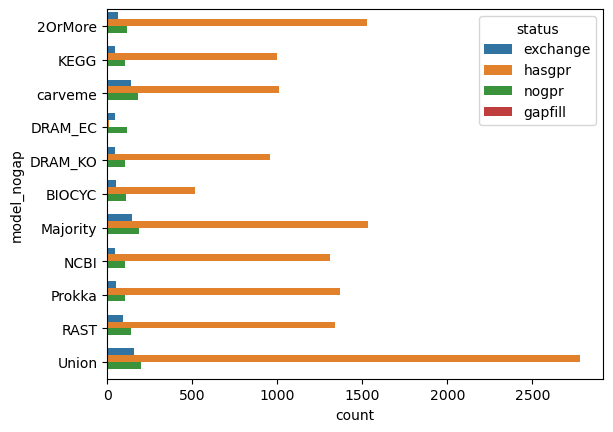

In [83]:
sns.countplot(data=rdf2, y='model_nogap', hue='status')
plt.show()

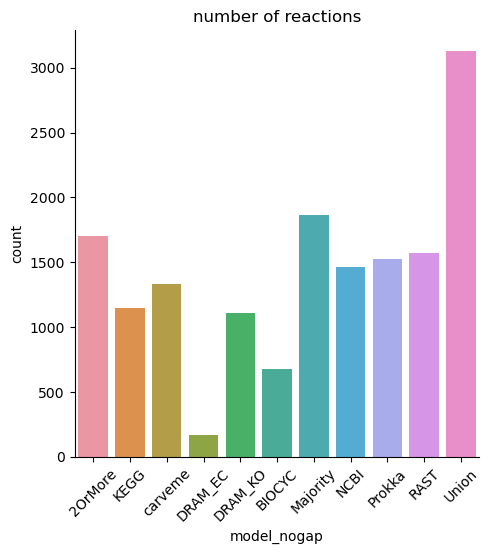

In [84]:
sns.catplot(data=rdf2, x='model_nogap', kind='count')
plt.xticks(rotation = 45) # Rotates X-Axis Ticks by 45-degrees
plt.title('number of reactions')
plt.show()

In [85]:
sns.catplot(data=rdf2.loc[rdf2.status.isin(['gapfill'])], x='model_nogap', kind='count')
plt.xticks(rotation = 45) # Rotates X-Axis Ticks by 45-degrees
plt.title('number of gapfilled reactions')
plt.show()

ValueError: min() arg is an empty sequence

In [87]:
rdf2.pivot_table(index='model_nogap', columns='status', aggfunc='count', sort=True, values='index_gapfill', margins=True)

status,exchange,hasgpr,nogpr,All
model_nogap,,,,
2OrMore,64,1527,115,1706
BIOCYC,51,516,111,678
DRAM_EC,44,12,113,169
DRAM_KO,45,960,104,1109
KEGG,45,996,104,1145
Majority,147,1531,190,1868
NCBI,46,1311,105,1462
Prokka,49,1369,104,1522
RAST,93,1340,141,1574
